In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when ONI is removed as a predictor
df_trimmed = df_trimmed.drop(['ONI'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-20 23:58:07,946] A new study created in memory with name: no-name-dde087fc-8911-494e-89c6-0a4a8f4f8266
[I 2025-05-21 00:06:02,217] Trial 0 finished with value: 0.058322566002607344 and parameters: {'lr': 0.05891843281107494, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.11139627160786342}. Best is trial 0 with value: 0.058322566002607344.


Cross Validation Accuracies:
[0.05574357137084007, 0.05567898973822594, 0.06101219728589058, 0.06379520148038864, 0.0553828701376915]
Mean Cross Validation Accuracy:
0.058322566002607344
Standard Deviation of Cross Validation Accuracy:
0.003448633818403306


[I 2025-05-21 00:15:01,787] Trial 1 finished with value: 0.05275154113769531 and parameters: {'lr': 0.4309040716874003, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.34171028791223956}. Best is trial 1 with value: 0.05275154113769531.


Cross Validation Accuracies:
[0.04671493545174599, 0.04986303672194481, 0.056641433387994766, 0.061663802713155746, 0.048874497413635254]
Mean Cross Validation Accuracy:
0.05275154113769531
Standard Deviation of Cross Validation Accuracy:
0.005556531330139111


[I 2025-05-21 00:22:22,688] Trial 2 finished with value: 0.0824507862329483 and parameters: {'lr': 0.044164968111029594, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.21108479840346953}. Best is trial 1 with value: 0.05275154113769531.


Cross Validation Accuracies:
[0.07001562416553497, 0.11262262612581253, 0.09220175445079803, 0.07211373001337051, 0.06530019640922546]
Mean Cross Validation Accuracy:
0.0824507862329483
Standard Deviation of Cross Validation Accuracy:
0.017669476630264302


[I 2025-05-21 00:35:03,473] Trial 3 finished with value: 0.05607124492526054 and parameters: {'lr': 0.0559537417019566, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.35197990225327036}. Best is trial 1 with value: 0.05275154113769531.


Cross Validation Accuracies:
[0.04417237639427185, 0.05672008916735649, 0.05576680600643158, 0.06502647697925568, 0.05867047607898712]
Mean Cross Validation Accuracy:
0.05607124492526054
Standard Deviation of Cross Validation Accuracy:
0.006768292812149257


[I 2025-05-21 00:42:05,593] Trial 4 finished with value: 0.051412643492221834 and parameters: {'lr': 0.04802022347868649, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.1996555290458024}. Best is trial 4 with value: 0.051412643492221834.


Cross Validation Accuracies:
[0.04194111377000809, 0.047469671815633774, 0.05547327175736427, 0.0626155287027359, 0.049563631415367126]
Mean Cross Validation Accuracy:
0.051412643492221834
Standard Deviation of Cross Validation Accuracy:
0.007080523787533478


[I 2025-05-21 00:51:11,796] Trial 5 finished with value: 0.05542194172739982 and parameters: {'lr': 0.017094748646015998, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12297736180505857}. Best is trial 4 with value: 0.051412643492221834.


Cross Validation Accuracies:
[0.05152541771531105, 0.04831281676888466, 0.05737780034542084, 0.06382570415735245, 0.056067969650030136]
Mean Cross Validation Accuracy:
0.05542194172739982
Standard Deviation of Cross Validation Accuracy:
0.005302612847307561


[I 2025-05-21 00:59:17,257] Trial 6 finished with value: 0.051174584031105044 and parameters: {'lr': 0.011735984749685624, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.36583523122262107}. Best is trial 6 with value: 0.051174584031105044.


Cross Validation Accuracies:
[0.04261802136898041, 0.04542333260178566, 0.056889381259679794, 0.06255166232585907, 0.048390522599220276]
Mean Cross Validation Accuracy:
0.051174584031105044
Standard Deviation of Cross Validation Accuracy:
0.0074315472620351515


[I 2025-05-21 01:09:56,934] Trial 7 finished with value: 0.06314039006829261 and parameters: {'lr': 0.0025179170296910866, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.37901769043647626}. Best is trial 6 with value: 0.051174584031105044.


Cross Validation Accuracies:
[0.051847055554389954, 0.05591228976845741, 0.06573226302862167, 0.07805638015270233, 0.06415396183729172]
Mean Cross Validation Accuracy:
0.06314039006829261
Standard Deviation of Cross Validation Accuracy:
0.009055569907620267


[I 2025-05-21 01:15:59,541] Trial 8 finished with value: 0.04922466278076172 and parameters: {'lr': 0.307029694255516, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.27372747688080207}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.039780620485544205, 0.046494726091623306, 0.05550680309534073, 0.059640880674123764, 0.04470028355717659]
Mean Cross Validation Accuracy:
0.04922466278076172
Standard Deviation of Cross Validation Accuracy:
0.007281145221645076


[I 2025-05-21 01:22:10,309] Trial 9 finished with value: 0.4818878471851349 and parameters: {'lr': 0.0012611570208884025, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.18959370892761154}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.4852270185947418, 0.490329384803772, 0.48100554943084717, 0.4654592275619507, 0.4874180555343628]
Mean Cross Validation Accuracy:
0.4818878471851349
Standard Deviation of Cross Validation Accuracy:
0.00875980387344335


[I 2025-05-21 01:30:13,047] Trial 10 finished with value: 0.058339571207761766 and parameters: {'lr': 0.8835480978330209, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.48334139233140183}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.051330339163541794, 0.050085362046957016, 0.06283091008663177, 0.06934516876935959, 0.05810607597231865]
Mean Cross Validation Accuracy:
0.058339571207761766
Standard Deviation of Cross Validation Accuracy:
0.007191816534891655


[I 2025-05-21 01:38:37,864] Trial 11 finished with value: 0.267778280377388 and parameters: {'lr': 0.009051599208177144, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.28039467689021164}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.2982405424118042, 0.2829359769821167, 0.23063477873802185, 0.23300041258335114, 0.2940796911716461]
Mean Cross Validation Accuracy:
0.267778280377388
Standard Deviation of Cross Validation Accuracy:
0.0297946612221581


[I 2025-05-21 01:46:41,993] Trial 12 finished with value: 0.05751852914690971 and parameters: {'lr': 0.17790386995914895, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.45607013110742367}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.044715434312820435, 0.056038107722997665, 0.06083172932267189, 0.0704033374786377, 0.05560403689742088]
Mean Cross Validation Accuracy:
0.05751852914690971
Standard Deviation of Cross Validation Accuracy:
0.00832792587198579


[I 2025-05-21 01:53:09,832] Trial 13 finished with value: 0.3562532067298889 and parameters: {'lr': 0.006646530942614969, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.26567559083356523}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.3623002767562866, 0.36962825059890747, 0.32758137583732605, 0.33263757824897766, 0.3891185522079468]
Mean Cross Validation Accuracy:
0.3562532067298889
Standard Deviation of Cross Validation Accuracy:
0.02313163021956981


[I 2025-05-21 01:59:56,071] Trial 14 finished with value: 0.055252452939748765 and parameters: {'lr': 0.1693648733949656, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4016950218814678}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04706530272960663, 0.04768211022019386, 0.059596363455057144, 0.06291680783033371, 0.059001680463552475]
Mean Cross Validation Accuracy:
0.055252452939748765
Standard Deviation of Cross Validation Accuracy:
0.006572794214548873


[I 2025-05-21 02:08:24,538] Trial 15 finished with value: 0.05080052465200424 and parameters: {'lr': 0.1721011718129236, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.42689974354197013}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04180162772536278, 0.04588526859879494, 0.05529852211475372, 0.06182906776666641, 0.04918813705444336]
Mean Cross Validation Accuracy:
0.05080052465200424
Standard Deviation of Cross Validation Accuracy:
0.007065414724367695


[I 2025-05-21 02:16:50,353] Trial 16 finished with value: 1.0095977902412414 and parameters: {'lr': 0.19740508786618507, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.4262522020358359}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.7753267884254456, 0.9580156803131104, 0.8537731170654297, 1.3460214138031006, 1.114851951599121]
Mean Cross Validation Accuracy:
1.0095977902412414
Standard Deviation of Cross Validation Accuracy:
0.20301932819335458


[I 2025-05-21 02:26:11,566] Trial 17 finished with value: 0.054539091885089874 and parameters: {'lr': 0.43355359558962775, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.3091604372303199}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04722995683550835, 0.04477116838097572, 0.05659262835979462, 0.07046066969633102, 0.05364103615283966]
Mean Cross Validation Accuracy:
0.054539091885089874
Standard Deviation of Cross Validation Accuracy:
0.009026139162519306


[I 2025-05-21 02:33:44,169] Trial 18 finished with value: 0.050904926657676694 and parameters: {'lr': 0.13512006042164465, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24977925433352594}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04254759103059769, 0.04544813930988312, 0.056323274970054626, 0.06124182045459747, 0.04896380752325058]
Mean Cross Validation Accuracy:
0.050904926657676694
Standard Deviation of Cross Validation Accuracy:
0.006922418684820897


[I 2025-05-21 02:42:45,894] Trial 19 finished with value: 3.583577823638916 and parameters: {'lr': 0.6601063363232655, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.320751657596289}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[3.3907201290130615, 4.015238285064697, 3.7322158813476562, 3.3572654724121094, 3.4224493503570557]
Mean Cross Validation Accuracy:
3.583577823638916
Standard Deviation of Cross Validation Accuracy:
0.25408572638150817


[I 2025-05-21 02:48:13,191] Trial 20 finished with value: 0.05209379866719246 and parameters: {'lr': 0.3390948274417073, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.42954921057449574}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.044496554881334305, 0.04958527162671089, 0.0540342815220356, 0.06535351276397705, 0.04699937254190445]
Mean Cross Validation Accuracy:
0.05209379866719246
Standard Deviation of Cross Validation Accuracy:
0.007342336007552538


[I 2025-05-21 02:54:03,951] Trial 21 finished with value: 0.050507758557796475 and parameters: {'lr': 0.14832936339008312, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24526231662135525}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04110223054885864, 0.0443798303604126, 0.05669717863202095, 0.060949839651584625, 0.049409713596105576]
Mean Cross Validation Accuracy:
0.050507758557796475
Standard Deviation of Cross Validation Accuracy:
0.00741035953623793


[I 2025-05-21 03:01:08,775] Trial 22 finished with value: 0.05058673545718193 and parameters: {'lr': 0.08775473394358456, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24191689279589831}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.0416838638484478, 0.04539952054619789, 0.0553533174097538, 0.062108173966407776, 0.048388801515102386]
Mean Cross Validation Accuracy:
0.05058673545718193
Standard Deviation of Cross Validation Accuracy:
0.007300179228766111


[I 2025-05-21 03:07:49,566] Trial 23 finished with value: 0.05097638517618179 and parameters: {'lr': 0.0860613067031404, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.22404610471098896}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04306517541408539, 0.0446401983499527, 0.0556405633687973, 0.06296885013580322, 0.048567138612270355]
Mean Cross Validation Accuracy:
0.05097638517618179
Standard Deviation of Cross Validation Accuracy:
0.007404225096830938


[I 2025-05-21 03:13:49,489] Trial 24 finished with value: 0.050673481076955795 and parameters: {'lr': 0.08434358934546138, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.17406602729935355}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04190734028816223, 0.045015834271907806, 0.05624586343765259, 0.062470220029354095, 0.047728147357702255]
Mean Cross Validation Accuracy:
0.050673481076955795
Standard Deviation of Cross Validation Accuracy:
0.007586088287150737


[I 2025-05-21 03:22:08,937] Trial 25 finished with value: 0.05166111066937447 and parameters: {'lr': 0.022729560374304392, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.23534076223911812}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.044298481196165085, 0.04581662639975548, 0.056801795959472656, 0.06281766295433044, 0.048570986837148666]
Mean Cross Validation Accuracy:
0.05166111066937447
Standard Deviation of Cross Validation Accuracy:
0.0070542253802224585


[I 2025-05-21 03:28:50,432] Trial 26 finished with value: 0.05073136612772942 and parameters: {'lr': 0.28259583395686994, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1567574910355038}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.045389577746391296, 0.044571686536073685, 0.05309498682618141, 0.06105007231235504, 0.049550507217645645]
Mean Cross Validation Accuracy:
0.05073136612772942
Standard Deviation of Cross Validation Accuracy:
0.0059988862912904945


[I 2025-05-21 03:35:05,472] Trial 27 finished with value: 0.050776638090610504 and parameters: {'lr': 0.09164821414899613, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.27014914694085757}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.0417151041328907, 0.04552093520760536, 0.05598647519946098, 0.06262395530939102, 0.04803672060370445]
Mean Cross Validation Accuracy:
0.050776638090610504
Standard Deviation of Cross Validation Accuracy:
0.007546420161633728


[I 2025-05-21 03:41:20,001] Trial 28 finished with value: 0.18451630175113679 and parameters: {'lr': 0.029910829107837558, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.2969470582768451}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.2185036540031433, 0.14268921315670013, 0.16753023862838745, 0.1738298237323761, 0.2200285792350769]
Mean Cross Validation Accuracy:
0.18451630175113679
Standard Deviation of Cross Validation Accuracy:
0.030227452616258175


[I 2025-05-21 03:48:39,880] Trial 29 finished with value: 57.00103607177734 and parameters: {'lr': 0.5835919481903314, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.10652033469026126}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[57.802921295166016, 58.772830963134766, 66.47040557861328, 56.26148986816406, 45.697532653808594]
Mean Cross Validation Accuracy:
57.00103607177734
Standard Deviation of Cross Validation Accuracy:
6.65984014842449


[I 2025-05-21 03:58:32,754] Trial 30 finished with value: 0.08161590099334717 and parameters: {'lr': 0.11826575850107708, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24087947796007644}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.07850585877895355, 0.0772291049361229, 0.08386233448982239, 0.09501318633556366, 0.07346902042627335]
Mean Cross Validation Accuracy:
0.08161590099334717
Standard Deviation of Cross Validation Accuracy:
0.007480932070163564


[I 2025-05-21 04:04:39,488] Trial 31 finished with value: 0.0504643015563488 and parameters: {'lr': 0.09176816526305907, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.15814592358356194}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04198785126209259, 0.04496157914400101, 0.05530964955687523, 0.061990901827812195, 0.04807152599096298]
Mean Cross Validation Accuracy:
0.0504643015563488
Standard Deviation of Cross Validation Accuracy:
0.00726905013752091


[I 2025-05-21 04:09:50,997] Trial 32 finished with value: 0.05025300160050392 and parameters: {'lr': 0.253257618793313, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1562877151982431}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.041175153106451035, 0.04603995382785797, 0.057208288460969925, 0.06005748361349106, 0.04678412899374962]
Mean Cross Validation Accuracy:
0.05025300160050392
Standard Deviation of Cross Validation Accuracy:
0.007165110813264859


[I 2025-05-21 04:15:52,226] Trial 33 finished with value: 0.0496908575296402 and parameters: {'lr': 0.27258113383585153, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.16278225068072255}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04179564490914345, 0.044937774538993835, 0.05190882459282875, 0.06050070747733116, 0.04931133612990379]
Mean Cross Validation Accuracy:
0.0496908575296402
Standard Deviation of Cross Validation Accuracy:
0.006431834116590141


[I 2025-05-21 04:23:46,635] Trial 34 finished with value: 0.04997677877545357 and parameters: {'lr': 0.26126844147330786, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1343890708476798}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.043029434978961945, 0.043166302144527435, 0.054979369044303894, 0.05959974601864815, 0.049109041690826416]
Mean Cross Validation Accuracy:
0.04997677877545357
Standard Deviation of Cross Validation Accuracy:
0.006527305008603025


[I 2025-05-21 04:29:56,713] Trial 35 finished with value: 0.050626975297927854 and parameters: {'lr': 0.29940702558236154, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.13205614627332246}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04207957908511162, 0.044918403029441833, 0.05526411905884743, 0.06203616037964821, 0.048836614936590195]
Mean Cross Validation Accuracy:
0.050626975297927854
Standard Deviation of Cross Validation Accuracy:
0.007218362363794542


[I 2025-05-21 04:37:06,577] Trial 36 finished with value: 4.457945728302002 and parameters: {'lr': 0.863977138912649, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1426834581156341}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[4.77188777923584, 3.738696336746216, 5.723546028137207, 4.927459239959717, 3.1281392574310303]
Mean Cross Validation Accuracy:
4.457945728302002
Standard Deviation of Cross Validation Accuracy:
0.9172187967045095


[I 2025-05-21 04:44:27,957] Trial 37 finished with value: 0.05343364477157593 and parameters: {'lr': 0.4701612842547453, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1850361170817807}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04503932222723961, 0.046458467841148376, 0.06203880533576012, 0.06361190229654312, 0.050019726157188416]
Mean Cross Validation Accuracy:
0.05343364477157593
Standard Deviation of Cross Validation Accuracy:
0.007853894563523568


[I 2025-05-21 04:53:55,053] Trial 38 finished with value: 2.5715009212493896 and parameters: {'lr': 0.26081323697680353, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.10129774203544747}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[2.6045784950256348, 2.1770846843719482, 2.5046701431274414, 3.115264654159546, 2.455906629562378]
Mean Cross Validation Accuracy:
2.5715009212493896
Standard Deviation of Cross Validation Accuracy:
0.3066482298017974


[I 2025-05-21 05:00:22,047] Trial 39 finished with value: 0.05109976306557655 and parameters: {'lr': 0.05606063225933993, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.20641331117004263}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.042513877153396606, 0.045736148953437805, 0.056225523352622986, 0.0626295879483223, 0.04839367792010307]
Mean Cross Validation Accuracy:
0.05109976306557655
Standard Deviation of Cross Validation Accuracy:
0.007335106957672826


[I 2025-05-21 05:06:34,618] Trial 40 finished with value: 0.0505246490240097 and parameters: {'lr': 0.2418796462928354, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.16618109935354403}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04444798454642296, 0.04332686960697174, 0.05552290380001068, 0.06181807816028595, 0.04750740900635719]
Mean Cross Validation Accuracy:
0.0505246490240097
Standard Deviation of Cross Validation Accuracy:
0.0070761813076762456


[I 2025-05-21 05:13:02,408] Trial 41 finished with value: 0.05330533459782601 and parameters: {'lr': 0.45011680915156393, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.14443081005399916}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04413100704550743, 0.05224442109465599, 0.053533364087343216, 0.06683329492807388, 0.0497845858335495]
Mean Cross Validation Accuracy:
0.05330533459782601
Standard Deviation of Cross Validation Accuracy:
0.007493293047845446


[I 2025-05-21 05:19:47,332] Trial 42 finished with value: 0.05041094496846199 and parameters: {'lr': 0.3687446366630814, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.12486435701769007}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04507012665271759, 0.0477280467748642, 0.05427710711956024, 0.05974721908569336, 0.045232225209474564]
Mean Cross Validation Accuracy:
0.05041094496846199
Standard Deviation of Cross Validation Accuracy:
0.005738547647476616


[I 2025-05-21 05:26:15,388] Trial 43 finished with value: 0.055991463363170624 and parameters: {'lr': 0.6955199841014523, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1273365505436475}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04376726597547531, 0.04752594605088234, 0.06458215415477753, 0.0702415406703949, 0.053840409964323044]
Mean Cross Validation Accuracy:
0.055991463363170624
Standard Deviation of Cross Validation Accuracy:
0.01002584347974325


[I 2025-05-21 05:33:05,245] Trial 44 finished with value: 0.051496551185846326 and parameters: {'lr': 0.3413235114339014, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.11888742012350252}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04436395317316055, 0.04233395308256149, 0.05406585708260536, 0.06686800718307495, 0.049850985407829285]
Mean Cross Validation Accuracy:
0.051496551185846326
Standard Deviation of Cross Validation Accuracy:
0.008722591786946416


[I 2025-05-21 05:41:22,143] Trial 45 finished with value: 11.973076629638673 and parameters: {'lr': 0.9774553278603858, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.19782092164145407}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[10.292664527893066, 12.948403358459473, 10.660543441772461, 10.335352897644043, 15.628418922424316]
Mean Cross Validation Accuracy:
11.973076629638673
Standard Deviation of Cross Validation Accuracy:
2.075642393509124


[I 2025-05-21 05:48:56,956] Trial 46 finished with value: 0.05124580562114715 and parameters: {'lr': 0.036986679483382315, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.2166197078932245}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04297323524951935, 0.04559359326958656, 0.056609880179166794, 0.06261098384857178, 0.048441335558891296]
Mean Cross Validation Accuracy:
0.05124580562114715
Standard Deviation of Cross Validation Accuracy:
0.007296417605316708


[I 2025-05-21 05:55:22,093] Trial 47 finished with value: 0.04939144775271416 and parameters: {'lr': 0.21913495159944102, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.17876161802051246}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04109562933444977, 0.043607041239738464, 0.05378993973135948, 0.06057145819067955, 0.04789317026734352]
Mean Cross Validation Accuracy:
0.04939144775271416
Standard Deviation of Cross Validation Accuracy:
0.007054986356309433


[I 2025-05-21 06:01:38,106] Trial 48 finished with value: 0.3680573761463165 and parameters: {'lr': 0.22721782533955137, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.18534512315067592}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.28063613176345825, 0.31324848532676697, 0.3626149296760559, 0.5916848182678223, 0.29210251569747925]
Mean Cross Validation Accuracy:
0.3680573761463165
Standard Deviation of Cross Validation Accuracy:
0.11528615042710735


[I 2025-05-21 06:08:58,257] Trial 49 finished with value: 0.05634641498327255 and parameters: {'lr': 0.5583217692814445, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.14995408827429882}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04692971706390381, 0.055392757058143616, 0.05652124807238579, 0.06639599055051804, 0.056492362171411514]
Mean Cross Validation Accuracy:
0.05634641498327255
Standard Deviation of Cross Validation Accuracy:
0.006174617387585352


[I 2025-05-21 06:16:44,990] Trial 50 finished with value: 0.05091027542948723 and parameters: {'lr': 0.11479803071559105, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3484684087905006}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.042073607444763184, 0.045044638216495514, 0.05659539997577667, 0.062046267092227936, 0.048791464418172836]
Mean Cross Validation Accuracy:
0.05091027542948723
Standard Deviation of Cross Validation Accuracy:
0.007393412101429225


[I 2025-05-21 06:23:38,472] Trial 51 finished with value: 0.050745264440774915 and parameters: {'lr': 0.36318047949874066, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.17802770813576613}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.043076179921627045, 0.044620055705308914, 0.05216604843735695, 0.06300035119056702, 0.050863686949014664]
Mean Cross Validation Accuracy:
0.050745264440774915
Standard Deviation of Cross Validation Accuracy:
0.007050572199689808


[I 2025-05-21 06:29:30,909] Trial 52 finished with value: 0.050999853760004044 and parameters: {'lr': 0.18564376241282235, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.13366363303754458}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04007737711071968, 0.04620496928691864, 0.0551772266626358, 0.06248481571674347, 0.051054880023002625]
Mean Cross Validation Accuracy:
0.050999853760004044
Standard Deviation of Cross Validation Accuracy:
0.007637397942616467


[I 2025-05-21 06:35:15,793] Trial 53 finished with value: 0.4237838089466095 and parameters: {'lr': 0.0034856698231001634, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.11619438384538423}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.414949893951416, 0.4254257082939148, 0.43292996287345886, 0.4137495756149292, 0.4318639039993286]
Mean Cross Validation Accuracy:
0.4237838089466095
Standard Deviation of Cross Validation Accuracy:
0.008128465954633601


[I 2025-05-21 06:41:00,861] Trial 54 finished with value: 0.04932766258716583 and parameters: {'lr': 0.2304560235840058, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.16619263661143321}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.041548952460289, 0.04087311774492264, 0.057149533182382584, 0.06120729818940163, 0.04585941135883331]
Mean Cross Validation Accuracy:
0.04932766258716583
Standard Deviation of Cross Validation Accuracy:
0.008322545619707132


[I 2025-05-21 06:49:07,356] Trial 55 finished with value: 0.05056726783514023 and parameters: {'lr': 0.21214635721550523, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.16854266562714493}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.0413530133664608, 0.0438084714114666, 0.054997481405735016, 0.06503333896398544, 0.047644034028053284]
Mean Cross Validation Accuracy:
0.05056726783514023
Standard Deviation of Cross Validation Accuracy:
0.008579313685686398


[I 2025-05-21 06:57:42,566] Trial 56 finished with value: 0.0497737355530262 and parameters: {'lr': 0.1369162018949591, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.19330639789773632}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04049239307641983, 0.04371408745646477, 0.05596315488219261, 0.06102113425731659, 0.0476779080927372]
Mean Cross Validation Accuracy:
0.0497737355530262
Standard Deviation of Cross Validation Accuracy:
0.007642879499390941


[I 2025-05-21 07:04:45,509] Trial 57 finished with value: 0.04986767172813415 and parameters: {'lr': 0.13466545361336035, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.19784227126977233}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04241148754954338, 0.0443774051964283, 0.05351674184203148, 0.06106296926736832, 0.0479697547852993]
Mean Cross Validation Accuracy:
0.04986767172813415
Standard Deviation of Cross Validation Accuracy:
0.006752632042459555


[I 2025-05-21 07:11:15,986] Trial 58 finished with value: 0.05100823938846588 and parameters: {'lr': 0.06588318506186729, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.20278361461607283}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.042309217154979706, 0.04504035413265228, 0.05665963888168335, 0.061873529106378555, 0.04915845766663551]
Mean Cross Validation Accuracy:
0.05100823938846588
Standard Deviation of Cross Validation Accuracy:
0.007276031494568717


[I 2025-05-21 07:17:27,818] Trial 59 finished with value: 0.21816010177135467 and parameters: {'lr': 0.131502403243542, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.22134465489446295}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.2900727391242981, 0.17165249586105347, 0.23454147577285767, 0.17917825281620026, 0.2153555452823639]
Mean Cross Validation Accuracy:
0.21816010177135467
Standard Deviation of Cross Validation Accuracy:
0.042732152573450755


[I 2025-05-21 07:23:45,479] Trial 60 finished with value: 0.05059167817234993 and parameters: {'lr': 0.06815329319992021, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.18994535336823645}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04185197502374649, 0.045165300369262695, 0.05623887479305267, 0.06243933364748955, 0.04726290702819824]
Mean Cross Validation Accuracy:
0.05059167817234993
Standard Deviation of Cross Validation Accuracy:
0.007604820503446033


[I 2025-05-21 07:31:09,411] Trial 61 finished with value: 0.04995094463229179 and parameters: {'lr': 0.15935714800495585, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2623286139190191}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04059236869215965, 0.043282054364681244, 0.05604276433587074, 0.061912693083286285, 0.047924842685461044]
Mean Cross Validation Accuracy:
0.04995094463229179
Standard Deviation of Cross Validation Accuracy:
0.007954317361450748


[I 2025-05-21 07:38:51,327] Trial 62 finished with value: 0.04935009926557541 and parameters: {'lr': 0.1753434841301319, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.29004147053005813}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04073960334062576, 0.04315315559506416, 0.05502810701727867, 0.06094254553318024, 0.04688708484172821]
Mean Cross Validation Accuracy:
0.04935009926557541
Standard Deviation of Cross Validation Accuracy:
0.007552930205911486


[I 2025-05-21 07:46:58,672] Trial 63 finished with value: 0.05040973797440529 and parameters: {'lr': 0.11083237624417502, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.32939429717142765}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.0412125289440155, 0.04567406326532364, 0.05545128881931305, 0.061968397349119186, 0.047742411494255066]
Mean Cross Validation Accuracy:
0.05040973797440529
Standard Deviation of Cross Validation Accuracy:
0.007391207491514241


[I 2025-05-21 07:56:06,032] Trial 64 finished with value: 0.051342417299747464 and parameters: {'lr': 0.19086582637257468, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2944601293946338}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04564541205763817, 0.04508792608976364, 0.05602175369858742, 0.06067007780075073, 0.049286916851997375]
Mean Cross Validation Accuracy:
0.051342417299747464
Standard Deviation of Cross Validation Accuracy:
0.006077845846524433


[I 2025-05-21 08:04:39,860] Trial 65 finished with value: 0.050016100704669955 and parameters: {'lr': 0.15449924066874893, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28748361500925773}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04192778840661049, 0.04377124458551407, 0.055645111948251724, 0.061038948595523834, 0.047697409987449646]
Mean Cross Validation Accuracy:
0.050016100704669955
Standard Deviation of Cross Validation Accuracy:
0.007252369180168563


[I 2025-05-21 08:10:57,586] Trial 66 finished with value: 41.41491584777832 and parameters: {'lr': 0.495700815268656, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3710791900463098}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[38.99787139892578, 37.31475830078125, 51.06492614746094, 30.834367752075195, 48.86265563964844]
Mean Cross Validation Accuracy:
41.41491584777832
Standard Deviation of Cross Validation Accuracy:
7.52586102150178


[I 2025-05-21 08:16:39,362] Trial 67 finished with value: 0.05189743787050247 and parameters: {'lr': 0.04238957975615886, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.22819211468949463}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.043743476271629333, 0.04628951847553253, 0.05764898285269737, 0.06278061866760254, 0.04902459308505058]
Mean Cross Validation Accuracy:
0.05189743787050247
Standard Deviation of Cross Validation Accuracy:
0.00717931724890682


[I 2025-05-21 08:22:30,695] Trial 68 finished with value: 0.08114607483148575 and parameters: {'lr': 0.013400769194114596, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2556435375442174}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.07854603230953217, 0.13222357630729675, 0.06569856405258179, 0.07143840938806534, 0.0578237920999527]
Mean Cross Validation Accuracy:
0.08114607483148575
Standard Deviation of Cross Validation Accuracy:
0.026429016658070122


[I 2025-05-21 08:28:17,414] Trial 69 finished with value: 0.0515285812318325 and parameters: {'lr': 0.3757544572318927, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3110551825471326}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.042017318308353424, 0.0494852215051651, 0.05457042530179024, 0.06737785786390305, 0.044192083179950714]
Mean Cross Validation Accuracy:
0.0515285812318325
Standard Deviation of Cross Validation Accuracy:
0.009043406771158906


[I 2025-05-21 08:33:56,745] Trial 70 finished with value: 0.050819211453199384 and parameters: {'lr': 0.31393446683645204, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.21141681416389585}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04186060652136803, 0.04809446632862091, 0.05211987346410751, 0.06152653694152832, 0.05049457401037216]
Mean Cross Validation Accuracy:
0.050819211453199384
Standard Deviation of Cross Validation Accuracy:
0.006389440798183684


[I 2025-05-21 08:39:32,282] Trial 71 finished with value: 0.04961771667003632 and parameters: {'lr': 0.15761591982214423, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.26450558088164855}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.03937462717294693, 0.04378180950880051, 0.0553022176027298, 0.06164418160915375, 0.0479857474565506]
Mean Cross Validation Accuracy:
0.04961771667003632
Standard Deviation of Cross Validation Accuracy:
0.007982373433250606


[I 2025-05-21 08:46:28,159] Trial 72 finished with value: 0.049866237491369245 and parameters: {'lr': 0.21974546242185294, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.270689752921505}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.0385686494410038, 0.047035228461027145, 0.05442804470658302, 0.06240757927298546, 0.04689168557524681]
Mean Cross Validation Accuracy:
0.049866237491369245
Standard Deviation of Cross Validation Accuracy:
0.00803235215537062


[I 2025-05-21 08:53:09,522] Trial 73 finished with value: 0.04947242736816406 and parameters: {'lr': 0.19631705993981857, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.27540579796457887}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04176710546016693, 0.044597331434488297, 0.054177176207304, 0.061061736196279526, 0.04575878754258156]
Mean Cross Validation Accuracy:
0.04947242736816406
Standard Deviation of Cross Validation Accuracy:
0.0071186572831592135


[I 2025-05-21 08:57:38,930] Trial 74 finished with value: 0.48999243378639223 and parameters: {'lr': 0.001062714746359638, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.27734748026709294}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.4938712418079376, 0.5010777115821838, 0.4884909391403198, 0.4691278338432312, 0.4973944425582886]
Mean Cross Validation Accuracy:
0.48999243378639223
Standard Deviation of Cross Validation Accuracy:
0.011227682630867736


[I 2025-05-21 09:01:46,391] Trial 75 finished with value: 0.05059947445988655 and parameters: {'lr': 0.10352261342296372, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.33524333075003454}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.042865149676799774, 0.04516688361763954, 0.054848767817020416, 0.06220584735274315, 0.047910723835229874]
Mean Cross Validation Accuracy:
0.05059947445988655
Standard Deviation of Cross Validation Accuracy:
0.007061537917396557


[I 2025-05-21 09:06:05,311] Trial 76 finished with value: 0.7774669170379639 and parameters: {'lr': 0.16750403221305848, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3145303145581309}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.9462320804595947, 0.7724013924598694, 0.6476746797561646, 0.7171393036842346, 0.803887128829956]
Mean Cross Validation Accuracy:
0.7774669170379639
Standard Deviation of Cross Validation Accuracy:
0.09969033384103669


[I 2025-05-21 09:12:49,286] Trial 77 finished with value: 0.050930139422416684 and parameters: {'lr': 0.276888030122737, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.30295120553916854}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04118610918521881, 0.04411914944648743, 0.05711270496249199, 0.06162421405315399, 0.050608519464731216]
Mean Cross Validation Accuracy:
0.050930139422416684
Standard Deviation of Cross Validation Accuracy:
0.00766846135776823


[I 2025-05-21 09:17:43,390] Trial 78 finished with value: 18.65289726257324 and parameters: {'lr': 0.1971744719833083, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28606722650917205}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[17.7426700592041, 18.826862335205078, 18.906707763671875, 19.48320770263672, 18.305038452148438]
Mean Cross Validation Accuracy:
18.65289726257324
Standard Deviation of Cross Validation Accuracy:
0.5888324647275336


[I 2025-05-21 09:21:52,296] Trial 79 finished with value: 0.050373201817274095 and parameters: {'lr': 0.07521852988613499, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2537396671621188}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04172056168317795, 0.04482630640268326, 0.055384859442710876, 0.061580922454595566, 0.04835335910320282]
Mean Cross Validation Accuracy:
0.050373201817274095
Standard Deviation of Cross Validation Accuracy:
0.007217280771301713


[I 2025-05-21 09:25:59,950] Trial 80 finished with value: 0.05673164650797844 and parameters: {'lr': 0.14264095040933464, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.23495707699841856}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.04886394739151001, 0.0491291843354702, 0.06384538859128952, 0.06461655348539352, 0.05720315873622894]
Mean Cross Validation Accuracy:
0.05673164650797844
Standard Deviation of Cross Validation Accuracy:
0.00682198693524763


[I 2025-05-21 09:30:07,755] Trial 81 finished with value: 0.04971893057227135 and parameters: {'lr': 0.21736652197269726, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2750542912755722}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.040610551834106445, 0.04502381011843681, 0.05380712449550629, 0.06067851930856705, 0.04847464710474014]
Mean Cross Validation Accuracy:
0.04971893057227135
Standard Deviation of Cross Validation Accuracy:
0.006976831307752195


[I 2025-05-21 09:34:13,307] Trial 82 finished with value: 0.05336144044995308 and parameters: {'lr': 0.39422212045667643, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.27453218583997957}. Best is trial 8 with value: 0.04922466278076172.


Cross Validation Accuracies:
[0.046684324741363525, 0.04942210763692856, 0.05376652628183365, 0.06744149327278137, 0.04949275031685829]
Mean Cross Validation Accuracy:
0.05336144044995308
Standard Deviation of Cross Validation Accuracy:
0.0073956874267155906


[I 2025-05-21 09:38:21,117] Trial 83 finished with value: 0.048241648077964785 and parameters: {'lr': 0.22687330685163667, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28713470692398485}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.03782293573021889, 0.04260823503136635, 0.0544033907353878, 0.06025269255042076, 0.046120986342430115]
Mean Cross Validation Accuracy:
0.048241648077964785
Standard Deviation of Cross Validation Accuracy:
0.00808720443207467


[I 2025-05-21 09:42:23,509] Trial 84 finished with value: 0.05065953806042671 and parameters: {'lr': 0.28115288019224605, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2929298691504774}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.040390744805336, 0.046939823776483536, 0.05446036159992218, 0.06302051246166229, 0.04848624765872955]
Mean Cross Validation Accuracy:
0.05065953806042671
Standard Deviation of Cross Validation Accuracy:
0.00763213637412829


[I 2025-05-21 09:46:07,596] Trial 85 finished with value: 0.05612791106104851 and parameters: {'lr': 0.7215334296438529, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2658139465613002}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.053452011197805405, 0.05033581331372261, 0.057587478309869766, 0.06722868233919144, 0.05203557014465332]
Mean Cross Validation Accuracy:
0.05612791106104851
Standard Deviation of Cross Validation Accuracy:
0.00604671067758594


[I 2025-05-21 09:51:27,290] Trial 86 finished with value: 0.050357657670974734 and parameters: {'lr': 0.22131064411041293, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.3232386444182506}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04201679304242134, 0.04355920851230621, 0.05483503267168999, 0.060736123472452164, 0.05064113065600395]
Mean Cross Validation Accuracy:
0.050357657670974734
Standard Deviation of Cross Validation Accuracy:
0.006980382939890357


[I 2025-05-21 09:55:17,372] Trial 87 finished with value: 0.05428260415792465 and parameters: {'lr': 0.44729633645974515, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2794827497975255}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04917019233107567, 0.05416114628314972, 0.056149180978536606, 0.061579879373311996, 0.05035262182354927]
Mean Cross Validation Accuracy:
0.05428260415792465
Standard Deviation of Cross Validation Accuracy:
0.004434649985004566


[I 2025-05-21 10:00:13,234] Trial 88 finished with value: 0.0510143093764782 and parameters: {'lr': 0.3171451490820975, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3008740626227243}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.043501485139131546, 0.04800361767411232, 0.05566832050681114, 0.05875956639647484, 0.04913855716586113]
Mean Cross Validation Accuracy:
0.0510143093764782
Standard Deviation of Cross Validation Accuracy:
0.005489518463593379


[I 2025-05-21 10:04:03,376] Trial 89 finished with value: 0.055607248842716214 and parameters: {'lr': 0.5594782377561223, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.39326564864601854}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.044250860810279846, 0.05029955878853798, 0.06041010841727257, 0.0714169293642044, 0.051658786833286285]
Mean Cross Validation Accuracy:
0.055607248842716214
Standard Deviation of Cross Validation Accuracy:
0.009441852925976223


[I 2025-05-21 10:08:16,786] Trial 90 finished with value: 1.3506385564804078 and parameters: {'lr': 0.23856977574282623, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2470403202130502}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[2.0934298038482666, 1.4552441835403442, 1.187326431274414, 0.9300491809844971, 1.0871431827545166]
Mean Cross Validation Accuracy:
1.3506385564804078
Standard Deviation of Cross Validation Accuracy:
0.4088220295857814


[I 2025-05-21 10:12:21,158] Trial 91 finished with value: 0.0499629557132721 and parameters: {'lr': 0.16810487011471126, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.1630508797866346}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.041402123868465424, 0.043862875550985336, 0.056541915982961655, 0.06096772104501724, 0.04704014211893082]
Mean Cross Validation Accuracy:
0.0499629557132721
Standard Deviation of Cross Validation Accuracy:
0.007529000430410138


[I 2025-05-21 10:16:26,148] Trial 92 finished with value: 0.04985236823558807 and parameters: {'lr': 0.13451933521736917, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.48802945652962904}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.041242651641368866, 0.04369155690073967, 0.054707180708646774, 0.062347687780857086, 0.04727276414632797]
Mean Cross Validation Accuracy:
0.04985236823558807
Standard Deviation of Cross Validation Accuracy:
0.0077257930088845345


[I 2025-05-21 10:20:31,340] Trial 93 finished with value: 0.05036209747195244 and parameters: {'lr': 0.17693163268479994, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.17941730650233745}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04185199737548828, 0.04485594481229782, 0.055929139256477356, 0.06122416630387306, 0.04794923961162567]
Mean Cross Validation Accuracy:
0.05036209747195244
Standard Deviation of Cross Validation Accuracy:
0.007176878114576412


[I 2025-05-21 10:24:34,600] Trial 94 finished with value: 0.051836667209863664 and parameters: {'lr': 0.3170836526748434, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.2602703282333171}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04719500243663788, 0.047993004322052, 0.052547916769981384, 0.061374906450510025, 0.050072506070137024]
Mean Cross Validation Accuracy:
0.051836667209863664
Standard Deviation of Cross Validation Accuracy:
0.005116931591054177


[I 2025-05-21 10:28:21,760] Trial 95 finished with value: 0.0514370322227478 and parameters: {'lr': 0.24973169476865323, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.14457643622353678}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.0455918163061142, 0.045357078313827515, 0.05539609119296074, 0.06198011338710785, 0.048860061913728714]
Mean Cross Validation Accuracy:
0.0514370322227478
Standard Deviation of Cross Validation Accuracy:
0.006396934781411094


[I 2025-05-21 10:32:28,857] Trial 96 finished with value: 0.051352304965257646 and parameters: {'lr': 0.10615795471337501, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.3075312277977825}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04252619296312332, 0.045684803277254105, 0.05678514018654823, 0.0630638599395752, 0.04870152845978737]
Mean Cross Validation Accuracy:
0.051352304965257646
Standard Deviation of Cross Validation Accuracy:
0.0075329099689011745


[I 2025-05-21 10:37:28,463] Trial 97 finished with value: 0.05170494467020035 and parameters: {'lr': 0.19776954539886435, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.2848864634690664}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.04438339173793793, 0.046763826161623, 0.05687938630580902, 0.06265474855899811, 0.04784337058663368]
Mean Cross Validation Accuracy:
0.05170494467020035
Standard Deviation of Cross Validation Accuracy:
0.006922493702446408


[I 2025-05-21 10:41:55,803] Trial 98 finished with value: 30.085352897644043 and parameters: {'lr': 0.40643014562295837, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.17258401401166915}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[13.419939994812012, 25.38787078857422, 29.74298858642578, 43.818092346191406, 38.0578727722168]
Mean Cross Validation Accuracy:
30.085352897644043
Standard Deviation of Cross Validation Accuracy:
10.507794674627535


[I 2025-05-21 10:46:11,476] Trial 99 finished with value: 0.05361431166529655 and parameters: {'lr': 0.12095877531634806, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.23848078166287284}. Best is trial 83 with value: 0.048241648077964785.


Cross Validation Accuracies:
[0.05174488201737404, 0.050549183040857315, 0.05230645090341568, 0.06247307360172272, 0.05099796876311302]
Mean Cross Validation Accuracy:
0.05361431166529655
Standard Deviation of Cross Validation Accuracy:
0.0044704181838712866
Number of finished trials: 100
Best trial: {'lr': 0.22687330685163667, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28713470692398485}
Best hyperparameters:  {'lr': 0.22687330685163667, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.28713470692398485}
Fold 1:
Epoch 1/100
84/84 [==============================] - 9s 31ms/step - loss: 0.1366 - val_loss: 0.0674
Epoch 2/100
84/84 [==============================] - 1s 16ms/step - loss: 0.0676 - val_loss: 0.0668
Epoch 3/100
84/84 [==============================] - 2s 18ms/step - loss: 0.0630 - val_loss: 0.0634
Epoch 4/100
84/84 [==============================] - 2s 18ms/st

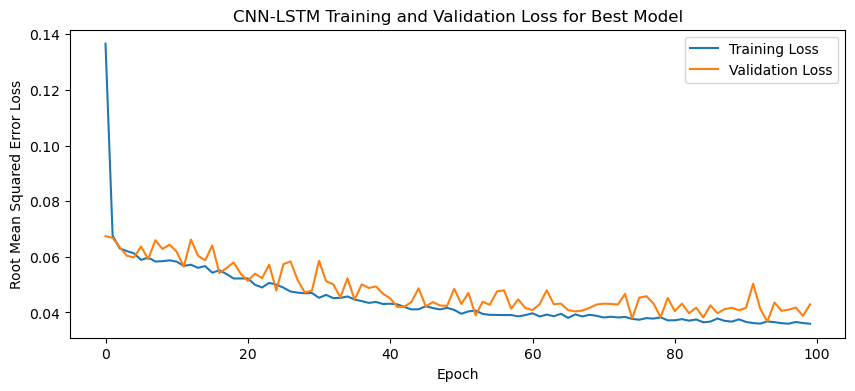

1/1 - 2s - loss: 0.0299 - 2s/epoch - 2s/step
Test Loss: 0.02988296002149582
1/1 [==============================] - 0s 83ms/step


NameError: name 'series' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

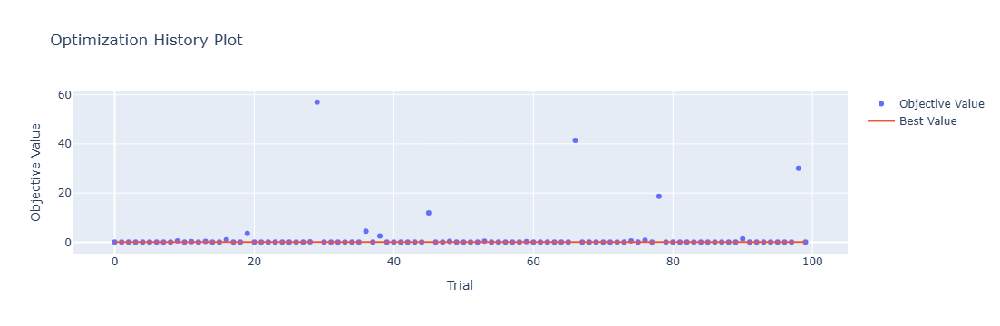

In [4]:
optuna.visualization.plot_optimization_history(study)

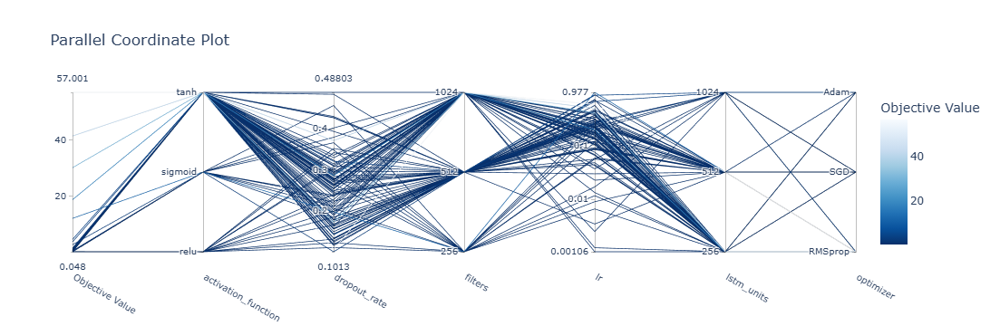

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

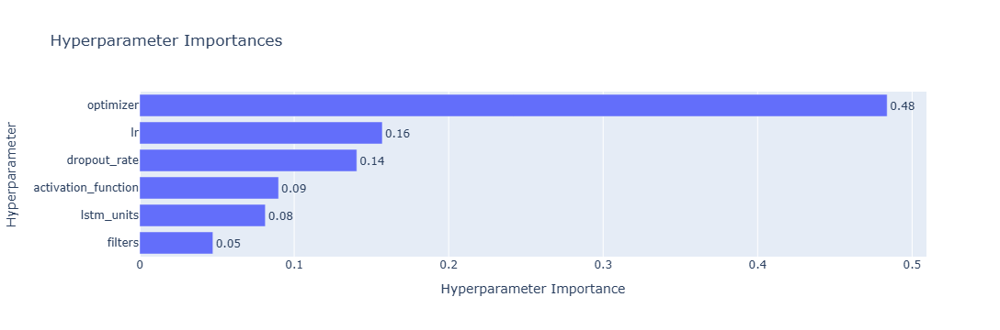

In [6]:
optuna.visualization.plot_param_importances(study)

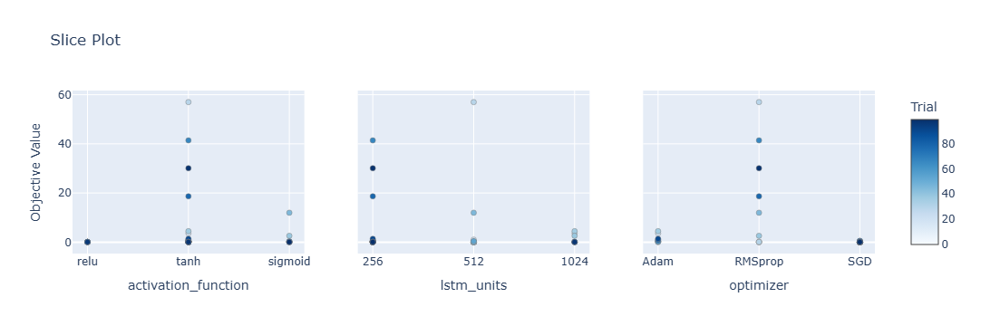

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

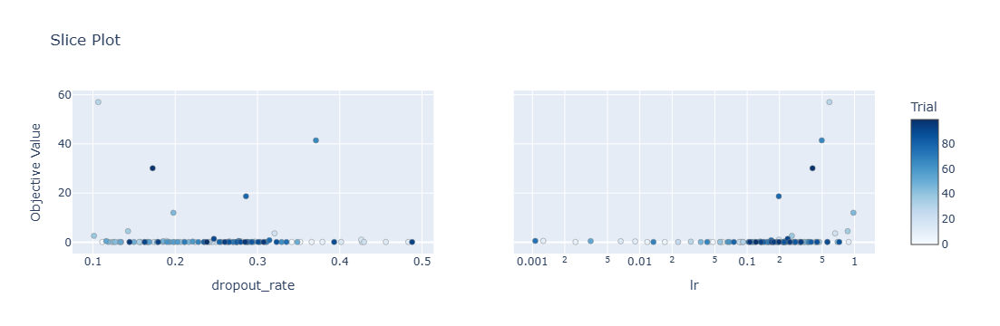

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 18s 107ms/step - loss: 0.1262 - accuracy: 0.3214 - mae: 0.1078 - rmse: 0.1262 - mape: inf - pearson: 0.6652 - val_loss: 0.0654 - val_accuracy: 0.4000 - val_mae: 0.0528 - val_rmse: 0.0654 - val_mape: 12.2012 - val_pearson: 0.8093
Epoch 2/100
84/84 [==============================] - 5s 60ms/step - loss: 0.0670 - accuracy: 0.3929 - mae: 0.0532 - rmse: 0.0670 - mape: inf - pearson: 0.8146 - val_loss: 0.0659 - val_accuracy: 0.4000 - val_mae: 0.0535 - val_rmse: 0.0659 - val_mape: 11.5860 - val_pearson: 0.8196
Epoch 3/100
84/84 [==============================] - 5s 55ms/step - loss: 0.0644 - accuracy: 0.5238 - mae: 0.0513 - rmse: 0.0644 - mape: inf - pearson: 0.8261 - val_loss: 0.0761 - val_accuracy: 0.0000e+00 - val_mae: 0.0604 - val_rmse: 0.0761 - val_mape: 13.8965 - val_pearson: 0.7569
Epoch 4/100
84/84 [==============================] - 5s 56ms/step - loss: 0.0620 - accuracy: 0.4881 - mae: 0.0493 - rmse: 0.0620 - mape: inf - pearson: 0.

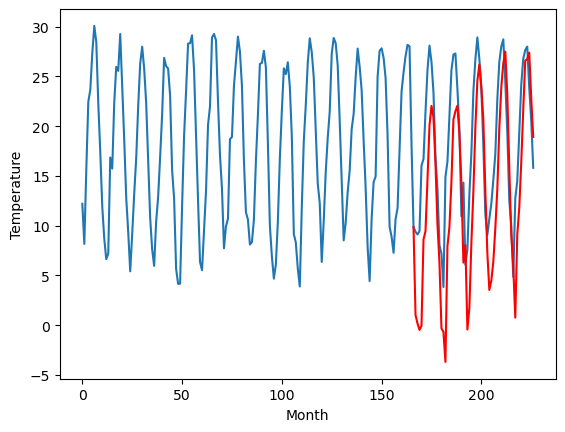

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-0.57		0.38
-1.85		-1.12		0.73
-2.23		-1.80		0.43
-1.48		-0.92		0.56
4.35		5.98		1.63
4.84		6.82		1.98
7.61		10.93		3.32
11.36		15.63		4.27
11.84		17.70		5.86
12.47		16.87		4.40
9.49		13.78		4.29
6.86		9.26		2.40
3.44		5.09		1.65
-3.77		-1.35		2.42
-3.11		-1.39		1.72
-3.20		-1.96		1.24
1.86		6.02		4.16
3.26		8.20		4.94
7.28		12.47		5.19
10.76		17.21		6.45
11.98		18.20		6.22
12.32		18.66		6.34
10.19		15.67		5.48
7.56		12.11		4.55
2.05		4.43		2.38
1.81		6.14		4.33
-4.87		-0.79		4.08
-2.10		2.61		4.71
1.76		7.26		5.50
4.73		10.90		6.17
9.04		16.70		7.66
12.73		20.55		7.82
12.87		21.34		8.47
12.32		20.16		7.84
11.30		17.57		6.27
5.70		11.28		5.58
3.01		7.54		4.53
-0.84		3.07		3.91
-0.05		4.19		4.24
1.05		6.75		5.70
2.64		8.86		6.22
4.79		12.42		7.63
7.97		16.70		8.73
11.05		20.29		9.24
12.88		23.13		10.25
14.47		23.63		9.16
11.09		19.91		8.82
5.98		14.34		8.36
0.74		8.22		7.48
-1.96		5.56	

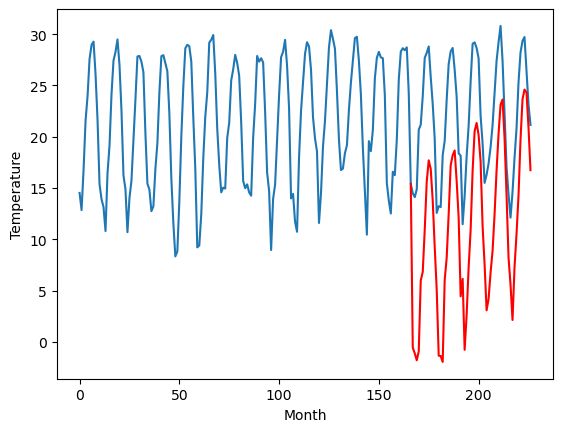

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.10		-2.25		0.85
-3.21		-3.01		0.20
-3.83		-3.67		0.16
-3.21		-2.92		0.29
3.04		4.15		1.11
2.80		5.17		2.37
6.49		9.85		3.36
10.21		15.09		4.88
12.58		17.44		4.86
11.82		16.25		4.43
8.43		12.69		4.26
4.71		7.63		2.92
-0.22		3.39		3.61
-7.22		-3.13		4.09
-6.40		-3.52		2.88
-5.54		-4.61		0.93
0.44		4.13		3.69
2.08		6.65		4.57
6.06		11.06		5.00
10.20		16.49		6.29
11.96		17.50		5.54
12.24		18.03		5.79
8.67		14.77		6.10
4.79		10.93		6.14
-3.57		2.76		6.33
-1.39		4.02		5.41
-7.40		-3.33		4.07
-3.45		0.17		3.62
0.05		5.28		5.23
2.79		9.11		6.32
8.55		15.54		6.99
12.33		19.67		7.34
13.25		20.86		7.61
12.02		19.64		7.62
8.90		16.59		7.69
1.76		9.99		8.23
-0.72		5.88		6.60
-5.24		1.04		6.28
-3.29		2.37		5.66
-0.51		4.47		4.98
-0.53		6.64		7.17
2.54		11.02		8.48
5.95		15.62		9.67
9.27		19.39		10.12
12.37		22.48		10.11
11.98		22.60		10.62
8.53		18.88		10.35
2.55		13.14		10.59
-2.54		6.53		9.07
-5.57		4

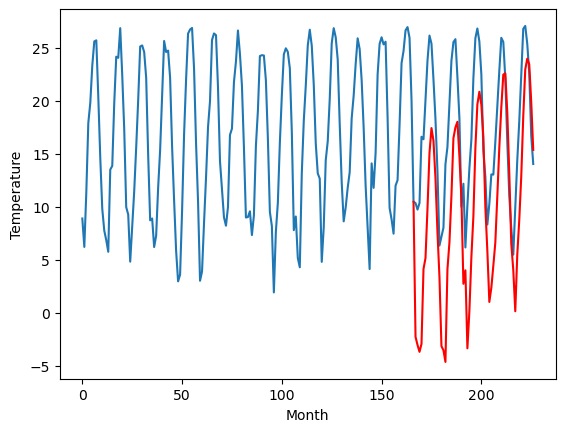

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.49		-2.48		0.01
-2.51		-3.00		-0.49
-2.47		-3.56		-1.09
-2.47		-2.95		-0.48
4.45		5.24		0.79
4.53		5.71		1.18
7.42		10.08		2.66
10.33		14.65		4.32
11.30		16.37		5.07
11.64		15.65		4.01
9.31		11.82		2.51
5.25		6.73		1.48
2.41		2.85		0.44
-5.05		-3.70		1.35
-4.96		-3.61		1.35
-6.53		-5.45		1.08
1.38		4.46		3.08
3.17		6.01		2.84
7.14		10.30		3.16
10.42		15.41		4.99
11.05		16.24		5.19
11.10		16.85		5.75
8.59		14.22		5.63
6.28		10.02		3.74
-1.81		2.56		4.37
0.96		5.14		4.18
-6.39		-2.75		3.64
-3.95		-0.41		3.54
-0.16		5.18		5.34
4.63		9.94		5.31
9.15		15.46		6.31
11.58		19.63		8.05
11.56		20.74		9.18
10.37		18.63		8.26
9.13		15.95		6.82
3.51		9.34		5.83
-0.60		4.18		4.78
-2.78		0.86		3.64
-1.34		1.65		2.99
-0.93		4.12		5.05
2.59		7.19		4.60
4.01		10.02		6.01
8.44		15.27		6.83
12.19		19.19		7.00
13.31		21.51		8.20
14.84		22.94		8.10
11.40		18.73		7.33
5.15		11.94		6.79
-0.71		5.73		6.44
-3.50		2

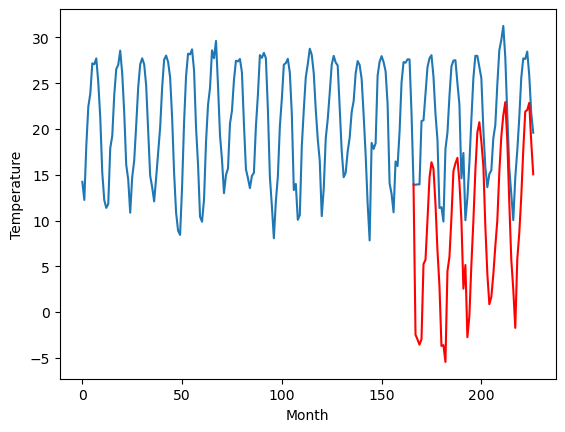

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.32		5.24		-0.08
3.27		4.22		0.95
4.01		3.75		-0.26
3.34		4.09		0.75
11.09		13.21		2.12
11.34		14.00		2.66
16.32		19.46		3.14
20.52		24.60		4.08
22.13		26.45		4.32
22.62		25.65		3.03
16.91		20.45		3.54
12.03		13.98		1.95
9.51		10.03		0.52
3.04		3.65		0.61
2.16		3.56		1.40
-0.93		0.04		0.97
8.97		12.12		3.15
10.90		13.82		2.92
14.76		18.39		3.63
19.96		24.90		4.94
20.39		25.80		5.41
21.15		26.20		5.05
19.14		23.51		4.37
14.79		18.01		3.22
7.22		10.67		3.45
9.55		12.50		2.95
1.10		4.08		2.98
0.87		5.36		4.49
7.36		12.31		4.95
13.40		18.09		4.69
18.11		24.05		5.94
22.45		29.04		6.59
24.81		31.06		6.25
22.45		28.37		5.92
19.50		25.07		5.57
13.58		17.69		4.11
6.65		10.23		3.58
3.92		7.49		3.57
4.89		8.18		3.29
5.02		9.80		4.78
9.74		13.87		4.13
11.24		17.41		6.17
16.77		24.11		7.34
21.32		28.40		7.08
24.31		30.78		6.47
26.05		32.44		6.39
21.57		27.76		6.19
13.91		19.67		5.76
7.55		12.90		5.35
4.7

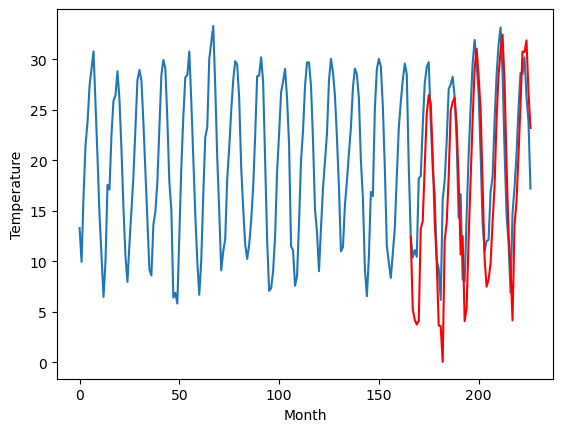

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.85		5.49		-0.36
5.28		4.49		-0.79
4.75		3.90		-0.85
4.44		4.78		0.34
8.03		10.99		2.96
10.00		12.37		2.37
13.69		17.22		3.53
18.04		22.63		4.59
21.78		25.39		3.61
20.93		24.10		3.17
17.90		20.72		2.82
13.81		15.78		1.97
9.69		11.12		1.43
2.94		4.78		1.84
1.16		4.21		3.05
1.81		3.78		1.97
6.71		11.30		4.59
10.08		14.39		4.31
13.59		18.84		5.25
18.16		24.33		6.17
20.15		25.54		5.39
20.63		25.90		5.27
17.62		22.36		4.74
14.02		18.64		4.62
5.85		10.35		4.50
6.90		10.80		3.90
0.52		4.09		3.57
4.13		8.13		4.00
8.05		12.80		4.75
10.92		16.08		5.16
15.55		22.73		7.18
19.12		26.86		7.74
21.26		28.21		6.95
20.41		27.55		7.14
17.76		24.32		6.56
11.20		17.73		6.53
9.51		14.12		4.61
2.99		8.66		5.67
4.68		10.28		5.60
6.17		12.02		5.85
7.08		13.75		6.67
11.76		18.90		7.14
13.28		23.05		9.77
17.10		26.69		9.59
20.93		30.39		9.46
20.45		29.79		9.34
16.93		26.28		9.35
12.58		21.17		8.59
7.14		14.37		7.23
5.

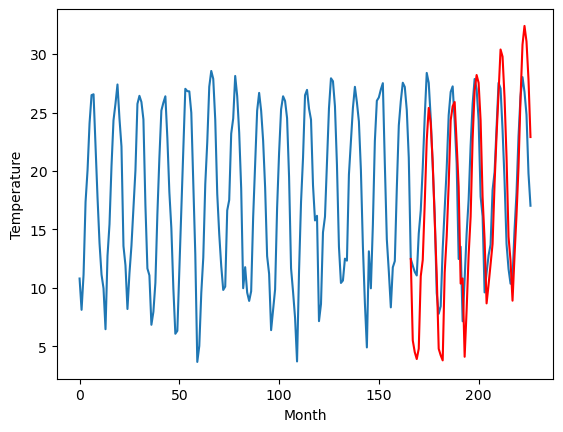

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.20		-0.03		1.17
-1.56		-0.98		0.58
-2.03		-1.60		0.43
-0.92		-0.81		0.11
4.50		5.86		1.36
5.74		7.14		1.40
8.08		12.08		4.00
13.33		17.57		4.24
16.40		20.21		3.81
15.37		18.88		3.51
11.48		15.27		3.79
7.48		10.07		2.59
3.30		5.60		2.30
-3.63		-0.84		2.79
-4.21		-1.41		2.80
-3.57		-2.34		1.23
3.41		6.03		2.62
4.44		8.96		4.52
8.15		13.43		5.28
12.48		19.11		6.63
14.10		20.23		6.13
14.04		20.67		6.63
9.99		17.20		7.21
6.76		13.31		6.55
-1.89		4.96		6.85
0.05		5.63		5.58
-6.60		-1.49		5.11
-2.62		2.29		4.91
1.72		7.31		5.59
4.64		10.91		6.27
9.71		17.65		7.94
13.62		21.87		8.25
14.72		23.26		8.54
13.43		22.32		8.89
10.37		19.05		8.68
3.43		12.36		8.93
1.20		8.35		7.15
-5.31		3.10		8.41
-2.12		4.63		6.75
0.88		6.41		5.53
1.36		8.40		7.04
4.92		13.43		8.51
7.61		17.92		10.31
10.96		21.68		10.72
14.67		25.15		10.48
13.98		24.80		10.82
10.47		21.19		10.72
5.26		15.70		10.44
-0.61		8.87		9.48
-2.9

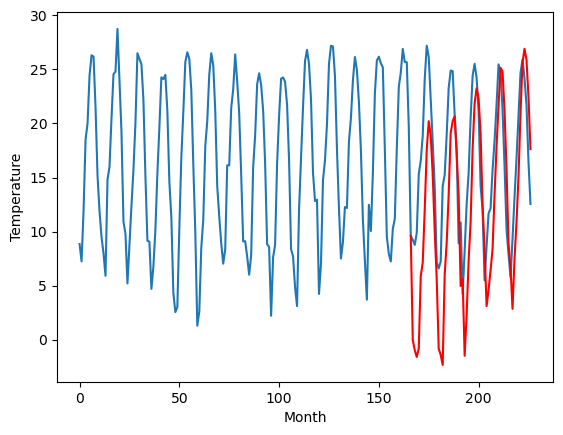

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.01		5.16		1.15
3.64		4.10		0.46
3.52		3.49		-0.03
4.56		4.26		-0.30
10.14		10.85		0.71
11.04		12.26		1.22
14.16		17.44		3.28
19.68		23.13		3.45
22.94		25.96		3.02
21.57		24.49		2.92
16.70		20.75		4.05
12.86		15.37		2.51
8.63		10.79		2.16
1.70		4.36		2.66
0.76		3.63		2.87
1.38		2.62		1.24
7.90		11.06		3.16
11.53		14.22		2.69
14.55		18.73		4.18
19.34		24.68		5.34
21.46		25.84		4.38
21.41		26.25		4.84
16.90		22.64		5.74
13.05		18.67		5.62
3.55		10.14		6.59
5.61		10.51		4.90
-1.57		3.35		4.92
2.67		7.24		4.57
7.51		12.35		4.84
10.83		15.94		5.11
15.81		22.94		7.13
19.81		27.25		7.44
21.68		28.80		7.12
20.00		27.94		7.94
16.30		24.47		8.17
9.11		17.67		8.56
6.91		13.60		6.69
-0.26		8.13		8.39
2.91		9.77		6.86
5.88		11.31		5.43
6.56		13.27		6.71
11.18		18.70		7.52
13.47		23.23		9.76
17.22		27.03		9.81
21.36		30.68		9.32
20.22		30.09		9.87
16.46		26.52		10.06
11.07		21.07		10.00
4.62		14.04		9.42


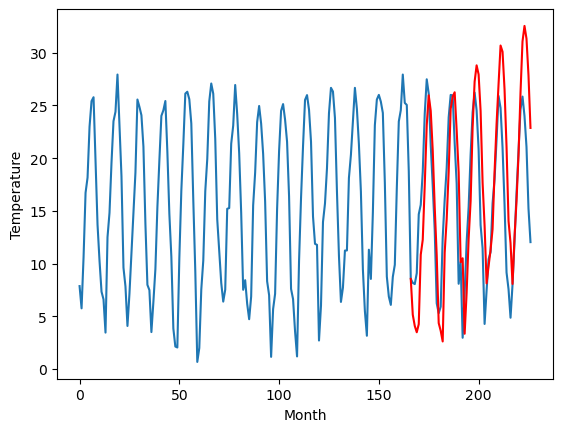

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.48		5.40		0.92
4.32		4.30		-0.02
3.13		3.29		0.16
3.63		3.62		-0.01
10.20		12.50		2.30
12.48		13.85		1.37
17.36		19.70		2.34
23.29		26.15		2.86
26.03		28.13		2.10
23.02		26.65		3.63
19.46		21.57		2.11
12.20		14.45		2.25
9.34		10.96		1.62
2.63		4.21		1.58
1.84		3.48		1.64
-2.43		-0.71		1.72
10.04		12.57		2.53
12.64		14.99		2.35
17.33		19.74		2.41
23.52		27.01		3.49
24.09		27.75		3.66
24.03		28.18		4.15
20.29		24.91		4.62
16.33		19.69		3.36
6.29		11.11		4.82
8.09		11.53		3.44
-0.42		2.82		3.24
1.62		5.22		3.60
8.84		12.40		3.56
12.79		17.45		4.66
19.63		25.02		5.39
24.15		30.08		5.93
26.48		31.79		5.31
23.60		29.69		6.09
19.96		26.07		6.11
13.40		18.54		5.14
7.43		11.72		4.29
2.14		6.95		4.81
4.70		8.09		3.39
6.31		9.83		3.52
8.13		13.08		4.95
13.91		18.36		4.45
19.50		25.22		5.72
23.37		29.48		6.11
24.86		31.59		6.73
23.60		32.50		8.90
20.43		28.31		7.88
14.83		20.66		5.83
7.84		13.54		5.70


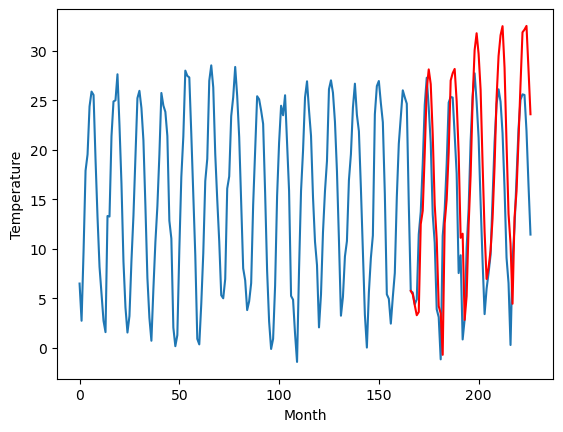

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.26		1.90		2.16
-0.08		0.76		0.84
-1.36		-0.24		1.12
-2.23		0.23		2.46
4.96		8.03		3.07
6.62		9.65		3.03
11.71		15.51		3.80
18.69		22.19		3.50
21.32		24.71		3.39
18.94		22.91		3.97
15.27		18.41		3.14
8.88		11.71		2.83
5.20		7.85		2.65
-2.31		1.10		3.41
-3.90		0.02		3.92
-6.07		-3.08		2.99
4.68		8.62		3.94
7.74		11.76		4.02
12.21		16.46		4.25
18.69		23.60		4.91
19.70		24.45		4.75
20.30		24.91		4.61
16.44		21.23		4.79
11.97		16.64		4.67
1.31		7.48		6.17
2.54		7.31		4.77
-6.43		-0.94		5.49
-2.85		2.57		5.42
4.13		8.99		4.86
6.86		13.15		6.29
15.03		21.19		6.16
18.93		25.98		7.05
20.96		27.57		6.61
19.05		26.27		7.22
15.32		22.49		7.17
8.28		15.18		6.90
3.26		9.78		6.52
-2.45		3.92		6.37
-0.56		5.49		6.05
1.48		7.04		5.56
1.82		9.44		7.62
8.10		15.60		7.50
13.06		21.50		8.44
16.90		25.59		8.69
19.73		28.37		8.64
18.93		28.22		9.29
16.32		24.51		8.19
9.74		18.01		8.27
3.24		10.69		7.45
0.81		8.

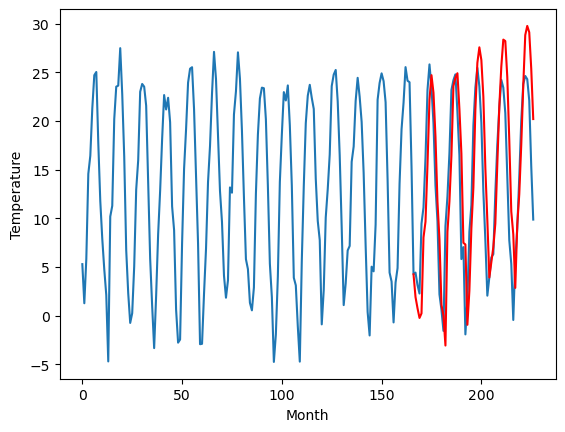

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.50		0.05		1.55
-2.17		-1.31		0.86
-3.20		-2.51		0.69
-4.66		-2.09		2.57
1.48		5.77		4.29
4.13		7.76		3.63
10.56		14.07		3.51
18.52		21.36		2.84
21.68		23.91		2.23
18.99		21.96		2.97
14.16		17.21		3.05
7.41		9.90		2.49
3.93		6.19		2.26
-3.10		-0.56		2.54
-4.71		-1.85		2.86
-9.02		-5.63		3.39
2.71		6.90		4.19
6.68		10.36		3.68
11.83		15.24		3.41
19.14		23.00		3.86
19.73		23.80		4.07
20.44		24.13		3.69
16.39		20.26		3.87
12.04		15.37		3.33
1.18		5.97		4.79
0.28		4.82		4.54
-8.67		-3.38		5.29
-5.43		0.18		5.61
1.48		6.94		5.46
5.09		10.99		5.90
14.41		19.62		5.21
19.17		24.65		5.48
20.28		26.34		6.06
19.16		25.21		6.05
15.32		21.19		5.87
8.08		13.67		5.59
3.05		7.81		4.76
-3.13		1.36		4.49
-2.00		3.05		5.05
-1.59		4.43		6.02
0.27		6.83		6.56
7.12		13.83		6.71
12.14		20.25		8.11
17.65		24.39		6.74
20.11		27.04		6.93
18.30		26.75		8.45
15.92		23.08		7.16
9.96		16.40		6.44
2.32		8.89		6.57
1.64	

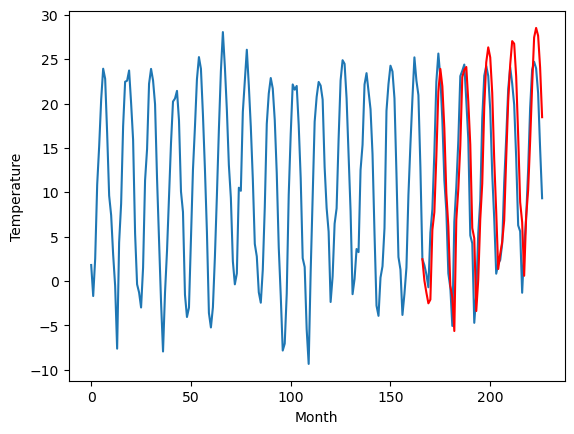

RangeIndex(start=1, stop=12, step=1)
[0.5800000000000001, -0.9500000000000002, -3.0999999999999996, -2.490000000000002, 5.320000000000001, 5.850000000000001, -1.200000000000001, 4.010000000000003, 4.48, -0.2599999999999998, -1.5000000000000018]
[1.0305558204650875, -0.5687693405151366, -2.2468373870849607, -2.47981258392334, 5.241445503234864, 5.492343444824218, -0.032650794982910014, 5.156749229431153, 5.396988201141358, 1.9035215759277335, 0.05207595825195277]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.58   1.030556
1                 1   -0.95  -0.568769
2                 2   -3.10  -2.246837
3                 3   -2.49  -2.479813
4                 4    5.32   5.241446
5                 5    5.85   5.492343
6                 6   -1.20  -0.032651
7                 7    4.01   5.156749
8                 8    4.48   5.396988
9                 9   -0.26   1.903522
10               10   -1.50   0.052076


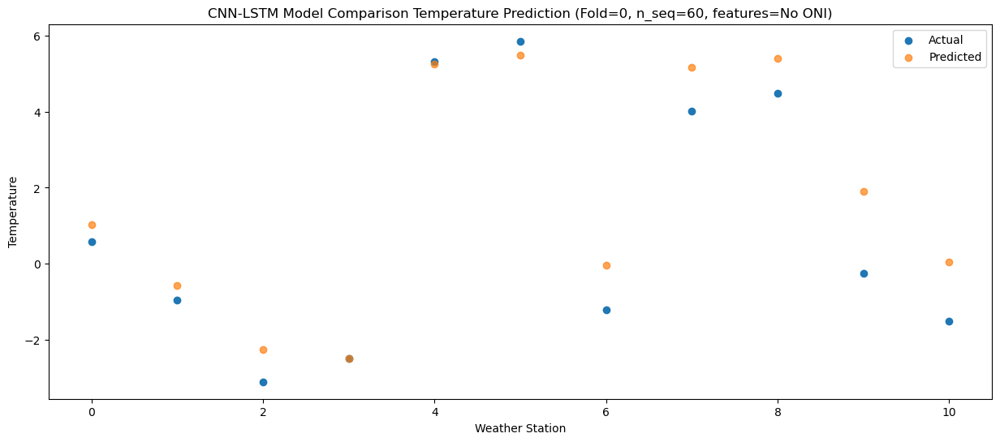

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.11   0.176436
1                 1   -1.85  -1.124317
2                 2   -3.21  -3.011585
3                 3   -2.51  -2.996191
4                 4    3.27   4.218513
5                 5    5.28   4.485024
6                 6   -1.56  -0.976522
7                 7    3.64   4.096523
8                 8    4.32   4.298143
9                 9   -0.08   0.760335
10               10   -2.17  -1.309060


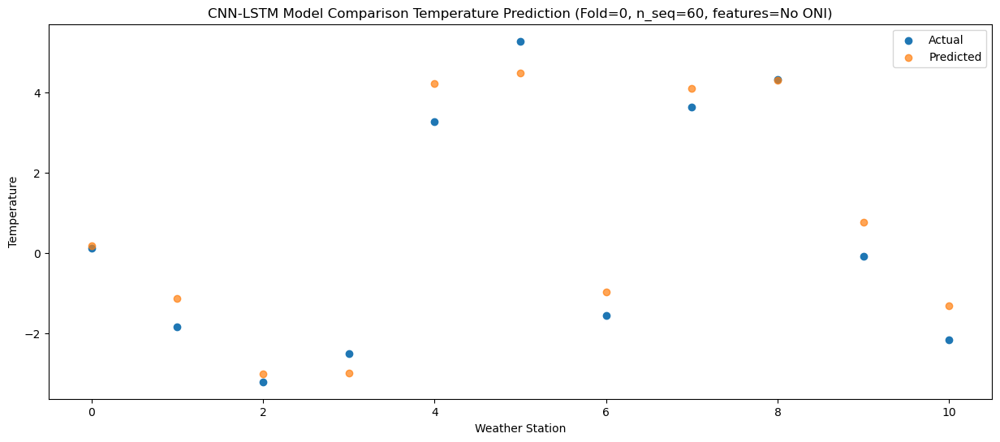

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.16  -0.468455
1                 1   -2.23  -1.801851
2                 2   -3.83  -3.665303
3                 3   -2.47  -3.564400
4                 4    4.01   3.745238
5                 5    4.75   3.896206
6                 6   -2.03  -1.602697
7                 7    3.52   3.492119
8                 8    3.13   3.288778
9                 9   -1.36  -0.239598
10               10   -3.20  -2.510814


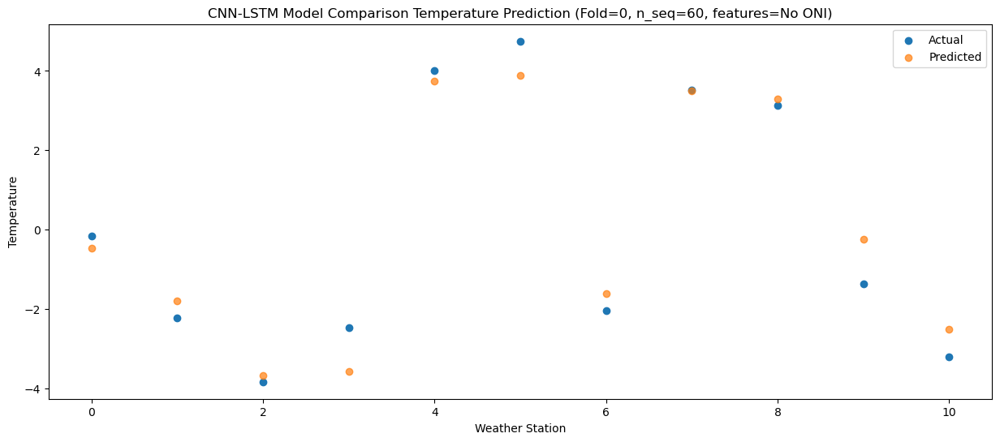

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.19  -0.052668
1                 1   -1.48  -0.922459
2                 2   -3.21  -2.915858
3                 3   -2.47  -2.950739
4                 4    3.34   4.090301
5                 5    4.44   4.783914
6                 6   -0.92  -0.814428
7                 7    4.56   4.259380
8                 8    3.63   3.615466
9                 9   -2.23   0.229784
10               10   -4.66  -2.086540


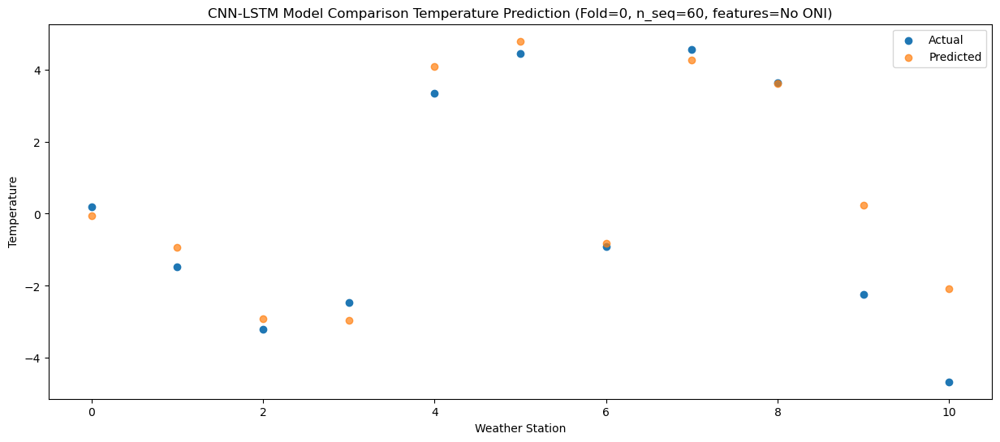

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.77   8.615137
1                 1    4.35   5.976503
2                 2    3.04   4.147776
3                 3    4.45   5.242644
4                 4   11.09  13.206428
5                 5    8.03  10.985949
6                 6    4.50   5.859626
7                 7   10.14  10.845996
8                 8   10.20  12.495658
9                 9    4.96   8.033248
10               10    1.48   5.767195


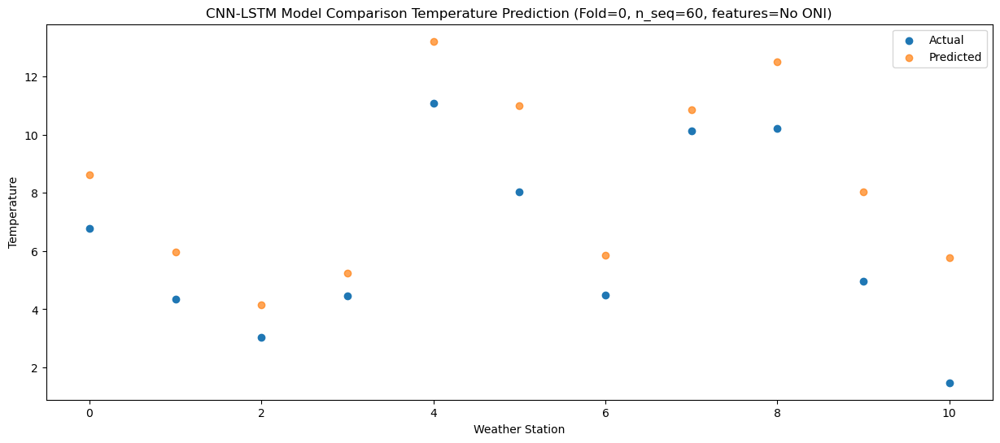

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    7.42   9.445641
1                 1    4.84   6.815541
2                 2    2.80   5.171884
3                 3    4.53   5.710983
4                 4   11.34  14.002111
5                 5   10.00  12.371315
6                 6    5.74   7.142279
7                 7   11.04  12.260872
8                 8   12.48  13.852426
9                 9    6.62   9.650459
10               10    4.13   7.763581


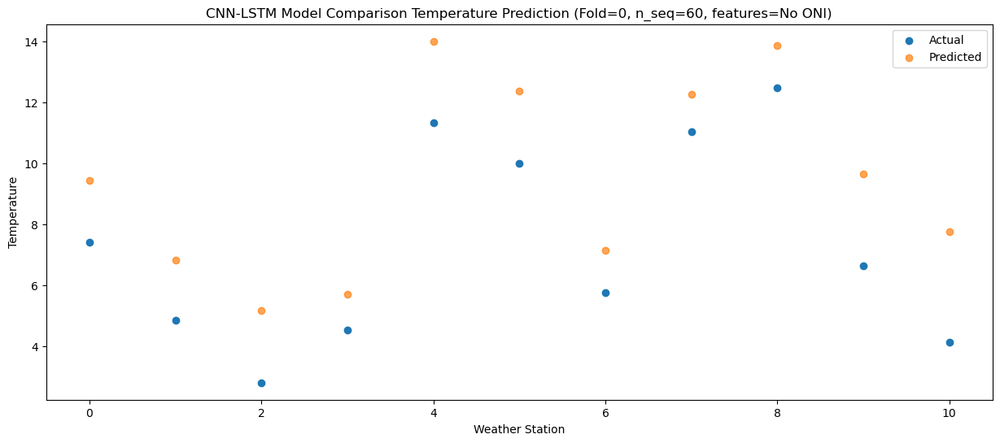

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.15  14.654671
1                 1    7.61  10.933904
2                 2    6.49   9.849104
3                 3    7.42  10.080988
4                 4   16.32  19.463751
5                 5   13.69  17.222197
6                 6    8.08  12.082715
7                 7   14.16  17.439549
8                 8   17.36  19.698244
9                 9   11.71  15.510779
10               10   10.56  14.068707


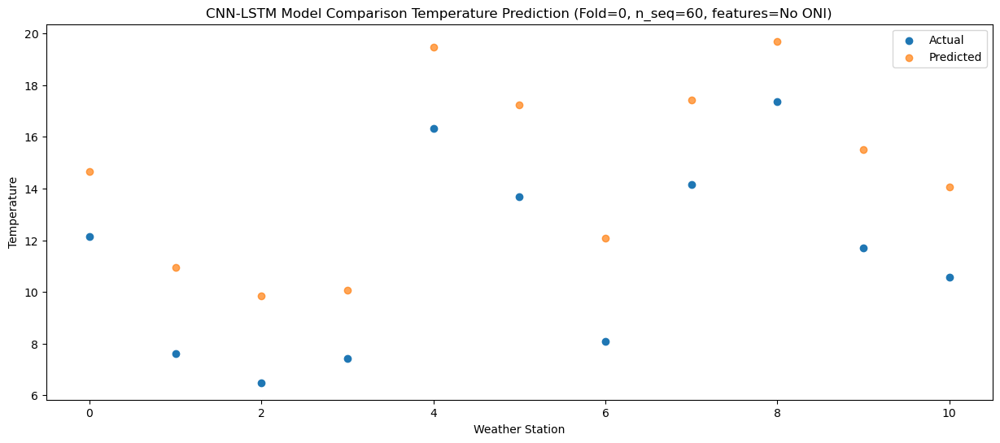

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   16.37  20.074711
1                 1   11.36  15.630190
2                 2   10.21  15.085949
3                 3   10.33  14.654714
4                 4   20.52  24.597925
5                 5   18.04  22.630881
6                 6   13.33  17.566484
7                 7   19.68  23.132244
8                 8   23.29  26.148014
9                 9   18.69  22.192957
10               10   18.52  21.355663


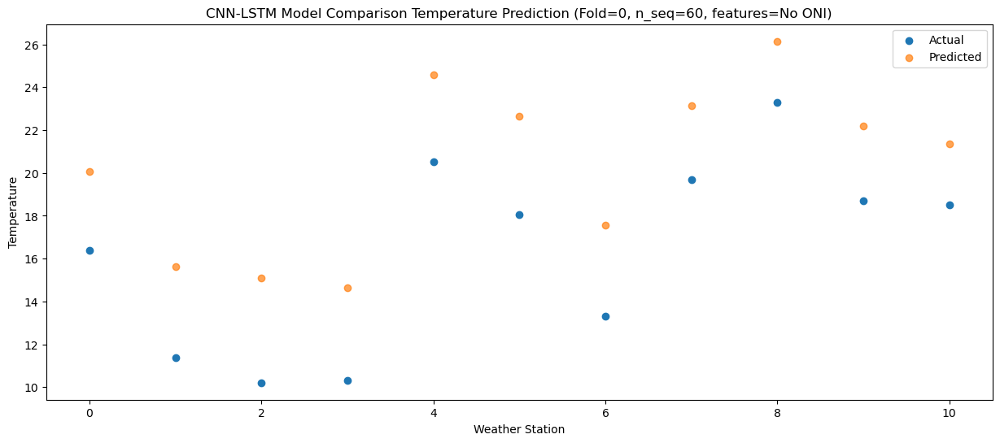

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.82  22.037704
1                 1   11.84  17.696693
2                 2   12.58  17.438738
3                 3   11.30  16.368098
4                 4   22.13  26.447866
5                 5   21.78  25.394403
6                 6   16.40  20.211433
7                 7   22.94  25.956479
8                 8   26.03  28.131689
9                 9   21.32  24.713531
10               10   21.68  23.907273


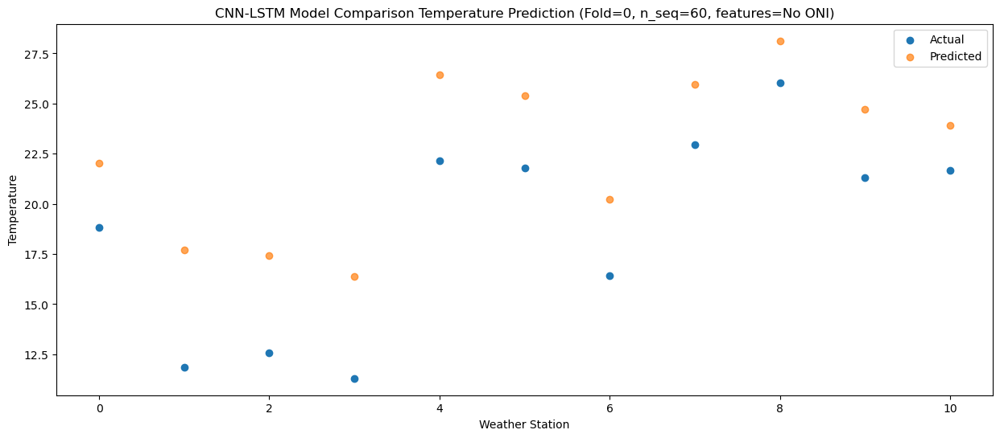

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.19  20.921158
1                 1   12.47  16.867953
2                 2   11.82  16.247571
3                 3   11.64  15.652122
4                 4   22.62  25.652707
5                 5   20.93  24.096179
6                 6   15.37  18.877559
7                 7   21.57  24.491755
8                 8   23.02  26.649205
9                 9   18.94  22.912406
10               10   18.99  21.956971


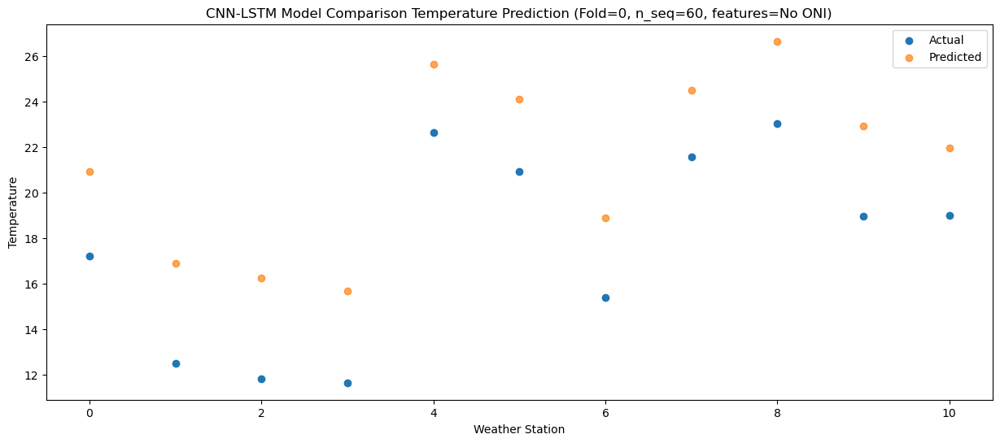

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.13  16.253819
1                 1    9.49  13.776722
2                 2    8.43  12.693352
3                 3    9.31  11.818013
4                 4   16.91  20.447641
5                 5   17.90  20.723990
6                 6   11.48  15.266435
7                 7   16.70  20.751605
8                 8   19.46  21.567675
9                 9   15.27  18.408585
10               10   14.16  17.211337


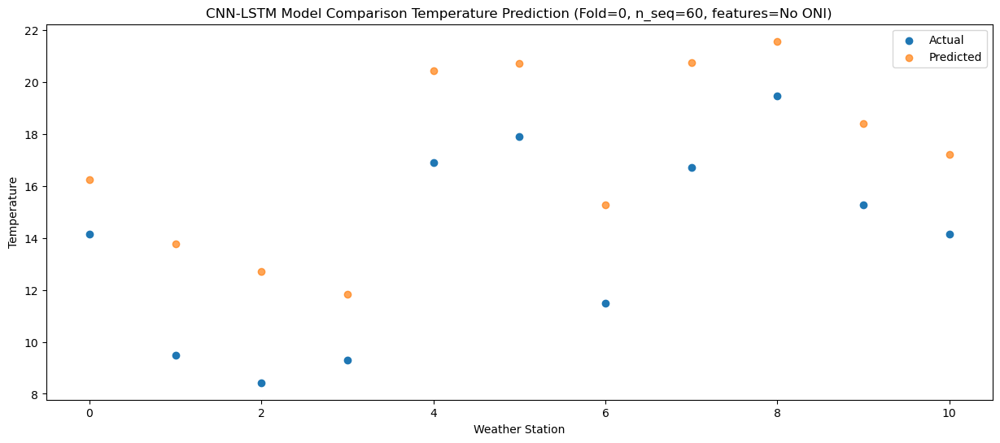

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63  10.118767
1                 1    6.86   9.260705
2                 2    4.71   7.630238
3                 3    5.25   6.731307
4                 4   12.03  13.975602
5                 5   13.81  15.781160
6                 6    7.48  10.071593
7                 7   12.86  15.369724
8                 8   12.20  14.445125
9                 9    8.88  11.705881
10               10    7.41   9.902202


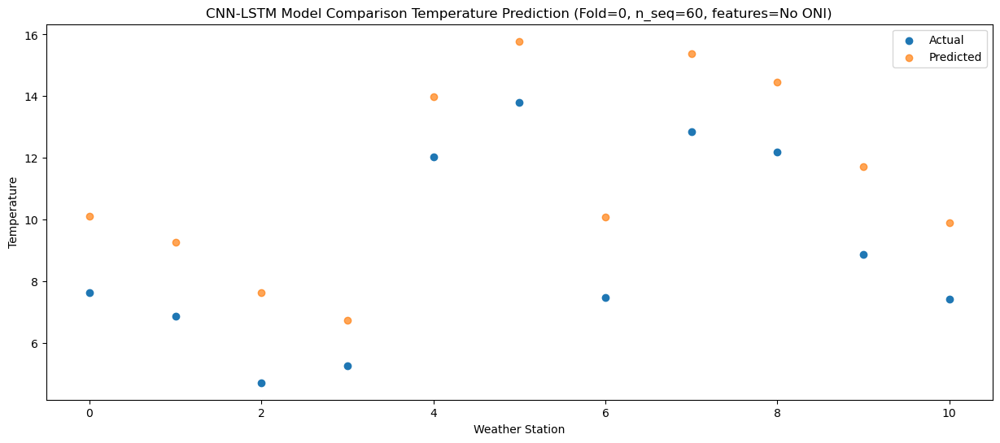

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.39   6.299604
1                 1    3.44   5.089052
2                 2   -0.22   3.389448
3                 3    2.41   2.847381
4                 4    9.51  10.033059
5                 5    9.69  11.117722
6                 6    3.30   5.603043
7                 7    8.63  10.791983
8                 8    9.34  10.961440
9                 9    5.20   7.851975
10               10    3.93   6.187485


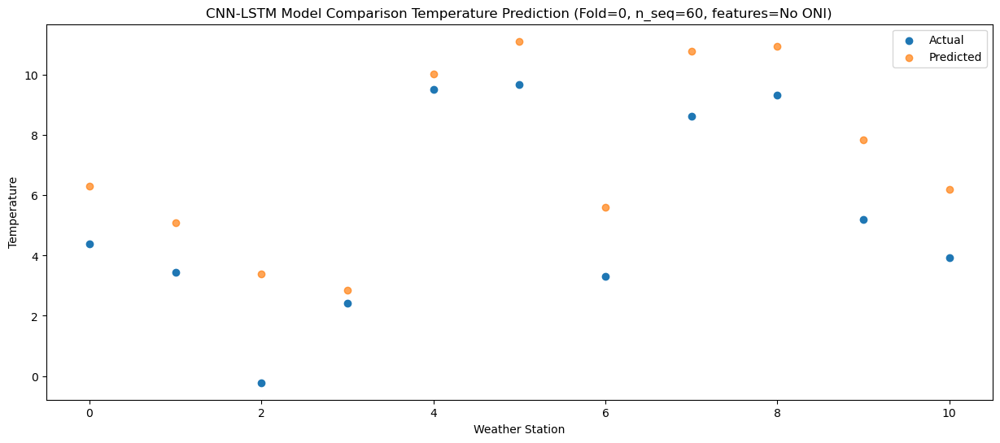

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.23  -0.325749
1                 1   -3.77  -1.351447
2                 2   -7.22  -3.125234
3                 3   -5.05  -3.699614
4                 4    3.04   3.647978
5                 5    2.94   4.775771
6                 6   -3.63  -0.835743
7                 7    1.70   4.362856
8                 8    2.63   4.213345
9                 9   -2.31   1.102054
10               10   -3.10  -0.556853


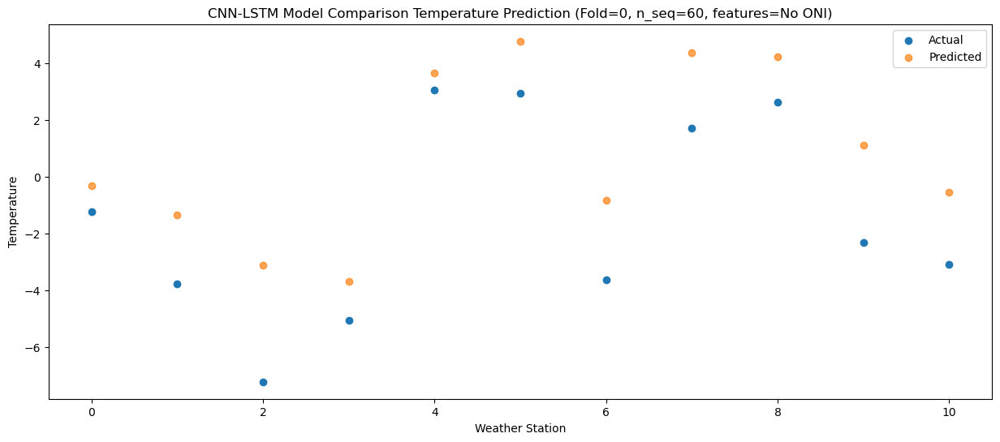

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.09  -0.662970
1                 1   -3.11  -1.390677
2                 2   -6.40  -3.516140
3                 3   -4.96  -3.610947
4                 4    2.16   3.563759
5                 5    1.16   4.213189
6                 6   -4.21  -1.410964
7                 7    0.76   3.628837
8                 8    1.84   3.480874
9                 9   -3.90   0.016073
10               10   -4.71  -1.853082


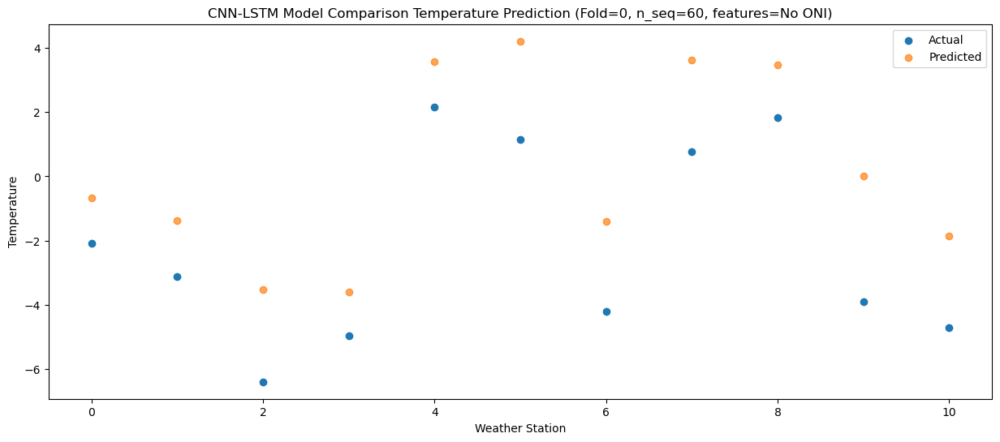

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -5.44  -3.687814
1                 1   -3.20  -1.963700
2                 2   -5.54  -4.613616
3                 3   -6.53  -5.446257
4                 4   -0.93   0.038538
5                 5    1.81   3.780577
6                 6   -3.57  -2.335705
7                 7    1.38   2.620813
8                 8   -2.43  -0.712185
9                 9   -6.07  -3.076022
10               10   -9.02  -5.631981


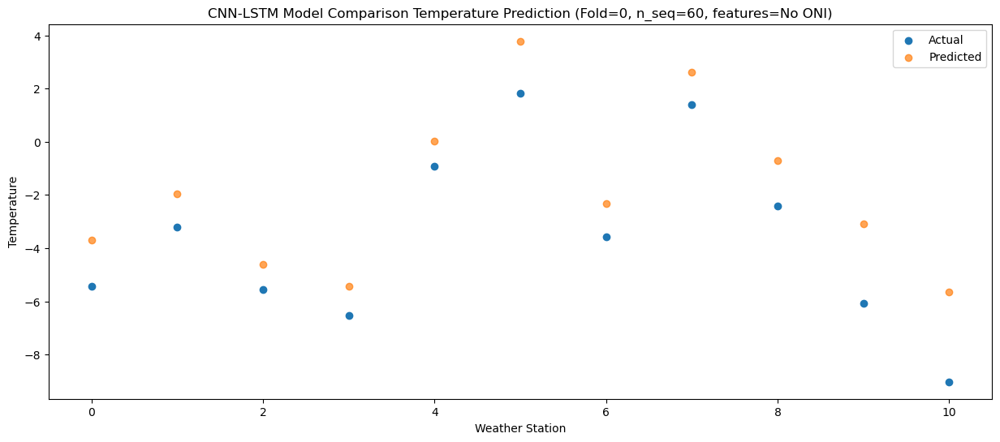

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.63   7.926395
1                 1    1.86   6.020184
2                 2    0.44   4.128232
3                 3    1.38   4.461743
4                 4    8.97  12.123819
5                 5    6.71  11.296832
6                 6    3.41   6.025173
7                 7    7.90  11.055475
8                 8   10.04  12.572654
9                 9    4.68   8.616093
10               10    2.71   6.895008


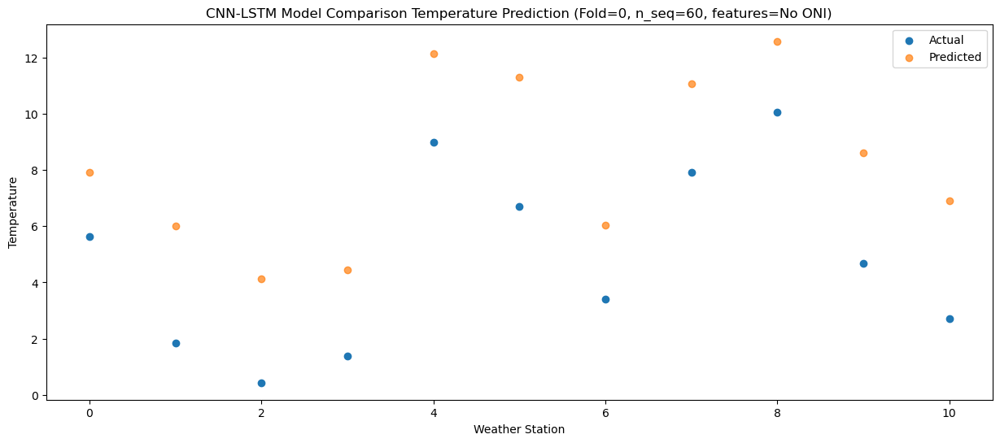

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.16   9.874648
1                 1    3.26   8.196227
2                 2    2.08   6.650409
3                 3    3.17   6.011106
4                 4   10.90  13.824329
5                 5   10.08  14.387477
6                 6    4.44   8.960007
7                 7   11.53  14.220007
8                 8   12.64  14.994948
9                 9    7.74  11.755889
10               10    6.68  10.363660


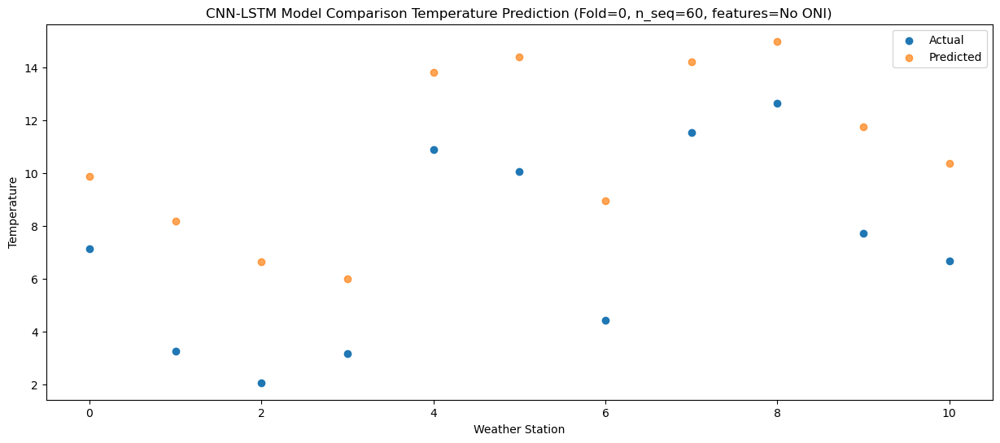

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   11.66  14.399878
1                 1    7.28  12.474163
2                 2    6.06  11.056311
3                 3    7.14  10.302507
4                 4   14.76  18.388634
5                 5   13.59  18.840103
6                 6    8.15  13.426078
7                 7   14.55  18.725644
8                 8   17.33  19.739021
9                 9   12.21  16.464191
10               10   11.83  15.238147


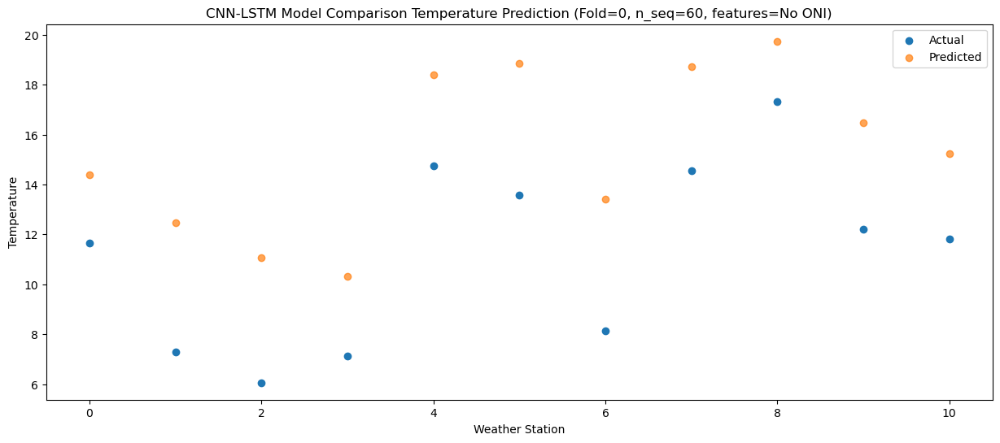

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.33  20.685078
1                 1   10.76  17.213550
2                 2   10.20  16.487841
3                 3   10.42  15.410671
4                 4   19.96  24.896059
5                 5   18.16  24.334287
6                 6   12.48  19.107227
7                 7   19.34  24.680899
8                 8   23.52  27.013362
9                 9   18.69  23.599139
10               10   19.14  22.999646


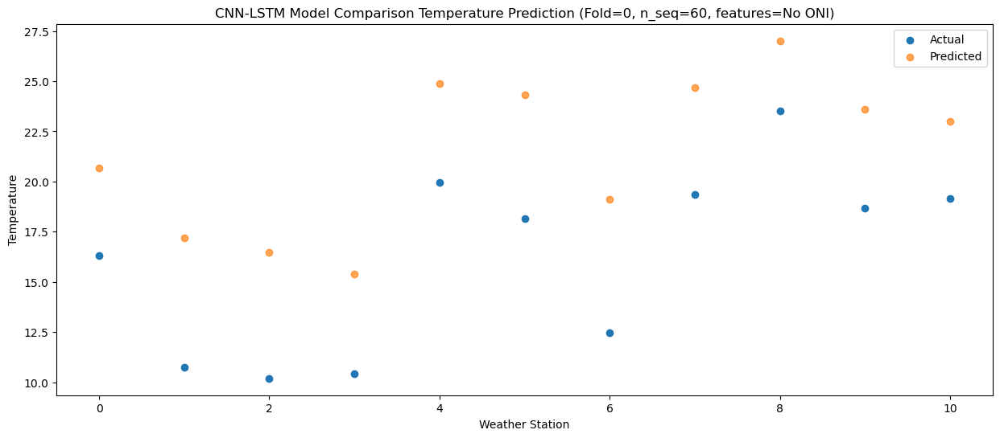

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.92  21.511427
1                 1   11.98  18.197249
2                 2   11.96  17.501951
3                 3   11.05  16.243108
4                 4   20.39  25.799838
5                 5   20.15  25.538951
6                 6   14.10  20.226540
7                 7   21.46  25.836498
8                 8   24.09  27.746287
9                 9   19.70  24.445961
10               10   19.73  23.800757


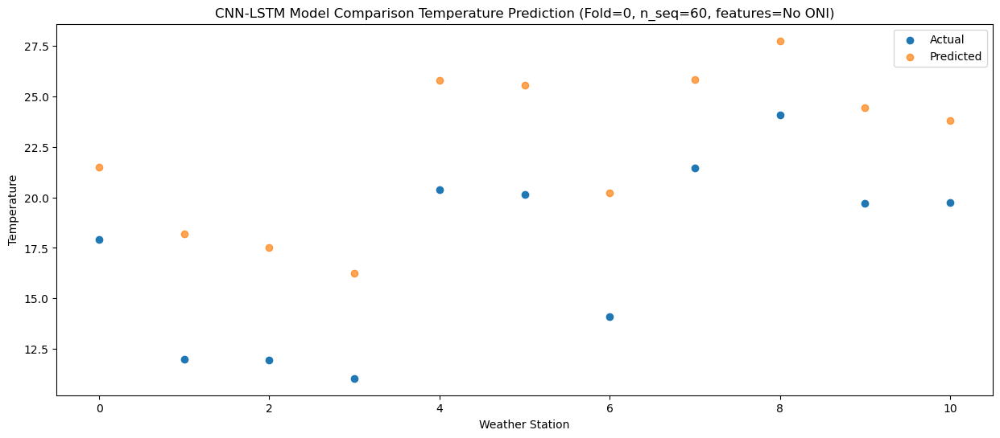

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.03  22.070569
1                 1   12.32  18.663640
2                 2   12.24  18.030264
3                 3   11.10  16.847418
4                 4   21.15  26.197900
5                 5   20.63  25.900480
6                 6   14.04  20.667827
7                 7   21.41  26.249366
8                 8   24.03  28.179463
9                 9   20.30  24.913191
10               10   20.44  24.126696


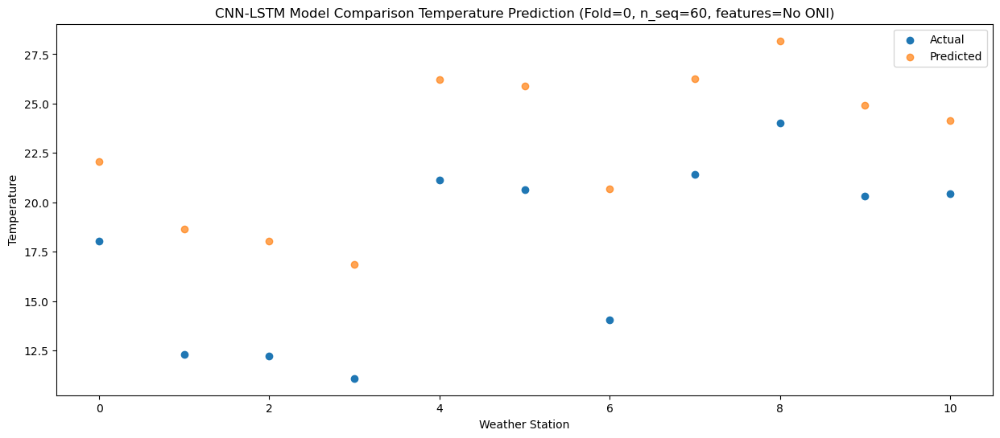

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.45  19.130770
1                 1   10.19  15.673653
2                 2    8.67  14.767357
3                 3    8.59  14.215058
4                 4   19.14  23.510173
5                 5   17.62  22.361179
6                 6    9.99  17.195759
7                 7   16.90  22.639824
8                 8   20.29  24.913114
9                 9   16.44  21.228158
10               10   16.39  20.258299


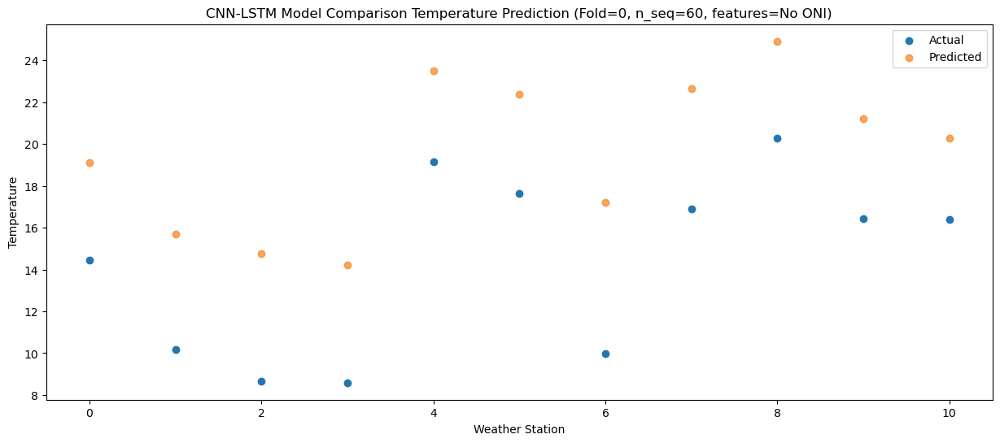

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.43  14.283822
1                 1    7.56  12.110433
2                 2    4.79  10.933623
3                 3    6.28  10.024371
4                 4   14.79  18.007100
5                 5   14.02  18.635935
6                 6    6.76  13.312689
7                 7   13.05  18.668132
8                 8   16.33  19.692676
9                 9   11.97  16.639985
10               10   12.04  15.366458


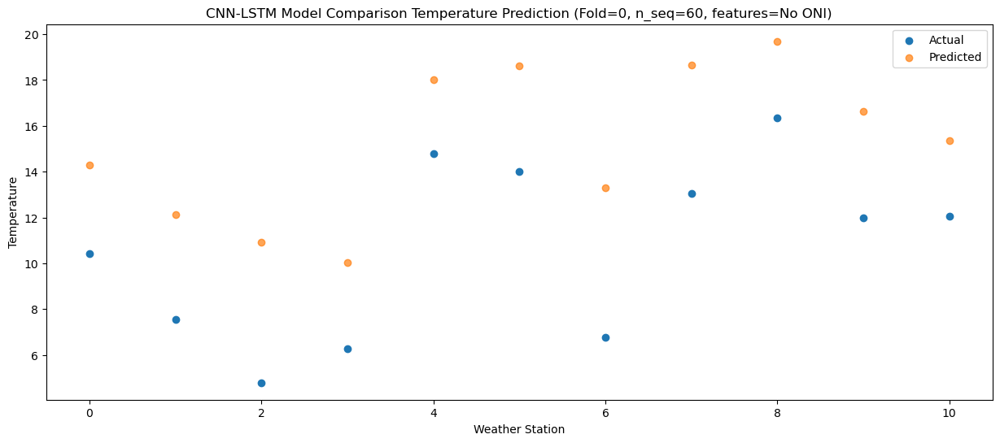

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.67   6.295825
1                 1    2.05   4.432855
2                 2   -3.57   2.755269
3                 3   -1.81   2.556063
4                 4    7.22  10.673793
5                 5    5.85  10.353686
6                 6   -1.89   4.963106
7                 7    3.55  10.140361
8                 8    6.29  11.112745
9                 9    1.31   7.480738
10               10    1.18   5.967524


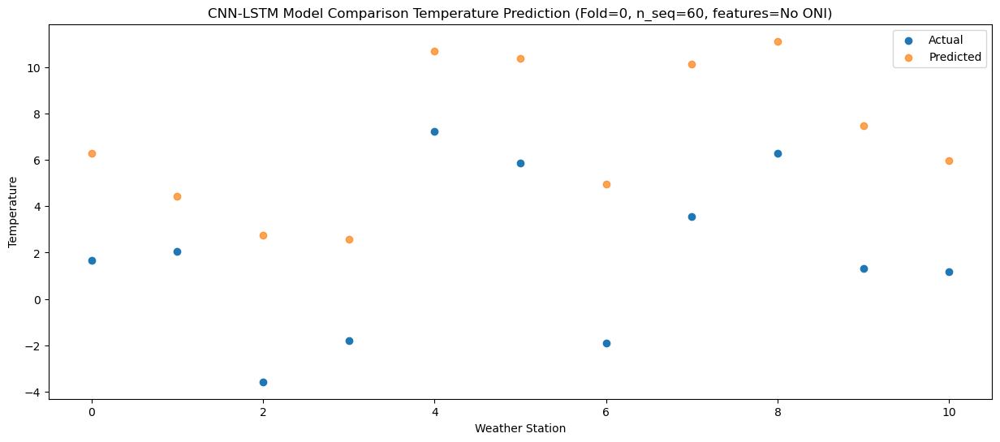

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    5.05   8.056529
1                 1    1.81   6.137091
2                 2   -1.39   4.023893
3                 3    0.96   5.142819
4                 4    9.55  12.499406
5                 5    6.90  10.798694
6                 6    0.05   5.631182
7                 7    5.61  10.509912
8                 8    8.09  11.530086
9                 9    2.54   7.309905
10               10    0.28   4.824322


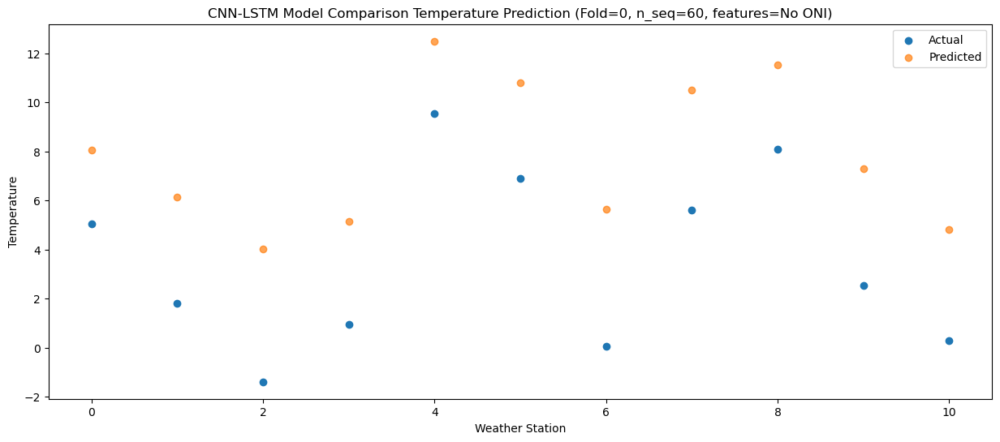

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -0.432751
1                 1   -4.87  -0.785698
2                 2   -7.40  -3.330500
3                 3   -6.39  -2.746664
4                 4    1.10   4.082135
5                 5    0.52   4.090527
6                 6   -6.60  -1.489606
7                 7   -1.57   3.350921
8                 8   -0.42   2.815486
9                 9   -6.43  -0.944983
10               10   -8.67  -3.379228


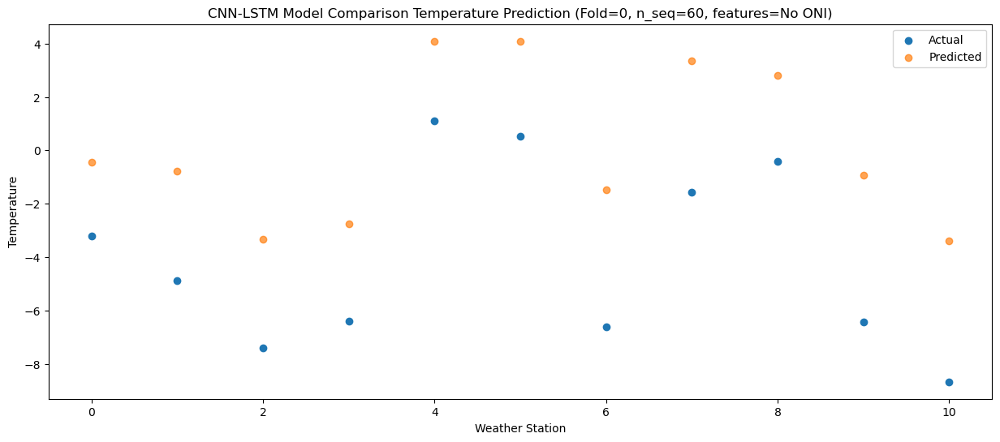

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.68   1.761617
1                 1   -2.10   2.614405
2                 2   -3.45   0.171592
3                 3   -3.95  -0.414154
4                 4    0.87   5.361324
5                 5    4.13   8.130179
6                 6   -2.62   2.290298
7                 7    2.67   7.241008
8                 8    1.62   5.221125
9                 9   -2.85   2.568425
10               10   -5.43   0.182585


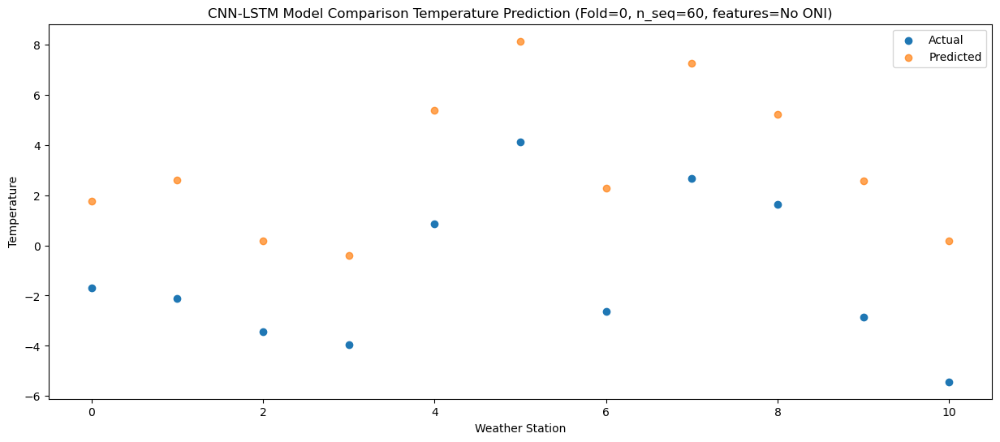

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.90   8.281412
1                 1    1.76   7.256408
2                 2    0.05   5.282954
3                 3   -0.16   5.182668
4                 4    7.36  12.305720
5                 5    8.05  12.795507
6                 6    1.72   7.309583
7                 7    7.51  12.354729
8                 8    8.84  12.404900
9                 9    4.13   8.989416
10               10    1.48   6.935754


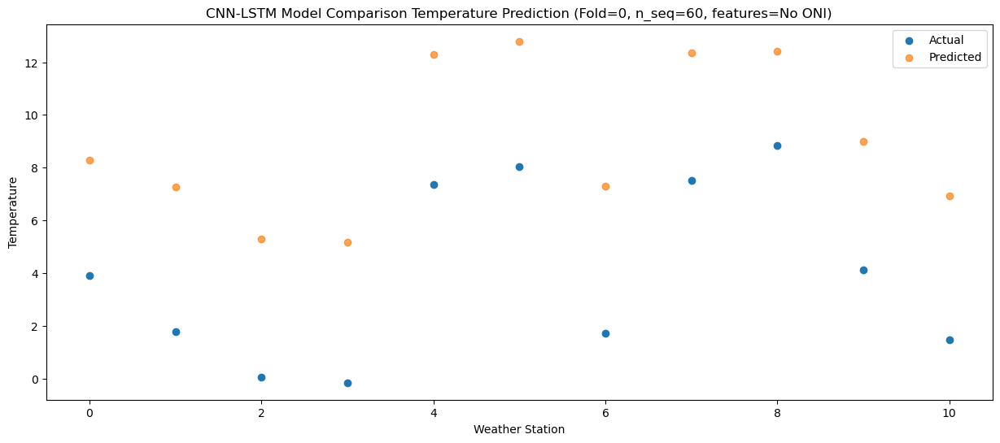

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    8.03  13.445773
1                 1    4.73  10.899784
2                 2    2.79   9.107433
3                 3    4.63   9.940280
4                 4   13.40  18.092019
5                 5   10.92  16.076810
6                 6    4.64  10.912578
7                 7   10.83  15.944616
8                 8   12.79  17.447505
9                 9    6.86  13.154589
10               10    5.09  10.987474


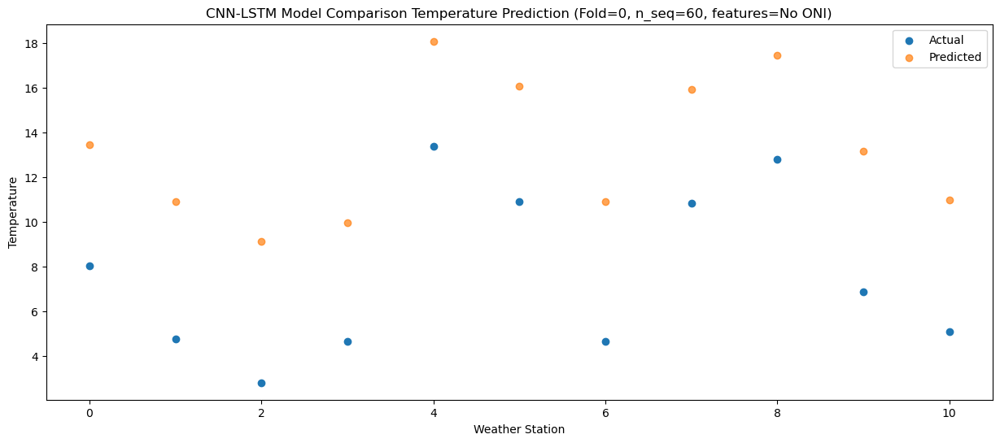

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.22  19.884950
1                 1    9.04  16.696023
2                 2    8.55  15.541594
3                 3    9.15  15.459500
4                 4   18.11  24.046787
5                 5   15.55  22.729115
6                 6    9.71  17.653158
7                 7   15.81  22.938838
8                 8   19.63  25.023584
9                 9   15.03  21.191537
10               10   14.41  19.619453


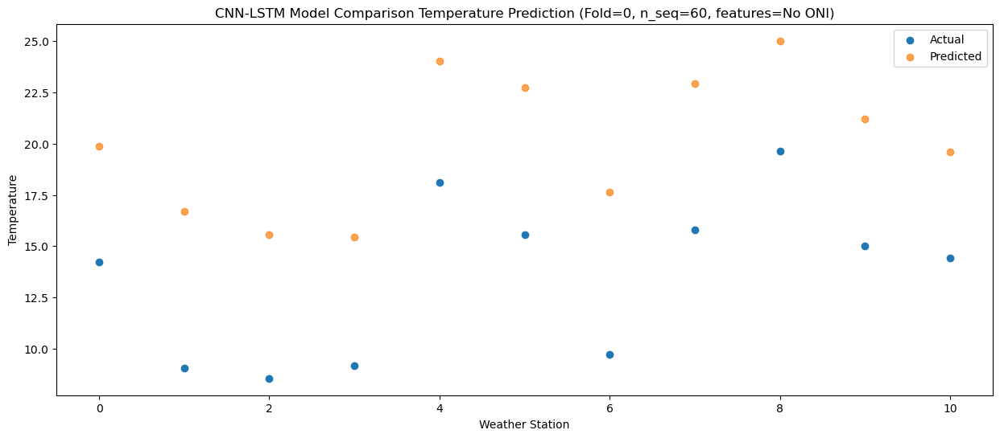

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   17.43  24.561637
1                 1   12.73  20.547388
2                 2   12.33  19.665473
3                 3   11.58  19.631798
4                 4   22.45  29.042581
5                 5   19.12  26.855115
6                 6   13.62  21.873200
7                 7   19.81  27.253074
8                 8   24.15  30.076642
9                 9   18.93  25.977208
10               10   19.17  24.653195


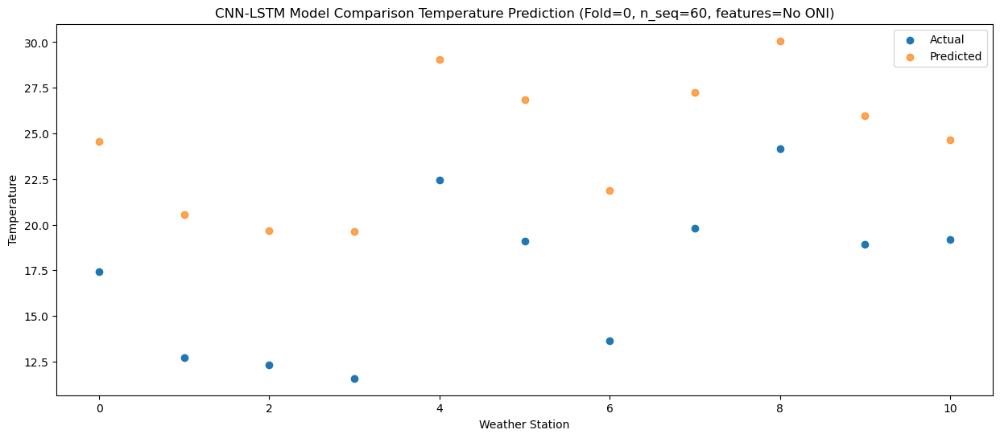

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   19.65  26.194026
1                 1   12.87  21.344215
2                 2   13.25  20.863222
3                 3   11.56  20.739070
4                 4   24.81  31.060189
5                 5   21.26  28.212262
6                 6   14.72  23.259246
7                 7   21.68  28.801674
8                 8   26.48  31.785950
9                 9   20.96  27.574838
10               10   20.28  26.336192


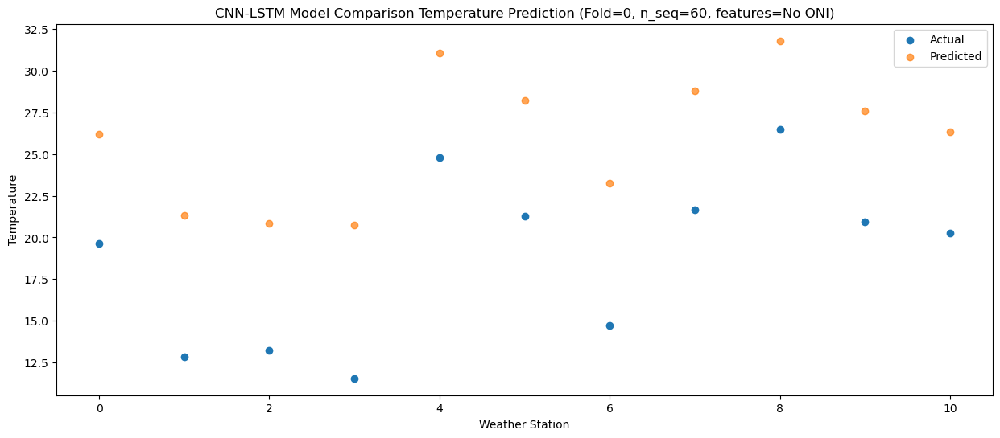

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.47  23.907912
1                 1   12.32  20.163840
2                 2   12.02  19.636845
3                 3   10.37  18.627114
4                 4   22.45  28.373933
5                 5   20.41  27.546105
6                 6   13.43  22.316720
7                 7   20.00  27.944012
8                 8   23.60  29.693221
9                 9   19.05  26.269332
10               10   19.16  25.205432


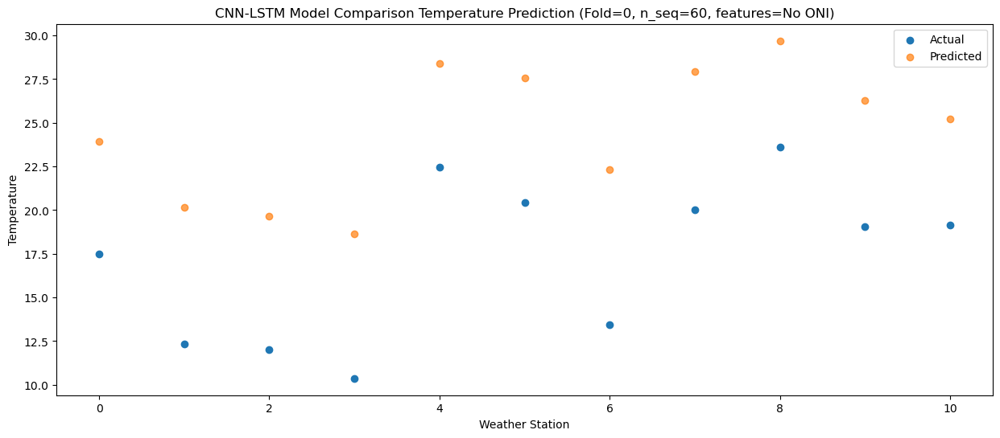

84/84 [==============================] - 5s 59ms/step - loss: 0.0484 - accuracy: 0.5476 - mae: 0.0382 - rmse: 0.0484 - mape: inf - pearson: 0.8941 - val_loss: 0.0497 - val_accuracy: 0.6000 - val_mae: 0.0411 - val_rmse: 0.0497 - val_mape: 8.9251 - val_pearson: 0.8940
Epoch 27/100
84/84 [==============================] - 9s 102ms/step - loss: 0.0499 - accuracy: 0.5714 - mae: 0.0395 - rmse: 0.0499 - mape: inf - pearson: 0.8907 - val_loss: 0.0442 - val_accuracy: 0.6000 - val_mae: 0.0354 - val_rmse: 0.0442 - val_mape: 7.6578 - val_pearson: 0.9056
Epoch 28/100
84/84 [==============================] - 9s 107ms/step - loss: 0.0474 - accuracy: 0.5714 - mae: 0.0378 - rmse: 0.0474 - mape: inf - pearson: 0.8969 - val_loss: 0.0436 - val_accuracy: 0.6000 - val_mae: 0.0350 - val_rmse: 0.0436 - val_mape: 7.5754 - val_pearson: 0.9098
Epoch 29/100
84/84 [==============================] - 9s 103ms/step - loss: 0.0490 - accuracy: 0.5714 - mae: 0.0389 - rmse: 0.0490 - mape: inf - pearson: 0.8945 - val_loss

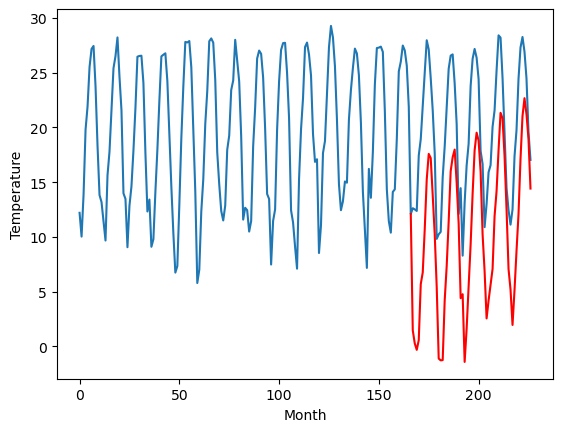

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.99		-0.21		0.78
-1.90		-1.36		0.54
-3.01		-2.11		0.90
-2.92		-1.51		1.41
3.08		4.36		1.28
4.30		5.47		1.17
7.65		9.85		2.20
12.00		15.06		3.06
15.37		17.36		1.99
13.96		16.57		2.61
10.42		12.86		2.44
6.70		8.65		1.95
2.60		4.30		1.70
-4.29		-2.52		1.77
-4.49		-2.97		1.52
-3.83		-3.88		-0.05
2.94		3.30		0.36
5.08		6.37		1.29
8.81		10.58		1.77
12.95		15.74		2.79
14.33		16.83		2.50
14.60		17.66		3.06
10.86		14.52		3.66
7.08		10.57		3.49
-0.58		3.11		3.69
1.05		3.59		2.54
-5.68		-3.52		2.16
-1.45		-0.59		0.86
2.12		4.02		1.90
5.12		8.20		3.08
11.00		13.48		2.48
14.97		17.61		2.64
15.47		19.35		3.88
14.01		18.29		4.28
10.92		15.22		4.30
4.58		9.26		4.68
1.58		5.48		3.90
-4.23		0.84		5.07
-2.04		2.53		4.57
1.33		3.98		2.65
2.10		5.55		3.45
5.37		10.81		5.44
8.65		13.66		5.01
11.84		17.64		5.80
15.44		20.67		5.23
14.90		20.19		5.29
11.39		16.84		5.45
6.38		11.58		5.20
0.76		5.88		5.12
-2.38		3.93

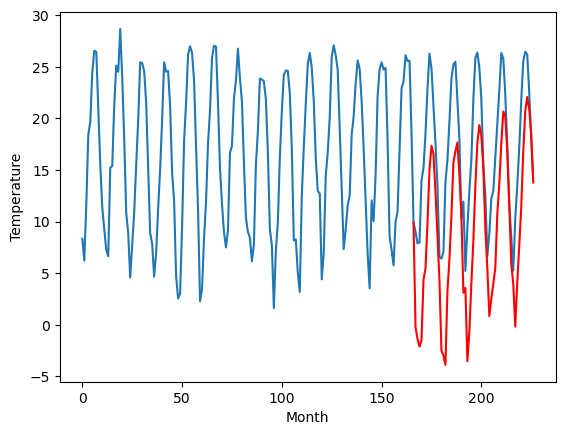

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.90		1.33		2.23
-0.47		0.41		0.88
-1.00		-0.34		0.66
-0.72		0.35		1.07
6.38		6.60		0.22
5.41		7.42		2.01
9.56		11.37		1.81
13.79		16.23		2.44
15.26		18.10		2.84
15.25		17.58		2.33
12.45		14.02		1.57
8.10		10.02		1.92
3.30		5.77		2.47
-3.76		-1.07		2.69
-3.34		-1.23		2.11
-2.85		-2.23		0.62
4.21		5.30		1.09
5.61		7.77		2.16
9.73		11.84		2.11
13.61		16.59		2.98
14.38		17.74		3.36
15.04		18.60		3.56
12.02		15.83		3.81
8.24		11.84		3.60
0.50		4.70		4.20
3.10		6.00		2.90
-3.79		-1.26		2.53
-0.44		1.29		1.73
3.56		5.97		2.41
7.15		10.34		3.19
12.51		15.06		2.55
15.48		19.24		3.76
16.19		20.77		4.58
14.58		19.39		4.81
12.19		16.70		4.51
5.50		10.83		5.33
2.18		6.82		4.64
-0.98		2.84		3.82
0.02		4.43		4.41
2.61		6.25		3.64
4.04		8.05		4.01
6.73		12.44		5.71
9.97		15.38		5.41
13.72		19.33		5.61
16.09		21.99		5.90
16.53		22.12		5.59
13.57		18.52		4.95
7.53		13.01		5.48
0.97		7.64		6.67
-1.81		5.30		7

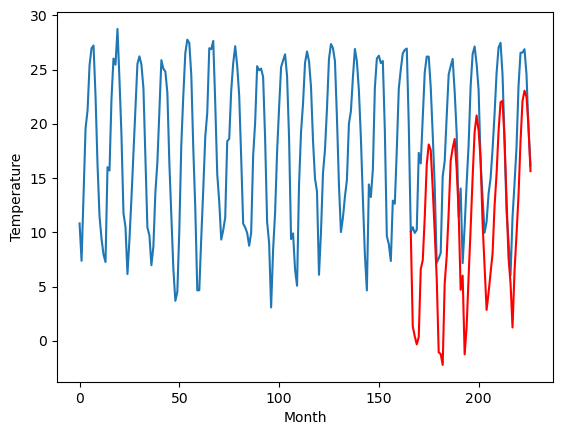

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.19		1.65		0.46
-0.23		0.61		0.84
0.52		-0.18		-0.70
-0.01		0.71		0.72
7.63		7.44		-0.19
7.51		8.31		0.80
11.26		12.10		0.84
14.04		16.63		2.59
15.69		17.89		2.20
15.93		17.97		2.04
12.52		14.27		1.75
7.98		9.88		1.90
5.08		5.70		0.62
-1.10		-0.74		0.36
-1.20		-0.39		0.81
-2.79		-2.19		0.60
4.58		6.31		1.73
6.92		8.12		1.20
10.81		12.19		1.38
14.70		16.98		2.28
14.58		18.32		3.74
15.55		18.85		3.30
12.54		16.72		4.18
9.85		11.90		2.05
2.69		5.88		3.19
6.06		7.21		1.15
-1.99		0.50		2.49
-2.46		1.87		4.33
3.38		7.02		3.64
9.38		11.76		2.38
13.81		15.72		1.91
16.81		20.39		3.58
17.75		22.08		4.33
16.11		20.25		4.14
13.34		17.95		4.61
7.78		11.97		4.19
2.73		6.14		3.41
0.64		3.38		2.74
1.35		4.79		3.44
2.35		6.83		4.48
6.18		9.27		3.09
7.02		12.82		5.80
11.61		16.73		5.12
15.76		20.59		4.83
17.48		22.87		5.39
19.45		23.94		4.49
16.37		19.81		3.44
9.11		13.49		4.38
2.83		8.60		5.77
0.43		5.54		5.

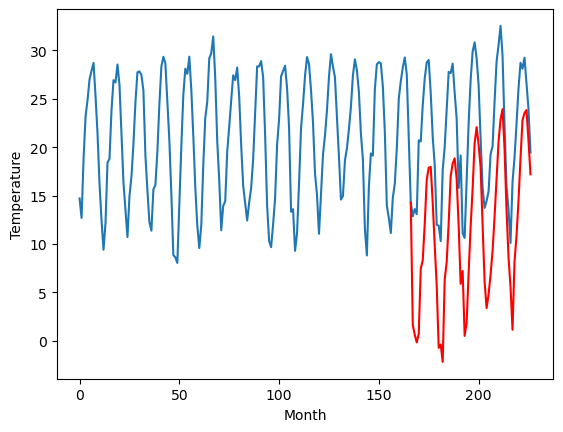

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.60		5.84		0.24
3.71		4.81		1.10
4.52		3.99		-0.53
4.14		4.82		0.68
12.18		11.70		-0.48
11.92		12.57		0.65
15.72		16.44		0.72
18.75		21.10		2.35
20.79		22.35		1.56
21.03		22.36		1.33
17.45		18.60		1.15
12.51		14.08		1.57
9.41		10.00		0.59
3.05		3.51		0.46
3.04		3.81		0.77
1.34		1.82		0.48
8.95		10.69		1.74
11.25		12.48		1.23
15.37		16.58		1.21
18.84		21.47		2.63
18.93		22.78		3.85
19.90		23.34		3.44
16.32		21.20		4.88
13.28		16.34		3.06
5.73		10.19		4.46
9.61		11.57		1.96
1.13		4.66		3.53
0.82		6.01		5.19
6.60		11.30		4.70
12.87		16.13		3.26
17.49		20.20		2.71
20.86		24.90		4.04
21.95		26.61		4.66
19.94		24.72		4.78
16.76		22.37		5.61
11.37		16.34		4.97
6.37		10.44		4.07
4.35		7.62		3.27
4.83		9.03		4.20
6.01		11.10		5.09
9.83		13.58		3.75
10.79		17.19		6.40
15.43		21.21		5.78
20.32		25.13		4.81
22.27		27.32		5.05
23.70		28.40		4.70
19.85		24.28		4.43
12.45		17.89		5.44
6.25		12.96		6.71
4.3

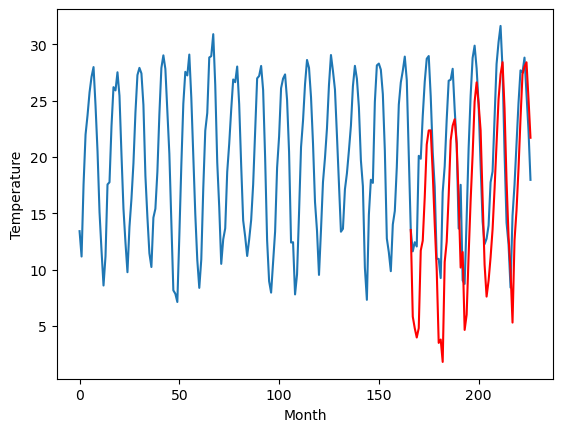

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.73		2.77		0.04
0.70		0.95		0.25
0.04		0.17		0.13
-0.48		1.07		1.55
6.87		7.06		0.19
9.66		8.88		-0.78
14.85		13.56		-1.29
17.57		18.47		0.90
20.27		20.26		-0.01
20.12		20.38		0.26
12.59		16.19		3.60
9.75		10.89		1.14
6.03		6.37		0.34
-0.72		0.61		1.33
-2.23		0.82		3.05
-1.85		-1.37		0.48
5.49		6.81		1.32
7.76		9.58		1.82
13.35		13.95		0.60
17.62		19.78		2.16
16.96		21.22		4.26
16.37		21.29		4.92
16.01		18.86		2.85
11.69		13.18		1.49
5.22		7.80		2.58
5.48		6.78		1.30
-1.84		1.41		3.25
-1.95		2.54		4.49
5.00		7.84		2.84
11.91		12.33		0.42
17.31		16.84		-0.47
19.37		21.93		2.56
20.29		24.36		4.07
17.44		23.03		5.59
14.39		20.25		5.86
8.31		13.92		5.61
1.35		6.69		5.34
0.23		3.58		3.35
0.69		5.10		4.41
0.83		6.35		5.52
5.89		8.86		2.97
9.05		13.76		4.71
13.66		18.36		4.70
20.35		22.11		1.76
21.45		25.05		3.60
20.64		25.47		4.83
18.36		21.46		3.10
10.76		15.02		4.26
4.10		9.80		5.70
1.74		7.04		

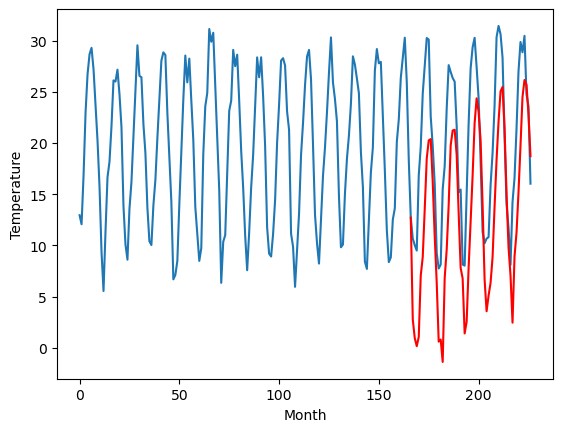

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.75		2.88		1.13
1.02		1.66		0.64
0.21		0.95		0.74
0.28		1.57		1.29
5.95		7.22		1.27
7.58		8.40		0.82
10.36		12.82		2.46
15.03		18.00		2.97
18.21		20.41		2.20
16.58		19.63		3.05
13.16		15.93		2.77
9.67		11.78		2.11
5.52		7.32		1.80
-1.69		0.55		2.24
-1.89		0.07		1.96
-1.11		-0.66		0.45
5.17		6.16		0.99
7.74		9.38		1.64
11.51		13.60		2.09
15.52		18.76		3.24
16.88		19.86		2.98
17.14		20.67		3.53
13.81		17.47		3.66
9.86		13.55		3.69
2.26		6.11		3.85
3.78		6.38		2.60
-2.61		-0.55		2.06
1.20		2.50		1.30
5.04		6.98		1.94
7.80		11.05		3.25
13.72		16.36		2.64
17.30		20.43		3.13
18.04		22.21		4.17
16.54		21.28		4.74
13.65		18.16		4.51
7.31		12.22		4.91
4.42		8.55		4.13
-1.59		3.81		5.40
0.54		5.52		4.98
4.13		6.87		2.74
4.80		8.34		3.54
8.06		13.75		5.69
11.06		16.47		5.41
14.34		20.42		6.08
17.79		23.61		5.82
17.37		22.97		5.60
14.20		19.67		5.47
9.19		14.54		5.35
3.50		8.79		5.29
0.76		6.95		6.19
-2

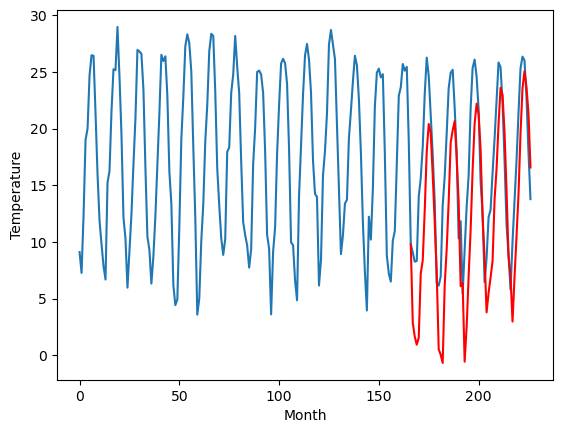

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.51		7.74		1.23
5.89		6.45		0.56
5.04		5.32		0.28
5.72		5.65		-0.07
12.64		13.22		0.58
13.78		14.59		0.81
18.28		19.72		1.44
23.84		25.88		2.04
26.38		27.55		1.17
24.36		26.64		2.28
21.06		22.13		1.07
14.29		16.21		1.92
10.62		12.77		2.15
4.02		5.91		1.89
3.71		5.39		1.68
0.71		1.93		1.22
12.03		13.26		1.23
13.74		15.74		2.00
18.40		20.24		1.84
24.48		26.55		2.07
25.47		27.52		2.05
26.69		28.19		1.50
22.98		25.44		2.46
17.78		20.16		2.38
8.48		12.73		4.25
10.89		13.05		2.16
2.06		5.04		2.98
4.11		6.63		2.52
10.06		13.05		2.99
15.25		18.24		2.99
20.72		24.03		3.31
24.78		29.02		4.24
28.91		31.18		2.27
26.04		29.16		3.12
22.20		25.98		3.78
15.53		19.46		3.93
8.93		13.00		4.07
5.19		8.82		3.63
6.38		10.44		4.06
7.88		12.13		4.25
10.71		14.56		3.85
15.11		20.00		4.89
20.46		24.89		4.43
24.27		29.20		4.93
26.57		31.19		4.62
27.07		31.60		4.53
23.45		27.90		4.45
17.14		21.05		3.91
9.74		15.44		5.7

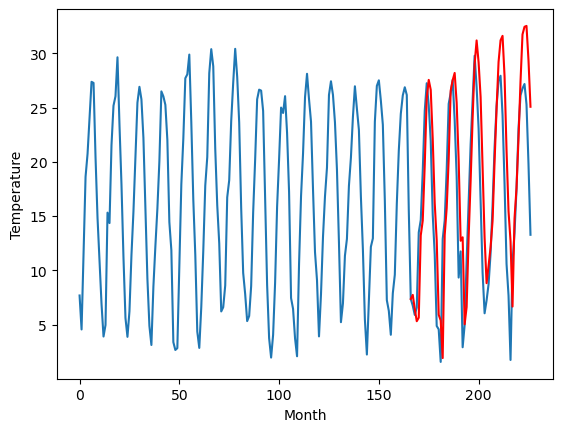

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.17		7.77		1.60
4.32		5.99		1.67
4.50		4.76		0.26
3.99		5.19		1.20
11.82		12.99		1.17
13.20		14.88		1.68
19.31		20.44		1.13
24.42		26.75		2.33
26.96		28.21		1.25
26.03		27.71		1.68
19.38		22.66		3.28
13.20		15.82		2.62
10.32		12.49		2.17
3.64		6.09		2.45
3.29		5.78		2.49
-1.49		1.17		2.66
11.07		13.58		2.51
12.87		16.01		3.14
17.68		20.73		3.05
23.71		27.75		4.04
25.22		28.89		3.67
25.61		29.05		3.44
23.10		26.55		3.45
16.85		20.09		3.24
9.10		13.65		4.55
8.29		12.66		4.37
0.67		5.65		4.98
1.65		6.24		4.59
8.90		13.24		4.34
16.01		18.64		2.63
21.37		24.36		2.99
25.66		30.02		4.36
29.81		32.69		2.88
27.14		30.58		3.44
23.31		27.39		4.08
15.08		20.46		5.38
7.23		11.92		4.69
3.60		8.19		4.59
4.46		9.77		5.31
4.83		11.34		6.51
9.26		14.30		5.04
13.59		20.00		6.41
19.28		26.17		6.89
24.21		30.41		6.20
27.09		32.26		5.17
28.90		33.08		4.18
24.26		29.05		4.79
15.68		21.30		5.62
8.56		15.86		7.30
5.

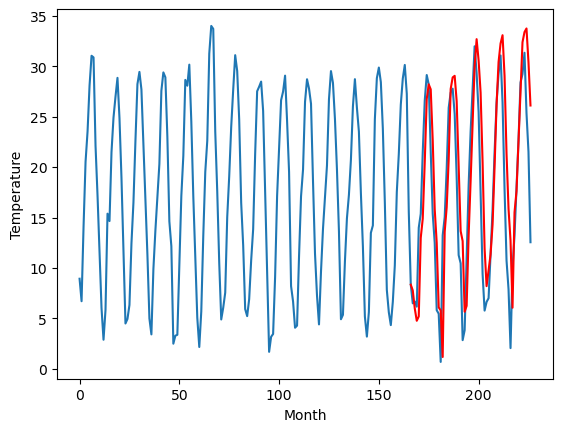

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.70		7.88		-0.82
7.34		5.52		-1.82
6.89		4.41		-2.48
5.65		4.95		-0.70
13.61		11.76		-1.85
15.92		14.36		-1.56
22.45		20.40		-2.05
28.83		26.73		-2.10
30.41		28.66		-1.75
29.18		28.32		-0.86
22.43		23.05		0.62
15.83		15.80		-0.03
12.65		11.99		-0.66
5.38		6.19		0.81
5.49		5.87		0.38
1.12		1.42		0.30
11.83		12.67		0.84
15.59		15.88		0.29
20.14		20.76		0.62
27.25		28.35		1.10
27.92		29.66		1.74
27.77		29.40		1.63
25.82		26.62		0.80
18.38		19.63		1.25
12.13		13.89		1.76
10.52		10.96		0.44
3.60		5.39		1.79
3.66		5.96		2.30
10.59		12.71		2.12
17.07		17.64		0.57
22.52		23.61		1.09
27.09		29.46		2.37
30.69		32.61		1.92
27.86		31.10		3.24
25.45		27.64		2.19
16.91		20.54		3.63
7.92		11.23		3.31
5.57		7.24		1.67
5.85		8.93		3.08
7.00		9.82		2.82
10.73		12.66		1.93
16.08		19.29		3.21
21.19		25.71		4.52
24.42		29.73		5.31
29.04		32.28		3.24
29.44		32.51		3.07
25.92		28.55		2.63
17.82		20.90		3.08
11.07

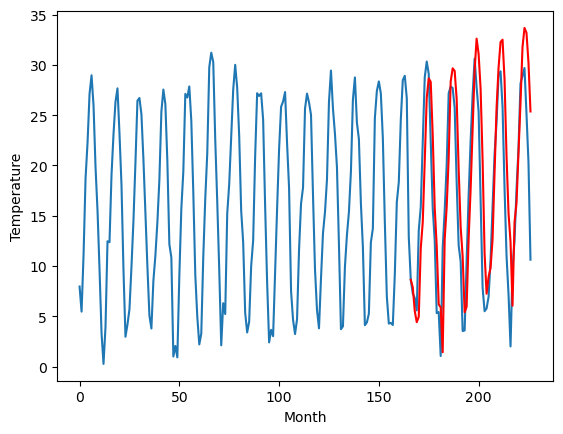

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.40		0.68		1.08
-3.21		-1.47		1.74
-2.87		-2.31		0.56
-2.13		-2.20		-0.07
2.19		2.87		0.68
3.82		5.28		1.46
9.28		11.66		2.38
16.60		18.47		1.87
20.47		22.06		1.59
18.28		20.25		1.97
13.75		15.76		2.01
8.21		9.95		1.74
4.01		5.53		1.52
-3.00		-1.01		1.99
-4.84		-2.57		2.27
-5.80		-4.26		1.54
1.42		3.37		1.95
6.07		8.46		2.39
10.61		13.28		2.67
16.70		20.47		3.77
18.93		21.27		2.34
18.71		21.98		3.27
15.01		17.65		2.64
10.59		13.13		2.54
1.27		4.62		3.35
0.50		1.85		1.35
-6.52		-5.03		1.49
-2.62		-1.39		1.23
1.94		3.81		1.87
5.29		7.75		2.46
12.27		15.35		3.08
16.66		19.69		3.03
20.60		22.52		1.92
20.06		22.18		2.12
15.15		17.69		2.54
7.05		11.19		4.14
3.54		6.75		3.21
-3.61		0.00		3.61
-0.65		2.02		2.67
-0.97		1.95		2.92
0.15		3.04		2.89
7.37		11.59		4.22
9.93		15.02		5.09
14.30		19.20		4.90
19.44		23.19		3.75
17.70		20.77		3.07
14.51		18.19		3.68
9.16		13.16		4.00
1.22		6.20		4.98
-0.47		

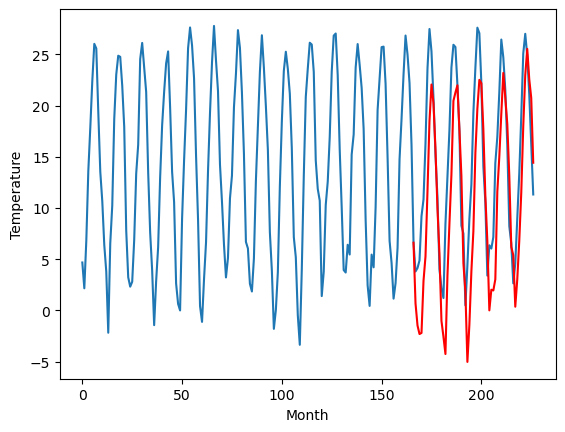

RangeIndex(start=1, stop=12, step=1)
[-0.6800000000000015, -0.9899999999999993, -0.9000000000000021, 1.1899999999999986, 5.599999999999998, 2.730000000000003, 1.7500000000000018, 6.510000000000002, 6.17, 8.7, -0.40000000000000036]
[1.4723535728454582, -0.20869976043701133, 1.327172927856445, 1.6538409805297851, 5.841174316406249, 2.772413349151611, 2.880196399688721, 7.744383773803712, 7.773020668029785, 7.883141708374023, 0.681515808105468]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.68   1.472354
1                 1   -0.99  -0.208700
2                 2   -0.90   1.327173
3                 3    1.19   1.653841
4                 4    5.60   5.841174
5                 5    2.73   2.772413
6                 6    1.75   2.880196
7                 7    6.51   7.744384
8                 8    6.17   7.773021
9                 9    8.70   7.883142
10               10   -0.40   0.681516


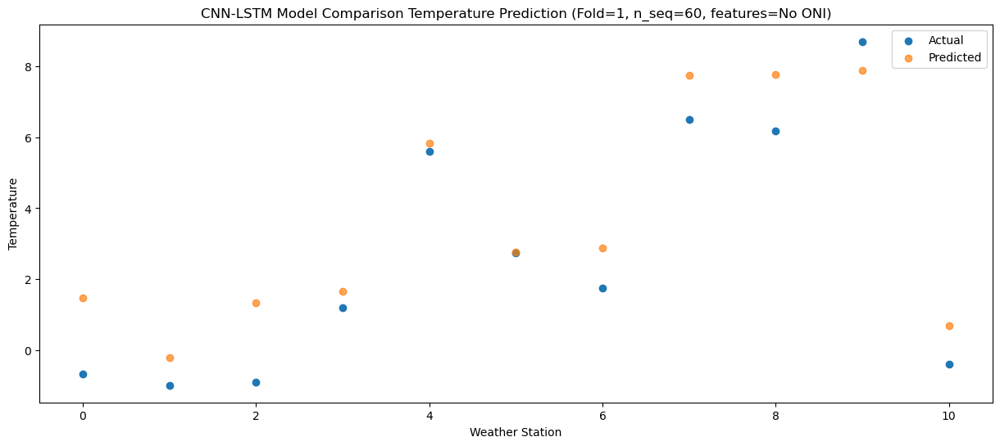

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.15   0.275721
1                 1   -1.90  -1.361122
2                 2   -0.47   0.408197
3                 3   -0.23   0.606895
4                 4    3.71   4.807836
5                 5    0.70   0.951273
6                 6    1.02   1.664116
7                 7    5.89   6.451816
8                 8    4.32   5.985619
9                 9    7.34   5.516209
10               10   -3.21  -1.473891


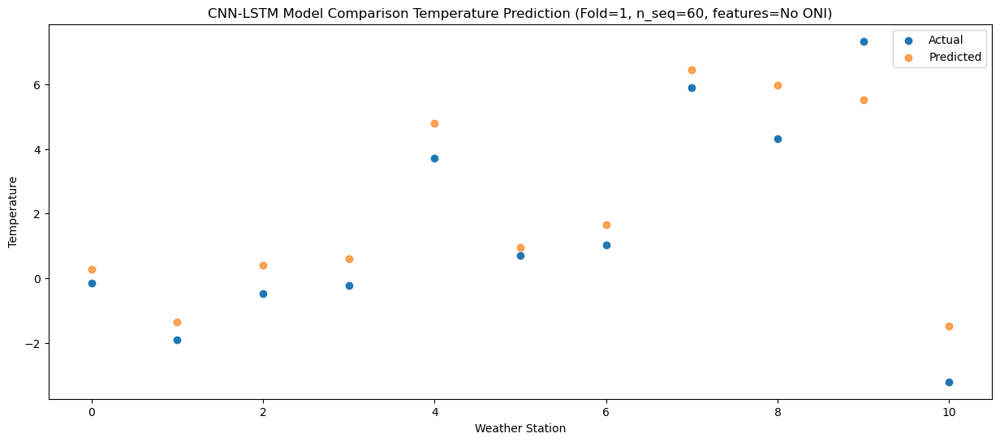

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -0.309190
1                 1   -3.01  -2.105846
2                 2   -1.00  -0.335045
3                 3    0.52  -0.177882
4                 4    4.52   3.988679
5                 5    0.04   0.167343
6                 6    0.21   0.950254
7                 7    5.04   5.319779
8                 8    4.50   4.759953
9                 9    6.89   4.411971
10               10   -2.87  -2.310129


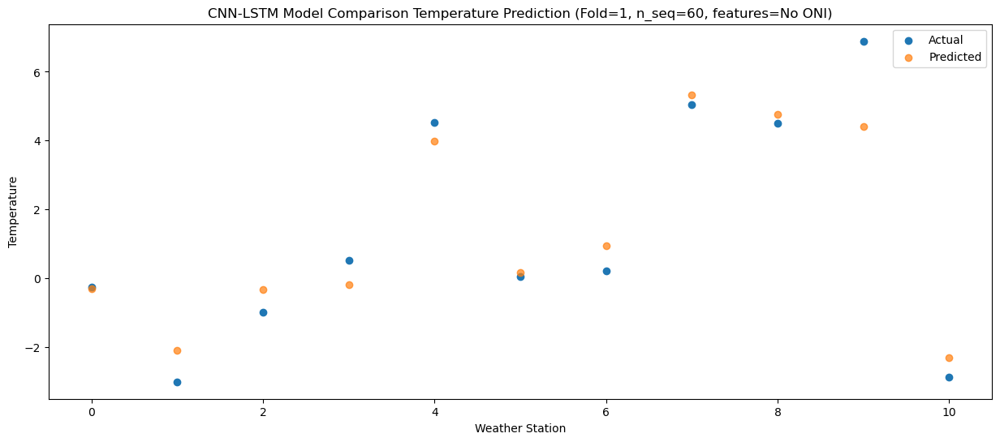

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.40   0.575711
1                 1   -2.92  -1.505593
2                 2   -0.72   0.351793
3                 3   -0.01   0.711629
4                 4    4.14   4.823144
5                 5   -0.48   1.070895
6                 6    0.28   1.568566
7                 7    5.72   5.648114
8                 8    3.99   5.192989
9                 9    5.65   4.950900
10               10   -2.13  -2.196903


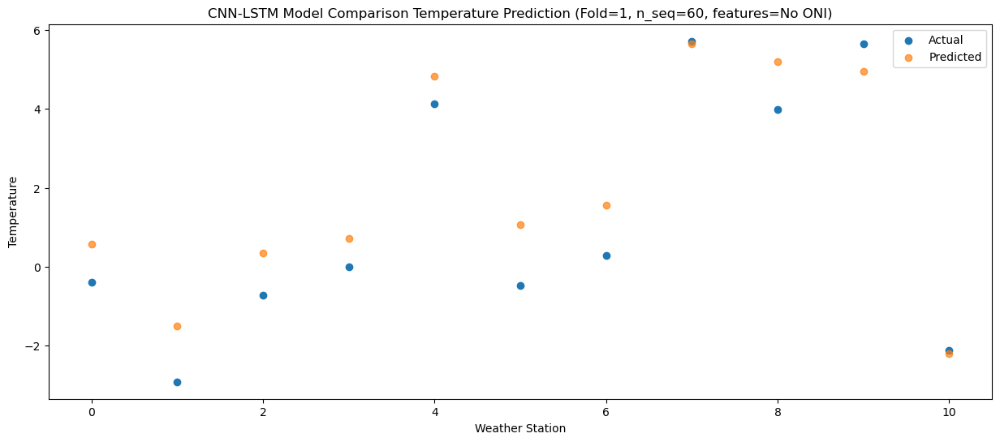

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.66   5.683322
1                 1    3.08   4.357565
2                 2    6.38   6.602727
3                 3    7.63   7.437346
4                 4   12.18  11.700256
5                 5    6.87   7.056006
6                 6    5.95   7.217930
7                 7   12.64  13.222703
8                 8   11.82  12.991557
9                 9   13.61  11.755653
10               10    2.19   2.868348


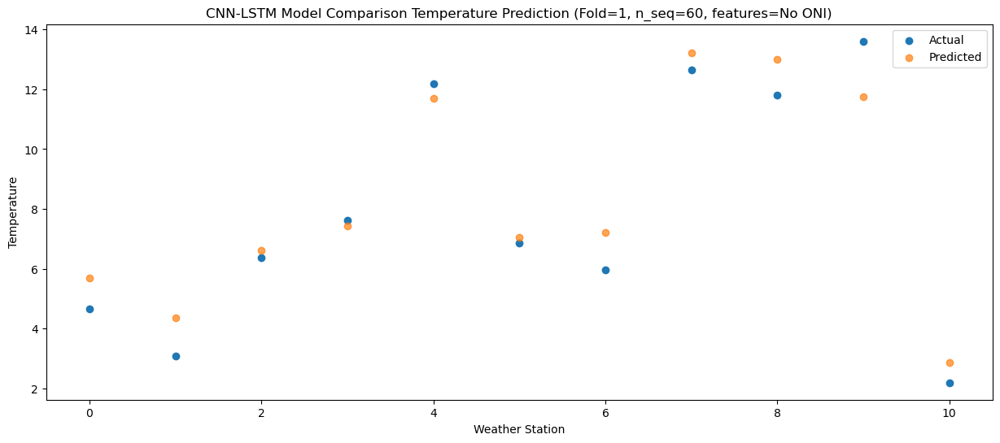

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.15   6.759573
1                 1    4.30   5.470892
2                 2    5.41   7.416413
3                 3    7.51   8.314068
4                 4   11.92  12.573711
5                 5    9.66   8.884132
6                 6    7.58   8.402158
7                 7   13.78  14.588753
8                 8   13.20  14.881221
9                 9   15.92  14.358745
10               10    3.82   5.276745


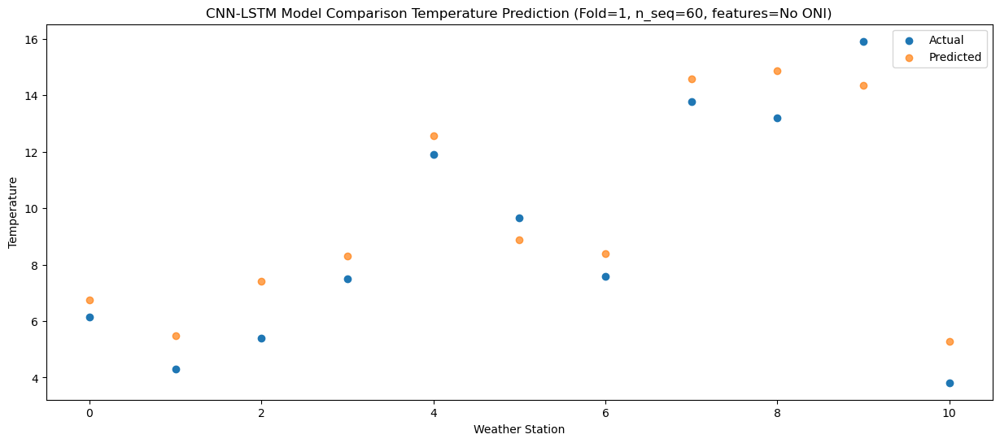

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    9.23  10.702896
1                 1    7.65   9.853586
2                 2    9.56  11.367962
3                 3   11.26  12.099302
4                 4   15.72  16.435958
5                 5   14.85  13.556162
6                 6   10.36  12.816534
7                 7   18.28  19.721448
8                 8   19.31  20.444837
9                 9   22.45  20.401120
10               10    9.28  11.656105


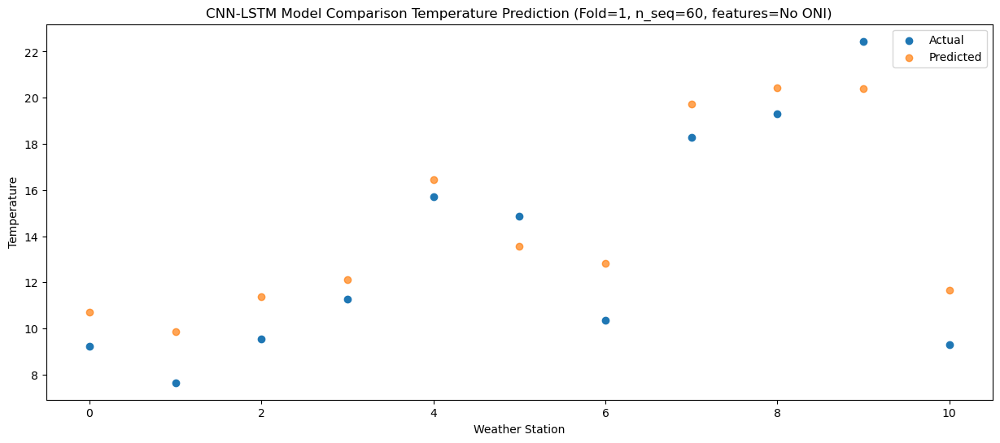

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.23  15.239604
1                 1   12.00  15.057186
2                 2   13.79  16.228611
3                 3   14.04  16.634507
4                 4   18.75  21.103190
5                 5   17.57  18.470714
6                 6   15.03  17.997133
7                 7   23.84  25.881812
8                 8   24.42  26.750099
9                 9   28.83  26.730174
10               10   16.60  18.474555


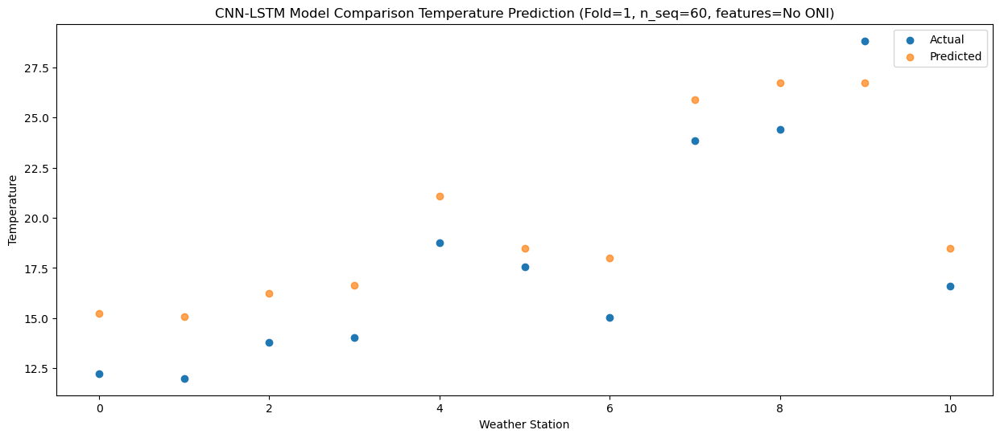

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.18  17.578936
1                 1   15.37  17.356435
2                 2   15.26  18.098885
3                 3   15.69  17.889693
4                 4   20.79  22.350363
5                 5   20.27  20.257451
6                 6   18.21  20.413752
7                 7   26.38  27.547316
8                 8   26.96  28.206210
9                 9   30.41  28.658510
10               10   20.47  22.060004


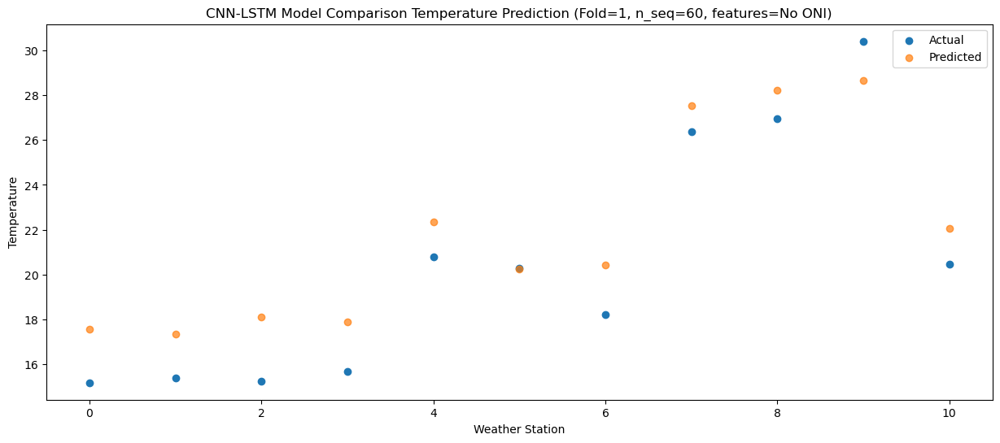

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   14.34  17.197893
1                 1   13.96  16.574573
2                 2   15.25  17.584972
3                 3   15.93  17.970799
4                 4   21.03  22.359740
5                 5   20.12  20.381529
6                 6   16.58  19.627730
7                 7   24.36  26.636113
8                 8   26.03  27.713080
9                 9   29.18  28.318587
10               10   18.28  20.252663


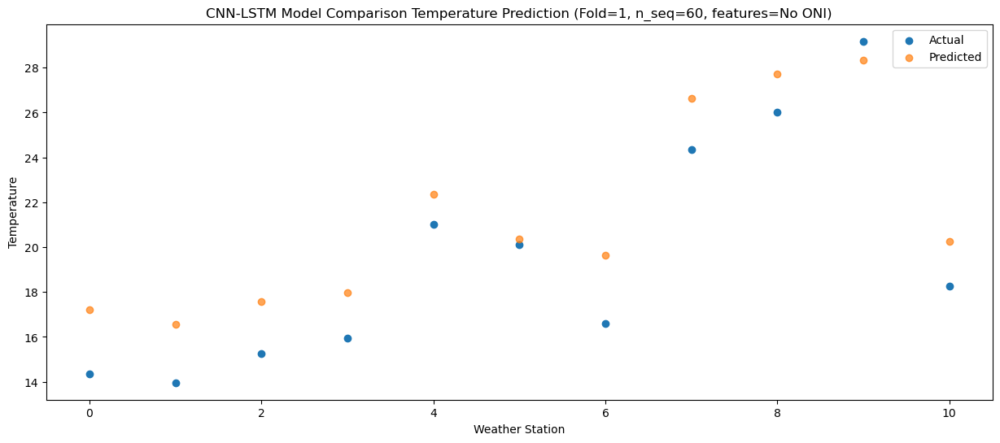

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.72  13.791154
1                 1   10.42  12.861381
2                 2   12.45  14.016383
3                 3   12.52  14.272566
4                 4   17.45  18.603247
5                 5   12.59  16.193665
6                 6   13.16  15.933532
7                 7   21.06  22.131054
8                 8   19.38  22.664131
9                 9   22.43  23.045771
10               10   13.75  15.763620


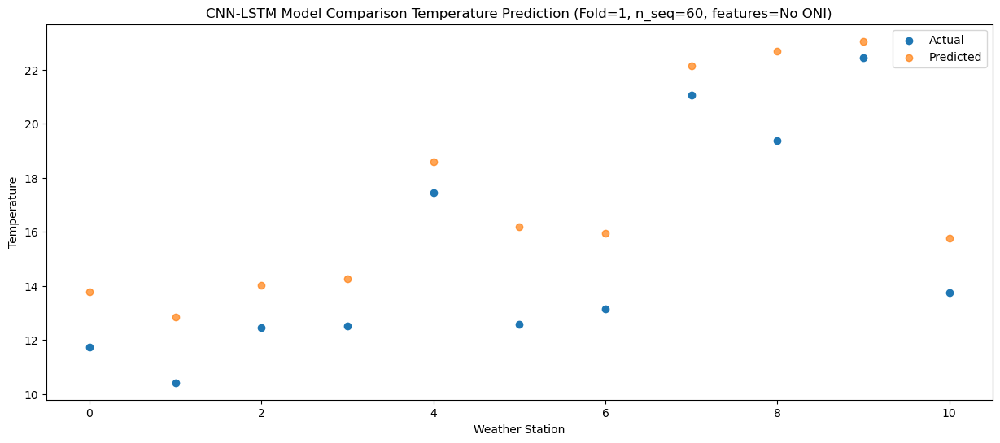

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    8.79  10.264676
1                 1    6.70   8.650791
2                 2    8.10  10.021639
3                 3    7.98   9.876651
4                 4   12.51  14.078883
5                 5    9.75  10.890646
6                 6    9.67  11.775287
7                 7   14.29  16.205374
8                 8   13.20  15.823479
9                 9   15.83  15.798356
10               10    8.21   9.952266


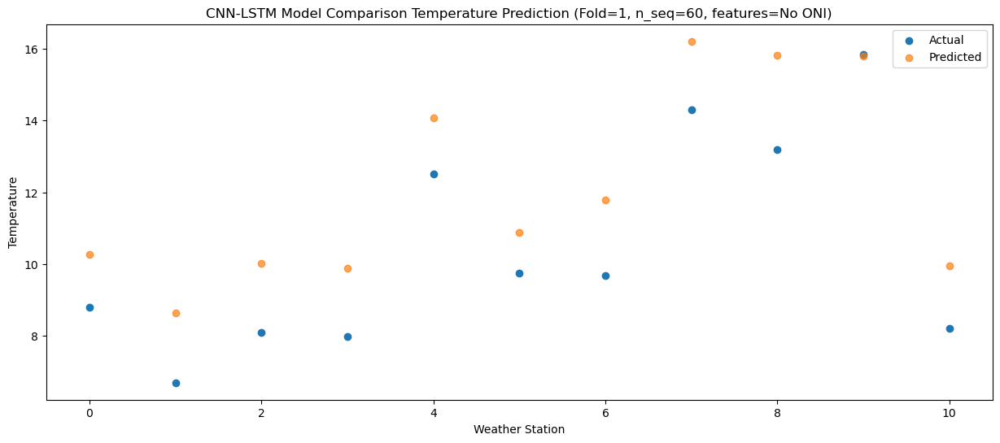

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.89   5.436215
1                 1    2.60   4.299352
2                 2    3.30   5.769002
3                 3    5.08   5.697429
4                 4    9.41  10.000781
5                 5    6.03   6.374309
6                 6    5.52   7.315073
7                 7   10.62  12.770747
8                 8   10.32  12.488243
9                 9   12.65  11.991568
10               10    4.01   5.534301


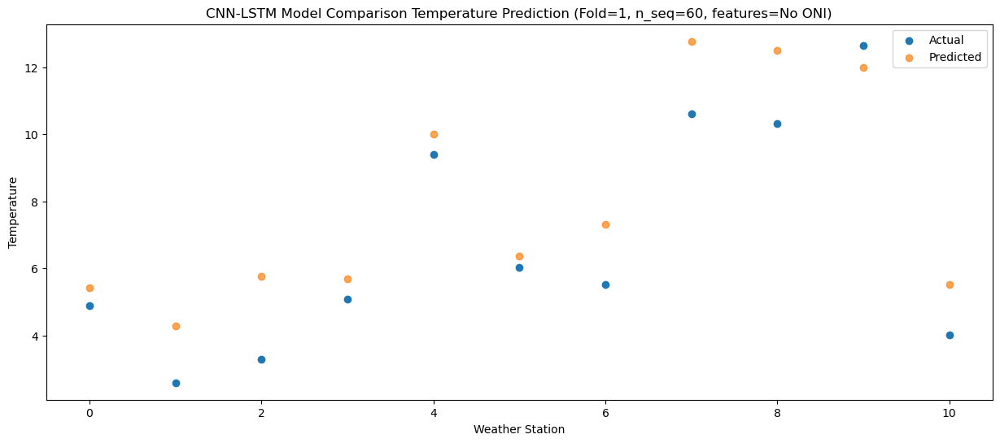

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -1.106755
1                 1   -4.29  -2.520595
2                 2   -3.76  -1.073406
3                 3   -1.10  -0.735610
4                 4    3.05   3.511261
5                 5   -0.72   0.608234
6                 6   -1.69   0.550439
7                 7    4.02   5.914178
8                 8    3.64   6.092318
9                 9    5.38   6.194141
10               10   -3.00  -1.014458


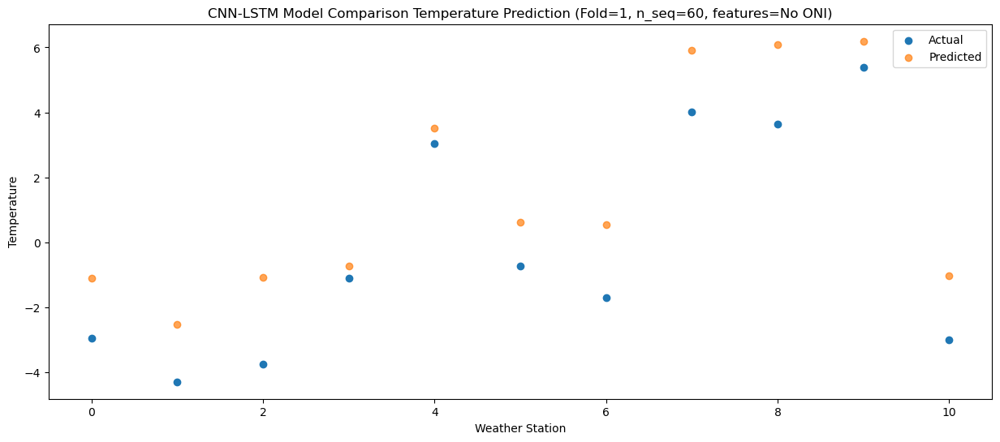

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.53  -1.270890
1                 1   -4.49  -2.973562
2                 2   -3.34  -1.225099
3                 3   -1.20  -0.385122
4                 4    3.04   3.810567
5                 5   -2.23   0.815544
6                 6   -1.89   0.070286
7                 7    3.71   5.387058
8                 8    3.29   5.782563
9                 9    5.49   5.867154
10               10   -4.84  -2.567070


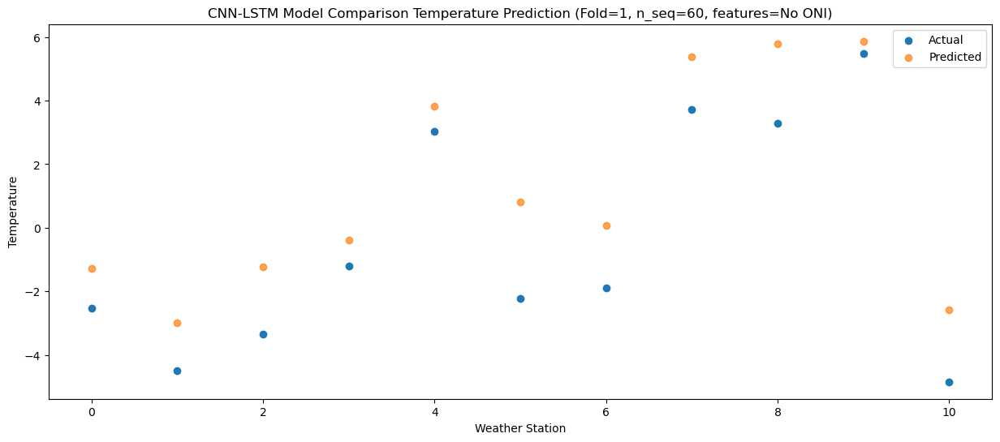

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -1.244633
1                 1   -3.83  -3.880204
2                 2   -2.85  -2.229128
3                 3   -2.79  -2.191431
4                 4    1.34   1.823980
5                 5   -1.85  -1.369844
6                 6   -1.11  -0.655963
7                 7    0.71   1.925796
8                 8   -1.49   1.169113
9                 9    1.12   1.421033
10               10   -5.80  -4.258247


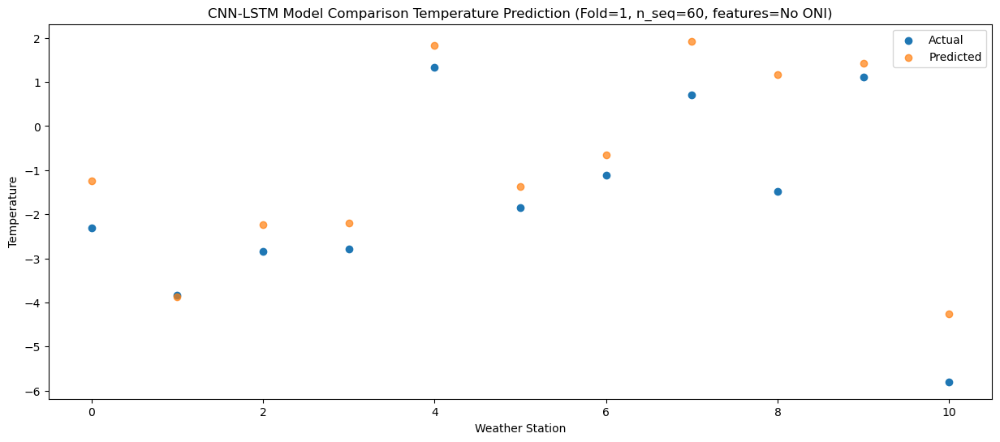

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.67   4.198988
1                 1    2.94   3.304599
2                 2    4.21   5.300704
3                 3    4.58   6.310136
4                 4    8.95  10.685540
5                 5    5.49   6.814636
6                 6    5.17   6.163094
7                 7   12.03  13.259760
8                 8   11.07  13.583632
9                 9   11.83  12.668899
10               10    1.42   3.368950


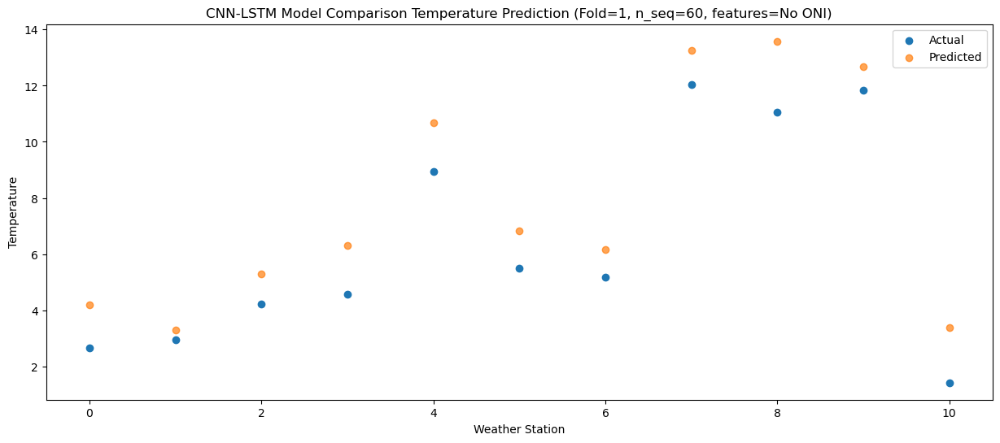

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    5.48   7.327224
1                 1    5.08   6.370733
2                 2    5.61   7.765846
3                 3    6.92   8.115455
4                 4   11.25  12.476502
5                 5    7.76   9.578328
6                 6    7.74   9.383996
7                 7   13.74  15.737890
8                 8   12.87  16.008724
9                 9   15.59  15.884084
10               10    6.07   8.463764


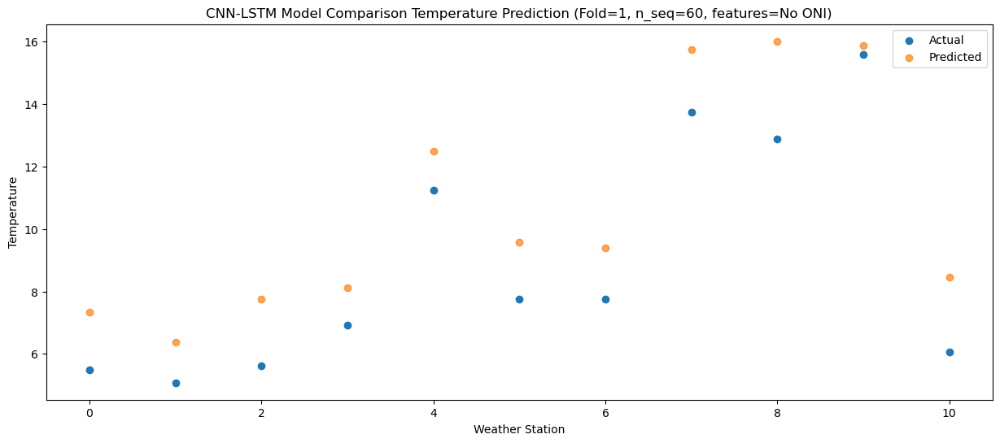

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    9.09  11.421203
1                 1    8.81  10.580017
2                 2    9.73  11.842128
3                 3   10.81  12.191355
4                 4   15.37  16.581328
5                 5   13.35  13.954623
6                 6   11.51  13.597633
7                 7   18.40  20.236166
8                 8   17.68  20.727196
9                 9   20.14  20.758297
10               10   10.61  13.278808


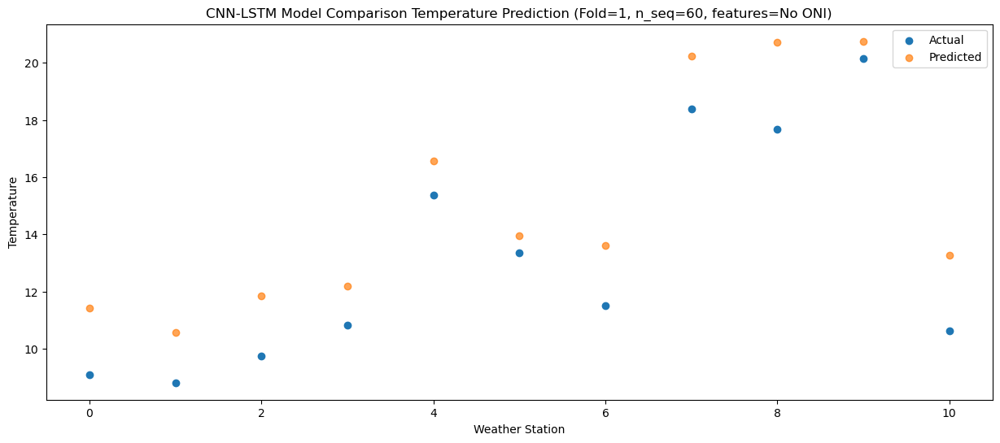

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.58  16.002859
1                 1   12.95  15.735730
2                 2   13.61  16.594755
3                 3   14.70  16.979507
4                 4   18.84  21.472754
5                 5   17.62  19.776837
6                 6   15.52  18.756375
7                 7   24.48  26.552876
8                 8   23.71  27.748135
9                 9   27.25  28.353131
10               10   16.70  20.468166


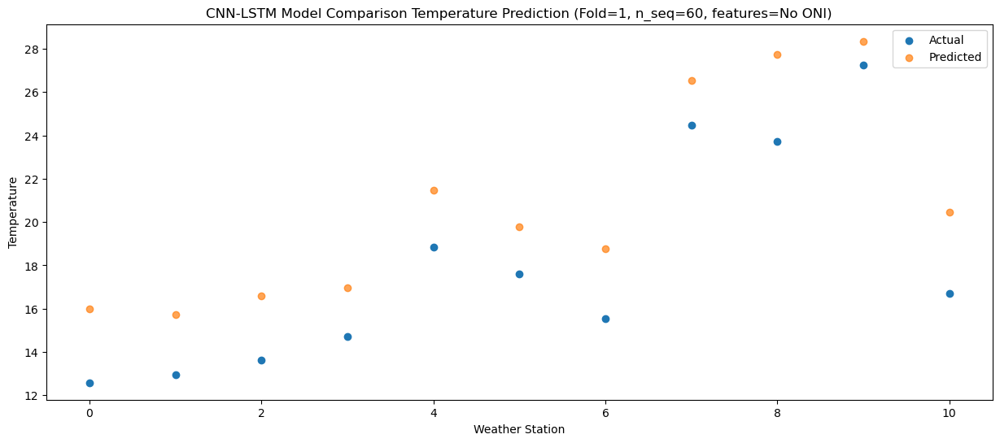

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   13.78  17.273548
1                 1   14.33  16.825440
2                 2   14.38  17.744966
3                 3   14.58  18.316786
4                 4   18.93  22.777887
5                 5   16.96  21.221653
6                 6   16.88  19.858934
7                 7   25.47  27.519717
8                 8   25.22  28.893559
9                 9   27.92  29.663829
10               10   18.93  21.272266


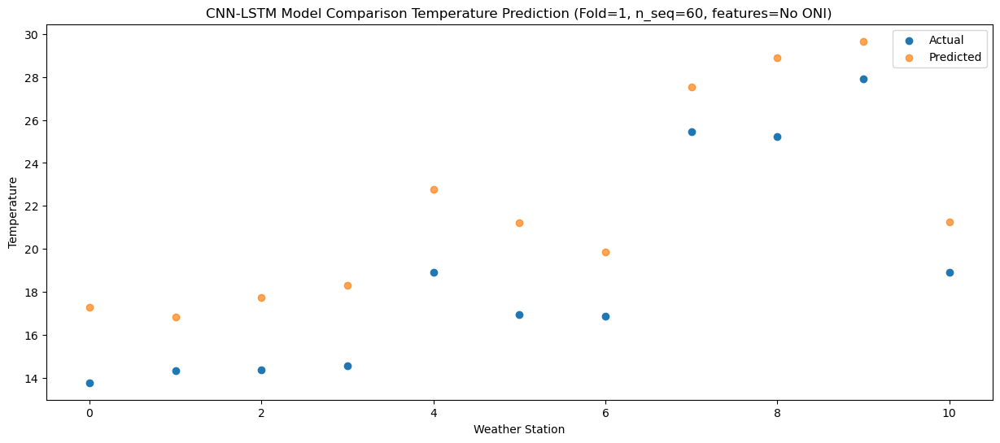

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   13.89  17.970778
1                 1   14.60  17.658288
2                 2   15.04  18.598183
3                 3   15.55  18.853604
4                 4   19.90  23.344138
5                 5   16.37  21.292525
6                 6   17.14  20.674305
7                 7   26.69  28.185846
8                 8   25.61  29.051948
9                 9   27.77  29.403993
10               10   18.71  21.981934


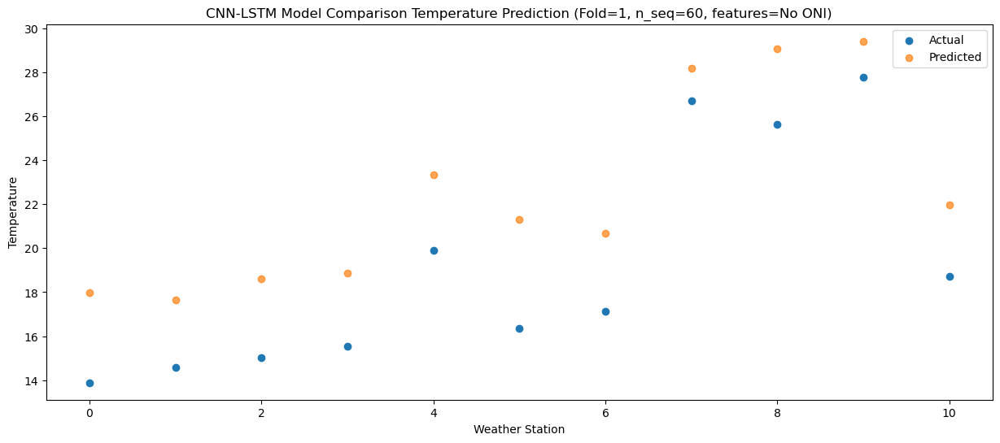

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   11.24  14.945485
1                 1   10.86  14.523027
2                 2   12.02  15.826048
3                 3   12.54  16.723867
4                 4   16.32  21.196392
5                 5   16.01  18.858878
6                 6   13.81  17.465236
7                 7   22.98  25.444040
8                 8   23.10  26.549368
9                 9   25.82  26.620563
10               10   15.01  17.648257


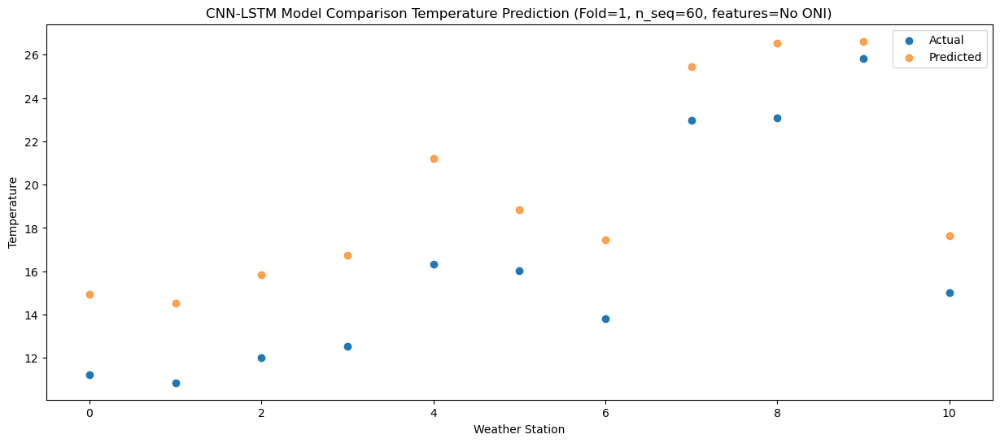

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.54  11.226653
1                 1    7.08  10.567928
2                 2    8.24  11.842385
3                 3    9.85  11.903750
4                 4   13.28  16.341701
5                 5   11.69  13.182249
6                 6    9.86  13.550297
7                 7   17.78  20.159400
8                 8   16.85  20.087957
9                 9   18.38  19.625798
10               10   10.59  13.129223


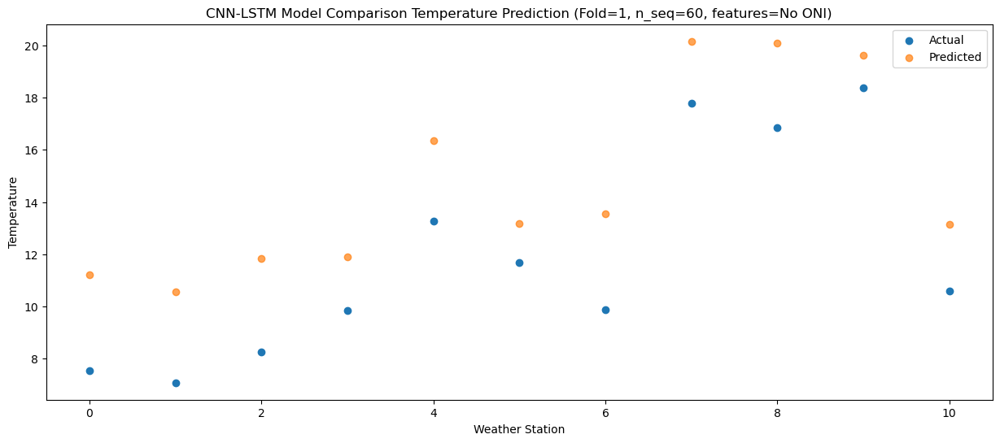

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -0.67   4.404995
1                 1   -0.58   3.114171
2                 2    0.50   4.701133
3                 3    2.69   5.878946
4                 4    5.73  10.191622
5                 5    5.22   7.801287
6                 6    2.26   6.109339
7                 7    8.48  12.730594
8                 8    9.10  13.651835
9                 9   12.13  13.888184
10               10    1.27   4.615435


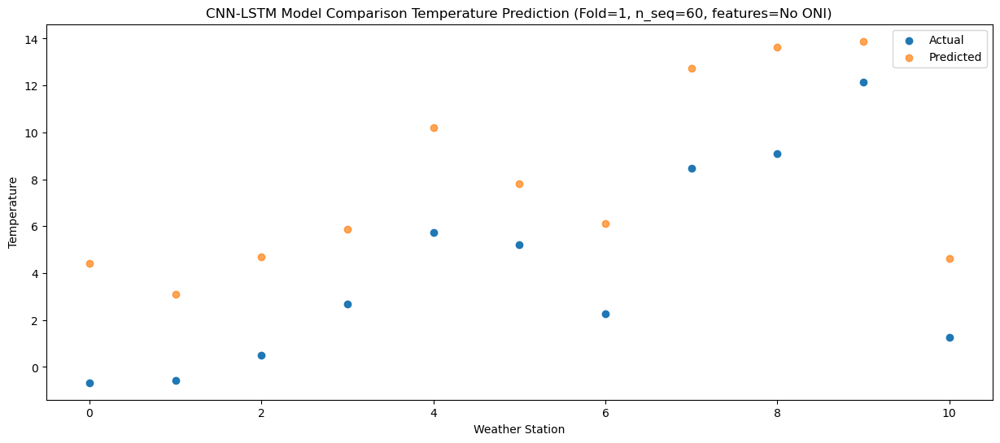

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.68   4.770470
1                 1    1.05   3.585467
2                 2    3.10   6.003984
3                 3    6.06   7.211861
4                 4    9.61  11.569941
5                 5    5.48   6.775383
6                 6    3.78   6.379220
7                 7   10.89  13.050996
8                 8    8.29  12.664056
9                 9   10.52  10.960166
10               10    0.50   1.850432


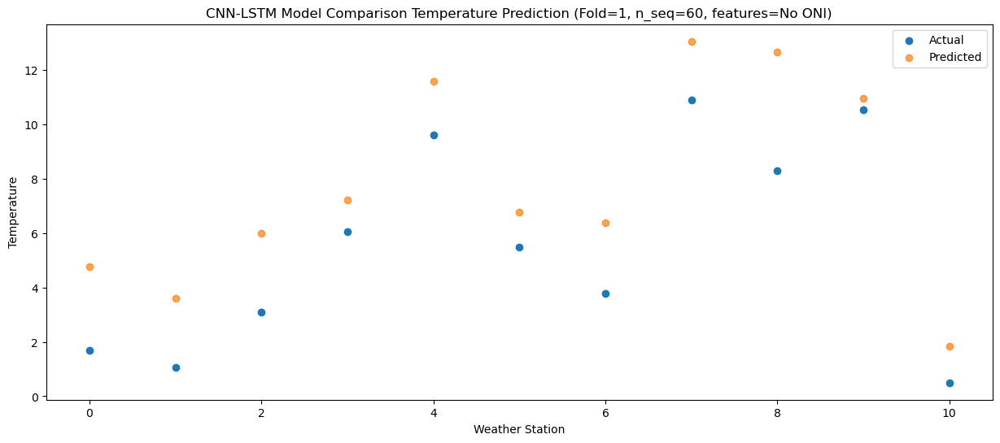

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.48  -1.411590
1                 1   -5.68  -3.517835
2                 2   -3.79  -1.256450
3                 3   -1.99   0.500244
4                 4    1.13   4.663167
5                 5   -1.84   1.412203
6                 6   -2.61  -0.547593
7                 7    2.06   5.041629
8                 8    0.67   5.653832
9                 9    3.60   5.394618
10               10   -6.52  -5.029389


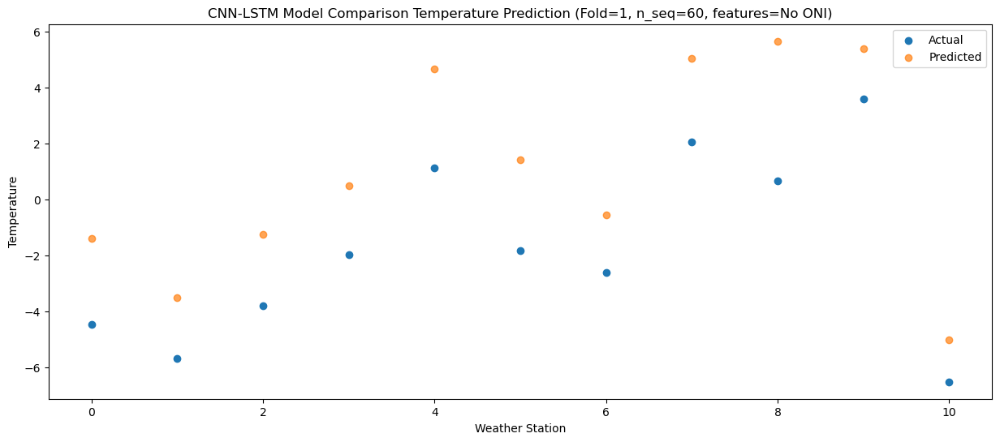

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.36   1.616871
1                 1   -1.45  -0.589201
2                 2   -0.44   1.286630
3                 3   -2.46   1.868580
4                 4    0.82   6.011662
5                 5   -1.95   2.539462
6                 6    1.20   2.496778
7                 7    4.11   6.628491
8                 8    1.65   6.239265
9                 9    3.66   5.962145
10               10   -2.62  -1.386009


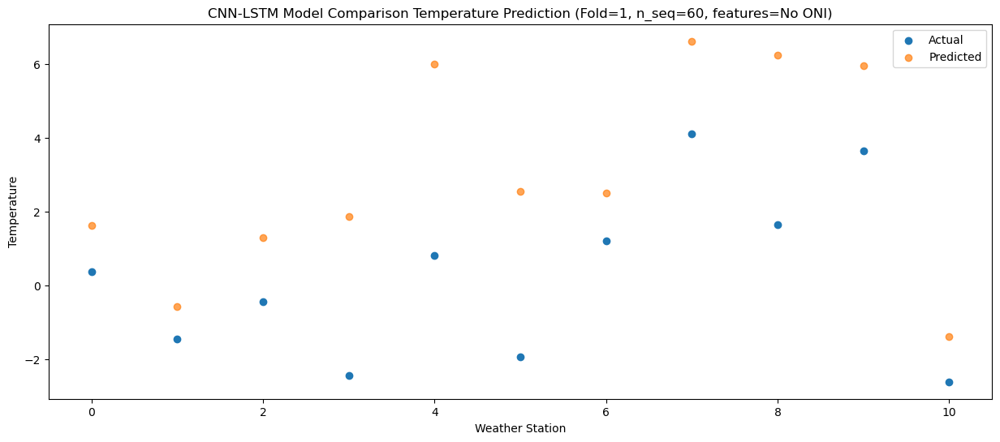

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.75   5.488750
1                 1    2.12   4.024742
2                 2    3.56   5.971353
3                 3    3.38   7.016039
4                 4    6.60  11.302541
5                 5    5.00   7.842766
6                 6    5.04   6.983285
7                 7   10.06  13.048363
8                 8    8.90  13.237227
9                 9   10.59  12.707489
10               10    1.94   3.808664


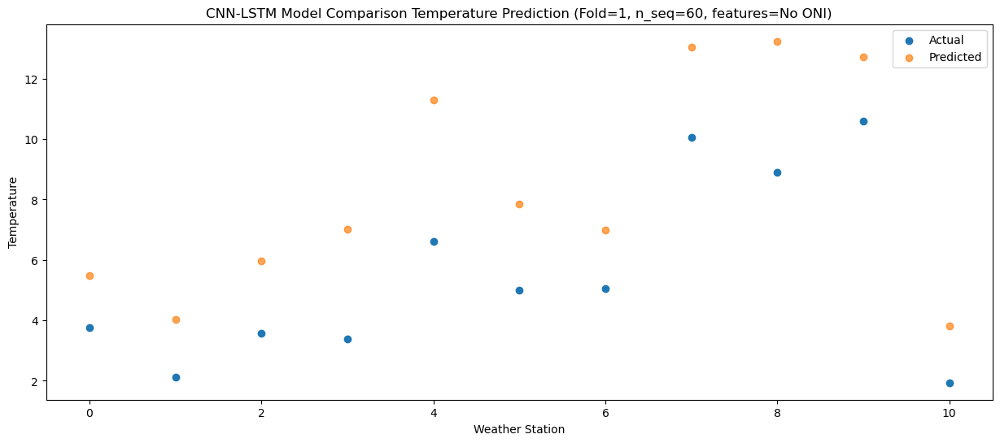

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    5.74   9.315887
1                 1    5.12   8.196515
2                 2    7.15  10.340381
3                 3    9.38  11.762119
4                 4   12.87  16.128711
5                 5   11.91  12.329853
6                 6    7.80  11.050386
7                 7   15.25  18.242519
8                 8   16.01  18.636751
9                 9   17.07  17.637549
10               10    5.29   7.747529


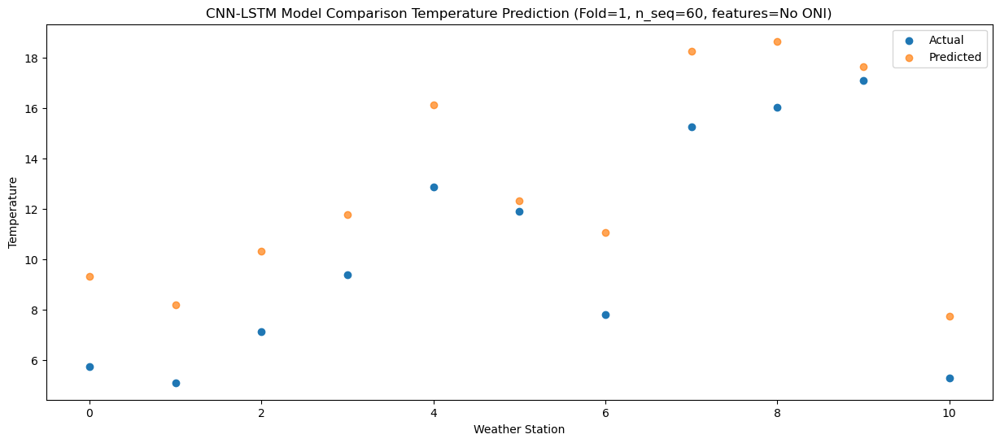

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.99  13.952453
1                 1   11.00  13.479478
2                 2   12.51  15.061740
3                 3   13.81  15.717178
4                 4   17.49  20.199438
5                 5   17.31  16.842040
6                 6   13.72  16.358652
7                 7   20.72  24.032091
8                 8   21.37  24.363547
9                 9   22.52  23.608846
10               10   12.27  15.352014


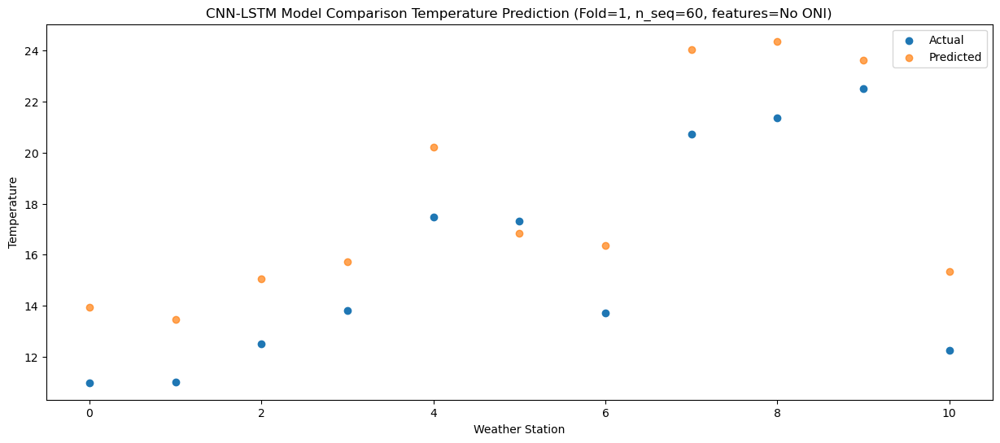

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.49  17.898671
1                 1   14.97  17.608496
2                 2   15.48  19.243264
3                 3   16.81  20.388135
4                 4   20.86  24.900657
5                 5   19.37  21.929451
6                 6   17.30  20.434259
7                 7   24.78  29.020965
8                 8   25.66  30.015380
9                 9   27.09  29.455747
10               10   16.66  19.690322


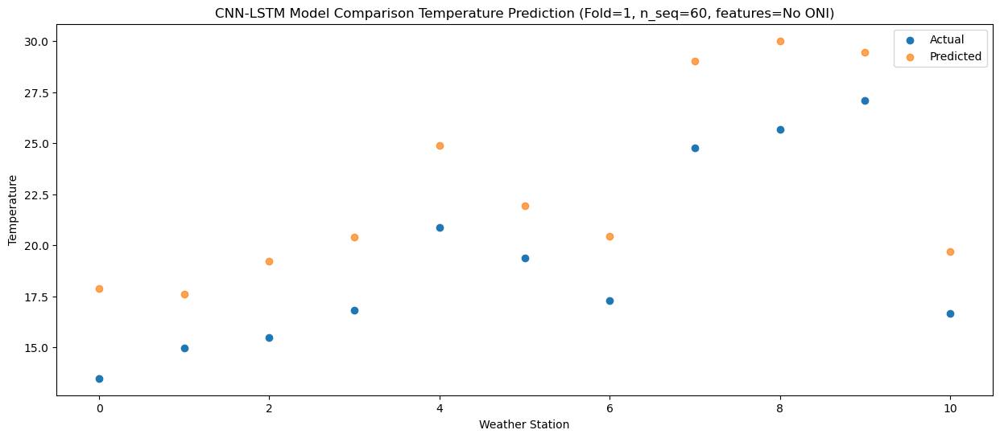

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   14.39  19.516347
1                 1   15.47  19.350731
2                 2   16.19  20.769212
3                 3   17.75  22.076718
4                 4   21.95  26.613110
5                 5   20.29  24.360996
6                 6   18.04  22.211979
7                 7   28.91  31.182571
8                 8   29.81  32.687508
9                 9   30.69  32.614460
10               10   20.60  22.515464


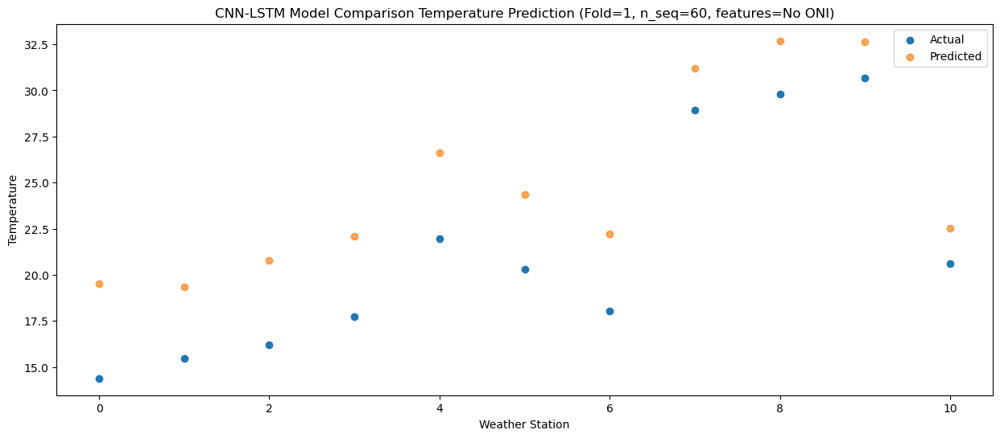

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.59  18.789795
1                 1   14.01  18.285617
2                 2   14.58  19.390574
3                 3   16.11  20.250302
4                 4   19.94  24.716289
5                 5   17.44  23.031427
6                 6   16.54  21.276143
7                 7   26.04  29.159699
8                 8   27.14  30.577123
9                 9   27.86  31.098312
10               10   20.06  22.179829


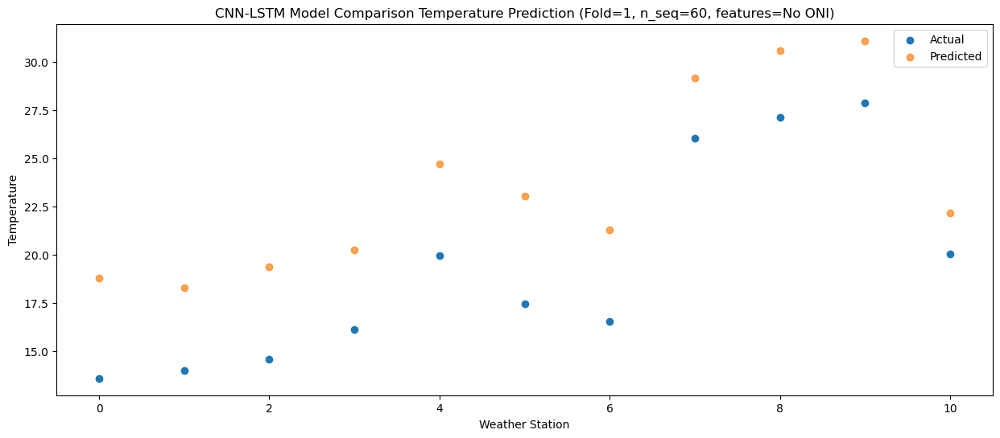

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   11.63  15.975484
1                 1   10.92  15.224892
2                 2   12.19  16.696842
3                 3   13.34  17.951482
4                 4   16.76  22.367986
5                 5   14.39  20.252340
6                 6   13.65  18.162699
7                 7   22.20  25.982152
8                 8   23.31  27.388916
9                 9   25.45  27.641686
10               10   15.15  17.688722


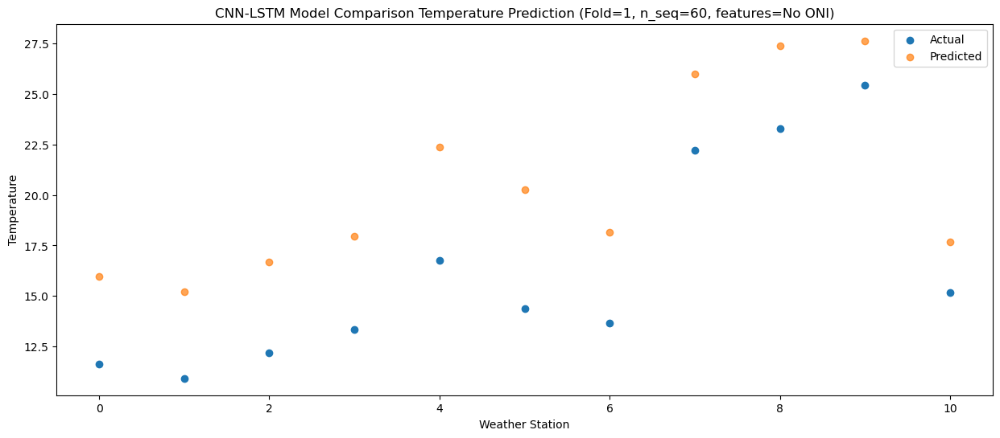

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.08  10.221330
1                 1    4.58   9.263665
2                 2    5.50  10.826457
3                 3    7.78  11.971794
4                 4   11.37  16.343261
5                 5    8.31  13.920710
6                 6    7.31  12.215893
7                 7   15.53  19.463451
8                 8   15.08  20.464965
9                 9   16.91  20.544926
10               10    7.05  11.188223


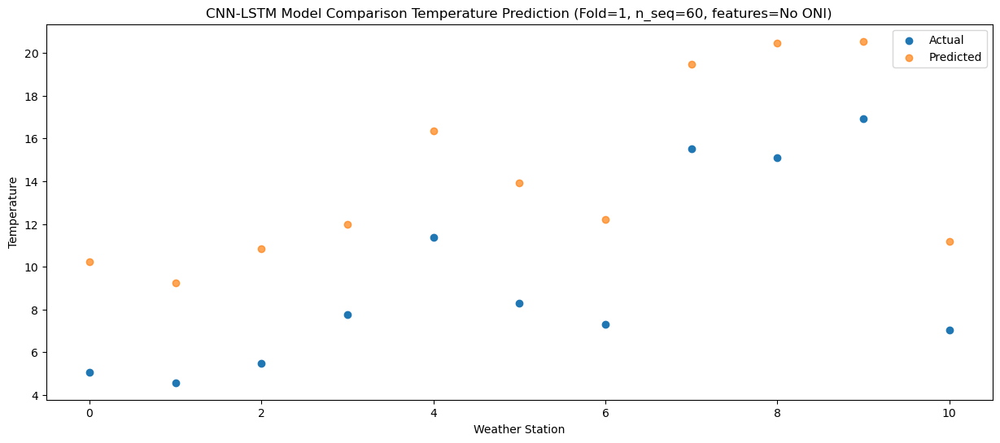

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.88   6.883949
1                 1    1.58   5.478771
2                 2    2.18   6.821011
3                 3    2.73   6.139188
4                 4    6.37  10.440092
5                 5    1.35   6.689871
6                 6    4.42   8.550307
7                 7    8.93  13.002200
8                 8    7.23  11.919849
9                 9    7.92  11.231434
10               10    3.54   6.750882


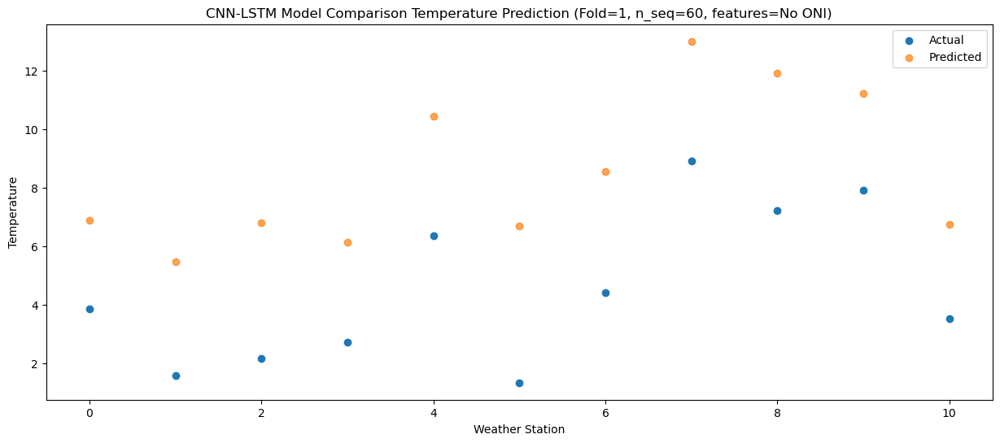

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.88   2.557951
1                 1   -4.23   0.837227
2                 2   -0.98   2.842400
3                 3    0.64   3.377282
4                 4    4.35   7.616259
5                 5    0.23   3.575163
6                 6   -1.59   3.807414
7                 7    5.19   8.823366
8                 8    3.60   8.193937
9                 9    5.57   7.242561
10               10   -3.61   0.004612


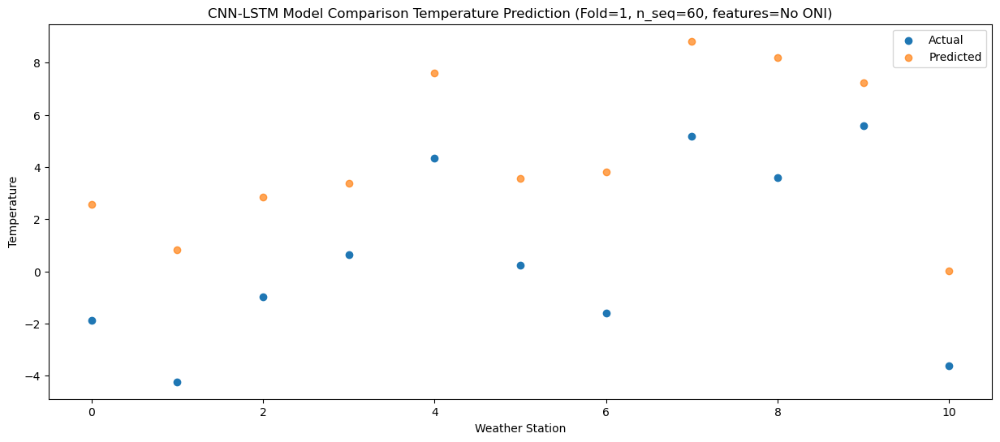

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.23   4.192972
1                 1   -2.04   2.534644
2                 2    0.02   4.434097
3                 3    1.35   4.785252
4                 4    4.83   9.033895
5                 5    0.69   5.104210
6                 6    0.54   5.517654
7                 7    6.38  10.439297
8                 8    4.46   9.766579
9                 9    5.85   8.932553
10               10   -0.65   2.024207


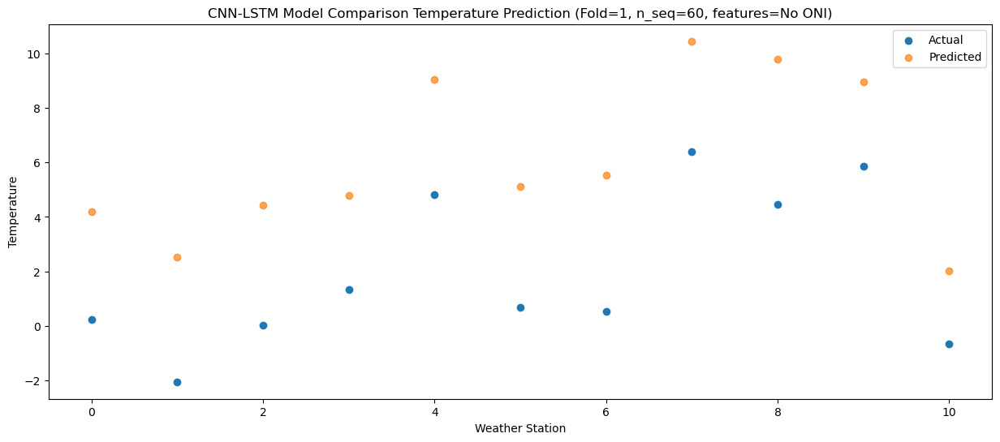

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    3.14   5.639747
1                 1    1.33   3.982649
2                 2    2.61   6.254777
3                 3    2.35   6.831845
4                 4    6.01  11.099989
5                 5    0.83   6.353170
6                 6    4.13   6.867296
7                 7    7.88  12.131118
8                 8    4.83  11.335381
9                 9    7.00   9.815670
10               10   -0.97   1.945451


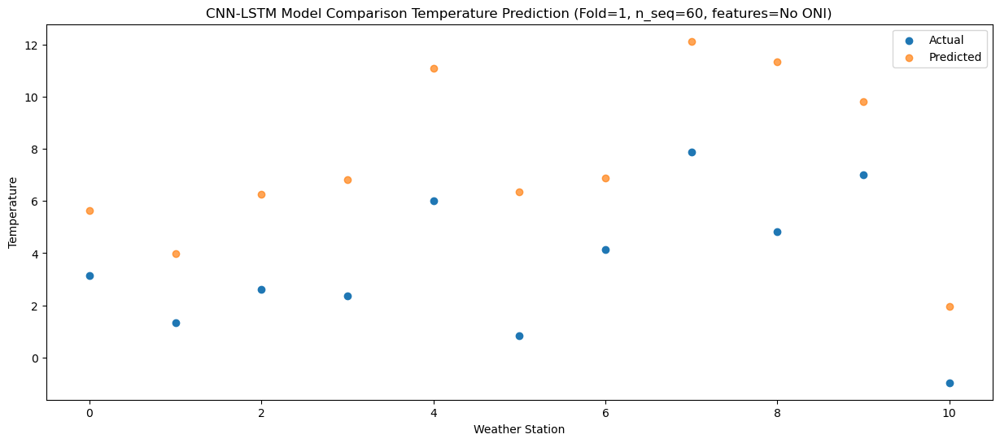

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.78   7.071290
1                 1    2.10   5.546853
2                 2    4.04   8.053009
3                 3    6.18   9.273886
4                 4    9.83  13.575845
5                 5    5.89   8.855304
6                 6    4.80   8.344366
7                 7   10.71  14.556656
8                 8    9.26  14.297954
9                 9   10.73  12.660918
10               10    0.15   3.036094


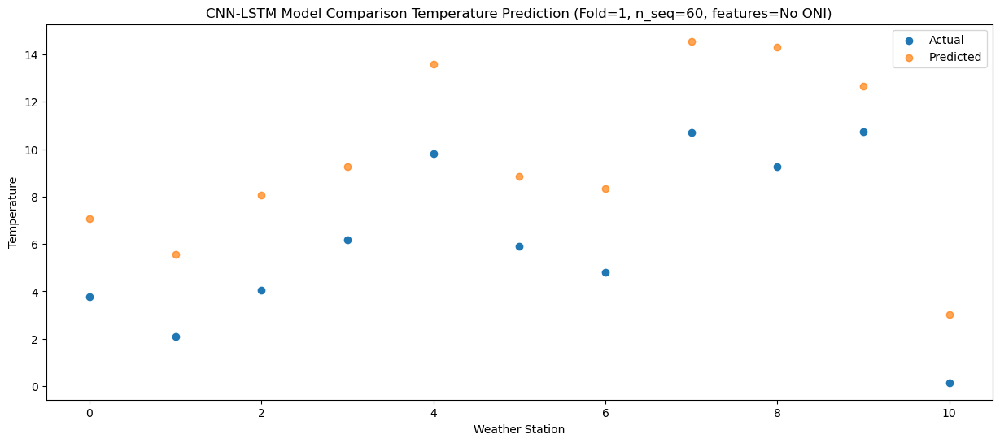

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.28  11.886240
1                 1    5.37  10.812786
2                 2    6.73  12.439323
3                 3    7.02  12.815714
4                 4   10.79  17.192276
5                 5    9.05  13.761146
6                 6    8.06  13.745770
7                 7   15.11  19.997731
8                 8   13.59  19.999986
9                 9   16.08  19.290449
10               10    7.37  11.590356


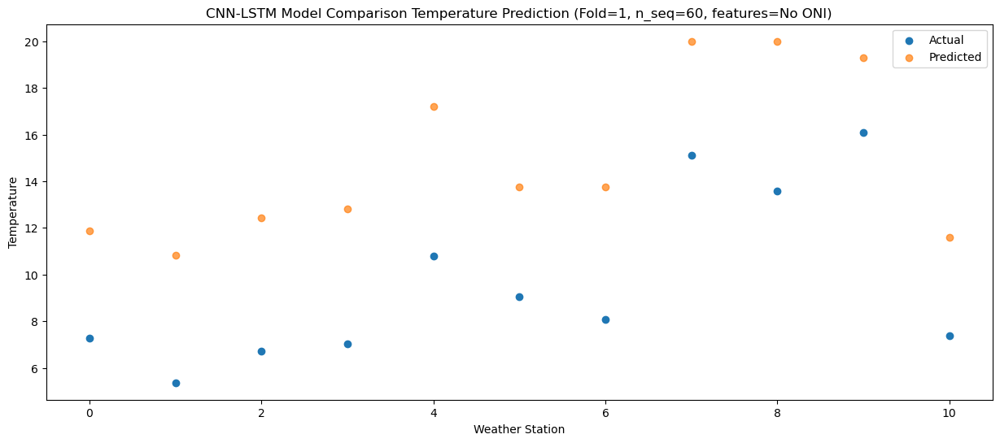

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.78  14.181367
1                 1    8.65  13.655202
2                 2    9.97  15.375515
3                 3   11.61  16.727018
4                 4   15.43  21.205782
5                 5   13.66  18.355686
6                 6   11.06  16.467511
7                 7   20.46  24.887418
8                 8   19.28  26.167125
9                 9   21.19  25.712246
10               10    9.93  15.016792


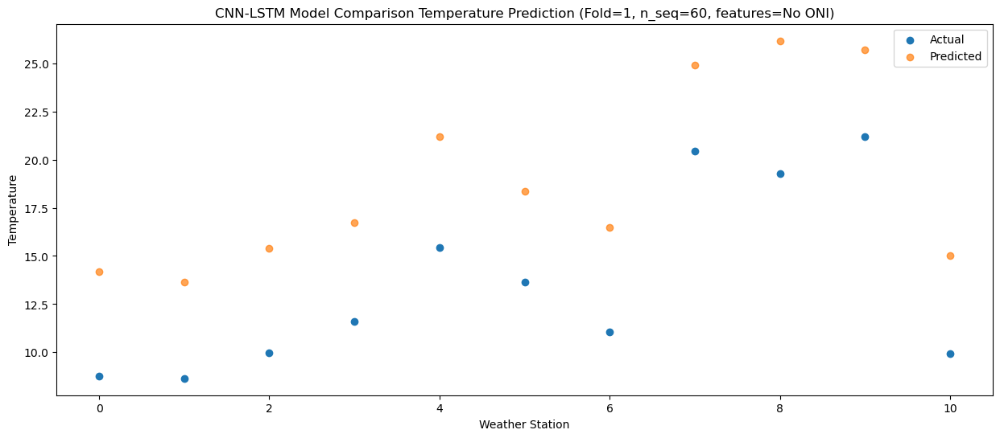

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   12.40  17.932968
1                 1   11.84  17.641105
2                 2   13.72  19.325674
3                 3   15.76  20.593431
4                 4   20.32  25.127896
5                 5   20.35  22.110131
6                 6   14.34  20.423331
7                 7   24.27  29.197816
8                 8   24.21  30.414260
9                 9   24.42  29.728119
10               10   14.30  19.204976


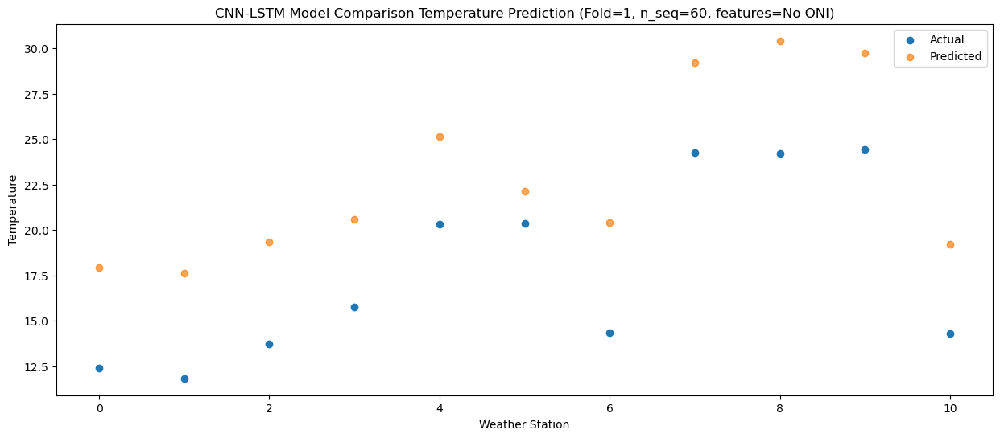

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.63  21.328368
1                 1   15.44  20.672061
2                 2   16.09  21.994955
3                 3   17.48  22.867350
4                 4   22.27  27.323531
5                 5   21.45  25.047405
6                 6   17.79  23.608450
7                 7   26.57  31.193280
8                 8   27.09  32.258792
9                 9   29.04  32.281578
10               10   19.44  23.187806


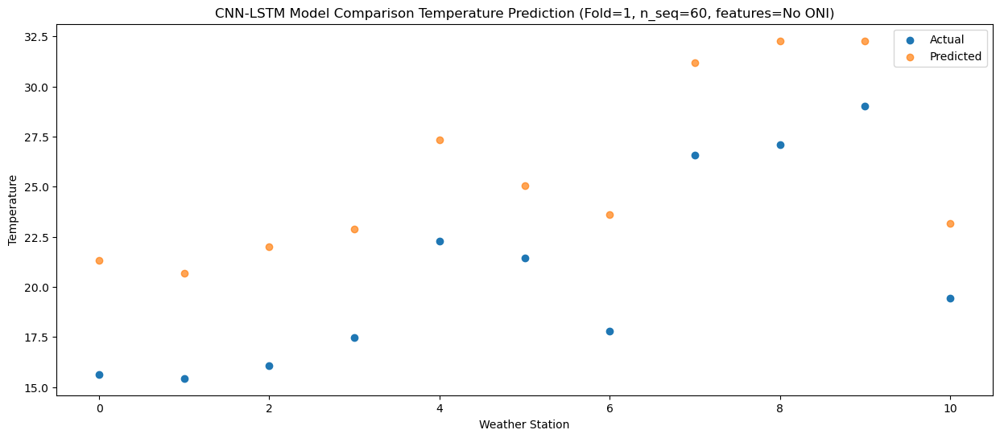

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.42  20.812783
1                 1   14.90  20.186335
2                 2   16.53  22.118813
3                 3   19.45  23.935926
4                 4   23.70  28.403476
5                 5   20.64  25.470146
6                 6   17.37  22.967221
7                 7   27.07  31.604877
8                 8   28.90  33.077964
9                 9   29.44  32.511430
10               10   17.70  20.768059


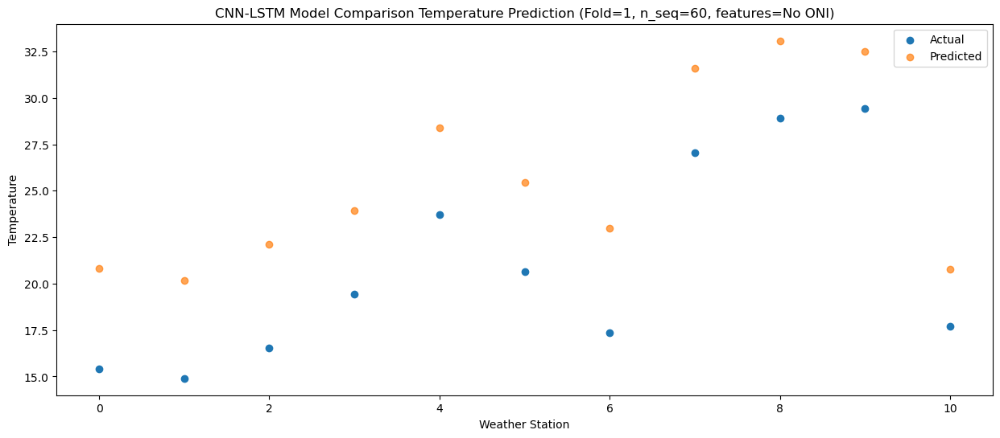

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.73  17.401723
1                 1   11.39  16.840304
2                 2   13.57  18.517356
3                 3   16.37  19.807977
4                 4   19.85  24.284760
5                 5   18.36  21.457148
6                 6   14.20  19.673569
7                 7   23.45  27.897099
8                 8   24.26  29.053453
9                 9   25.92  28.553764
10               10   14.51  18.190224


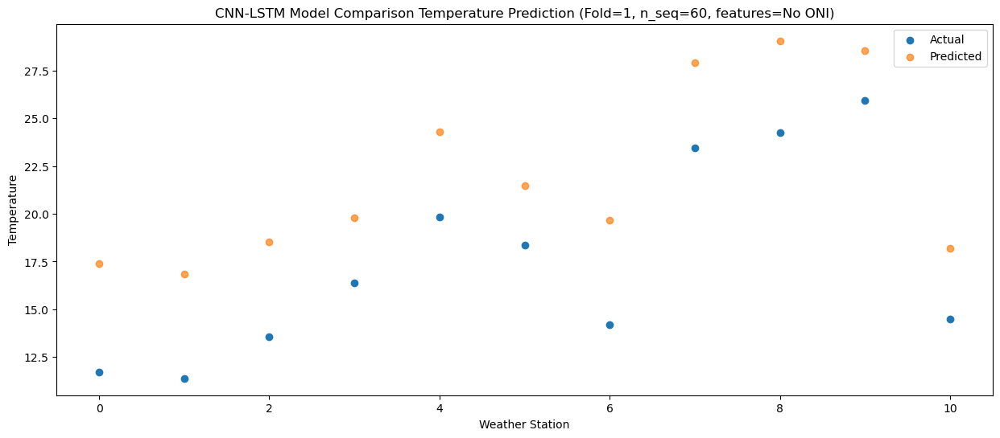

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.85  12.532230
1                 1    6.38  11.578340
2                 2    7.53  13.007507
3                 3    9.11  13.489298
4                 4   12.45  17.887696
5                 5   10.76  15.018264
6                 6    9.19  14.543494
7                 7   17.14  21.051216
8                 8   15.68  21.295386
9                 9   17.82  20.902482
10               10    9.16  13.163708


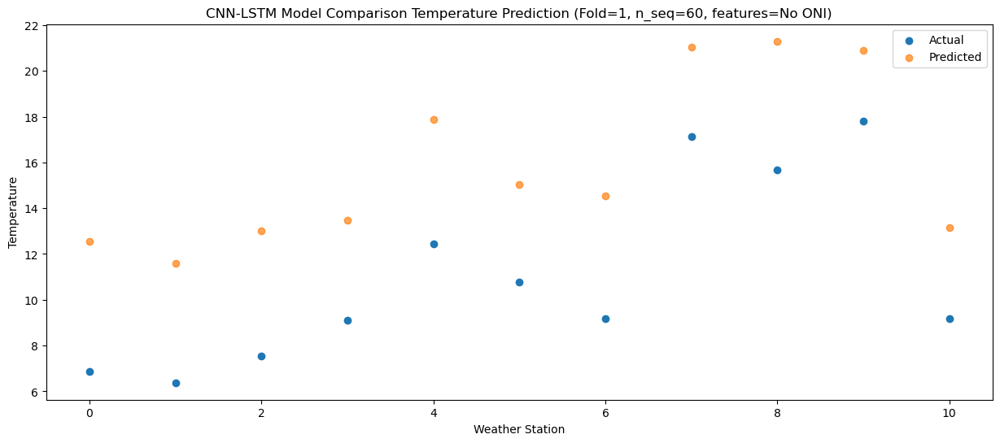

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.70   7.072430
1                 1    0.76   5.880421
2                 2    0.97   7.644239
3                 3    2.83   8.597737
4                 4    6.25  12.964860
5                 5    4.10   9.803727
6                 6    3.50   8.794218
7                 7    9.74  15.443016
8                 8    8.56  15.863621
9                 9   11.07  15.256536
10               10    1.22   6.201725


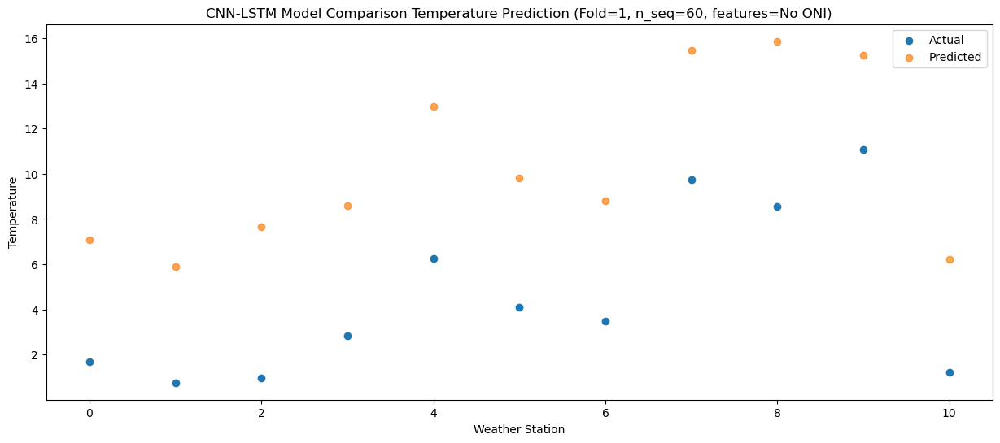

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.33   5.191054
1                 1   -2.38   3.930402
2                 2   -1.81   5.298992
3                 3    0.43   5.538530
4                 4    4.35   9.887656
5                 5    1.74   7.041831
6                 6    0.76   6.953982
7                 7    6.82  12.706430
8                 8    5.71  12.711203
9                 9    7.24  12.407093
10               10   -0.47   5.394286


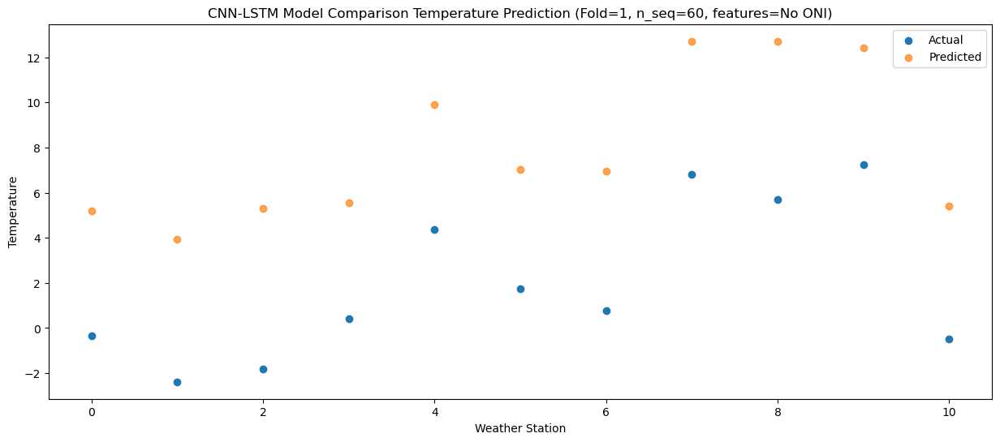

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.65   1.962462
1                 1   -5.66  -0.168435
2                 2   -4.89   1.222903
3                 3   -2.99   1.129781
4                 4    0.50   5.312186
5                 5   -1.87   2.460762
6                 6   -2.24   2.988950
7                 7    0.89   6.669220
8                 8   -0.12   6.055547
9                 9    2.07   6.049028
10               10   -4.37   0.361443


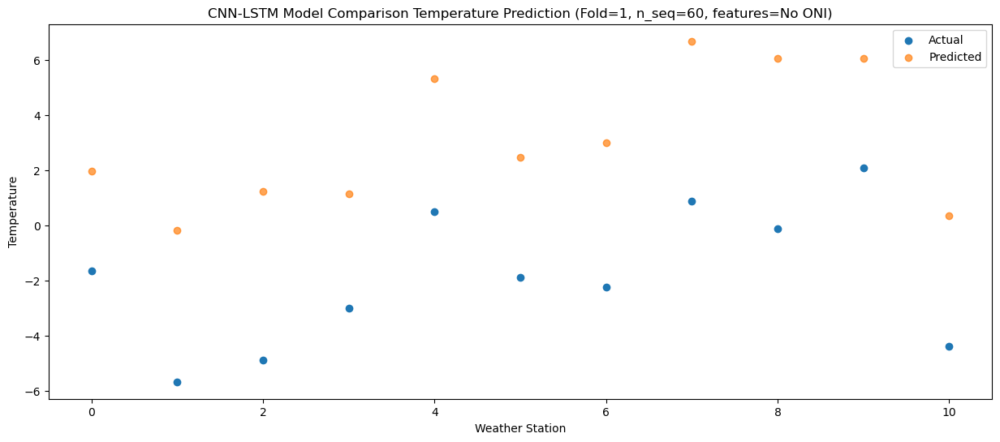

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.27   5.148940
1                 1   -0.58   4.145833
2                 2    0.45   6.419324
3                 3    3.32   8.194881
4                 4    6.87  12.602810
5                 5    4.25   8.919752
6                 6    1.97   6.905107
7                 7    9.89  14.782357
8                 8    7.83  15.513373
9                 9    9.78  14.348553
10               10   -2.42   3.043265


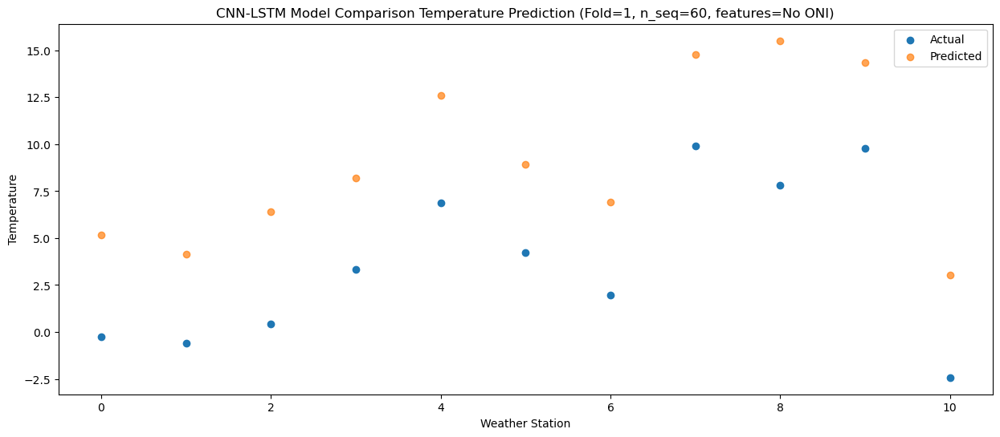

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.58   8.717926
1                 1    2.64   7.681117
2                 2    3.55   9.777349
3                 3    5.83  10.845343
4                 4    9.61  15.253276
5                 5    6.60  11.244725
6                 6    5.63  10.491691
7                 7   12.61  17.575849
8                 8   11.07  17.609675
9                 9   12.61  16.253938
10               10    1.98   6.800165


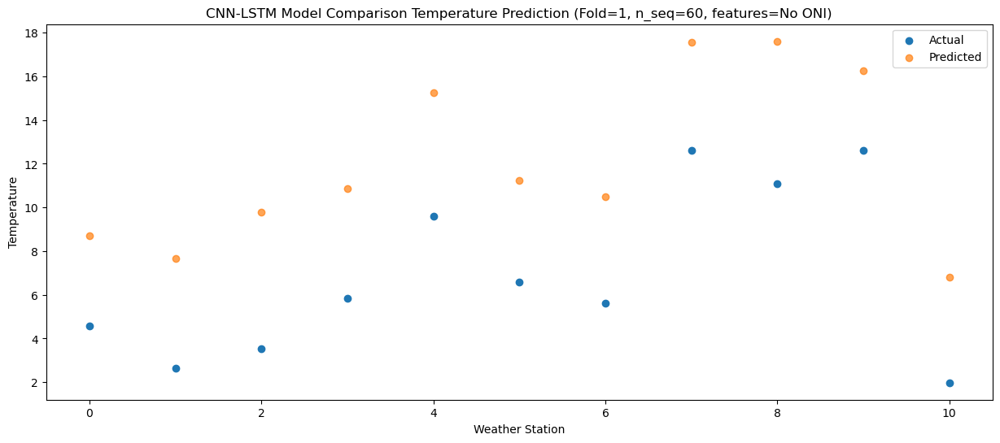

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.98  12.071527
1                 1    6.31  11.450659
2                 2    6.89  13.378180
3                 3    9.31  14.468230
4                 4   13.17  18.952246
5                 5   11.40  15.213525
6                 6    9.10  14.233957
7                 7   16.65  22.129648
8                 8   15.75  22.544435
9                 9   17.68  21.299024
10               10    6.37  11.497531


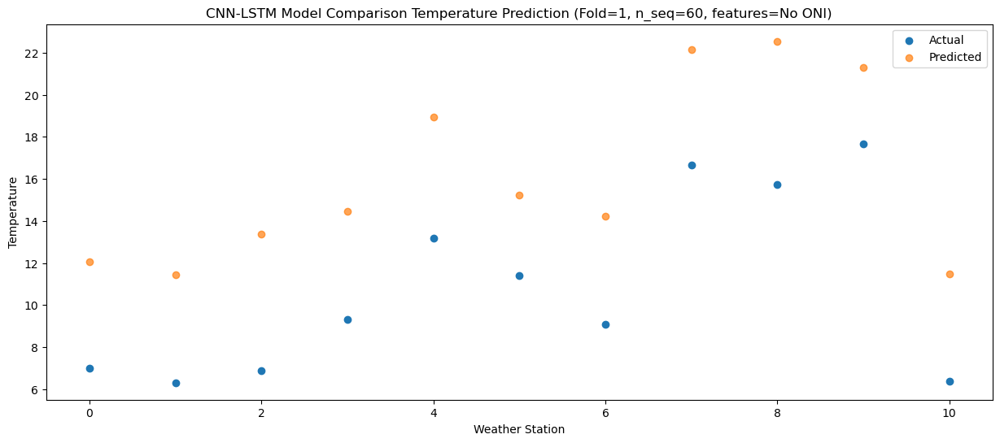

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.65  17.108011
1                 1   10.88  16.748048
2                 2   12.50  18.354104
3                 3   13.01  18.861882
4                 4   16.87  23.405010
5                 5   17.02  19.755369
6                 6   13.34  19.565592
7                 7   22.19  27.385718
8                 8   20.51  27.440615
9                 9   21.82  26.232947
10               10   11.96  17.976632


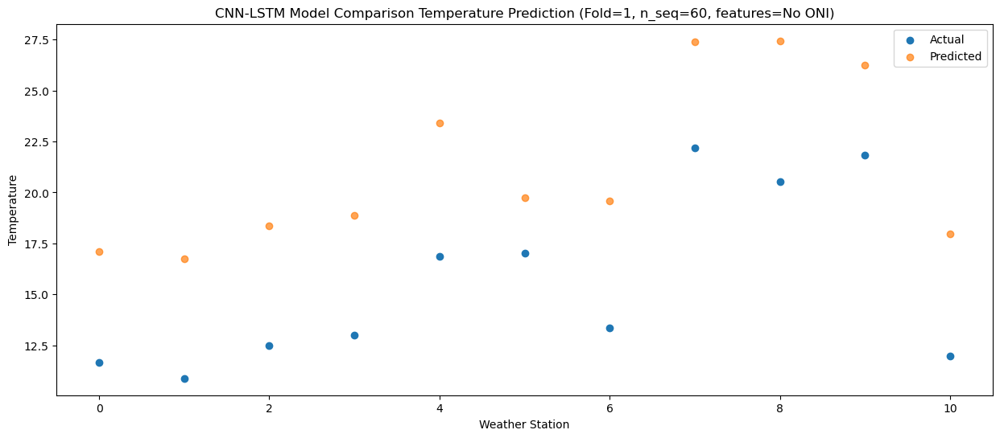

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   14.52  21.022996
1                 1   14.64  20.709036
2                 2   15.61  22.089847
3                 3   15.64  22.785863
4                 4   19.76  27.337534
5                 5   19.88  24.499983
6                 6   17.27  23.576953
7                 7   25.26  31.734199
8                 8   26.21  32.387257
9                 9   28.23  31.765052
10               10   18.07  22.976365


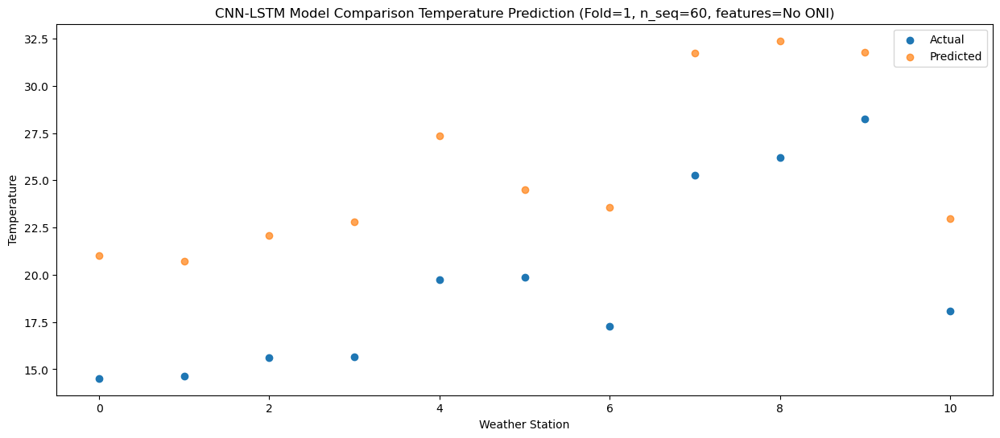

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   15.48  22.664271
1                 1   15.57  22.070121
2                 2   15.63  23.055796
3                 3   15.03  23.537565
4                 4   19.57  28.022505
5                 5   18.88  26.149062
6                 6   18.30  25.074789
7                 7   25.90  32.439455
8                 8   27.06  33.389419
9                 9   28.96  33.681176
10               10   20.00  25.536968


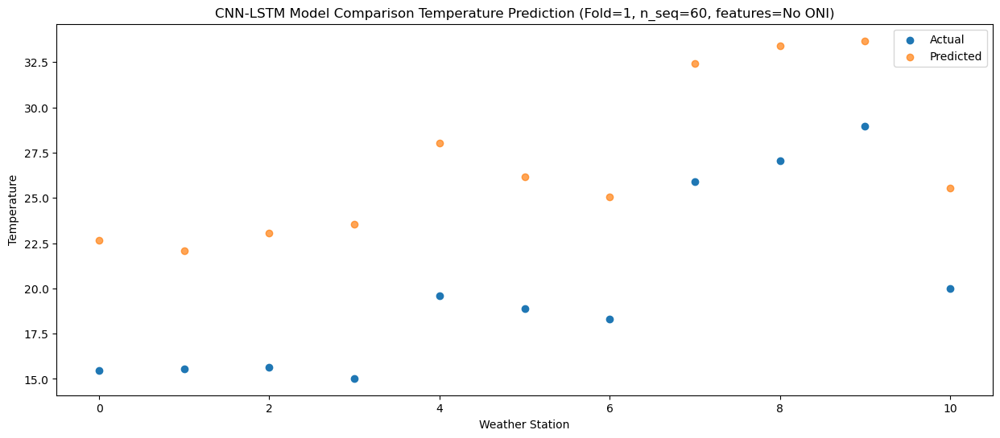

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   14.13  21.192636
1                 1   15.29  20.878425
2                 2   15.94  22.476778
3                 3   16.16  23.846214
4                 4   20.89  28.396083
5                 5   20.48  25.688742
6                 6   17.97  23.689503
7                 7   26.31  32.519549
8                 8   29.17  33.748127
9                 9   29.76  33.197020
10               10   17.85  22.586237


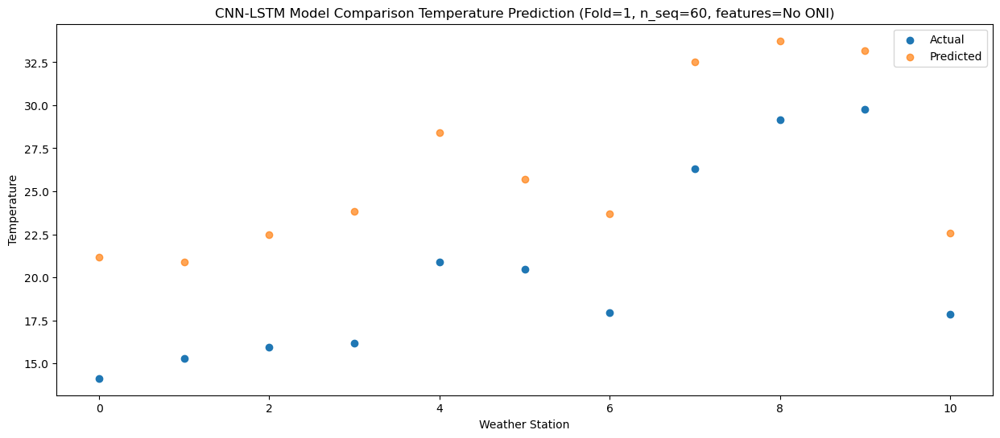

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.69  18.958564
1                 1   11.57  18.436411
2                 2   13.63  19.775459
3                 3   13.56  20.677296
4                 4   17.60  25.182790
5                 5   14.77  22.807457
6                 6   14.67  21.333203
7                 7   24.44  29.372201
8                 8   23.20  30.392810
9                 9   25.20  30.207202
10               10   14.12  20.749583


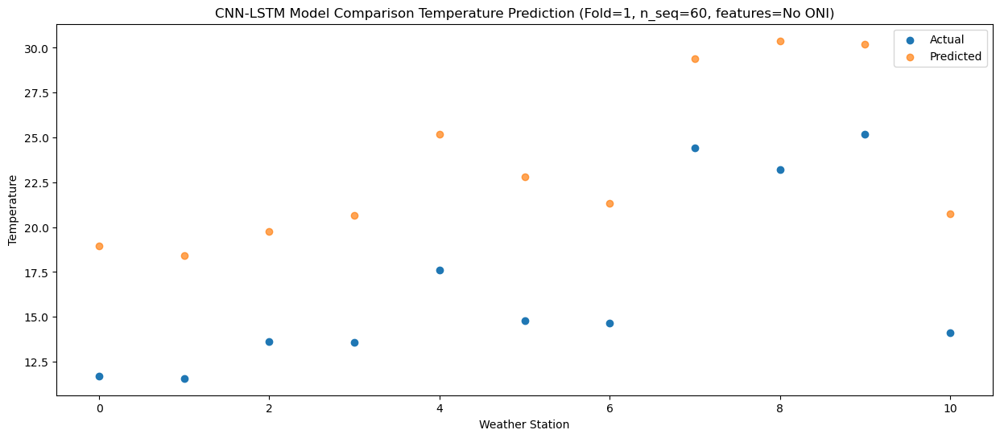

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    6.81  14.414184
1                 1    7.12  13.793194
2                 2    8.63  15.640531
3                 3   10.87  17.208034
4                 4   14.45  21.703029
5                 5   13.62  18.718428
6                 6    9.87  16.583005
7                 7   18.97  25.074216
8                 8   19.34  26.108846
9                 9   20.35  25.369089
10               10    9.25  14.420224


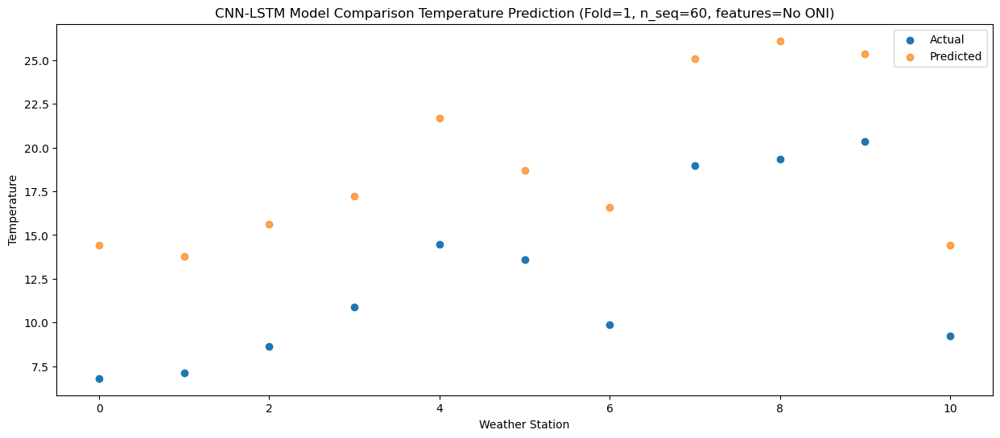

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_1 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_1 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_3 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_2 (LSTM)               (None, 1, 256)            1311744   
                                                                 
 dropout_4 (Dropout)         (None, 1, 256)            0         
                                                                 
 lstm_3 (LSTM)               (None, 256)               525312    
                                                      

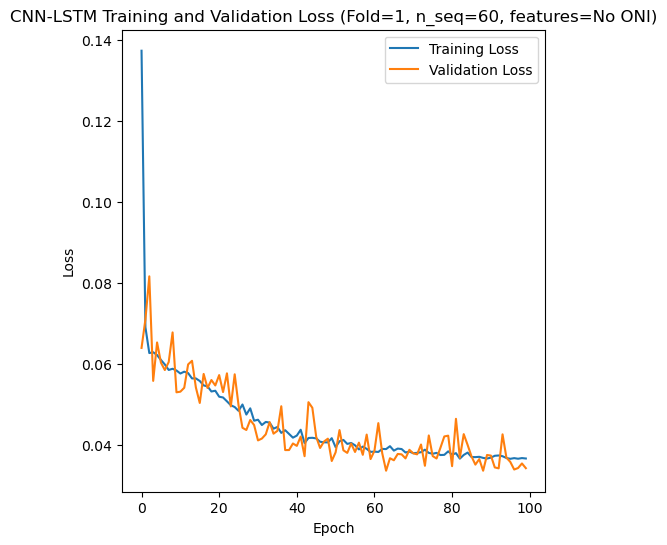

Epoch 1/100
84/84 [==============================] - 13s 32ms/step - loss: 0.1269 - accuracy: 0.2738 - mae: 0.1091 - rmse: 0.1269 - mape: inf - pearson: 0.6599 - val_loss: 0.0468 - val_accuracy: 0.6000 - val_mae: 0.0372 - val_rmse: 0.0468 - val_mape: 8.2111 - val_pearson: 0.9133
Epoch 2/100
84/84 [==============================] - 1s 16ms/step - loss: 0.0681 - accuracy: 0.4286 - mae: 0.0542 - rmse: 0.0681 - mape: inf - pearson: 0.8121 - val_loss: 0.0471 - val_accuracy: 0.6000 - val_mae: 0.0381 - val_rmse: 0.0471 - val_mape: 8.6934 - val_pearson: 0.9044
Epoch 3/100
84/84 [==============================] - 1s 16ms/step - loss: 0.0652 - accuracy: 0.4048 - mae: 0.0516 - rmse: 0.0652 - mape: inf - pearson: 0.8192 - val_loss: 0.0504 - val_accuracy: 0.6000 - val_mae: 0.0411 - val_rmse: 0.0504 - val_mape: 9.3986 - val_pearson: 0.8950
Epoch 4/100
84/84 [==============================] - 1s 16ms/step - loss: 0.0639 - accuracy: 0.4286 - mae: 0.0504 - rmse: 0.0639 - mape: inf - pearson: 0.8276 - v

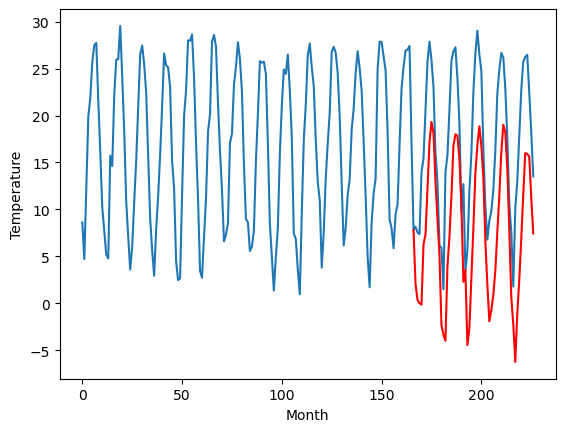

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.57		-0.74		-2.31
-0.71		-3.77		-3.06
-0.95		-4.15		-3.20
-1.68		-3.99		-2.31
6.33		1.88		-4.45
8.56		4.65		-3.91
15.36		10.99		-4.37
22.56		16.53		-6.03
22.59		18.79		-3.80
21.26		18.38		-2.88
15.13		11.93		-3.20
8.14		5.89		-2.25
5.02		1.62		-3.40
-1.61		-4.56		-2.95
-1.69		-5.16		-3.47
-5.73		-7.47		-1.74
4.46		1.28		-3.18
8.22		5.21		-3.01
13.40		10.17		-3.23
20.65		17.62		-3.03
21.34		19.35		-1.99
22.10		18.05		-4.05
19.86		15.21		-4.65
11.60		8.10		-3.50
4.89		1.70		-3.19
2.50		-1.25		-3.75
-2.19		-6.82		-4.63
-2.20		-6.44		-4.24
4.78		-0.04		-4.82
11.46		5.30		-6.16
17.26		11.52		-5.74
21.06		16.04		-5.02
24.30		19.48		-4.82
21.99		17.90		-4.09
19.23		13.89		-5.34
10.85		6.40		-4.45
0.86		-2.23		-3.09
-1.85		-5.82		-3.97
-2.10		-4.59		-2.49
-0.50		-3.99		-3.49
3.57		-0.61		-4.18
9.43		5.30		-4.13
14.92		11.54		-3.38
17.53		15.97		-1.56
21.63		19.48		-2.15
22.12		18.63		-3.49
19.25		14

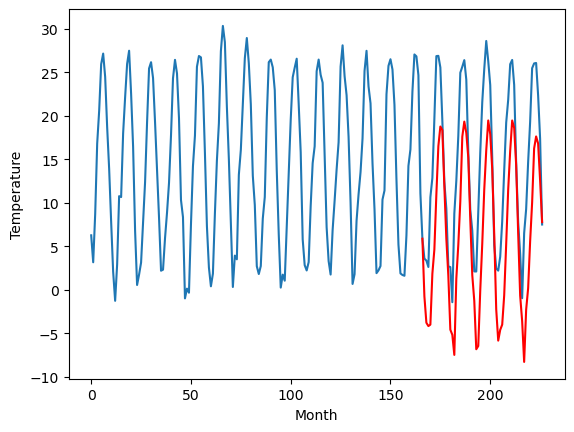

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.66		2.31		-3.35
4.54		1.40		-3.14
3.39		1.28		-2.11
4.43		1.97		-2.46
8.05		5.12		-2.93
9.44		6.35		-3.09
10.75		8.39		-2.36
13.34		10.31		-3.03
13.98		12.61		-1.37
13.67		12.67		-1.00
12.41		10.22		-2.19
11.14		9.63		-1.51
7.72		4.51		-3.21
0.73		-1.92		-2.65
1.39		-1.28		-2.67
4.12		3.20		-0.92
5.93		3.63		-2.30
7.74		6.63		-1.11
11.32		10.06		-1.26
12.54		12.21		-0.33
13.33		13.60		0.27
13.38		13.52		0.14
12.10		11.86		-0.24
10.96		8.81		-2.15
4.11		2.49		-1.62
5.01		4.73		-0.28
0.75		0.46		-0.29
3.08		3.53		0.45
6.55		5.57		-0.98
8.36		7.82		-0.54
11.12		10.96		-0.16
12.93		12.71		-0.22
13.11		13.12		0.01
12.54		12.55		0.01
11.13		10.90		-0.23
8.50		5.73		-2.77
6.74		4.46		-2.28
2.64		0.88		-1.76
2.44		2.22		-0.22
5.50		4.69		-0.81
6.52		5.54		-0.98
9.06		7.59		-1.47
10.04		7.97		-2.07
12.45		10.99		-1.46
14.36		14.77		0.41
14.54		13.89		-0.65
12.59		10.51		-2.08
9.01		7.09		-1.92
5.03	

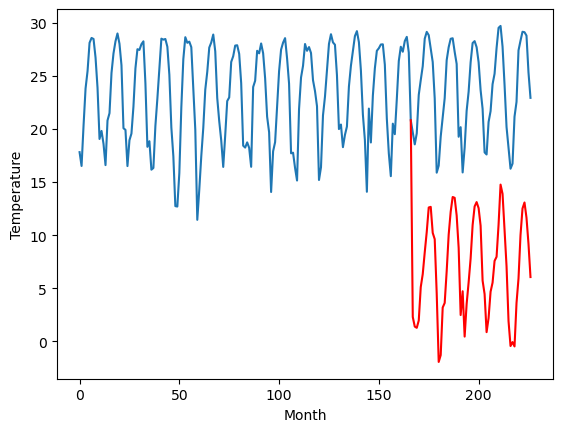

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.01		-2.81		-2.80
-3.07		-5.13		-2.06
-2.80		-4.88		-2.08
-2.65		-5.01		-2.36
0.90		-0.97		-1.87
2.13		1.10		-1.03
8.02		7.20		-0.82
14.08		12.77		-1.31
18.36		17.03		-1.33
16.51		15.25		-1.26
11.93		10.13		-1.80
6.71		6.34		-0.37
2.75		1.15		-1.60
-4.08		-5.72		-1.64
-7.16		-7.65		-0.49
-7.14		-6.15		0.99
-3.03		-1.63		1.40
1.47		3.90		2.43
6.73		8.48		1.75
12.30		14.81		2.51
14.30		16.29		1.99
15.36		16.61		1.25
12.19		12.96		0.77
8.36		8.54		0.18
0.28		-0.73		-1.01
-1.64		-1.66		-0.02
-7.79		-8.56		-0.77
-5.47		-4.72		0.75
-1.61		-0.18		1.43
2.83		4.24		1.41
8.17		11.22		3.05
12.41		13.85		1.44
17.03		16.94		-0.09
16.95		16.23		-0.72
11.91		11.67		-0.24
6.47		4.98		-1.49
2.67		1.99		-0.68
-3.50		-3.53		-0.03
-2.21		-1.64		0.57
-4.09		-1.89		2.20
-1.65		-0.38		1.27
4.07		6.47		2.40
7.70		8.92		1.22
11.49		13.29		1.80
17.06		18.74		1.68
15.05		15.58		0.53
12.63		12.42		-0.21
7.61		7.67		0.

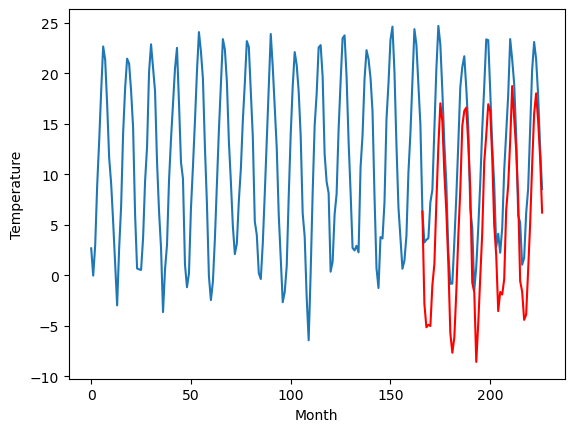

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.32		-1.29		-0.97
0.03		-2.38		-2.41
0.37		-2.56		-2.93
1.01		-2.26		-3.27
7.70		2.81		-4.89
7.17		3.53		-3.64
10.14		6.60		-3.54
13.18		9.58		-3.60
13.92		11.64		-2.28
14.29		11.22		-3.07
11.94		7.53		-4.41
8.25		5.62		-2.63
4.13		1.15		-2.98
-2.17		-5.87		-3.70
-1.82		-5.85		-4.03
-2.56		-3.77		-1.21
4.77		0.31		-4.46
5.64		2.87		-2.77
10.11		6.61		-3.50
13.59		9.83		-3.76
14.18		11.12		-3.06
14.35		11.08		-3.27
11.81		9.27		-2.54
9.07		5.51		-3.56
0.80		-1.59		-2.39
4.21		1.14		-3.07
-3.52		-5.34		-1.82
-0.38		-3.18		-2.80
3.38		0.44		-2.94
7.18		4.44		-2.74
12.34		8.36		-3.98
14.93		10.63		-4.30
14.76		11.67		-3.09
13.94		10.03		-3.91
11.97		7.77		-4.20
5.78		1.97		-3.81
2.71		-0.79		-3.50
0.20		-3.97		-4.17
1.37		-2.84		-4.21
3.50		-0.55		-4.05
5.33		1.36		-3.97
7.25		3.53		-3.72
11.28		5.48		-5.80
14.93		9.31		-5.62
16.37		12.55		-3.82
17.67		12.08		-5.59
13.24		8.29		-4.95
7.08		3.18

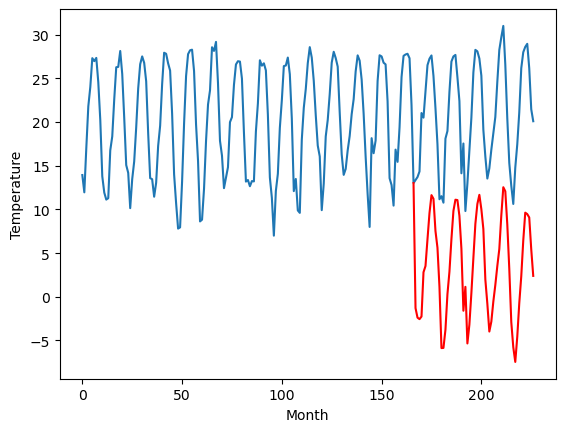

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.39		-2.80		-2.41
-1.82		-4.47		-2.65
-1.45		-4.50		-3.05
-2.21		-4.37		-2.16
5.88		1.74		-4.14
5.85		2.45		-3.40
9.69		6.58		-3.11
13.30		10.27		-3.03
15.00		12.25		-2.75
15.30		11.77		-3.53
10.90		6.86		-4.04
6.43		3.60		-2.83
3.75		-0.75		-4.50
-2.36		-7.65		-5.29
-2.95		-7.96		-5.01
-5.30		-7.87		-2.57
3.08		-1.35		-4.43
5.20		1.21		-3.99
9.24		5.25		-3.99
13.79		9.76		-4.03
13.87		11.16		-2.71
14.98		10.90		-4.08
12.24		8.94		-3.30
8.94		3.98		-4.96
1.30		-2.92		-4.22
4.54		-0.92		-5.46
-3.89		-8.13		-4.24
-4.27		-7.17		-2.90
1.85		-2.20		-4.05
8.00		3.21		-4.79
12.60		7.50		-5.10
16.32		10.47		-5.85
17.68		12.52		-5.16
14.96		10.17		-4.79
12.30		7.28		-5.02
6.73		0.89		-5.84
0.85		-4.26		-5.11
-1.38		-6.70		-5.32
-0.62		-5.80		-5.18
0.57		-4.21		-4.78
4.37		-1.22		-5.59
5.29		1.32		-3.97
10.37		4.95		-5.42
15.29		9.28		-6.01
17.45		12.45		-5.00
19.15		12.26		-6.89
14.67		7.99		-6.68
6

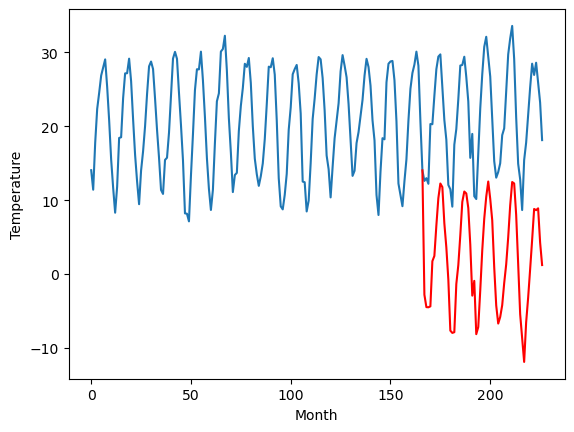

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
10.42		9.00		-1.42
8.61		7.07		-1.54
8.96		6.86		-2.10
8.40		6.89		-1.51
16.05		13.54		-2.51
16.36		14.46		-1.90
21.26		19.12		-2.14
26.00		23.45		-2.55
27.18		25.24		-1.94
27.41		24.66		-2.75
21.47		19.23		-2.24
15.99		15.15		-0.84
13.50		11.13		-2.37
7.04		4.11		-2.93
6.34		3.62		-2.72
3.23		2.54		-0.69
13.60		10.65		-2.95
15.30		13.21		-2.09
19.38		17.52		-1.86
24.94		22.76		-2.18
25.83		24.14		-1.69
26.39		23.70		-2.69
24.12		21.60		-2.52
19.61		16.11		-3.50
11.64		9.07		-2.57
13.93		10.41		-3.52
5.45		2.87		-2.58
5.28		3.51		-1.77
11.86		9.13		-2.73
18.13		14.92		-3.21
23.15		19.77		-3.38
27.86		23.12		-4.74
30.65		25.41		-5.24
27.84		22.88		-4.96
24.01		19.71		-4.30
17.63		12.96		-4.67
10.96		6.84		-4.12
8.34		4.19		-4.15
9.22		5.06		-4.16
9.41		6.60		-2.81
14.06		9.90		-4.16
15.88		13.00		-2.88
21.62		17.52		-4.10
25.77		22.08		-3.69
28.33		24.90		-3.43
30.67		24.84		-5.83
25.89		20.51

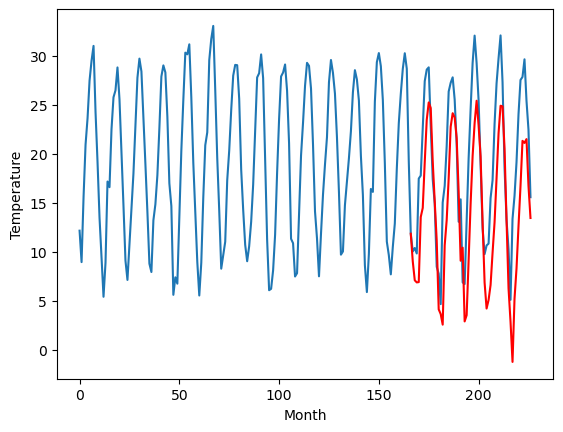

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.43		-5.04		-1.61
-7.96		-7.80		0.16
-6.71		-7.46		-0.75
-5.90		-6.89		-0.99
-1.40		-3.25		-1.85
3.58		-0.63		-4.21
9.87		4.61		-5.26
13.39		8.34		-5.05
15.49		11.49		-4.00
15.93		11.54		-4.39
9.68		6.40		-3.28
4.08		2.48		-1.60
-1.48		-3.23		-1.75
-9.13		-8.57		0.56
-8.59		-8.68		-0.09
-5.67		-7.44		-1.77
-2.57		-4.01		-1.44
4.09		0.51		-3.58
9.10		4.81		-4.29
14.09		10.65		-3.44
12.89		12.68		-0.21
12.37		11.72		-0.65
10.19		9.13		-1.06
3.63		3.06		-0.57
-1.77		-2.40		-0.63
-5.12		-4.54		0.58
-8.12		-8.33		-0.21
-7.15		-7.08		0.07
-2.09		-2.50		-0.41
5.10		1.75		-3.35
9.80		6.35		-3.45
13.66		9.98		-3.68
14.80		13.27		-1.53
11.78		12.46		0.68
10.05		8.96		-1.09
1.84		2.44		0.60
-5.05		-4.23		0.82
-7.22		-7.01		0.21
-7.93		-5.65		2.28
-6.72		-5.50		1.22
-2.02		-2.87		-0.85
3.62		1.90		-1.72
8.27		5.89		-2.38
12.93		9.58		-3.35
17.68		14.75		-2.93
14.68		13.16		-1.52
12.02		8.97		-3.05
5.28

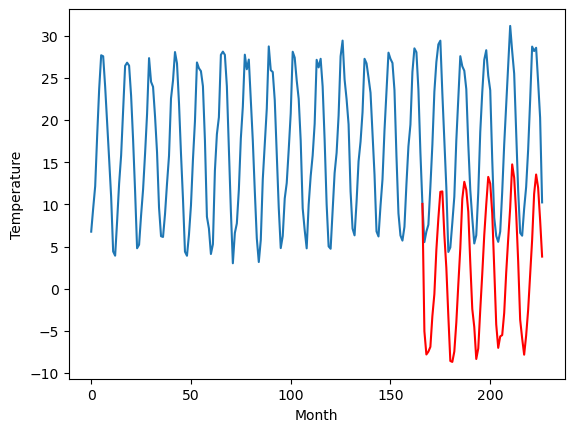

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.34		7.73		-1.61
5.80		4.53		-1.27
6.34		5.14		-1.20
8.45		6.24		-2.21
8.52		7.81		-0.71
11.73		11.48		-0.25
15.78		16.45		0.67
17.07		19.22		2.15
19.48		22.72		3.24
21.88		23.59		1.71
20.28		18.96		-1.32
17.04		15.35		-1.69
10.32		8.50		-1.82
8.27		4.45		-3.82
8.21		5.04		-3.17
7.29		7.79		0.50
6.89		7.91		1.02
10.75		13.23		2.48
12.97		17.35		4.38
17.21		23.13		5.92
20.19		25.57		5.38
19.79		24.03		4.24
18.01		21.47		3.46
13.03		14.86		1.83
11.77		11.26		-0.51
5.26		7.00		1.74
7.67		6.32		-1.35
8.54		7.48		-1.06
10.33		11.20		0.87
12.45		14.28		1.83
13.41		18.00		4.59
18.33		21.93		3.60
19.14		25.54		6.40
21.18		25.83		4.65
20.77		22.51		1.74
14.50		16.37		1.87
8.27		8.80		0.53
5.57		6.52		0.95
5.23		7.97		2.74
4.91		7.55		2.64
5.92		9.85		3.93
9.76		14.91		5.15
10.97		18.70		7.73
12.93		21.61		8.68
19.85		27.82		7.97
19.48		25.78		6.30
15.98		21.57		5.59
14.39		16.81		2.42
10.00		10.41		0

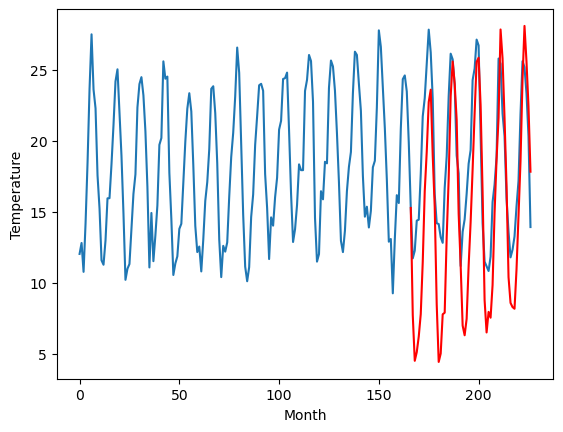

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		3.18		-0.87
3.64		1.62		-2.02
3.35		1.57		-1.78
4.39		1.66		-2.73
9.62		6.28		-3.34
10.92		7.63		-3.29
13.52		12.06		-1.46
18.81		16.33		-2.48
21.80		19.44		-2.36
20.80		18.29		-2.51
16.77		14.03		-2.74
12.85		11.37		-1.48
8.24		6.68		-1.56
1.24		-0.42		-1.66
0.83		-1.33		-2.16
1.33		0.63		-0.70
8.21		4.87		-3.34
11.00		8.79		-2.21
15.02		12.92		-2.10
19.31		17.49		-1.82
20.88		18.82		-2.06
20.97		18.99		-1.98
16.86		16.30		-0.56
13.58		12.40		-1.18
4.67		4.07		-0.60
6.59		5.20		-1.39
0.11		-1.56		-1.67
4.13		1.65		-2.48
8.24		5.56		-2.68
11.53		9.54		-1.99
16.38		15.04		-1.34
20.14		17.38		-2.76
21.58		19.20		-2.38
20.20		18.09		-2.11
16.89		14.86		-2.03
9.58		8.64		-0.94
7.46		6.24		-1.22
0.93		1.63		0.70
4.13		3.21		-0.92
7.15		4.54		-2.61
7.60		6.07		-1.53
11.12		10.51		-0.61
13.90		12.48		-1.42
17.56		16.56		-1.00
21.15		20.77		-0.38
20.60		19.01		-1.59
16.64		15.61		-1.03
11.35		

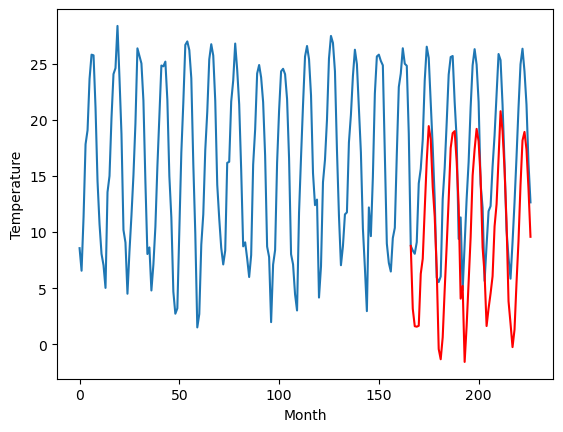

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		1.18		-0.47
2.25		-0.50		-2.75
1.81		-0.57		-2.38
1.61		-0.61		-2.22
7.65		4.28		-3.37
8.08		5.71		-2.37
12.12		10.56		-1.56
17.49		15.28		-2.21
20.78		18.45		-2.33
19.52		17.09		-2.43
15.57		12.52		-3.05
10.91		9.39		-1.52
5.86		4.81		-1.05
-1.20		-2.39		-1.19
-0.87		-3.56		-2.69
0.48		-2.20		-2.68
6.69		2.89		-3.80
8.66		6.97		-1.69
13.57		11.24		-2.33
18.98		16.31		-2.67
20.29		17.61		-2.68
20.37		17.78		-2.59
15.88		14.90		-0.98
12.12		10.80		-1.32
1.90		2.16		0.26
4.00		2.97		-1.03
-2.87		-4.17		-1.30
1.72		-0.99		-2.71
6.27		3.30		-2.97
9.43		7.57		-1.86
15.67		13.51		-2.16
19.32		16.02		-3.30
20.67		18.06		-2.61
19.42		16.87		-2.55
15.27		13.35		-1.92
7.99		6.94		-1.05
5.54		4.18		-1.36
0.08		-0.62		-0.70
2.00		0.97		-1.03
4.79		2.10		-2.69
5.32		3.77		-1.55
10.21		8.70		-1.51
13.56		11.08		-2.48
16.47		15.35		-1.12
20.02		19.53		-0.49
19.31		17.65		-1.66
16.53		14.26		-2.27
10.

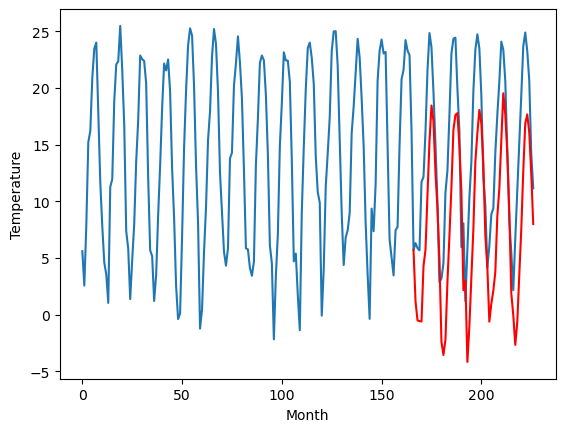

RangeIndex(start=1, stop=12, step=1)
[2.9200000000000017, 1.5699999999999985, 5.66, -0.009999999999999787, -0.3200000000000003, -0.39000000000000057, 10.42, -3.430000000000002, 9.339999999999996, 4.050000000000001, 1.6500000000000021]
[2.0680719757080084, -0.7386431503295903, 2.310779609680175, -2.8128630447387692, -1.2893787765502935, -2.7964884948730466, 9.001973457336426, -5.043448276519776, 7.72982400894165, 3.1750915527343757, 1.1834713363647467]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.92   2.068072
1                 1    1.57  -0.738643
2                 2    5.66   2.310780
3                 3   -0.01  -2.812863
4                 4   -0.32  -1.289379
5                 5   -0.39  -2.796488
6                 6   10.42   9.001973
7                 7   -3.43  -5.043448
8                 8    9.34   7.729824
9                 9    4.05   3.175092
10               10    1.65   1.183471


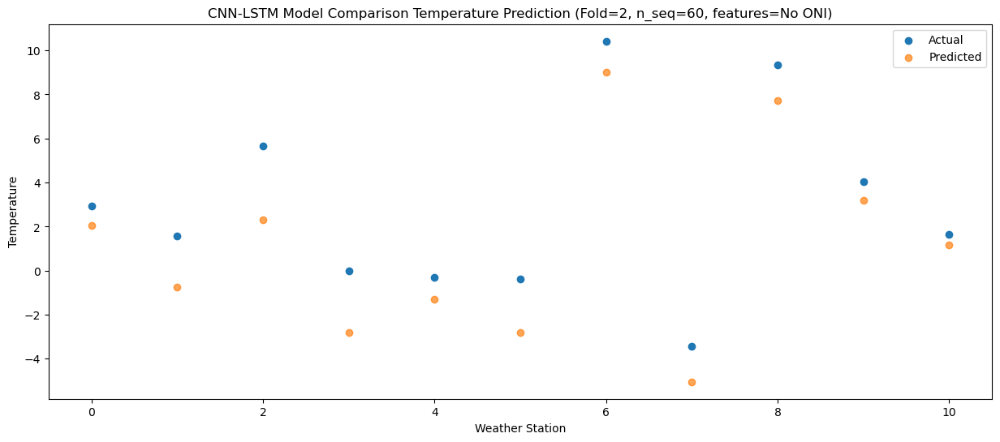

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    3.26   0.348666
1                 1   -0.71  -3.770168
2                 2    4.54   1.403263
3                 3   -3.07  -5.134393
4                 4    0.03  -2.383956
5                 5   -1.82  -4.473456
6                 6    8.61   7.073065
7                 7   -7.96  -7.796625
8                 8    5.80   4.526596
9                 9    3.64   1.617831
10               10    2.25  -0.502929


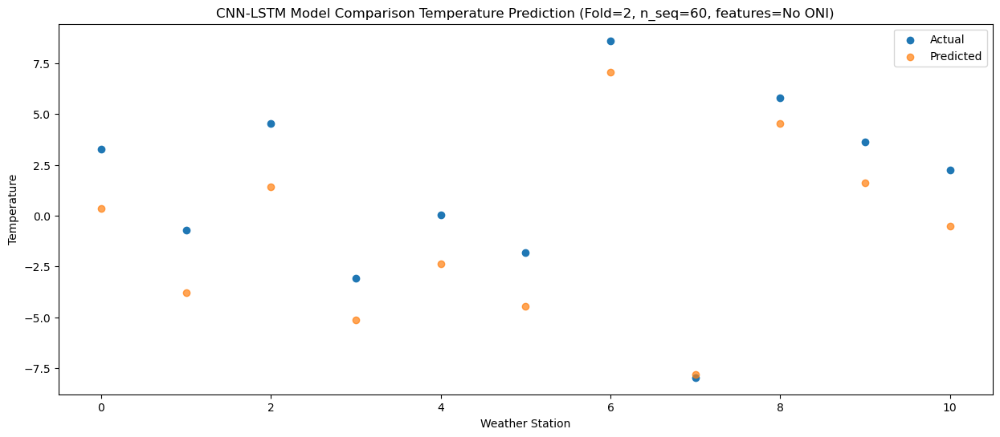

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    2.67  -0.003047
1                 1   -0.95  -4.153112
2                 2    3.39   1.284859
3                 3   -2.80  -4.881279
4                 4    0.37  -2.555008
5                 5   -1.45  -4.496327
6                 6    8.96   6.858846
7                 7   -6.71  -7.459683
8                 8    6.34   5.136418
9                 9    3.35   1.573303
10               10    1.81  -0.574531


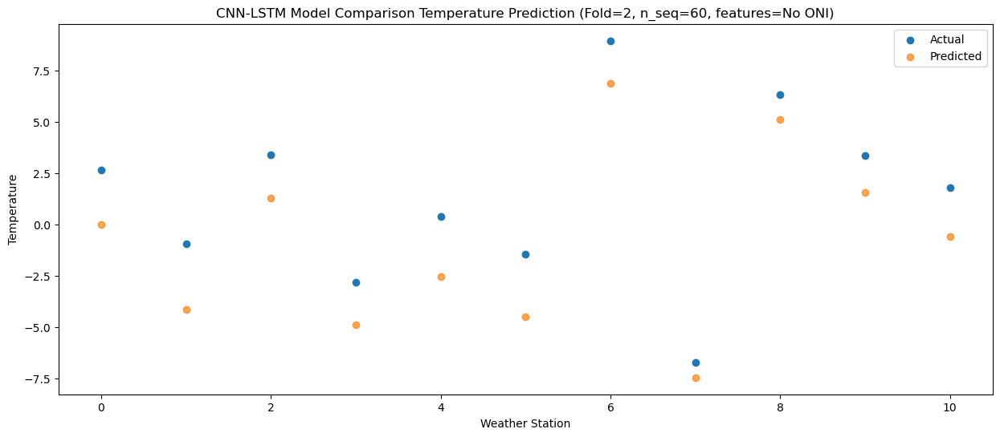

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    2.48  -0.143836
1                 1   -1.68  -3.987715
2                 2    4.43   1.972654
3                 3   -2.65  -5.010083
4                 4    1.01  -2.257566
5                 5   -2.21  -4.371106
6                 6    8.40   6.887835
7                 7   -5.90  -6.891446
8                 8    8.45   6.235254
9                 9    4.39   1.656916
10               10    1.61  -0.605449


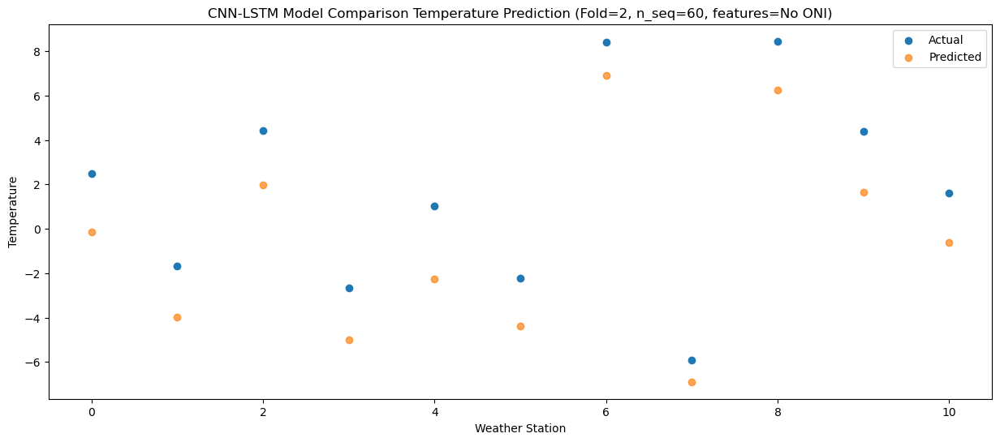

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    9.07   6.240910
1                 1    6.33   1.875525
2                 2    8.05   5.120291
3                 3    0.90  -0.971012
4                 4    7.70   2.812977
5                 5    5.88   1.737575
6                 6   16.05  13.535117
7                 7   -1.40  -3.249002
8                 8    8.52   7.809458
9                 9    9.62   6.283132
10               10    7.65   4.284368


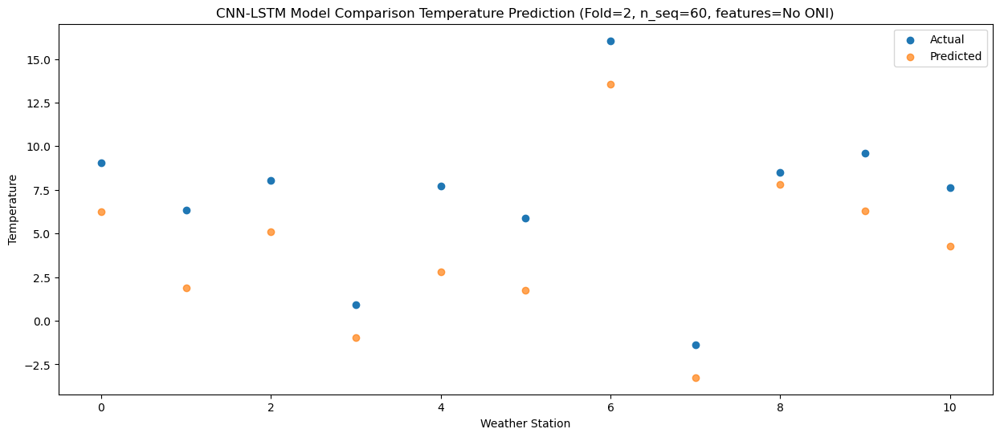

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   10.55   7.318593
1                 1    8.56   4.646738
2                 2    9.44   6.345840
3                 3    2.13   1.103586
4                 4    7.17   3.526997
5                 5    5.85   2.451458
6                 6   16.36  14.461094
7                 7    3.58  -0.633759
8                 8   11.73  11.477682
9                 9   10.92   7.627080
10               10    8.08   5.711742


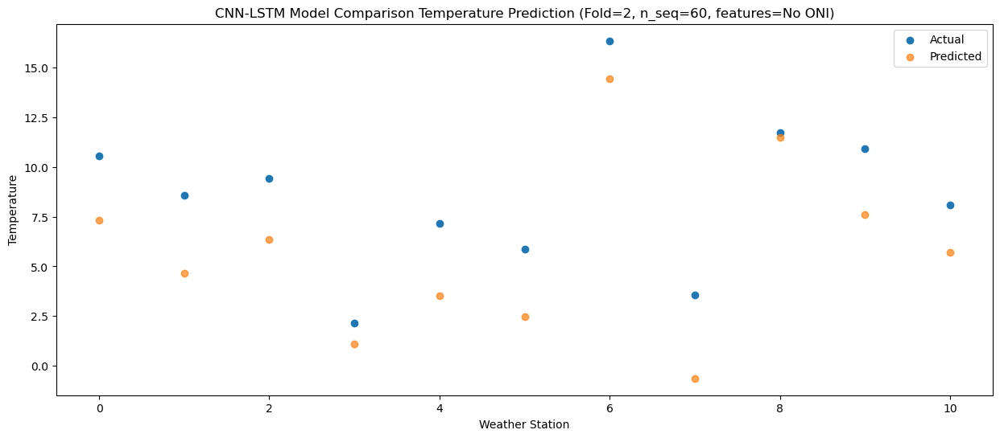

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   15.84  12.202436
1                 1   15.36  10.985469
2                 2   10.75   8.389692
3                 3    8.02   7.202909
4                 4   10.14   6.595489
5                 5    9.69   6.575537
6                 6   21.26  19.119125
7                 7    9.87   4.608498
8                 8   15.78  16.452877
9                 9   13.52  12.060395
10               10   12.12  10.564269


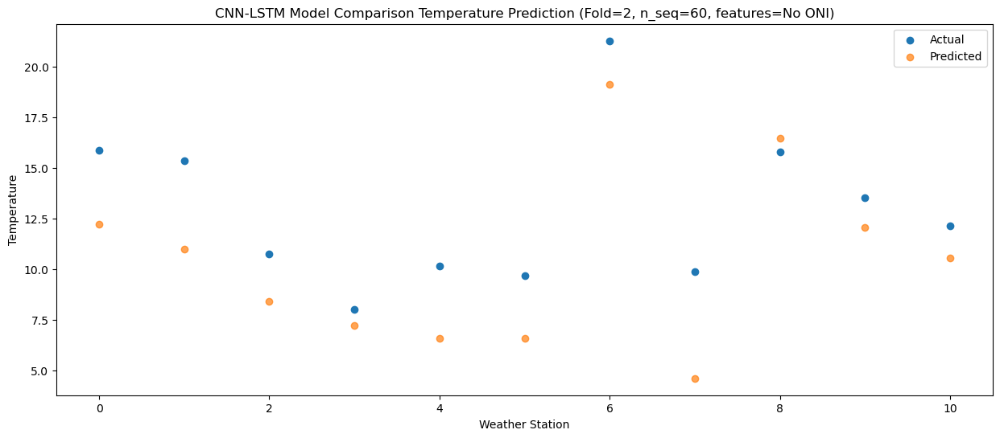

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   20.84  17.130718
1                 1   22.56  16.525019
2                 2   13.34  10.305657
3                 3   14.08  12.765868
4                 4   13.18   9.583147
5                 5   13.30  10.272442
6                 6   26.00  23.453646
7                 7   13.39   8.341630
8                 8   17.07  19.219734
9                 9   18.81  16.334395
10               10   17.49  15.280471


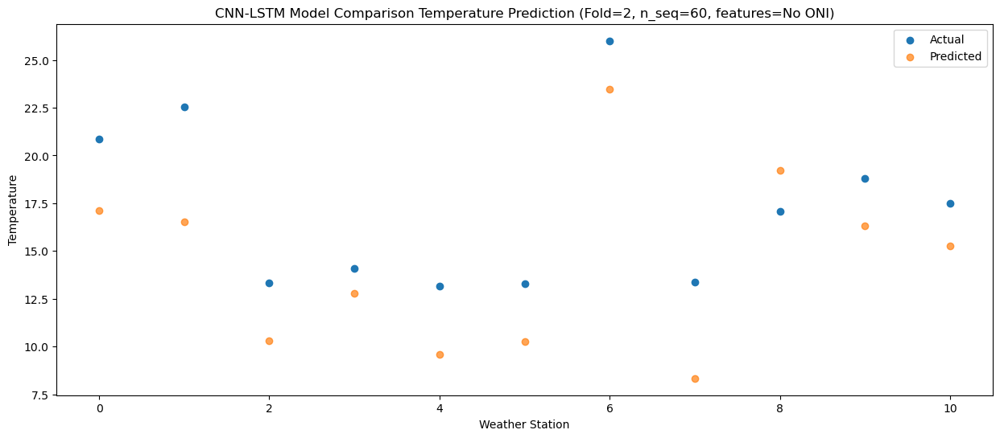

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   23.00  19.317906
1                 1   22.59  18.785801
2                 2   13.98  12.610923
3                 3   18.36  17.032384
4                 4   13.92  11.638999
5                 5   15.00  12.250417
6                 6   27.18  25.239199
7                 7   15.49  11.493272
8                 8   19.48  22.720083
9                 9   21.80  19.444727
10               10   20.78  18.449340


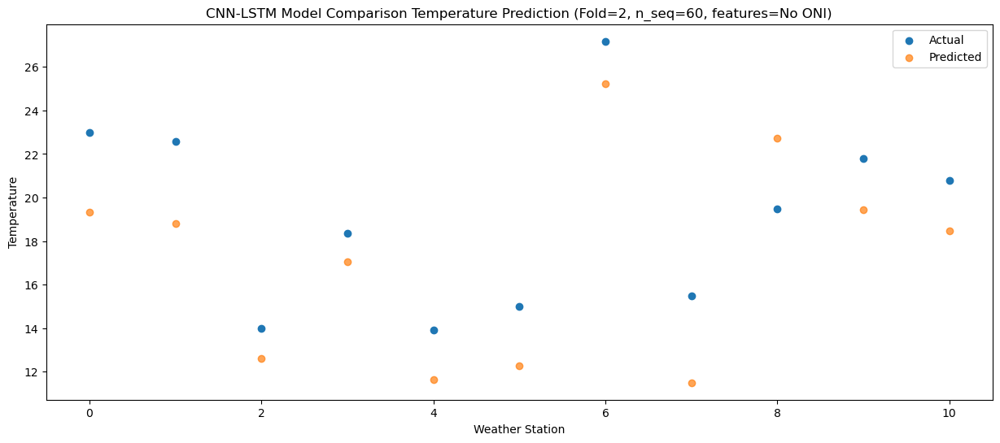

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   21.02  18.133575
1                 1   21.26  18.378999
2                 2   13.67  12.672453
3                 3   16.51  15.253730
4                 4   14.29  11.218475
5                 5   15.30  11.773579
6                 6   27.41  24.662911
7                 7   15.93  11.543808
8                 8   21.88  23.586551
9                 9   20.80  18.293962
10               10   19.52  17.087980


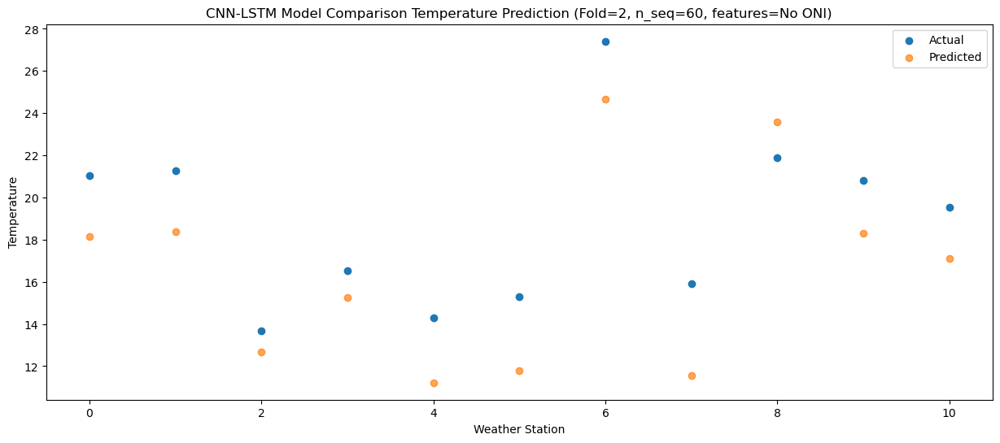

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   18.18  12.963940
1                 1   15.13  11.930504
2                 2   12.41  10.223481
3                 3   11.93  10.127533
4                 4   11.94   7.532764
5                 5   10.90   6.864250
6                 6   21.47  19.227662
7                 7    9.68   6.396909
8                 8   20.28  18.961532
9                 9   16.77  14.031871
10               10   15.57  12.515158


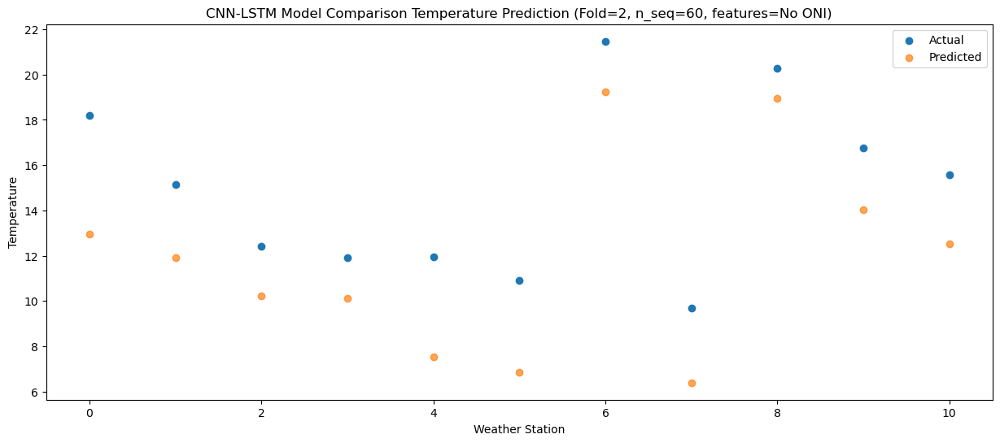

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   11.17   8.998781
1                 1    8.14   5.889461
2                 2   11.14   9.630927
3                 3    6.71   6.335656
4                 4    8.25   5.620858
5                 5    6.43   3.603065
6                 6   15.99  15.150361
7                 7    4.08   2.478894
8                 8   17.04  15.346783
9                 9   12.85  11.374135
10               10   10.91   9.390567


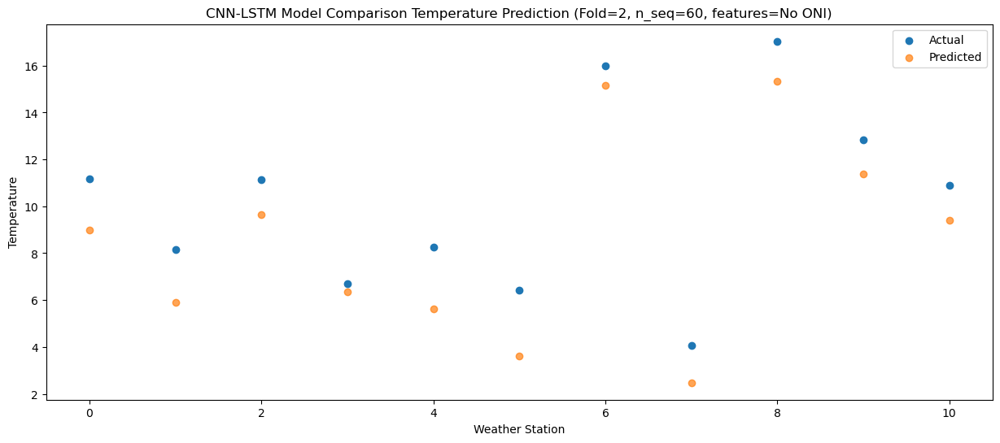

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    8.04   5.119524
1                 1    5.02   1.617327
2                 2    7.72   4.514949
3                 3    2.75   1.146899
4                 4    4.13   1.150179
5                 5    3.75  -0.750495
6                 6   13.50  11.127239
7                 7   -1.48  -3.230281
8                 8   10.32   8.496164
9                 9    8.24   6.679056
10               10    5.86   4.810641


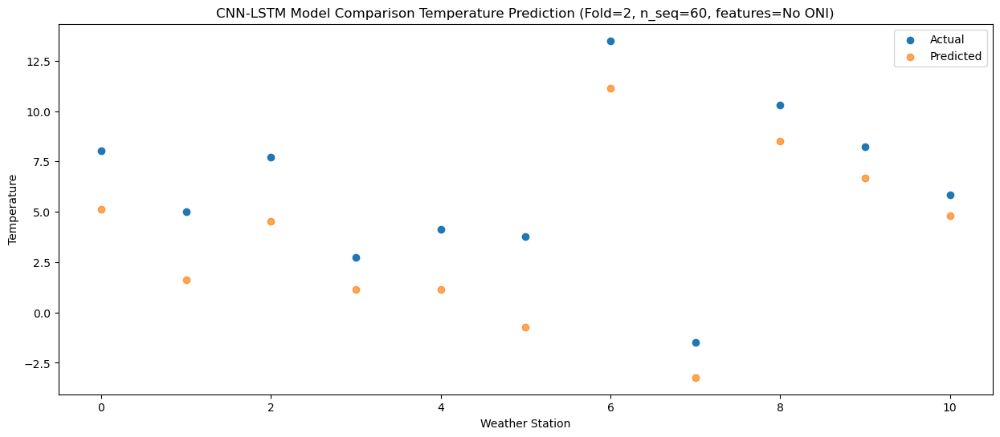

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.28  -2.345871
1                 1   -1.61  -4.564354
2                 2    0.73  -1.922640
3                 3   -4.08  -5.717763
4                 4   -2.17  -5.867768
5                 5   -2.36  -7.651530
6                 6    7.04   4.106561
7                 7   -9.13  -8.566551
8                 8    8.27   4.447244
9                 9    1.24  -0.417458
10               10   -1.20  -2.389738


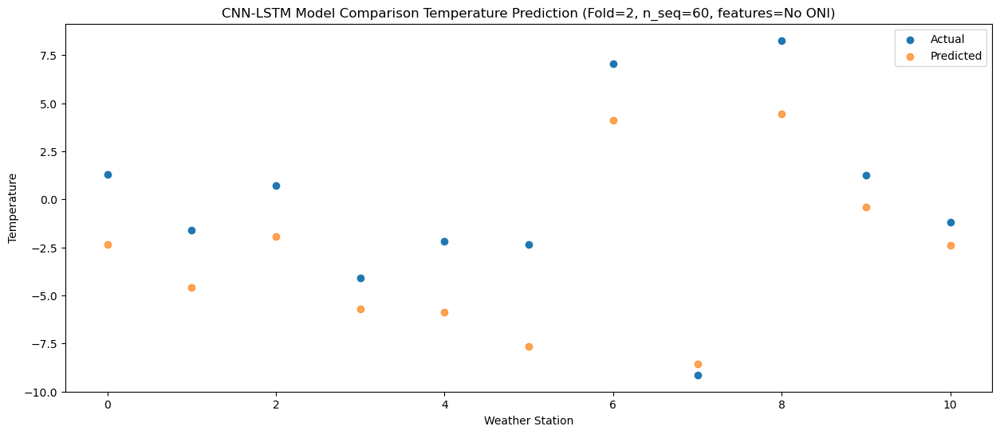

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.02  -3.342674
1                 1   -1.69  -5.158707
2                 2    1.39  -1.283221
3                 3   -7.16  -7.654936
4                 4   -1.82  -5.849688
5                 5   -2.95  -7.964210
6                 6    6.34   3.621394
7                 7   -8.59  -8.679655
8                 8    8.21   5.035978
9                 9    0.83  -1.326252
10               10   -0.87  -3.558515


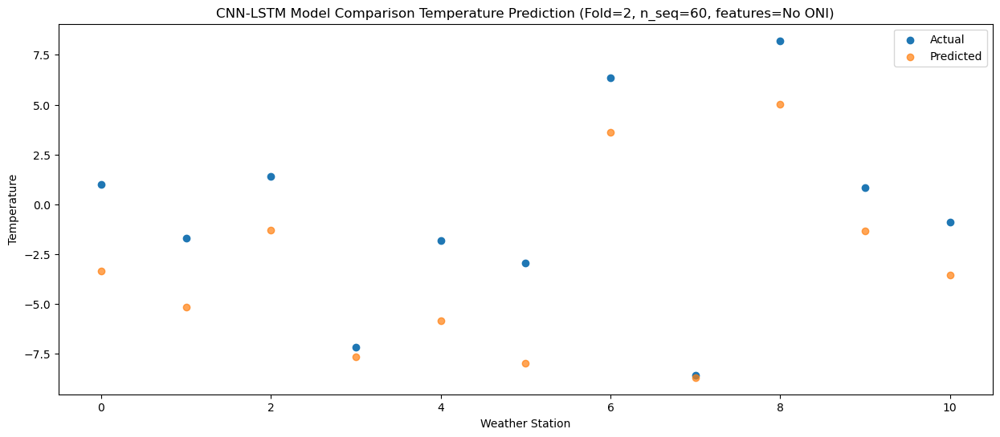

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.38  -3.999680
1                 1   -5.73  -7.468204
2                 2    4.12   3.198788
3                 3   -7.14  -6.145871
4                 4   -2.56  -3.771348
5                 5   -5.30  -7.865190
6                 6    3.23   2.544478
7                 7   -5.67  -7.442776
8                 8    7.29   7.794932
9                 9    1.33   0.627531
10               10    0.48  -2.199242


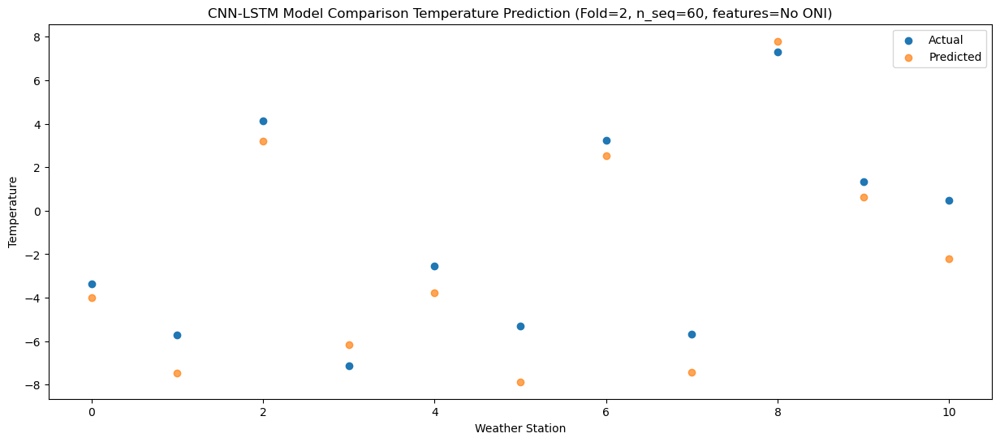

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    9.04   3.937570
1                 1    4.46   1.284749
2                 2    5.93   3.628779
3                 3   -3.03  -1.631556
4                 4    4.77   0.305323
5                 5    3.08  -1.346024
6                 6   13.60  10.645617
7                 7   -2.57  -4.012425
8                 8    6.89   7.908179
9                 9    8.21   4.870573
10               10    6.69   2.890903


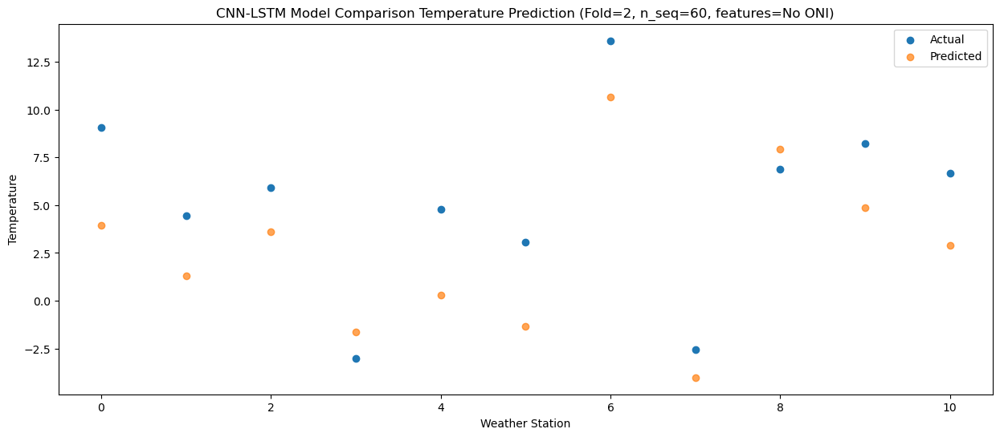

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   10.91   7.028945
1                 1    8.22   5.205160
2                 2    7.74   6.625102
3                 3    1.47   3.902655
4                 4    5.64   2.868902
5                 5    5.20   1.208094
6                 6   15.30  13.213727
7                 7    4.09   0.506106
8                 8   10.75  13.231216
9                 9   11.00   8.789563
10               10    8.66   6.969029


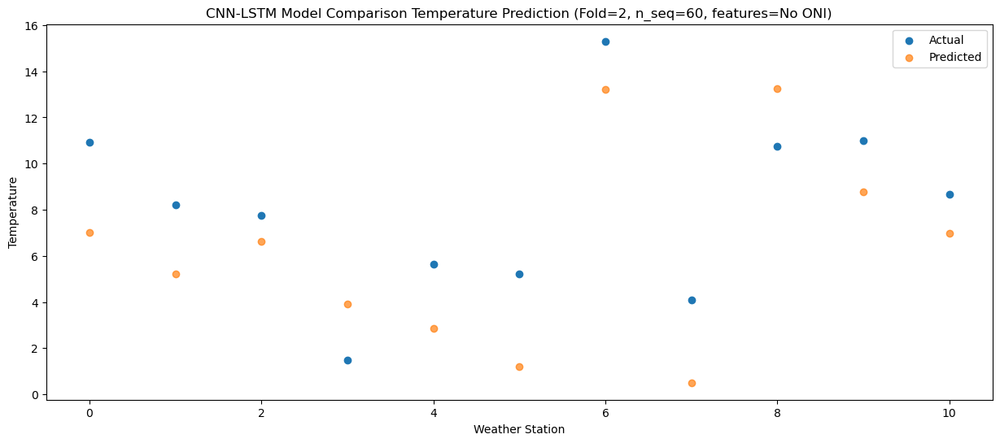

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   15.69  11.409488
1                 1   13.40  10.174672
2                 2   11.32  10.058153
3                 3    6.73   8.480755
4                 4   10.11   6.608112
5                 5    9.24   5.251735
6                 6   19.38  17.515886
7                 7    9.10   4.806937
8                 8   12.97  17.354063
9                 9   15.02  12.924918
10               10   13.57  11.240514


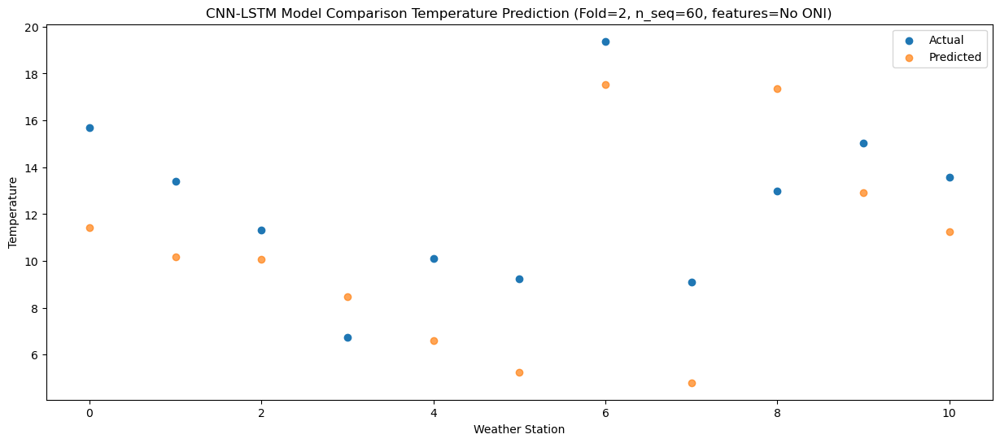

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   20.94  16.780637
1                 1   20.65  17.618532
2                 2   12.54  12.209257
3                 3   12.30  14.808220
4                 4   13.59   9.830763
5                 5   13.79   9.762135
6                 6   24.94  22.756809
7                 7   14.09  10.651703
8                 8   17.21  23.128351
9                 9   19.31  17.493006
10               10   18.98  16.306049


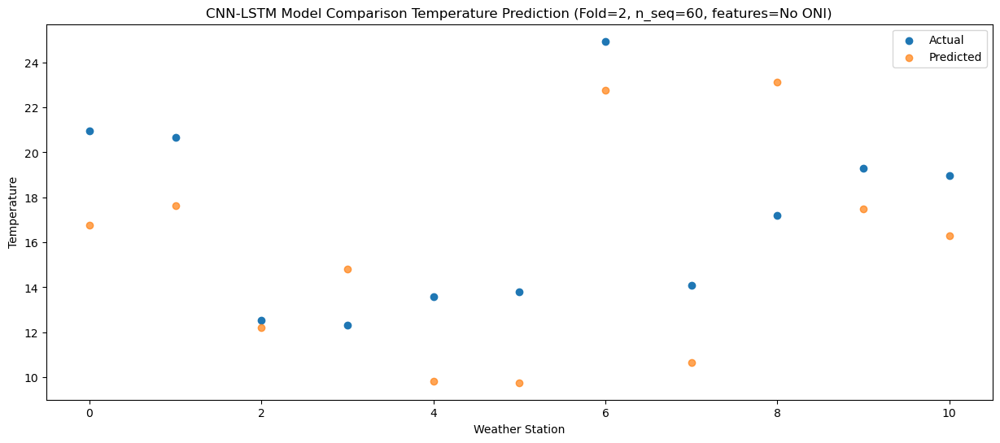

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   21.95  17.998601
1                 1   21.34  19.349839
2                 2   13.33  13.600422
3                 3   14.30  16.286811
4                 4   14.18  11.116304
5                 5   13.87  11.163564
6                 6   25.83  24.135598
7                 7   12.89  12.684509
8                 8   20.19  25.566483
9                 9   20.88  18.817108
10               10   20.29  17.611764


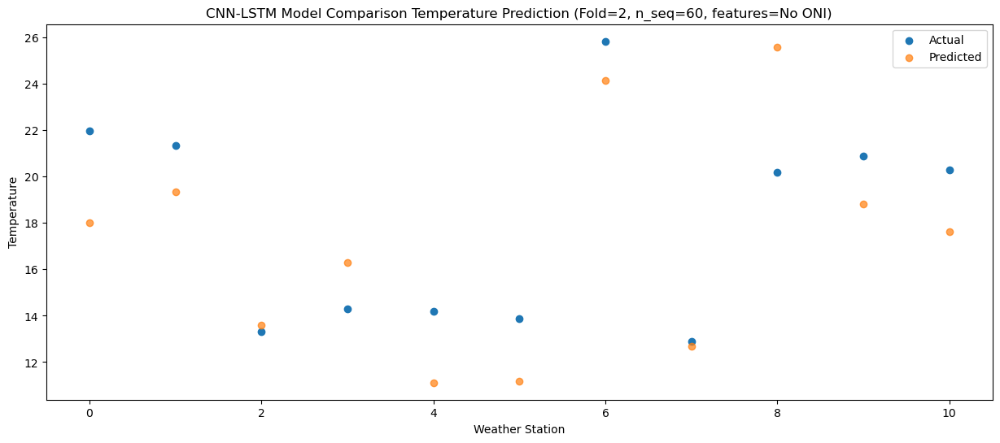

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   22.40  17.874330
1                 1   22.10  18.054446
2                 2   13.38  13.522365
3                 3   15.36  16.608274
4                 4   14.35  11.076303
5                 5   14.98  10.901437
6                 6   26.39  23.701311
7                 7   12.37  11.719079
8                 8   19.79  24.025025
9                 9   20.97  18.994404
10               10   20.37  17.780198


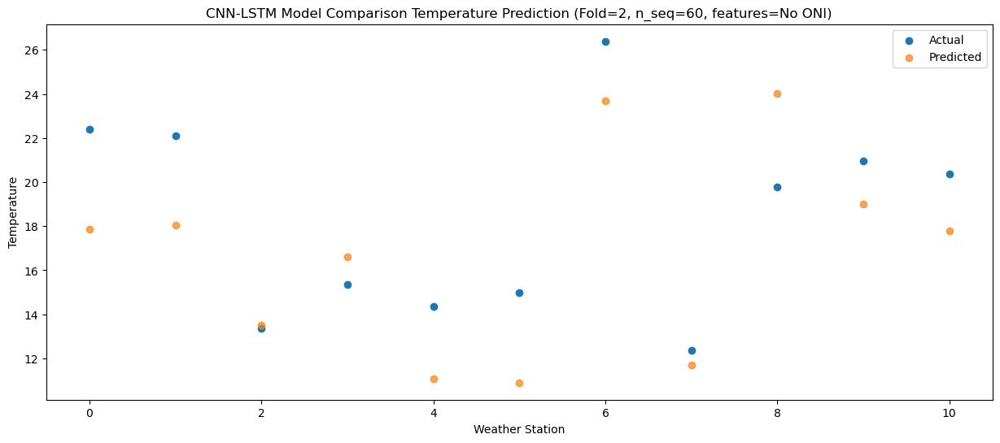

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.10  15.357160
1                 1   19.86  15.211137
2                 2   12.10  11.863125
3                 3   12.19  12.962528
4                 4   11.81   9.265218
5                 5   12.24   8.941681
6                 6   24.12  21.597478
7                 7   10.19   9.128639
8                 8   18.01  21.473751
9                 9   16.86  16.295591
10               10   15.88  14.901921


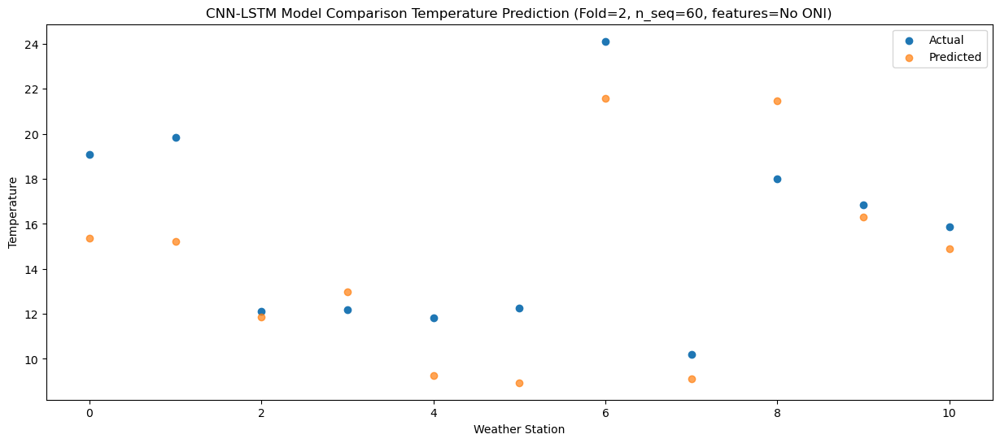

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   14.35  10.532982
1                 1   11.60   8.103081
2                 2   10.96   8.809888
3                 3    8.36   8.540221
4                 4    9.07   5.505012
5                 5    8.94   3.978669
6                 6   19.61  16.109965
7                 7    3.63   3.060975
8                 8   13.03  14.862003
9                 9   13.58  12.399162
10               10   12.12  10.803714


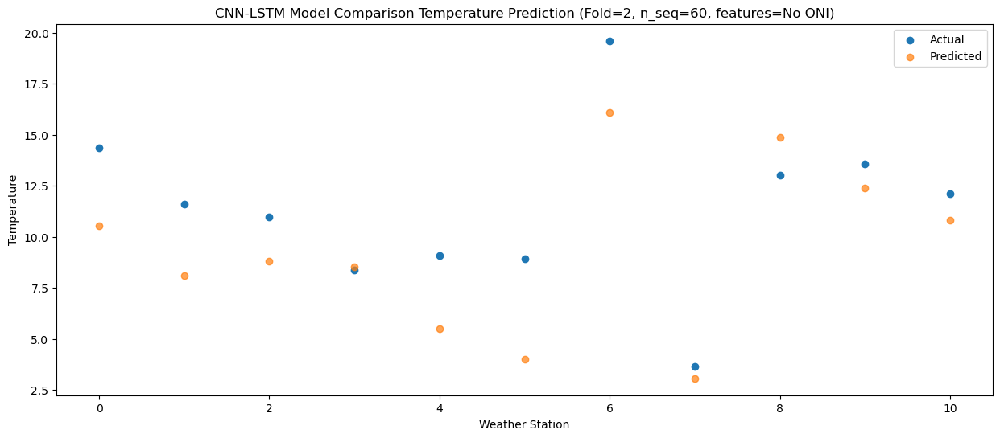

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    4.73   2.270779
1                 1    4.89   1.704386
2                 2    4.11   2.490702
3                 3    0.28  -0.725568
4                 4    0.80  -1.591700
5                 5    1.30  -2.918848
6                 6   11.64   9.070832
7                 7   -1.77  -2.397931
8                 8   11.77  11.260481
9                 9    4.67   4.072008
10               10    1.90   2.158608


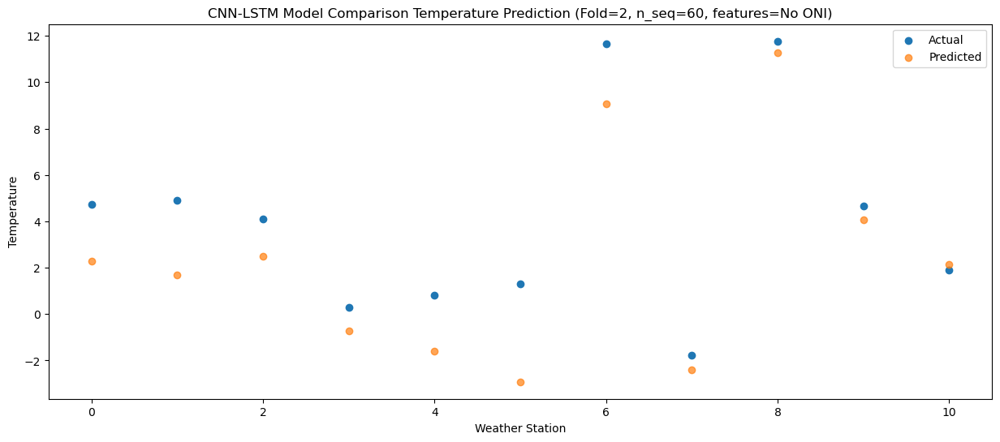

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    7.82   3.560489
1                 1    2.50  -1.251445
2                 2    5.01   4.729420
3                 3   -1.64  -1.664589
4                 4    4.21   1.142280
5                 5    4.54  -0.919884
6                 6   13.93  10.408520
7                 7   -5.12  -4.537446
8                 8    5.26   7.000215
9                 9    6.59   5.202392
10               10    4.00   2.969267


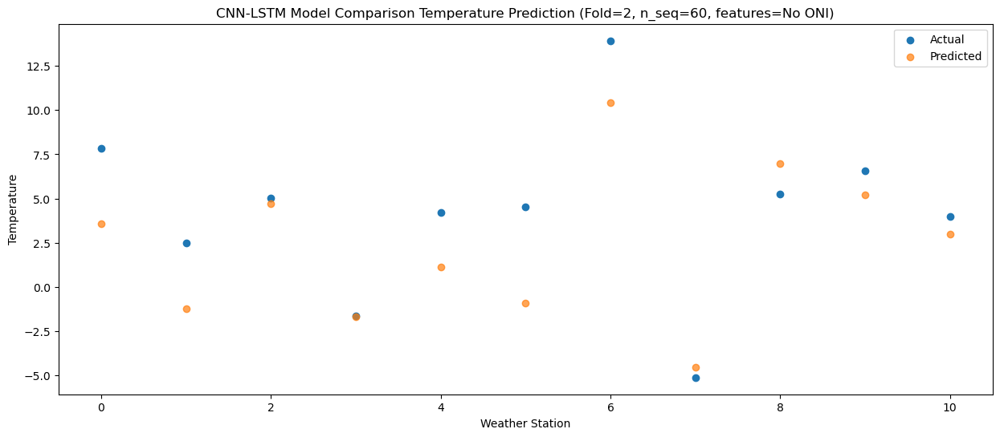

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.48  -4.468196
1                 1   -2.19  -6.817281
2                 2    0.75   0.460914
3                 3   -7.79  -8.562333
4                 4   -3.52  -5.338029
5                 5   -3.89  -8.131644
6                 6    5.45   2.874317
7                 7   -8.12  -8.330102
8                 8    7.67   6.321962
9                 9    0.11  -1.564365
10               10   -2.87  -4.170476


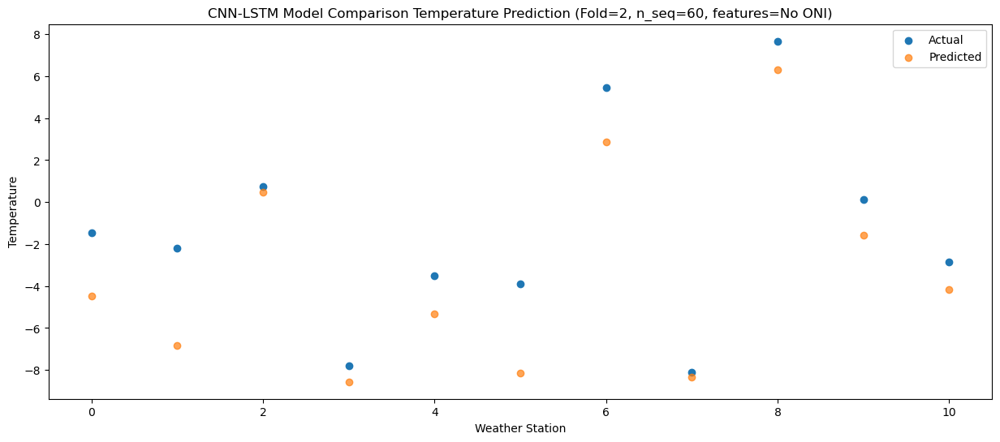

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    0.76  -2.661763
1                 1   -2.20  -6.441860
2                 2    3.08   3.531486
3                 3   -5.47  -4.723473
4                 4   -0.38  -3.177392
5                 5   -4.27  -7.165939
6                 6    5.28   3.508166
7                 7   -7.15  -7.078956
8                 8    8.54   7.476302
9                 9    4.13   1.651688
10               10    1.72  -0.993959


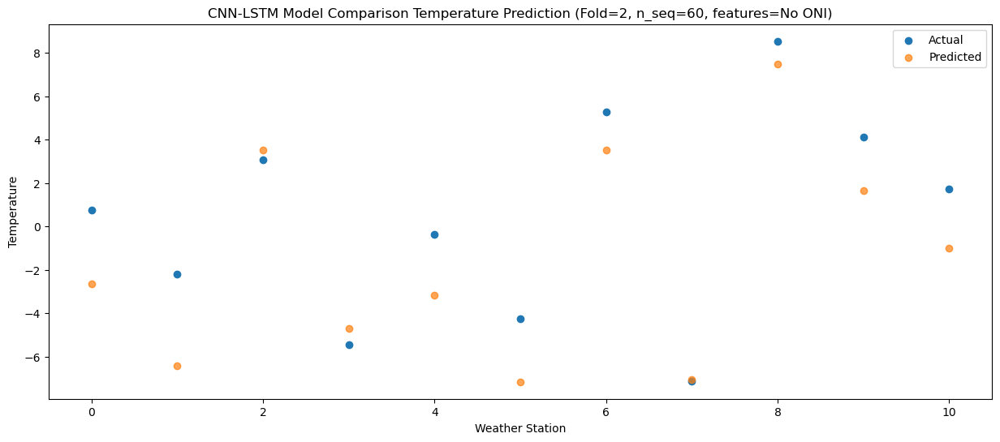

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    7.05   2.702026
1                 1    4.78  -0.037327
2                 2    6.55   5.571700
3                 3   -1.61  -0.180116
4                 4    3.38   0.436760
5                 5    1.85  -2.196703
6                 6   11.86   9.134774
7                 7   -2.09  -2.500634
8                 8   10.33  11.196848
9                 9    8.24   5.562956
10               10    6.27   3.302631


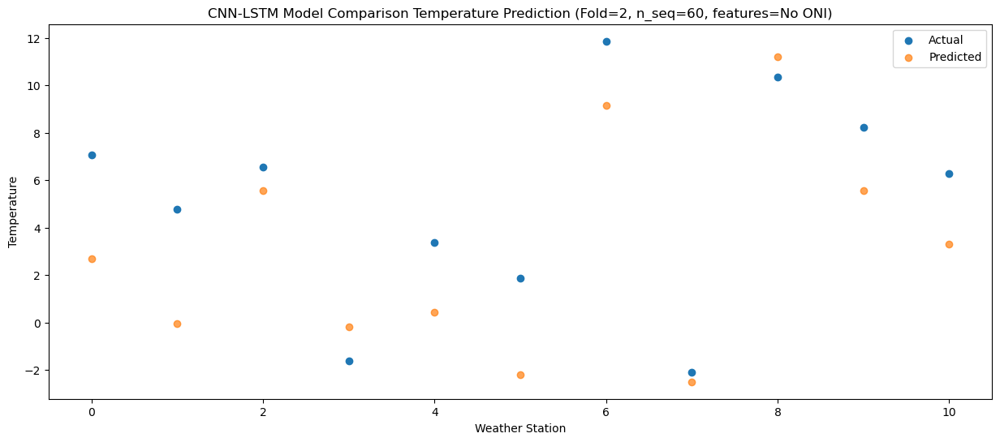

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   11.08   8.014551
1                 1   11.46   5.299771
2                 2    8.36   7.816308
3                 3    2.83   4.235138
4                 4    7.18   4.437184
5                 5    8.00   3.205072
6                 6   18.13  14.919309
7                 7    5.10   1.749777
8                 8   12.45  14.282972
9                 9   11.53   9.536639
10               10    9.43   7.565199


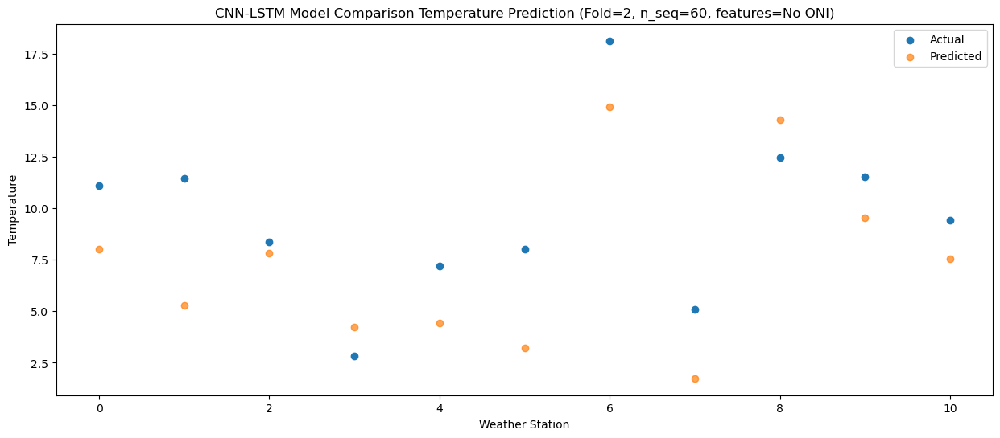

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   17.63  13.790360
1                 1   17.26  11.524881
2                 2   11.12  10.955635
3                 3    8.17  11.222129
4                 4   12.34   8.360761
5                 5   12.60   7.497491
6                 6   23.15  19.772028
7                 7    9.80   6.348946
8                 8   13.41  18.003312
9                 9   16.38  15.041019
10               10   15.67  13.506797


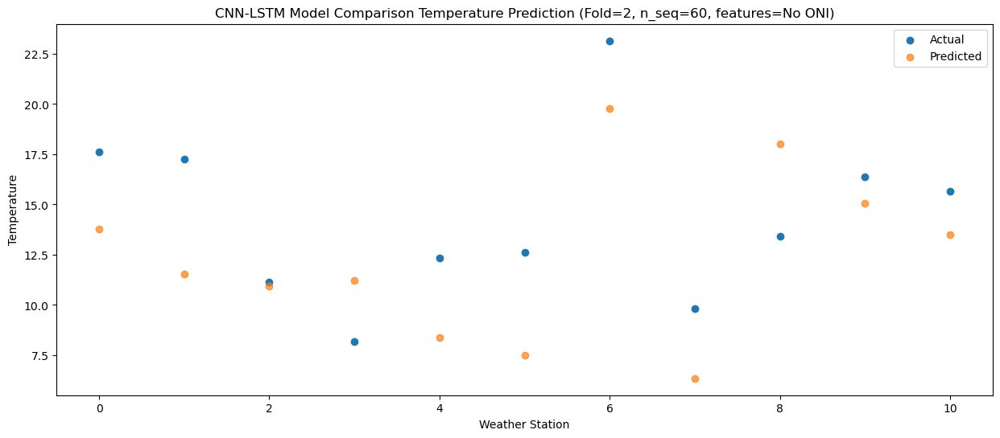

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   21.68  16.838563
1                 1   21.06  16.038516
2                 2   12.93  12.710099
3                 3   12.41  13.854649
4                 4   14.93  10.630668
5                 5   16.32  10.466293
6                 6   27.86  23.121077
7                 7   13.66   9.978784
8                 8   18.33  21.925598
9                 9   20.14  17.379767
10               10   19.32  16.019820


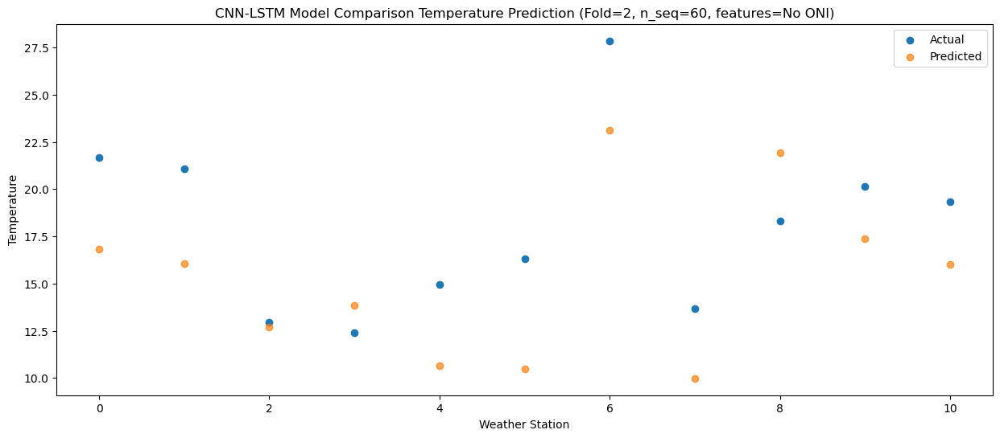

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.18  18.859163
1                 1   24.30  19.482051
2                 2   13.11  13.120455
3                 3   17.03  16.939224
4                 4   14.76  11.674992
5                 5   17.68  12.519896
6                 6   30.65  25.410079
7                 7   14.80  13.265464
8                 8   19.14  25.542219
9                 9   21.58  19.198728
10               10   20.67  18.056862


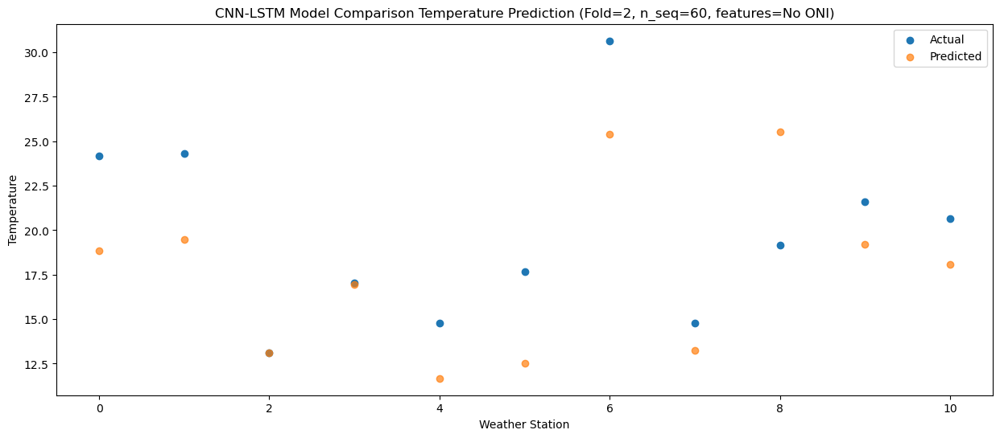

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   21.63  16.758599
1                 1   21.99  17.904536
2                 2   12.54  12.553758
3                 3   16.95  16.225437
4                 4   13.94  10.028271
5                 5   14.96  10.170479
6                 6   27.84  22.883127
7                 7   11.78  12.464848
8                 8   21.18  25.834084
9                 9   20.20  18.094390
10               10   19.42  16.865271


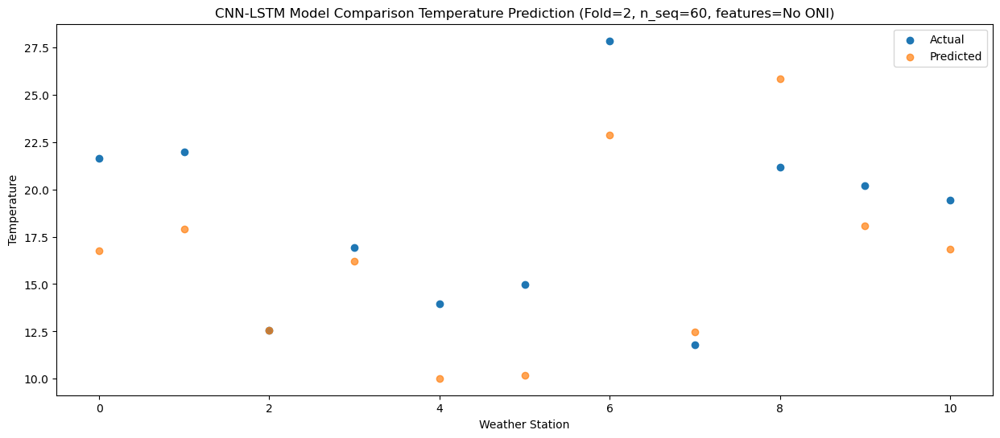

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.88  13.361026
1                 1   19.23  13.887870
2                 2   11.13  10.896241
3                 3   11.91  11.669667
4                 4   11.97   7.766543
5                 5   12.30   7.280769
6                 6   24.01  19.705739
7                 7   10.05   8.955471
8                 8   20.77  22.514316
9                 9   16.89  14.861568
10               10   15.27  13.348584


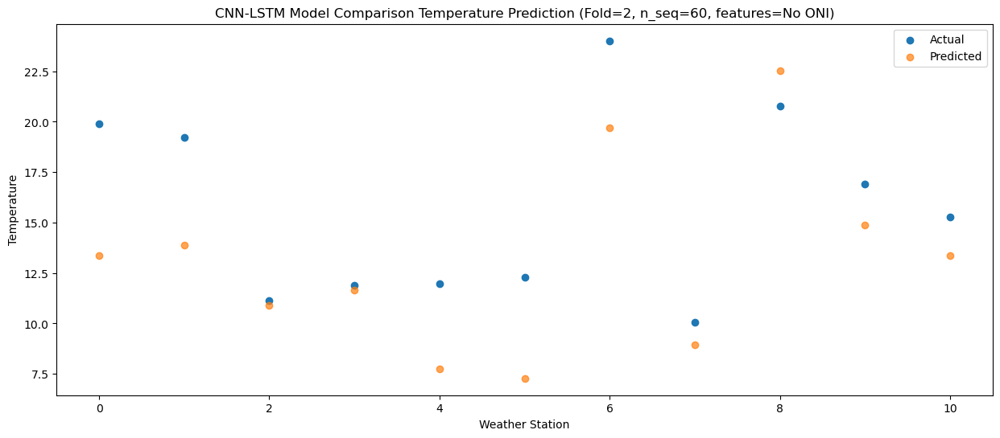

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.54   6.624627
1                 1   10.85   6.398618
2                 2    8.50   5.727846
3                 3    6.47   4.978330
4                 4    5.78   1.971911
5                 5    6.73   0.894214
6                 6   17.63  12.958708
7                 7    1.84   2.439791
8                 8   14.50  16.369071
9                 9    9.58   8.643784
10               10    7.99   6.943637


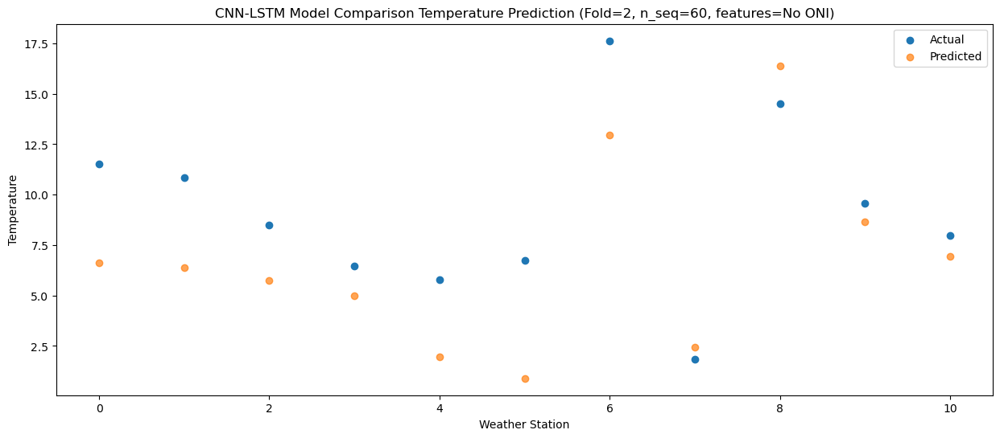

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    5.41   2.020509
1                 1    0.86  -2.228347
2                 2    6.74   4.463812
3                 3    2.67   1.988184
4                 4    2.71  -0.786892
5                 5    0.85  -4.255542
6                 6   10.96   6.840356
7                 7   -5.05  -4.228301
8                 8    8.27   8.797862
9                 9    7.46   6.244134
10               10    5.54   4.176083


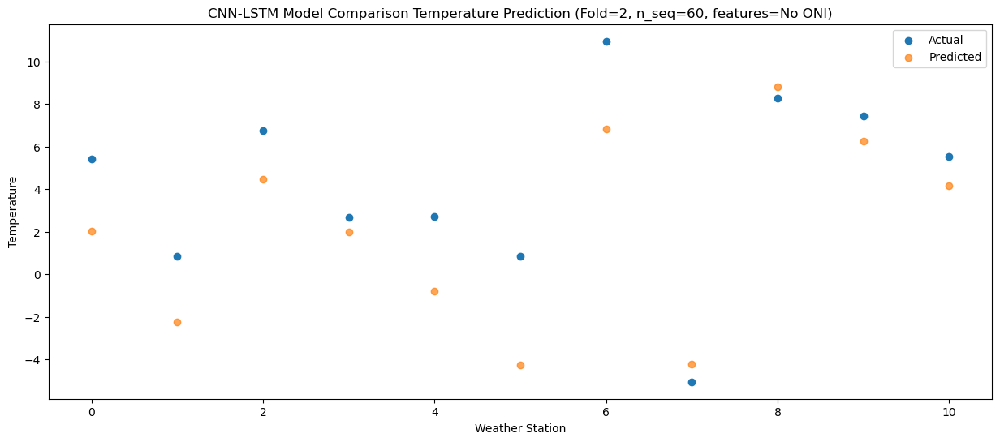

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.90  -1.920191
1                 1   -1.85  -5.824368
2                 2    2.64   0.880175
3                 3   -3.50  -3.534852
4                 4    0.20  -3.973687
5                 5   -1.38  -6.699817
6                 6    8.34   4.188957
7                 7   -7.22  -7.009479
8                 8    5.57   6.518647
9                 9    0.93   1.633265
10               10    0.08  -0.621278


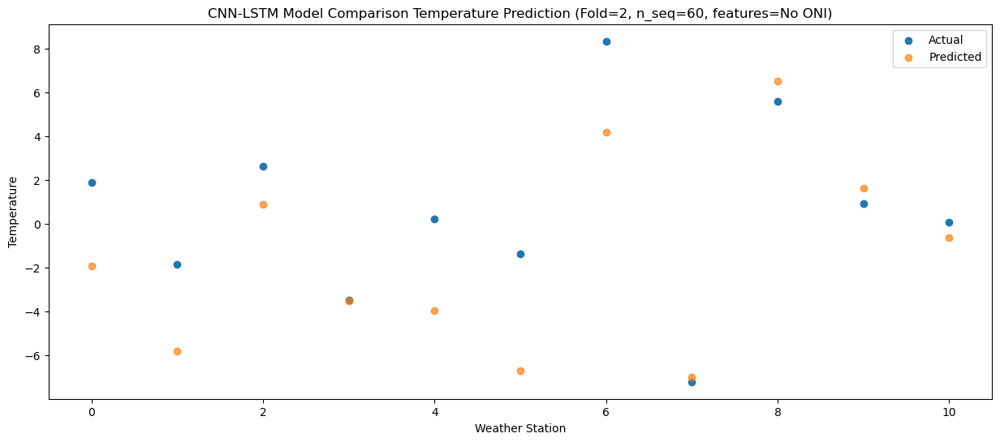

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    3.92  -0.728972
1                 1   -2.10  -4.590480
2                 2    2.44   2.215099
3                 3   -2.21  -1.638153
4                 4    1.37  -2.836265
5                 5   -0.62  -5.799693
6                 6    9.22   5.064853
7                 7   -7.93  -5.652738
8                 8    5.23   7.966598
9                 9    4.13   3.209033
10               10    2.00   0.974555


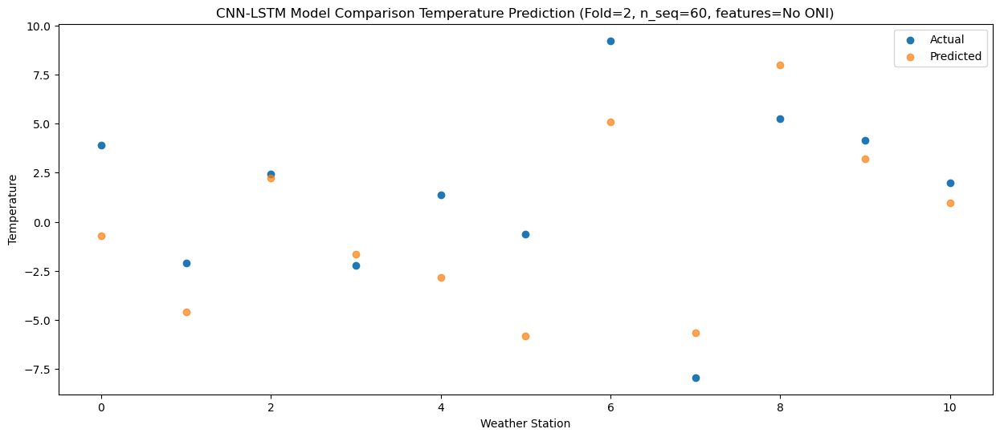

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    4.94   0.854743
1                 1   -0.50  -3.985414
2                 2    5.50   4.688193
3                 3   -4.09  -1.890255
4                 4    3.50  -0.546196
5                 5    0.57  -4.209966
6                 6    9.41   6.598736
7                 7   -6.72  -5.497458
8                 8    4.91   7.554924
9                 9    7.15   4.537591
10               10    4.79   2.103581


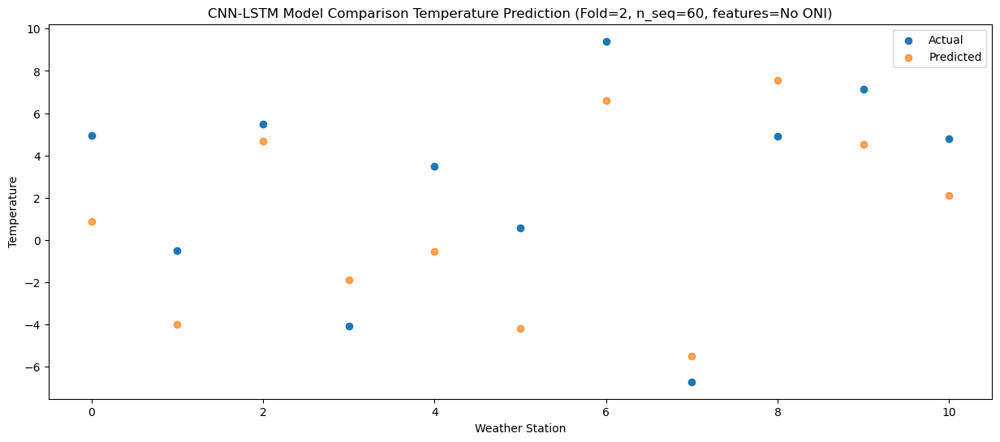

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    7.21   3.474699
1                 1    3.57  -0.609722
2                 2    6.52   5.540925
3                 3   -1.65  -0.381297
4                 4    5.33   1.358060
5                 5    4.37  -1.217767
6                 6   14.06   9.897522
7                 7   -2.02  -2.872769
8                 8    5.92   9.852351
9                 9    7.60   6.067091
10               10    5.32   3.773273


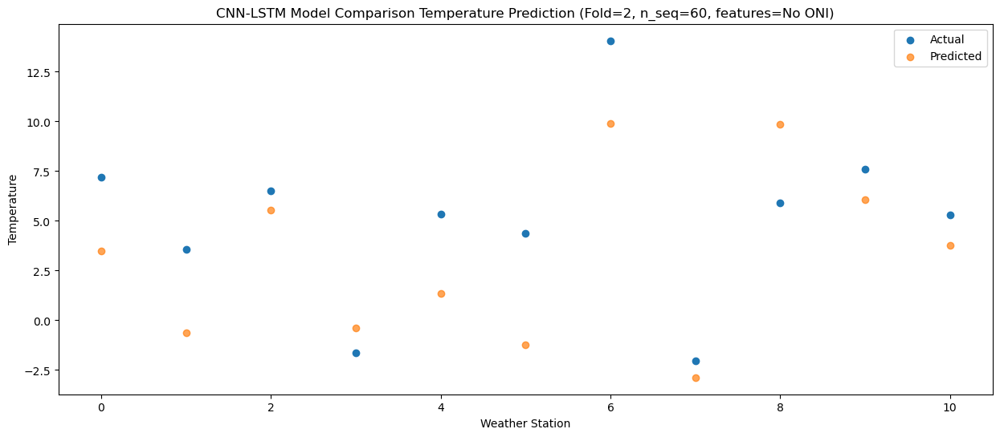

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   11.36   7.579810
1                 1    9.43   5.295379
2                 2    9.06   7.585004
3                 3    4.07   6.471873
4                 4    7.25   3.531890
5                 5    5.29   1.317009
6                 6   15.88  12.999901
7                 7    3.62   1.895580
8                 8    9.76  14.913214
9                 9   11.12  10.513637
10               10   10.21   8.698102


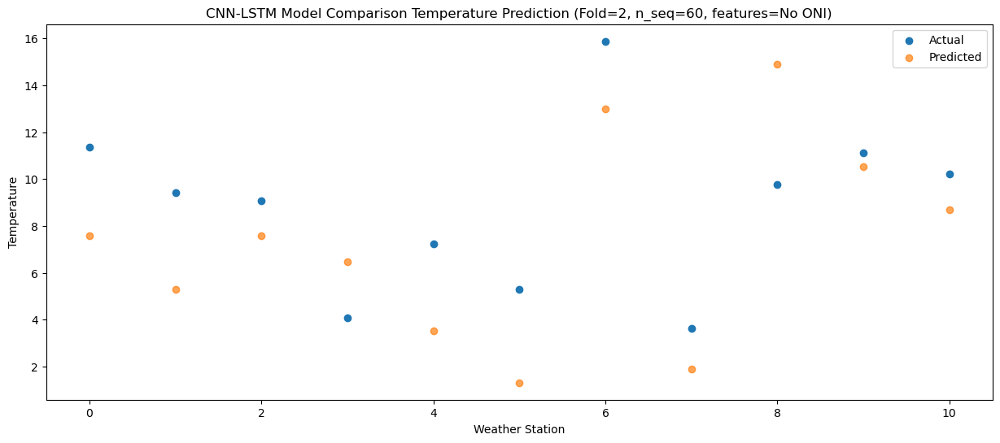

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   17.41  11.419347
1                 1   14.92  11.544852
2                 2   10.04   7.969522
3                 3    7.70   8.916767
4                 4   11.28   5.475893
5                 5   10.37   4.948425
6                 6   21.62  17.515052
7                 7    8.27   5.887676
8                 8   10.97  18.703724
9                 9   13.90  12.484874
10               10   13.56  11.084154


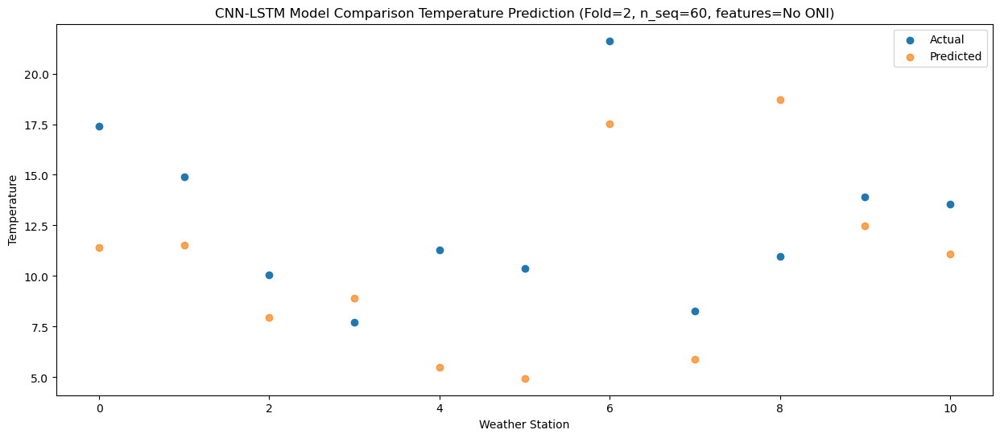

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   20.04  16.065773
1                 1   17.53  15.974555
2                 2   12.45  10.986978
3                 3   11.49  13.290360
4                 4   14.93   9.310044
5                 5   15.29   9.276818
6                 6   25.77  22.080354
7                 7   12.93   9.578927
8                 8   12.93  21.608556
9                 9   17.56  16.561692
10               10   16.47  15.352856


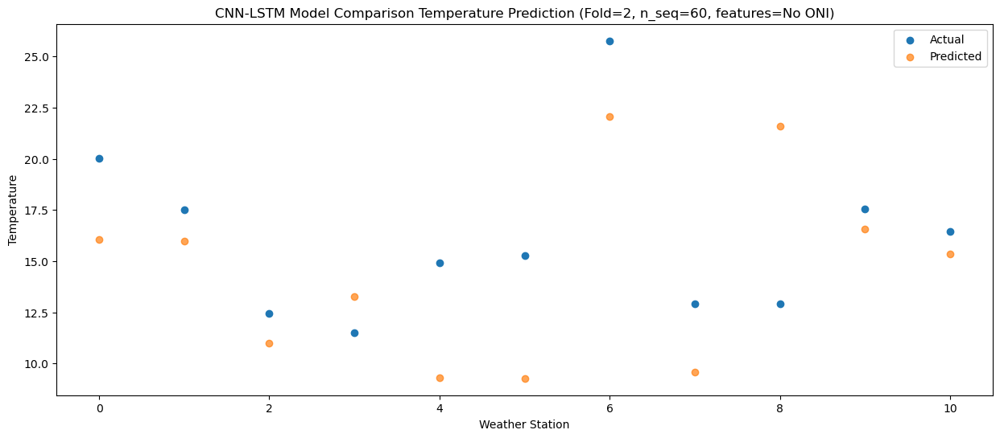

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   21.79  19.023388
1                 1   21.63  19.478942
2                 2   14.36  14.765291
3                 3   17.06  18.738474
4                 4   16.37  12.546014
5                 5   17.45  12.451296
6                 6   28.33  24.901485
7                 7   17.68  14.747455
8                 8   19.85  27.821573
9                 9   21.15  20.770433
10               10   20.02  19.529290


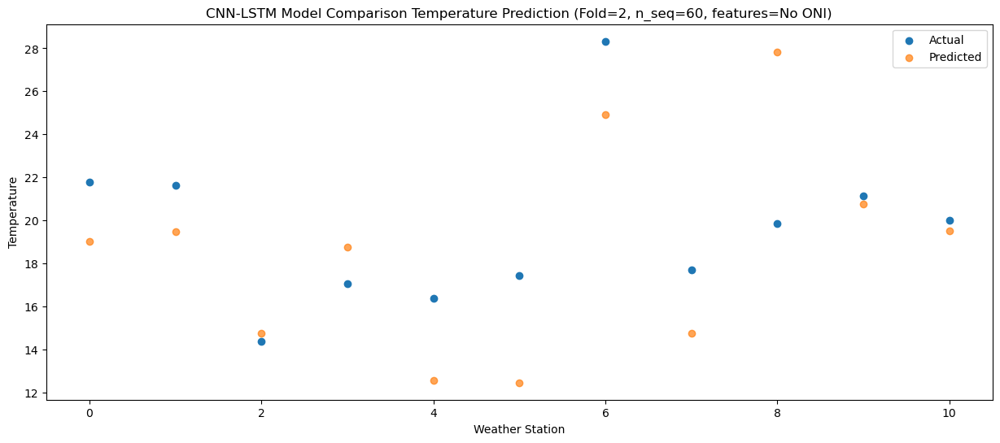

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   21.30  18.235278
1                 1   22.12  18.626305
2                 2   14.54  13.894178
3                 3   15.05  15.575802
4                 4   17.67  12.082214
5                 5   19.15  12.257717
6                 6   30.67  24.835269
7                 7   14.68  13.156276
8                 8   19.48  25.783197
9                 9   20.60  19.014608
10               10   19.31  17.645935


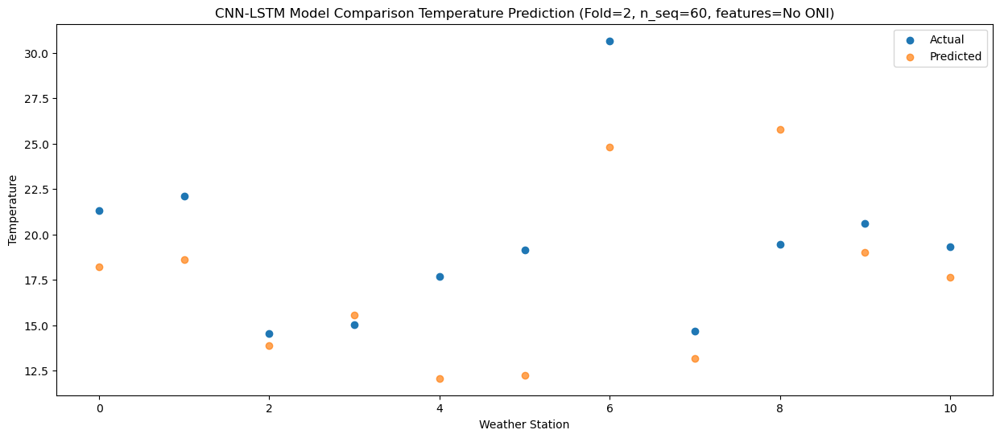

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   18.01  14.415049
1                 1   19.25  14.354113
2                 2   12.59  10.509939
3                 3   12.63  12.423002
4                 4   13.24   8.285241
5                 5   14.67   7.992170
6                 6   25.89  20.509825
7                 7   12.02   8.972581
8                 8   15.98  21.574565
9                 9   16.64  15.605651
10               10   16.53  14.259150


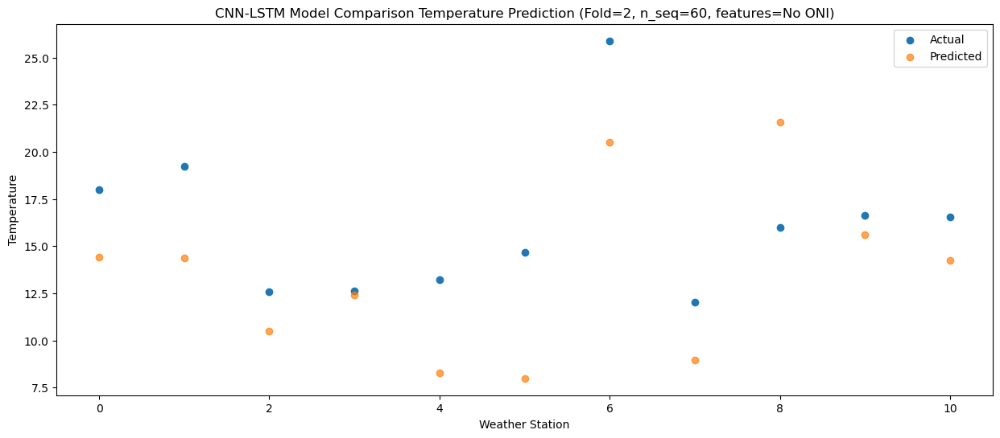

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.85   7.791094
1                 1   10.21   6.524549
2                 2    9.01   7.086423
3                 3    7.61   7.668822
4                 4    7.08   3.180492
5                 5    6.78   1.372393
6                 6   17.17  13.200199
7                 7    5.28   3.271438
8                 8   14.39  16.807801
9                 9   11.35  10.826273
10               10   10.48   9.158017


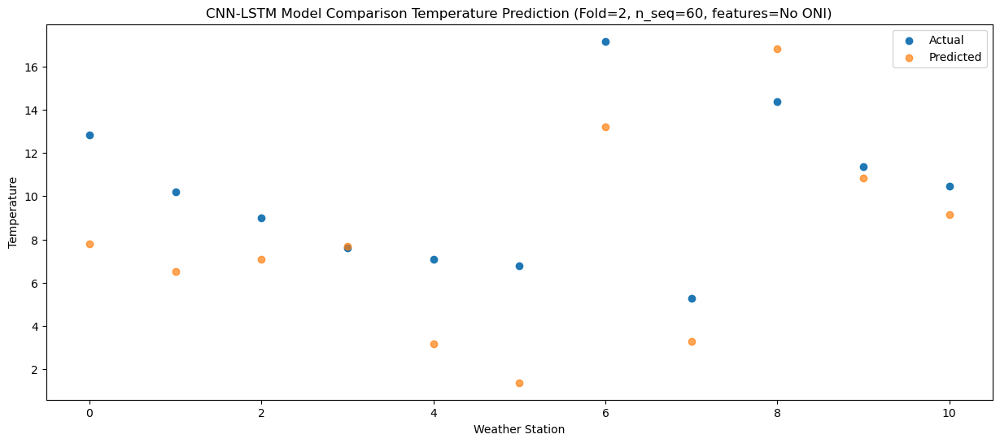

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    5.74   0.634745
1                 1    3.49  -0.655090
2                 2    5.03   1.911114
3                 3   -0.37  -0.558552
4                 4    1.97  -2.897267
5                 5    0.50  -5.430245
6                 6   11.83   6.244496
7                 7   -1.83  -3.667987
8                 8   10.00  10.407787
9                 9    5.45   3.836270
10               10    4.27   1.891842


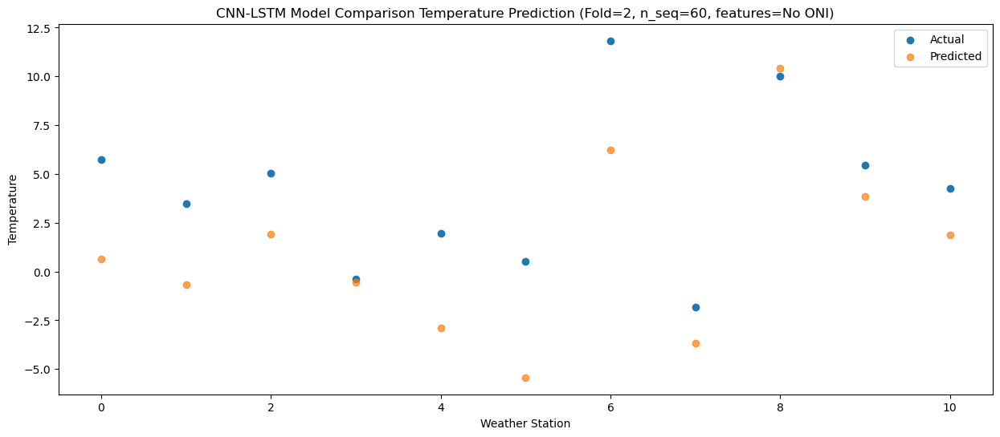

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    2.68  -2.236769
1                 1   -0.18  -3.587599
2                 2    3.10  -0.427877
3                 3   -1.11  -1.612494
4                 4   -0.63  -5.763961
5                 5   -1.61  -8.682025
6                 6    8.85   2.837627
7                 7   -6.87  -5.889200
8                 8    7.67   8.598882
9                 9    2.98   1.860413
10               10    1.42  -0.051316


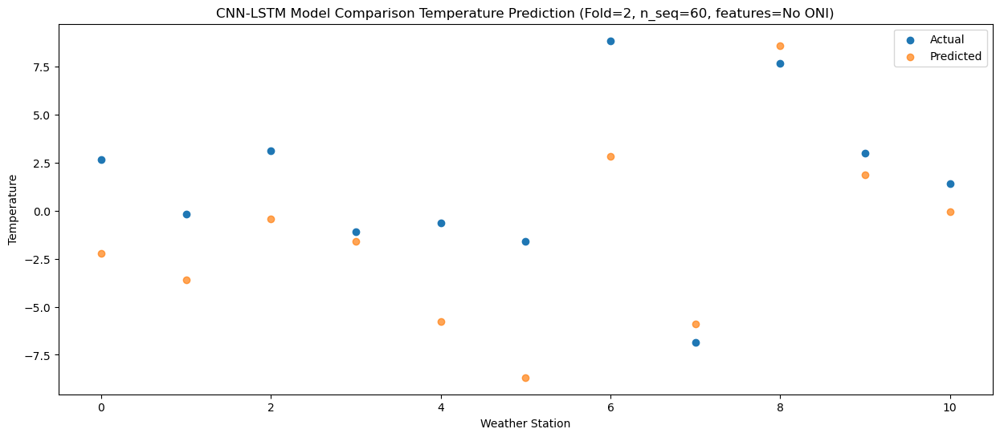

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.11  -6.255898
1                 1   -5.27  -8.274482
2                 2    1.10  -0.054100
3                 3   -5.28  -4.401247
4                 4   -2.71  -7.452639
5                 5   -5.76 -11.888372
6                 6    3.67  -1.262825
7                 7   -7.20  -7.821413
8                 8    5.87   8.303459
9                 9    1.13  -0.244791
10               10   -1.90  -2.669850


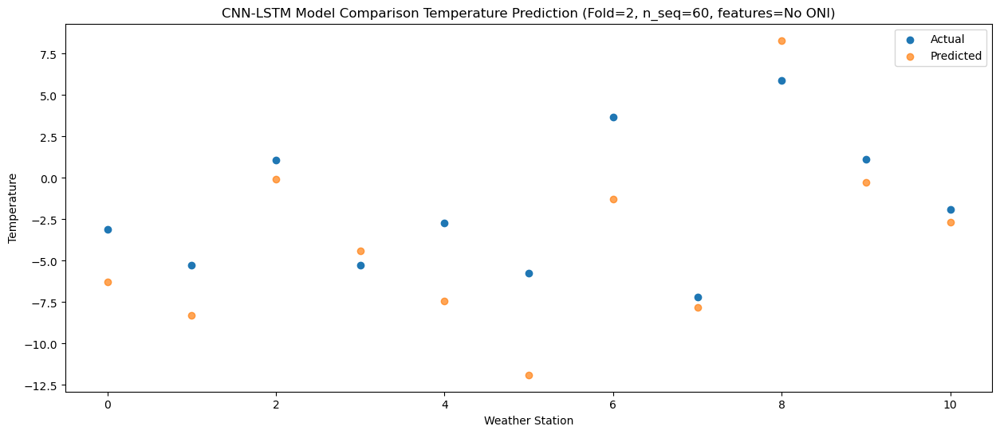

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.21  -1.113448
1                 1    2.21  -2.272684
2                 2    1.58  -0.465706
3                 3   -4.60  -3.875961
4                 4    1.45  -4.560935
5                 5    1.00  -6.532137
6                 6   11.93   5.194509
7                 7   -3.99  -5.551710
8                 8    6.40   8.185867
9                 9    4.35   1.311000
10               10    2.64  -0.670691


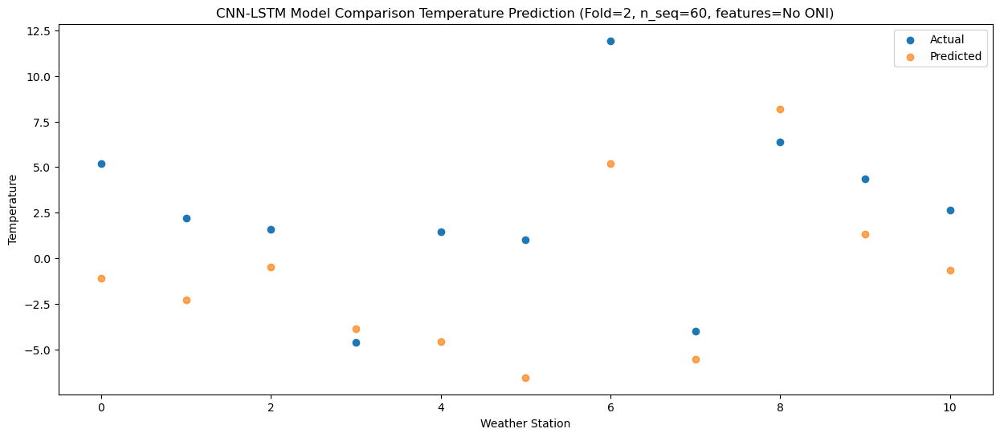

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.10   2.468694
1                 1    4.98   0.201184
2                 2    6.00   3.624379
3                 3   -0.20   0.525151
4                 4    4.12  -0.738552
5                 5    3.37  -3.198456
6                 6   14.28   8.283342
7                 7   -1.42  -2.512755
8                 8    7.34  10.954244
9                 9    7.91   5.489241
10               10    6.81   3.463556


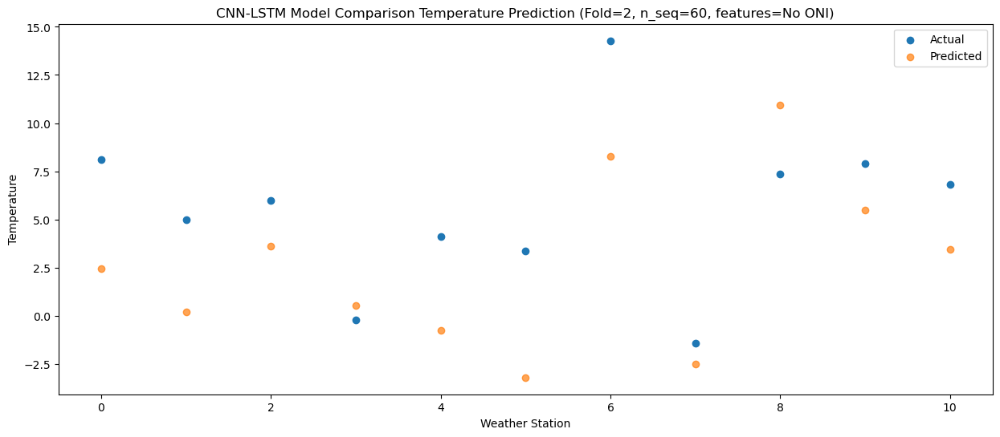

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.86   6.867164
1                 1   10.39   5.595872
2                 2    7.39   5.936619
3                 3    2.23   5.075486
4                 4    7.78   2.350940
5                 5    7.11   0.649530
6                 6   17.73  12.613466
7                 7    2.99   1.645810
8                 8    9.45  14.718860
9                 9   11.97   9.227070
10               10   10.79   7.492349


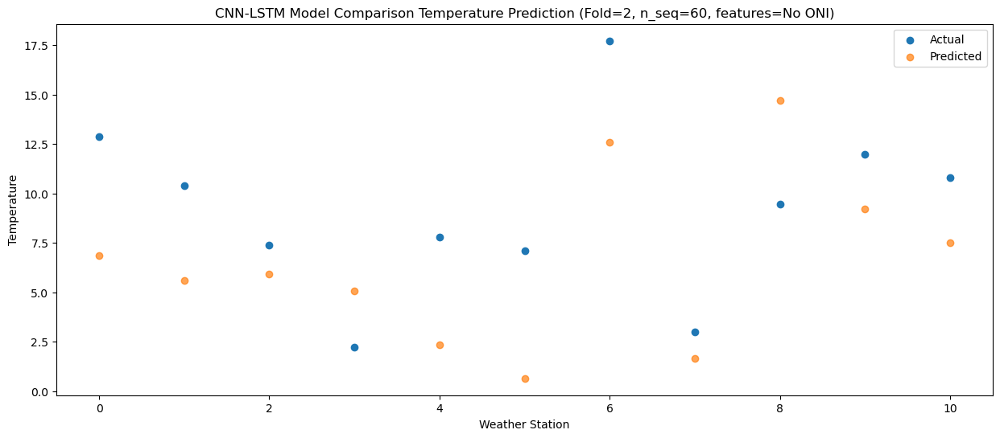

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.79  11.581298
1                 1   15.00  10.052955
2                 2   12.24  10.007227
3                 3    8.02  10.869088
4                 4   12.83   6.438744
5                 5   10.81   4.618728
6                 6   22.62  16.696692
7                 7    8.81   5.791808
8                 8   11.25  18.540674
9                 9   16.35  14.194457
10               10   15.25  12.624228


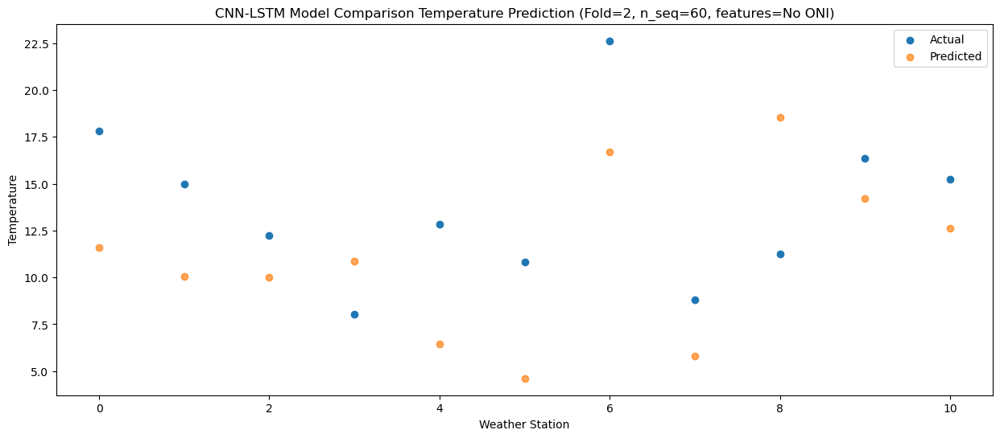

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   20.87  15.999739
1                 1   21.17  16.263215
2                 2   13.15  12.513873
3                 3   13.99  15.991854
4                 4   14.66   9.632229
5                 5   14.04   8.804661
6                 6   26.12  21.313766
7                 7   15.23  11.246443
8                 8   15.93  24.275248
9                 9   20.23  18.162273
10               10   19.60  16.862858


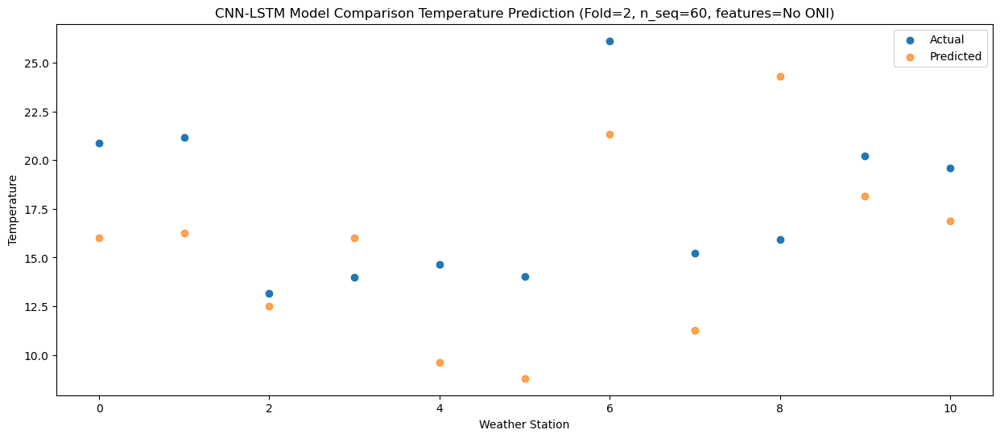

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   21.36  15.908085
1                 1   21.72  17.646179
2                 2   13.99  13.083293
3                 3   16.77  18.015254
4                 4   15.27   9.470461
5                 5   12.52   8.640119
6                 6   26.43  21.102380
7                 7   14.70  13.547943
8                 8   19.66  28.071248
9                 9   21.62  18.928761
10               10   20.83  17.664448


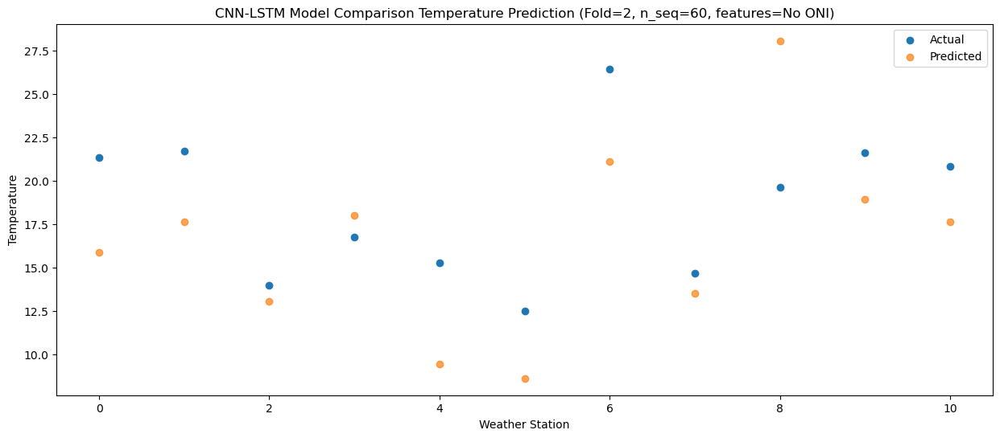

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   21.59  15.621770
1                 1   21.77  16.834417
2                 2   13.95  11.648379
3                 3   15.06  15.335954
4                 4   15.62   9.080208
5                 5   14.17   8.889732
6                 6   28.23  21.490645
7                 7   15.09  11.992485
8                 8   19.24  25.558140
9                 9   19.60  17.351414
10               10   19.21  16.092361


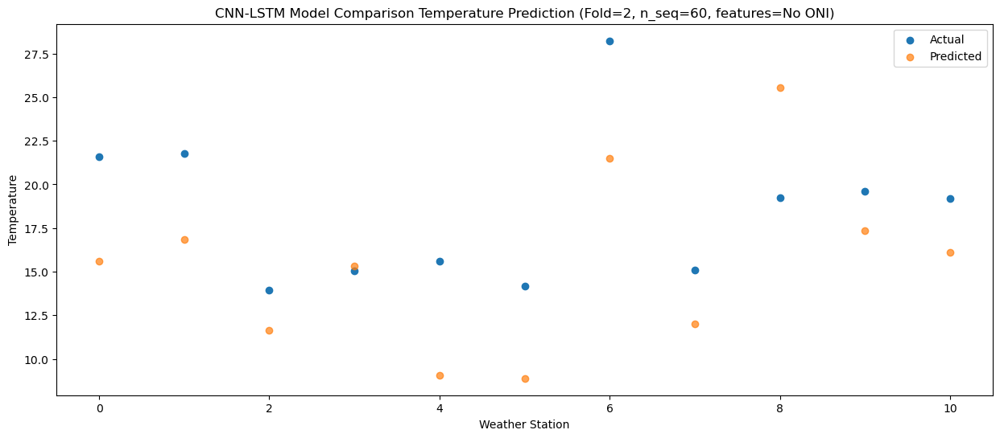

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   17.61  11.315622
1                 1   18.04  12.583677
2                 2   13.63   9.188117
3                 3   11.54  11.680354
4                 4   12.82   5.445615
5                 5   11.44   4.263747
6                 6   24.00  16.711834
7                 7   11.06   8.148798
8                 8   17.39  22.430936
9                 9   16.64  13.876161
10               10   16.62  12.470566


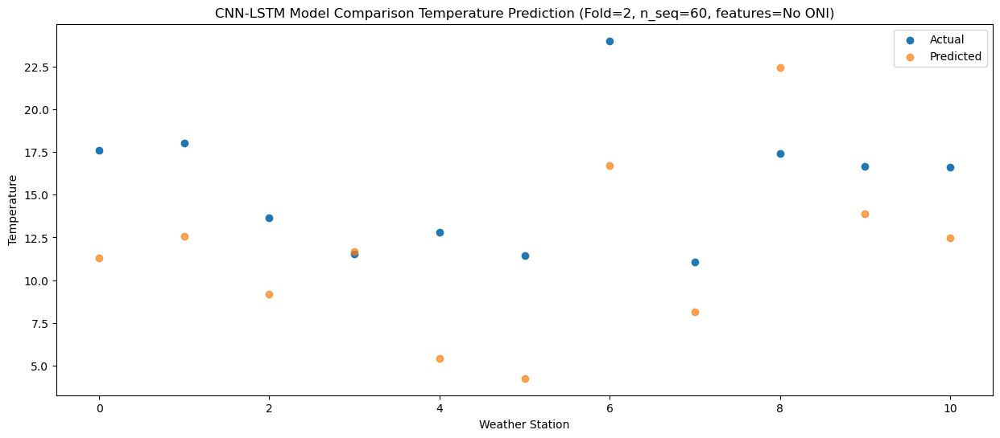

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   13.34   7.439905
1                 1   13.07   7.800198
2                 2   10.16   6.065276
3                 3    6.28   6.213001
4                 4    8.13   2.395591
5                 5    8.79   1.217021
6                 6   21.03  13.435128
7                 7    6.80   3.812558
8                 8   14.40  17.821779
9                 9   11.42   9.583439
10               10   10.20   7.989307


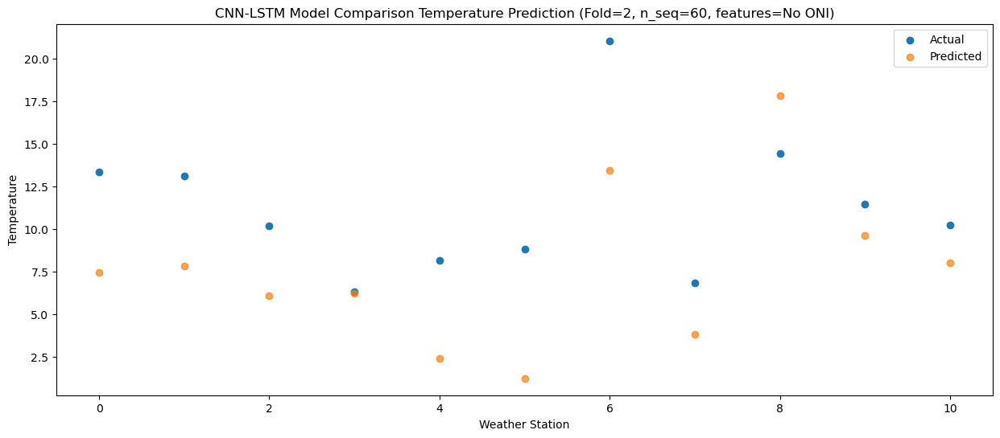

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_2 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_2 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_4 (LSTM)               (None, 1, 256)            1311744   
                                                                 
 dropout_7 (Dropout)         (None, 1, 256)            0         
                                                                 
 lstm_5 (LSTM)               (None, 256)               525312    
                                                      

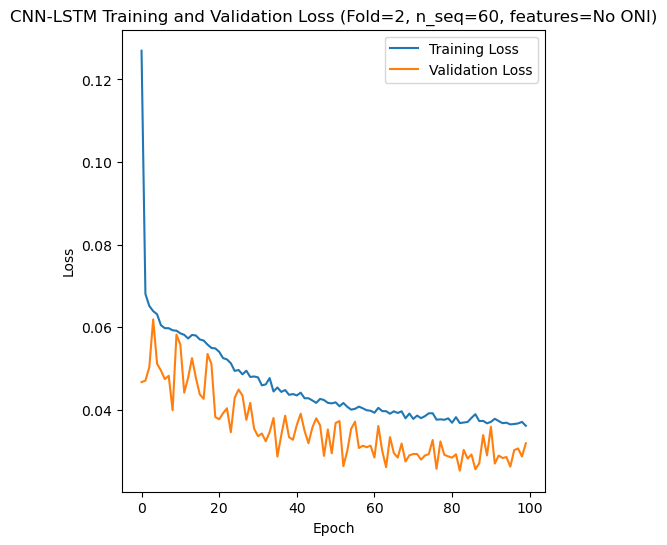

Epoch 1/100
84/84 [==============================] - 32s 146ms/step - loss: 0.1348 - accuracy: 0.3214 - mae: 0.1166 - rmse: 0.1348 - mape: 25.3431 - pearson: 0.6357 - val_loss: 0.0864 - val_accuracy: 0.5000 - val_mae: 0.0673 - val_rmse: 0.0864 - val_mape: 15.0300 - val_pearson: 0.7152
Epoch 2/100
84/84 [==============================] - 5s 60ms/step - loss: 0.0661 - accuracy: 0.5000 - mae: 0.0526 - rmse: 0.0661 - mape: 12.3338 - pearson: 0.8272 - val_loss: 0.0733 - val_accuracy: 0.5000 - val_mae: 0.0581 - val_rmse: 0.0733 - val_mape: 13.3151 - val_pearson: 0.7935
Epoch 3/100
84/84 [==============================] - 5s 58ms/step - loss: 0.0624 - accuracy: 0.5357 - mae: 0.0495 - rmse: 0.0624 - mape: 11.6078 - pearson: 0.8448 - val_loss: 0.0730 - val_accuracy: 0.5000 - val_mae: 0.0576 - val_rmse: 0.0730 - val_mape: 12.8319 - val_pearson: 0.7758
Epoch 4/100
84/84 [==============================] - 5s 54ms/step - loss: 0.0606 - accuracy: 0.5714 - mae: 0.0484 - rmse: 0.0606 - mape: 11.4046 -

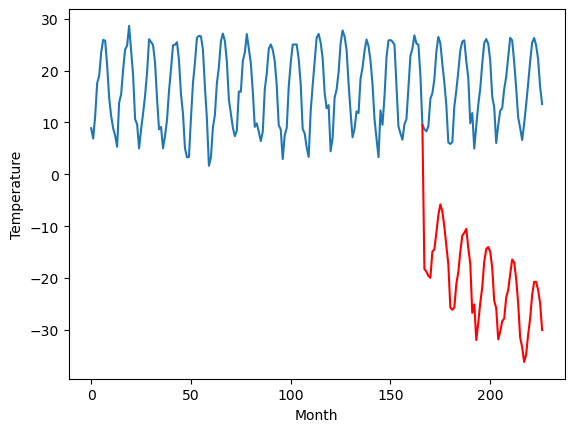

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.89		0.82		-2.07
1.54		0.01		-1.53
0.70		-1.22		-1.92
0.85		-1.82		-2.67
8.34		5.52		-2.82
9.26		6.34		-2.92
13.66		10.77		-2.89
20.76		15.54		-5.22
22.62		16.74		-5.88
20.76		15.14		-5.62
17.09		10.84		-6.25
9.98		5.14		-4.84
7.16		2.44		-4.72
0.61		-6.03		-6.64
-0.54		-6.41		-5.87
-4.26		-9.52		-5.26
7.71		0.46		-7.25
9.57		2.43		-7.14
13.79		6.88		-6.91
20.50		11.57		-8.93
21.81		11.96		-9.85
22.38		12.83		-9.55
19.65		9.49		-10.16
13.05		4.70		-8.35
5.34		-4.66		-10.00
6.65		-3.39		-10.04
-2.18		-11.72		-9.54
-0.96		-10.18		-9.22
5.82		-3.95		-9.77
10.67		1.02		-9.65
16.10		6.71		-9.39
21.25		10.44		-10.81
25.29		11.32		-13.97
22.21		9.26		-12.95
18.35		6.07		-12.28
11.80		-1.18		-12.98
4.57		-6.17		-10.74
0.52		-11.39		-11.91
1.22		-10.34		-11.56
3.18		-8.28		-11.46
5.78		-6.04		-11.82
10.83		-1.60		-12.43
16.14		2.55		-13.59
20.47		6.11		-14.36
22.73		7.79		-14.94
22.91		8.42		-14.49
1

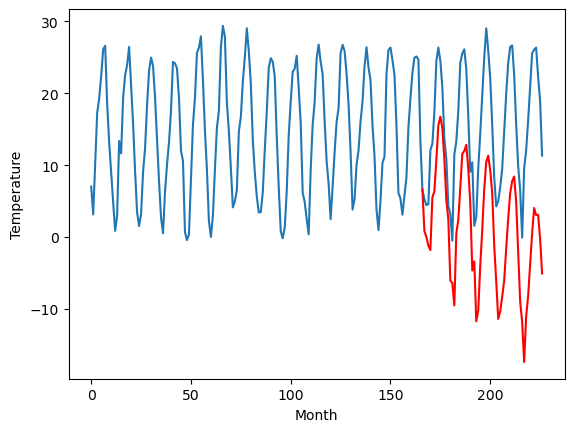

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.73		4.45		-0.28
2.20		1.70		-0.50
0.98		2.00		1.02
3.40		1.94		-1.46
5.19		4.80		-0.39
9.85		7.38		-2.47
15.04		10.92		-4.12
18.39		12.75		-5.64
21.17		15.02		-6.15
21.70		15.82		-5.88
17.37		11.81		-5.56
11.88		7.32		-4.56
3.23		2.62		-0.61
0.03		-3.29		-3.32
1.29		-2.85		-4.14
3.59		-1.71		-5.30
4.74		-1.50		-6.24
10.47		2.17		-8.30
15.27		5.74		-9.53
20.12		10.36		-9.76
23.25		11.16		-12.09
21.05		10.17		-10.88
17.74		6.99		-10.75
9.08		1.46		-7.62
4.74		-3.05		-7.79
0.82		-7.05		-7.87
0.49		-8.38		-8.87
2.19		-7.30		-9.49
6.90		-4.09		-10.99
9.97		-1.80		-11.77
14.21		0.67		-13.54
19.60		4.15		-15.45
22.17		6.98		-15.19
22.35		7.20		-15.15
19.53		3.88		-15.65
12.35		-2.57		-14.92
1.62		-8.53		-10.15
0.66		-12.81		-13.47
2.05		-12.27		-14.32
1.20		-11.91		-13.11
4.07		-9.73		-13.80
9.70		-5.40		-15.10
14.14		-2.36		-16.50
16.94		-0.59		-17.53
22.60		3.87		-18.73
20.91		3.62		-17.29
17.14

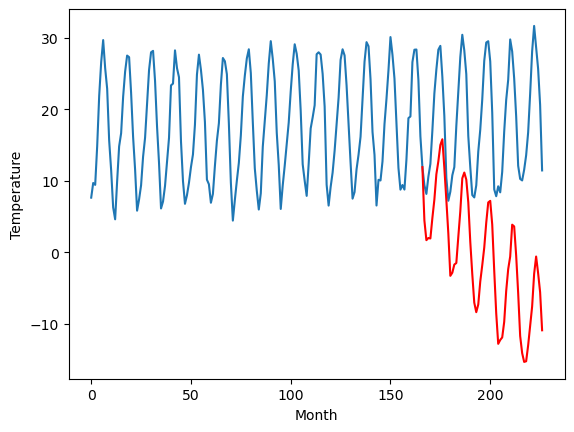

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-7.31		-7.21		0.10
-7.30		-7.98		-0.68
-7.85		-9.10		-1.25
-8.20		-9.74		-1.54
-1.29		-3.94		-2.65
-0.65		-3.09		-2.44
3.92		1.33		-2.59
9.74		6.13		-3.61
13.54		8.35		-5.19
11.12		6.30		-4.82
7.06		2.71		-4.35
1.64		-2.32		-3.96
-2.28		-5.63		-3.35
-9.48		-14.23		-4.75
-10.94		-15.31		-4.37
-12.26		-16.60		-4.34
-2.05		-9.30		-7.25
0.30		-6.45		-6.75
4.37		-2.16		-6.53
10.29		2.28		-8.01
11.28		2.65		-8.63
11.80		3.58		-8.22
7.67		-0.55		-8.22
4.09		-4.21		-8.30
-5.57		-14.55		-8.98
-4.08		-13.72		-9.64
-13.03		-21.74		-8.71
-8.51		-18.42		-9.91
-2.76		-13.46		-10.70
0.25		-9.73		-9.98
7.03		-3.38		-10.41
10.51		-0.32		-10.83
12.06		0.49		-11.57
10.99		-0.65		-11.64
7.01		-4.37		-11.38
-0.26		-11.32		-11.06
-3.38		-13.87		-10.49
-8.65		-20.64		-11.99
-6.90		-19.04		-12.14
-4.56		-17.40		-12.84
-4.32		-16.55		-12.23
1.92		-10.90		-12.82
4.61		-8.46		-13.07
8.35		-5.10		-13.45
11.97		-2.42		-1

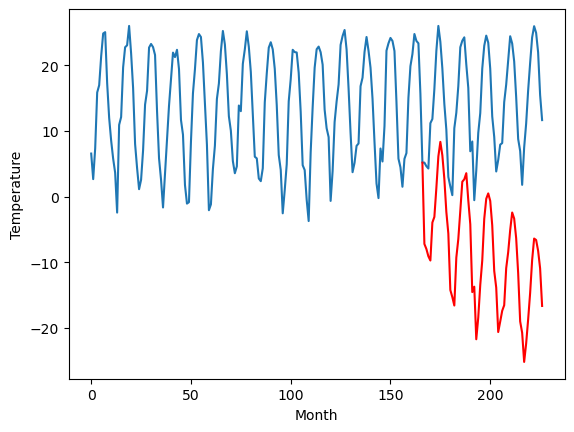

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.64		-0.89		-6.53
2.38		-1.78		-4.16
-0.49		-3.41		-2.92
0.66		-4.08		-4.74
8.07		2.93		-5.14
11.10		4.27		-6.83
17.17		9.37		-7.80
24.22		15.21		-9.01
25.68		16.86		-8.82
23.12		14.55		-8.57
19.05		10.16		-8.89
11.32		3.90		-7.42
8.50		1.24		-7.26
1.33		-7.65		-8.98
-0.14		-8.74		-8.60
-4.01		-12.07		-8.06
9.07		-1.62		-10.69
12.36		1.18		-11.18
16.93		5.87		-11.06
24.41		11.36		-13.05
24.41		11.60		-12.81
24.53		12.47		-12.06
21.17		8.43		-12.74
15.75		3.73		-12.02
6.01		-6.73		-12.74
5.65		-6.58		-12.23
-3.82		-15.29		-11.47
-1.30		-12.75		-11.45
7.16		-6.39		-13.55
11.29		-1.96		-13.25
18.86		5.07		-13.79
24.31		8.90		-15.41
25.43		9.77		-15.66
23.61		8.13		-15.48
19.29		4.39		-14.90
12.02		-3.11		-15.13
6.13		-7.47		-13.60
0.16		-14.26		-14.42
1.88		-12.91		-14.79
8.40		-11.23		-19.63
5.44		-9.65		-15.09
12.65		-3.43		-16.08
18.65		0.62		-18.03
22.75		4.30		-18.45
24.45		6.17		-18.28
23

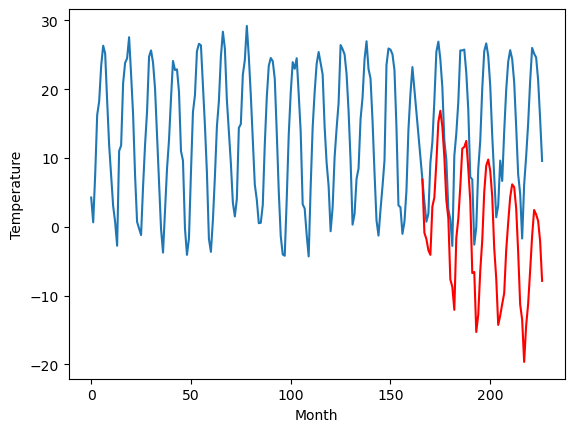

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.05		-3.24		-0.19
-2.84		-4.04		-1.20
-4.26		-5.51		-1.25
-4.67		-6.21		-1.54
2.19		0.35		-1.84
4.46		1.50		-2.96
9.87		6.41		-3.46
16.86		11.98		-4.88
18.75		13.91		-4.84
16.24		11.58		-4.66
12.61		7.54		-5.07
6.61		1.72		-4.89
2.67		-1.18		-3.85
-4.94		-10.03		-5.09
-6.39		-11.21		-4.82
-9.11		-13.80		-4.69
2.22		-4.42		-6.64
5.67		-1.53		-7.20
9.95		3.01		-6.94
16.66		8.16		-8.50
17.04		8.41		-8.63
17.36		9.36		-8.00
14.10		5.22		-8.88
9.52		1.01		-8.51
-1.33		-9.62		-8.29
-0.28		-9.15		-8.87
-9.10		-17.78		-8.68
-5.91		-14.82		-8.91
1.05		-8.97		-10.02
4.90		-4.81		-9.71
12.70		2.14		-10.56
16.64		5.66		-10.98
18.63		6.48		-12.15
16.98		5.04		-11.94
13.03		1.24		-11.79
6.99		-6.06		-13.05
0.44		-9.58		-10.02
-5.10		-16.51		-11.41
-2.96		-15.01		-12.05
-1.24		-13.37		-12.13
-0.34		-12.15		-11.81
5.89		-6.00		-11.89
11.30		-2.60		-13.90
14.76		0.99		-13.77
18.02		3.16		-14.86
16.47		2.46	

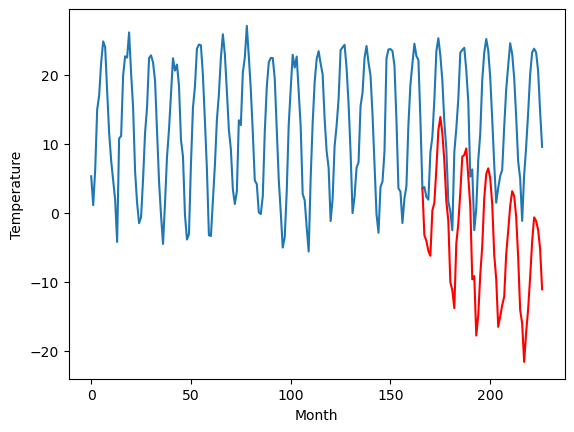

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.14		1.68		5.82
-9.81		-0.48		9.33
-9.90		-0.74		9.16
-9.71		-1.02		8.69
-4.78		3.63		8.41
-1.80		5.68		7.48
5.31		9.73		4.42
9.52		12.82		3.30
11.51		14.72		3.21
12.26		14.66		2.40
6.76		10.34		3.58
3.02		5.17		2.15
-4.17		1.23		5.40
-9.87		-5.63		4.24
-9.60		-5.50		4.10
-9.50		-6.18		3.32
-6.53		-1.99		4.54
-1.75		1.14		2.89
3.30		5.16		1.86
10.69		10.06		-0.63
12.53		10.77		-1.76
10.61		10.44		-0.17
8.74		7.13		-1.61
0.77		1.63		0.86
-1.97		-4.65		-2.68
-6.73		-7.01		-0.28
-9.02		-10.89		-1.87
-10.74		-9.75		0.99
-6.20		-5.22		0.98
-1.88		-1.78		0.10
4.03		2.00		-2.03
9.80		5.77		-4.03
11.72		8.07		-3.65
10.96		7.42		-3.54
8.80		4.09		-4.71
0.54		-2.78		-3.32
-7.14		-8.77		-1.63
-9.31		-13.44		-4.13
-10.04		-12.74		-2.70
-10.01		-11.77		-1.76
-8.22		-9.42		-1.20
-2.88		-4.76		-1.88
4.33		-1.09		-5.42
8.91		1.40		-7.51
15.05		4.81		-10.24
12.46		4.84		-7.62
8.31		0.93		-7.38
2.18		-5.09		

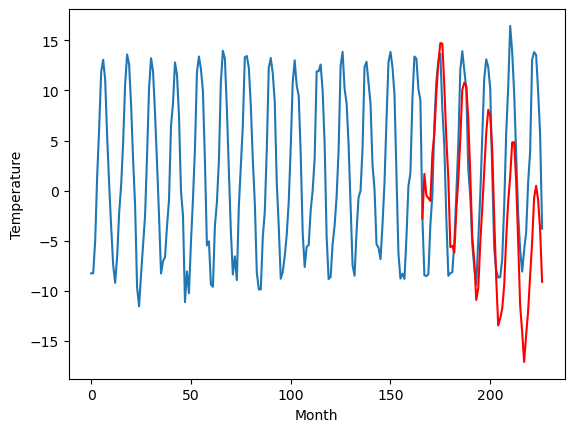

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.65		2.01		0.36
-3.08		-0.78		2.30
-1.92		-0.63		1.29
-0.41		-0.77		-0.36
2.70		2.78		0.08
8.61		5.42		-3.19
15.88		9.34		-6.54
19.34		11.70		-7.64
23.57		13.81		-9.76
23.68		14.41		-9.27
18.87		10.00		-8.87
11.93		4.95		-6.98
3.12		0.51		-2.61
-2.57		-5.56		-2.99
-2.02		-5.17		-3.15
0.83		-5.00		-5.83
2.43		-3.14		-5.57
10.40		0.45		-9.95
14.83		4.22		-10.61
22.47		9.26		-13.21
23.55		10.06		-13.49
22.32		9.16		-13.16
18.35		5.96		-12.39
8.00		0.01		-7.99
5.48		-4.76		-10.24
-1.79		-8.74		-6.95
-1.86		-10.73		-8.87
0.18		-9.96		-10.14
4.89		-6.07		-10.96
9.52		-3.19		-12.71
14.19		-0.34		-14.53
20.67		3.51		-17.16
22.90		6.48		-16.42
21.31		6.35		-14.96
18.95		2.95		-16.00
11.06		-3.80		-14.86
-0.36		-10.54		-10.18
-2.69		-14.80		-12.11
-3.20		-14.29		-11.09
-2.29		-13.85		-11.56
0.54		-11.29		-11.83
8.49		-6.64		-15.13
14.29		-2.97		-17.26
16.79		-0.98		-17.77
25.15		3.18		-21.97
20.52		3.

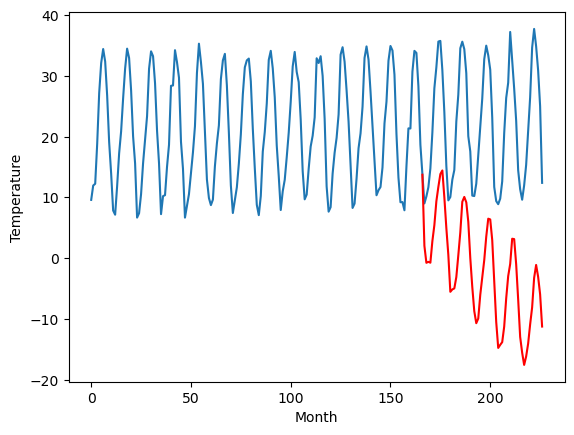

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.04		-0.41		-0.37
-1.29		-2.87		-1.58
-1.92		-2.52		-0.60
0.10		-2.46		-2.56
-0.46		0.11		0.57
3.16		2.37		-0.79
5.56		5.31		-0.25
8.10		6.49		-1.61
7.29		8.68		1.39
9.17		9.73		0.56
8.59		6.21		-2.38
6.37		2.49		-3.88
-0.79		-2.29		-1.50
-2.84		-8.19		-5.35
-1.62		-7.52		-5.90
-0.69		-5.53		-4.84
-0.91		-6.52		-5.61
1.28		-3.15		-4.43
5.57		0.19		-5.38
7.27		4.06		-3.21
6.45		4.87		-1.58
7.00		3.86		-3.14
6.45		0.91		-5.54
3.69		-4.09		-7.78
0.87		-8.42		-9.29
-2.83		-11.71		-8.88
-2.21		-12.75		-10.54
-1.25		-11.55		-10.30
0.98		-8.90		-9.88
2.42		-7.00		-9.42
5.41		-5.09		-10.50
8.56		-2.04		-10.60
6.91		0.36		-6.55
8.33		0.68		-7.65
8.56		-2.29		-10.85
3.83		-8.38		-12.21
-1.90		-13.49		-11.59
-3.10		-17.44		-14.34
-1.43		-16.92		-15.49
-3.23		-16.36		-13.13
-1.77		-14.48		-12.71
2.31		-11.05		-13.36
3.34		-8.61		-11.95
5.24		-6.96		-12.20
8.25		-2.55		-10.80
9.28		-2.63		-11.91
6.67		-

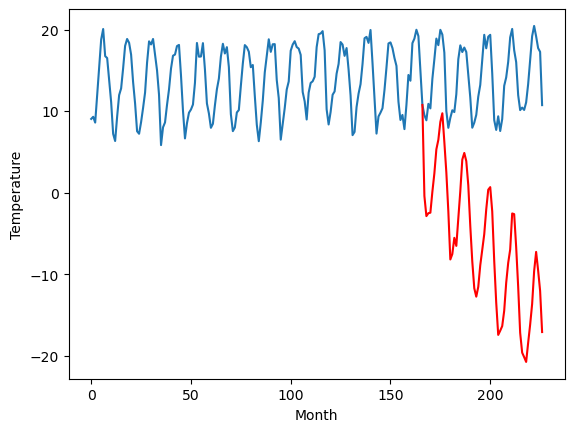

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.08		-4.61		-1.53
-5.84		-6.49		-0.65
-5.81		-7.00		-1.19
-5.37		-7.62		-2.25
-1.79		-3.71		-1.92
-0.35		-2.07		-1.72
5.21		2.94		-2.27
12.19		7.65		-4.54
16.14		10.96		-5.18
14.96		9.07		-5.89
10.62		5.25		-5.37
5.30		0.07		-5.23
1.23		-4.02		-5.25
-5.11		-11.85		-6.74
-8.13		-13.38		-5.25
-8.25		-13.46		-5.21
-3.25		-9.09		-5.84
1.37		-4.88		-6.25
6.20		-0.74		-6.94
12.07		4.29		-7.78
14.21		4.73		-9.48
14.83		5.30		-9.53
11.51		0.67		-10.84
7.07		-3.24		-10.31
-1.85		-12.81		-10.96
-3.45		-14.51		-11.06
-10.00		-20.78		-10.78
-7.24		-16.86		-9.62
-3.28		-12.84		-9.56
1.01		-9.90		-10.91
6.80		-3.60		-10.40
11.12		-0.53		-11.65
15.67		1.52		-14.15
15.59		1.33		-14.26
10.68		-3.19		-13.87
4.42		-10.05		-14.47
0.46		-12.60		-13.06
-5.90		-20.17		-14.27
-3.92		-18.45		-14.53
-5.65		-17.96		-12.31
-3.68		-17.39		-13.71
2.37		-10.28		-12.65
6.01		-8.51		-14.52
10.00		-5.60		-15.60
15.68		-1.2

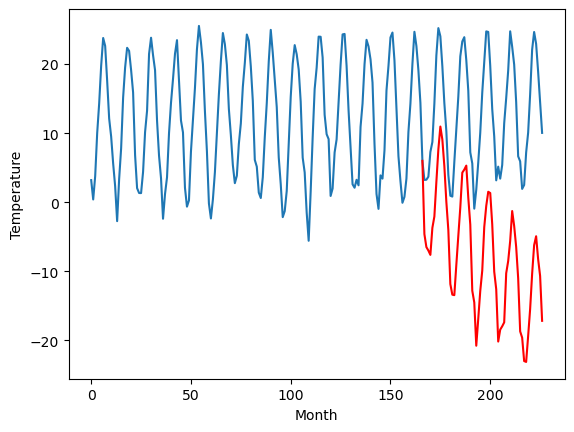

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-17.90		-18.59		-0.69
-20.86		-20.21		0.65
-20.45		-20.89		-0.44
-19.53		-21.56		-2.03
-15.12		-17.17		-2.05
-13.18		-15.73		-2.55
-7.41		-10.73		-3.32
-0.69		-5.79		-5.10
3.08		-2.64		-5.72
1.21		-4.74		-5.95
-3.76		-8.56		-4.80
-9.25		-13.79		-4.54
-13.53		-17.68		-4.15
-20.35		-25.79		-5.44
-21.91		-27.36		-5.45
-22.71		-27.80		-5.09
-15.52		-22.51		-6.99
-10.65		-18.54		-7.89
-6.39		-14.33		-7.94
-0.22		-9.37		-9.15
1.42		-8.96		-10.38
1.15		-8.23		-9.38
-3.11		-12.86		-9.75
-7.23		-16.65		-9.42
-17.45		-26.69		-9.24
-17.86		-27.76		-9.90
-24.84		-34.70		-9.86
-21.03		-30.74		-9.71
-15.85		-26.46		-10.61
-12.03		-23.27		-11.24
-5.25		-16.71		-11.46
-1.26		-13.64		-12.38
2.52		-11.87		-14.39
1.65		-12.28		-13.93
-3.58		-16.71		-13.13
-11.19		-23.63		-12.44
-14.31		-26.03		-11.72
-21.34		-33.64		-12.30
-18.69		-31.87		-13.18
-18.48		-31.15		-12.67
-16.92		-30.61		-13.69
-9.35		-23.60		-14.

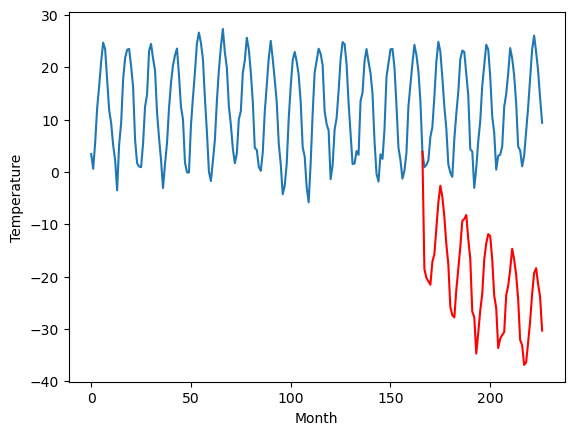

RangeIndex(start=1, stop=12, step=1)
[-17.9, 2.8899999999999997, 4.729999999999999, -7.31, 5.640000000000001, -3.0500000000000007, -4.139999999999999, 1.6500000000000012, -0.03999999999999826, -3.08, -17.9]
[-18.245990982055666, 0.8204415512084964, 4.453007736206054, -7.2138269424438475, -0.8908983230590817, -3.238137702941895, 1.6764148712158207, 2.0145495605468753, -0.40630102157592773, -4.612248344421387, -18.592777481079104]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0  -17.90 -18.245991
1                 1    2.89   0.820442
2                 2    4.73   4.453008
3                 3   -7.31  -7.213827
4                 4    5.64  -0.890898
5                 5   -3.05  -3.238138
6                 6   -4.14   1.676415
7                 7    1.65   2.014550
8                 8   -0.04  -0.406301
9                 9   -3.08  -4.612248
10               10  -17.90 -18.592777


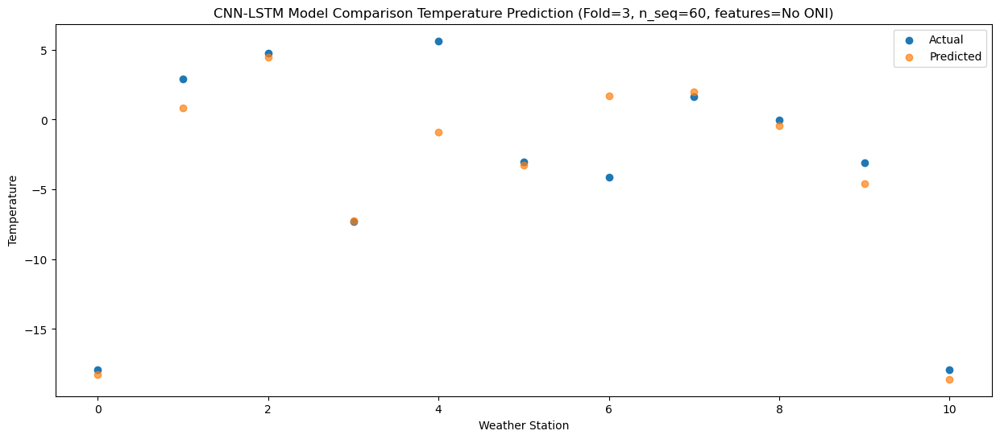

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0  -18.68 -18.743772
1                 1    1.54   0.007997
2                 2    2.20   1.700738
3                 3   -7.30  -7.978172
4                 4    2.38  -1.778279
5                 5   -2.84  -4.037654
6                 6   -9.81  -0.475077
7                 7   -3.08  -0.784881
8                 8   -1.29  -2.874310
9                 9   -5.84  -6.494647
10               10  -20.86 -20.210145


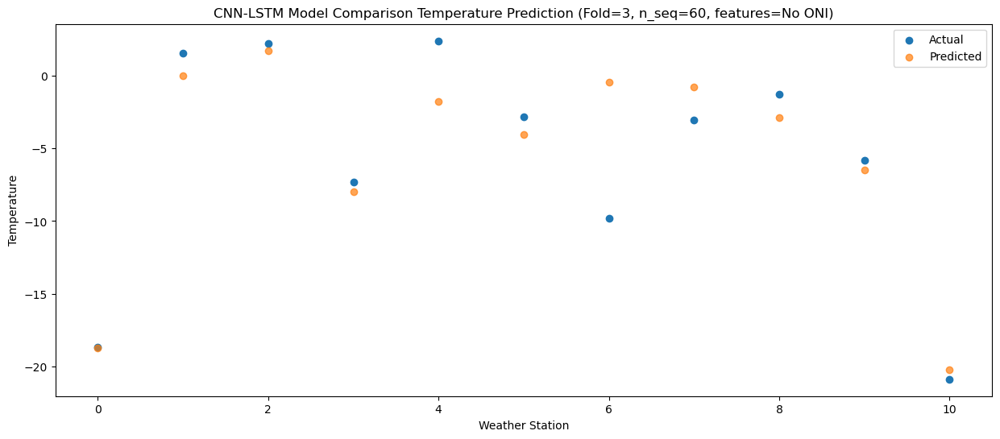

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0  -19.10 -19.568747
1                 1    0.70  -1.223145
2                 2    0.98   2.001628
3                 3   -7.85  -9.096083
4                 4   -0.49  -3.405471
5                 5   -4.26  -5.505204
6                 6   -9.90  -0.744028
7                 7   -1.92  -0.626821
8                 8   -1.92  -2.515394
9                 9   -5.81  -6.995462
10               10  -20.45 -20.891551


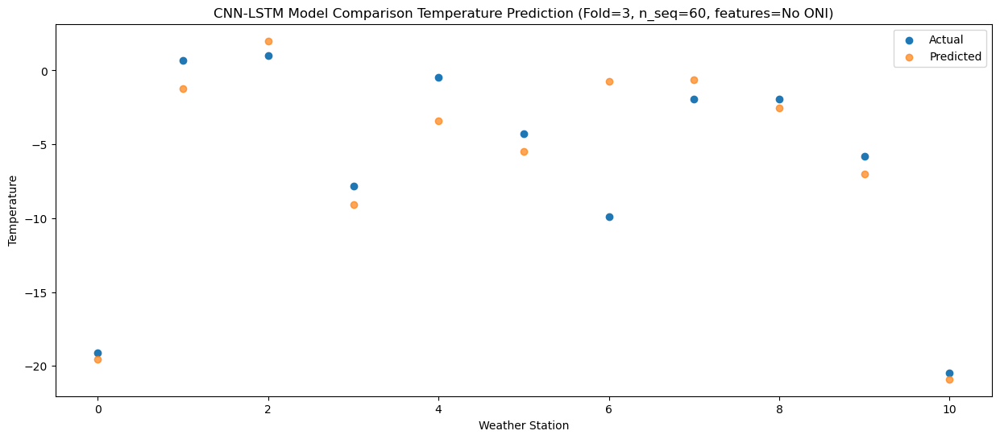

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0  -18.09 -19.946380
1                 1    0.85  -1.819001
2                 2    3.40   1.937701
3                 3   -8.20  -9.736943
4                 4    0.66  -4.080736
5                 5   -4.67  -6.206546
6                 6   -9.71  -1.021844
7                 7   -0.41  -0.769148
8                 8    0.10  -2.455366
9                 9   -5.37  -7.622919
10               10  -19.53 -21.556274


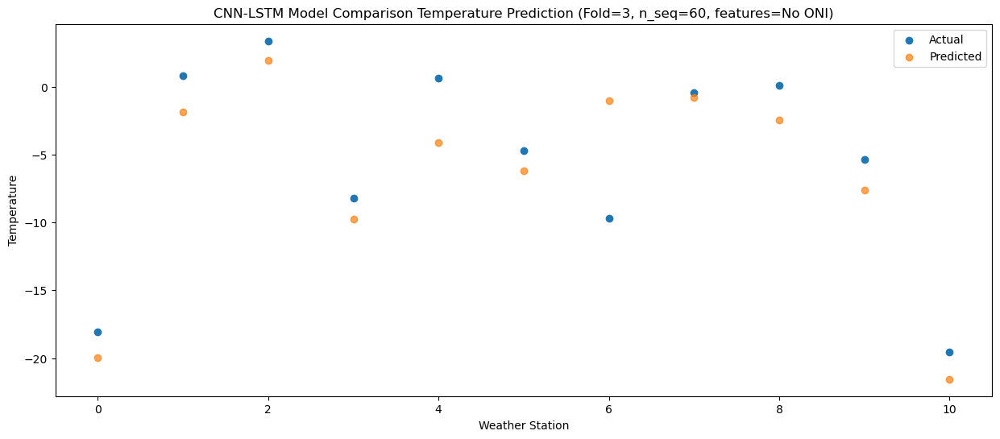

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0  -12.83 -14.898687
1                 1    8.34   5.523509
2                 2    5.19   4.798525
3                 3   -1.29  -3.944445
4                 4    8.07   2.930207
5                 5    2.19   0.352983
6                 6   -4.78   3.628371
7                 7    2.70   2.780143
8                 8   -0.46   0.113394
9                 9   -1.79  -3.711907
10               10  -15.12 -17.169888


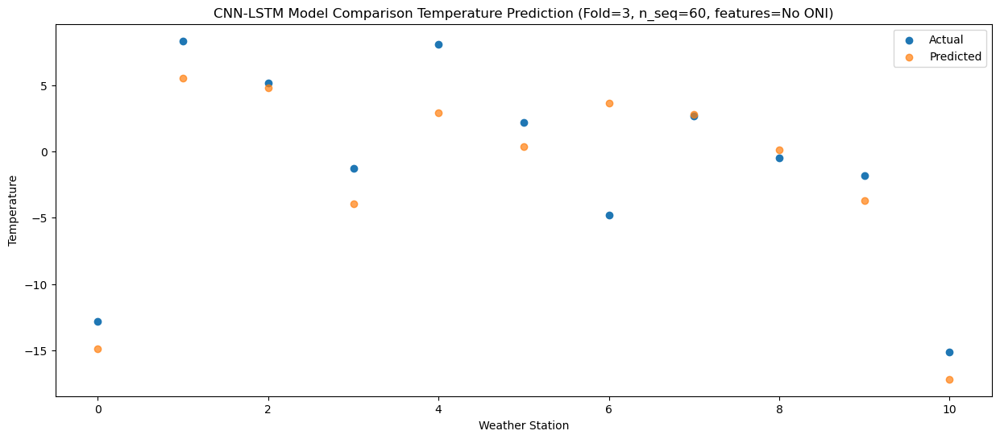

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0  -11.76 -14.481984
1                 1    9.26   6.341772
2                 2    9.85   7.376839
3                 3   -0.65  -3.090175
4                 4   11.10   4.274847
5                 5    4.46   1.495853
6                 6   -1.80   5.680904
7                 7    8.61   5.417643
8                 8    3.16   2.365108
9                 9   -0.35  -2.069773
10               10  -13.18 -15.729109


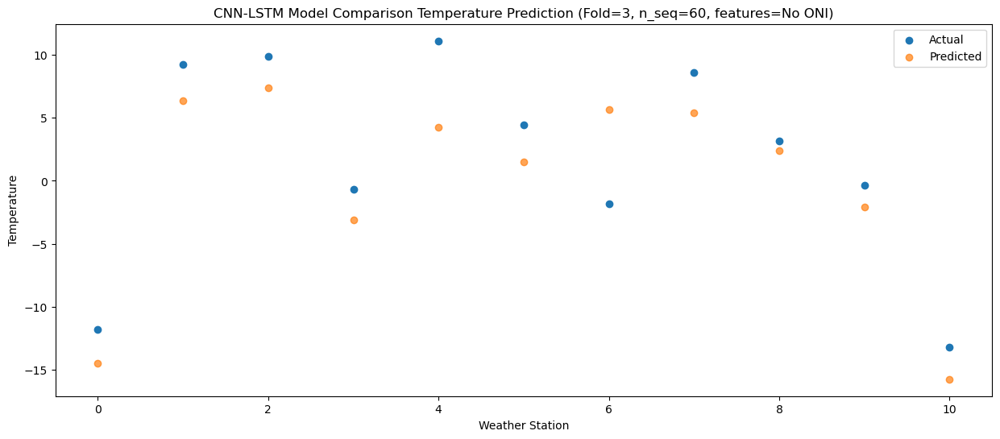

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   -9.07 -11.237666
1                 1   13.66  10.771997
2                 2   15.04  10.923846
3                 3    3.92   1.330435
4                 4   17.17   9.373155
5                 5    9.87   6.409892
6                 6    5.31   9.734070
7                 7   15.88   9.340193
8                 8    5.56   5.312038
9                 9    5.21   2.935893
10               10   -7.41 -10.733065


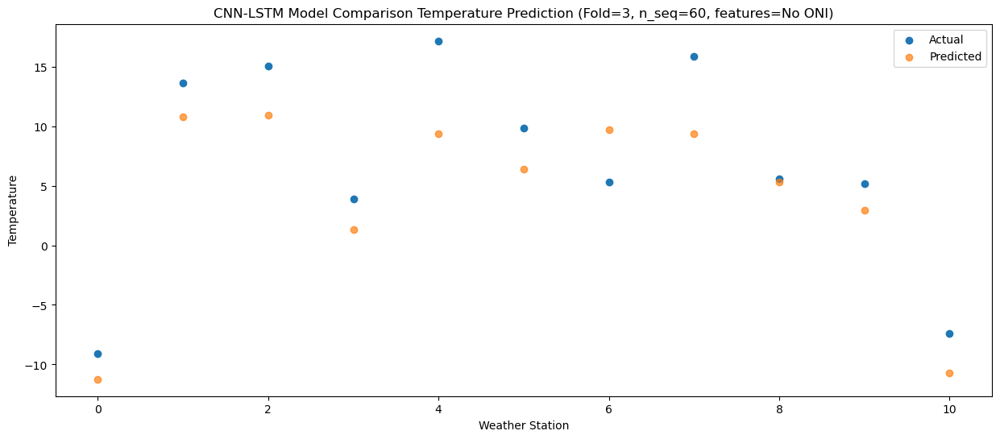

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   -3.75  -7.849251
1                 1   20.76  15.540384
2                 2   18.39  12.750946
3                 3    9.74   6.130034
4                 4   24.22  15.211540
5                 5   16.86  11.977846
6                 6    9.52  12.824188
7                 7   19.34  11.704205
8                 8    8.10   6.485754
9                 9   12.19   7.652068
10               10   -0.69  -5.788214


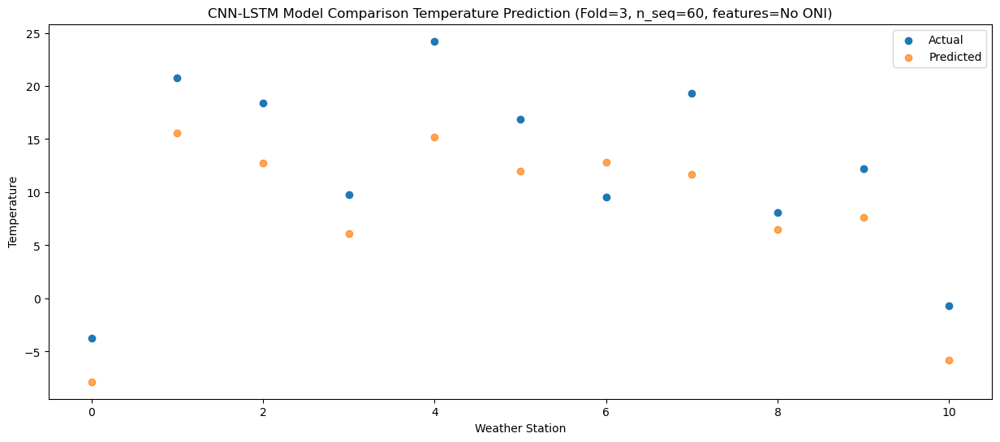

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   -0.89  -5.784766
1                 1   22.62  16.741149
2                 2   21.17  15.020489
3                 3   13.54   8.352658
4                 4   25.68  16.861654
5                 5   18.75  13.910645
6                 6   11.51  14.722070
7                 7   23.57  13.811012
8                 8    7.29   8.680408
9                 9   16.14  10.958119
10               10    3.08  -2.644018


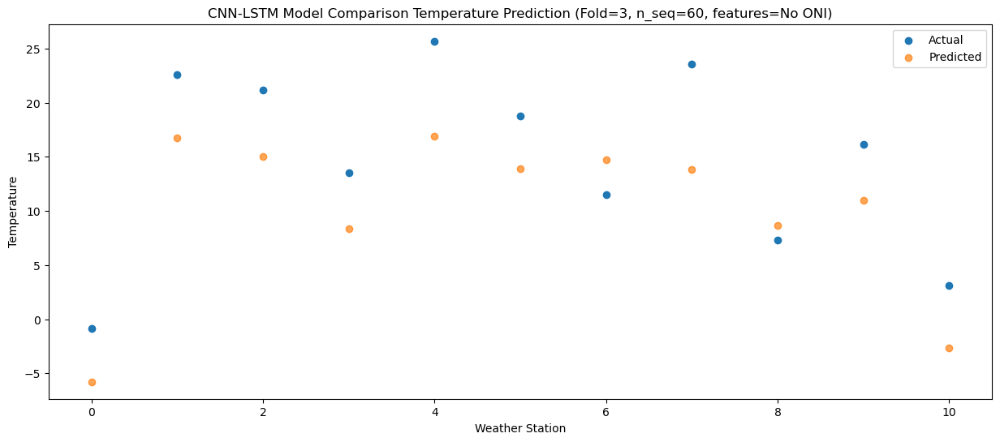

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   -2.12  -7.140847
1                 1   20.76  15.144840
2                 2   21.70  15.821090
3                 3   11.12   6.298932
4                 4   23.12  14.549142
5                 5   16.24  11.581602
6                 6   12.26  14.662575
7                 7   23.68  14.413175
8                 8    9.17   9.730705
9                 9   14.96   9.074539
10               10    1.21  -4.737581


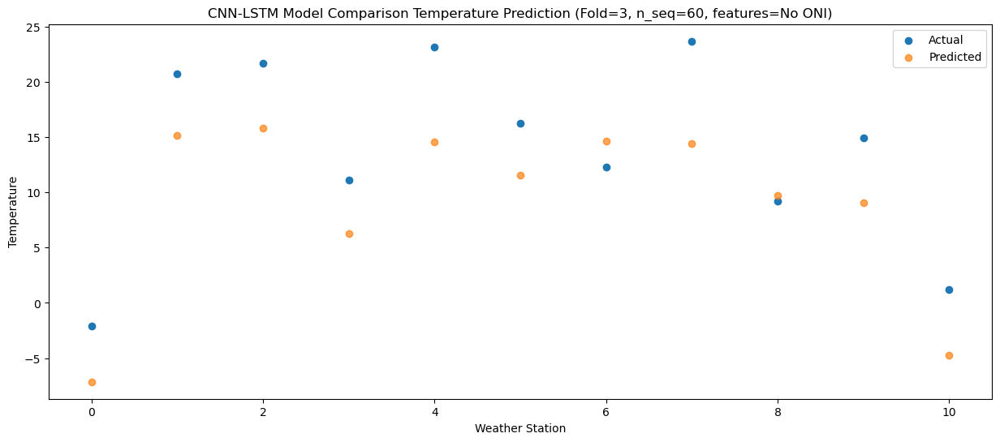

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   -6.09 -10.058306
1                 1   17.09  10.840350
2                 2   17.37  11.813467
3                 3    7.06   2.713223
4                 4   19.05  10.157720
5                 5   12.61   7.543261
6                 6    6.76  10.337478
7                 7   18.87  10.003141
8                 8    8.59   6.213325
9                 9   10.62   5.245565
10               10   -3.76  -8.556922


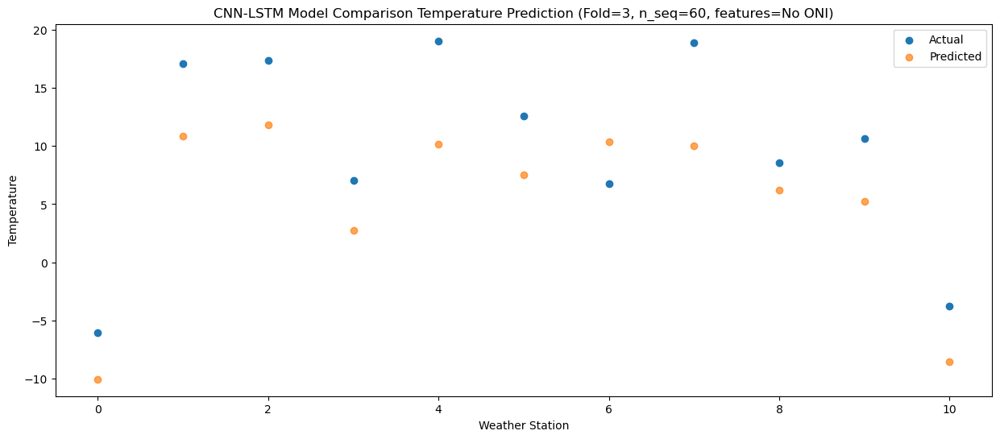

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0   -9.66 -13.738743
1                 1    9.98   5.143486
2                 2   11.88   7.319689
3                 3    1.64  -2.322527
4                 4   11.32   3.902991
5                 5    6.61   1.715661
6                 6    3.02   5.167183
7                 7   11.93   4.946449
8                 8    6.37   2.485140
9                 9    5.30   0.068675
10               10   -9.25 -13.789487


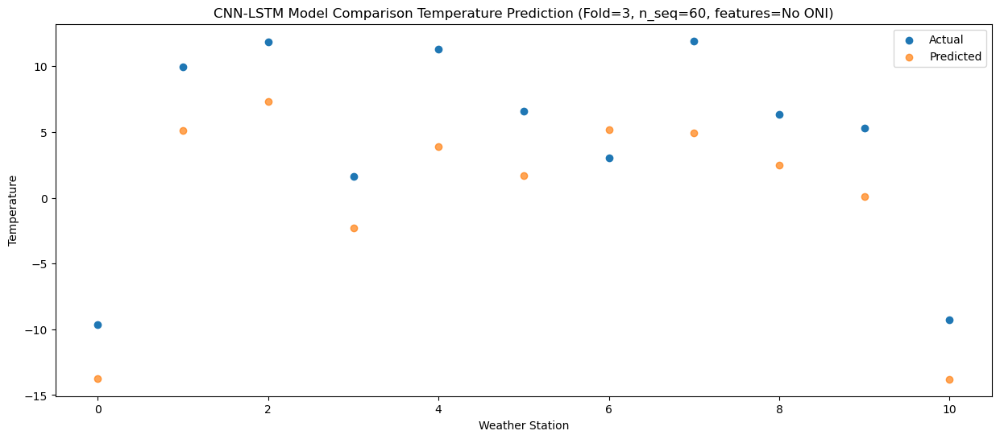

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0  -14.08 -17.328925
1                 1    7.16   2.443789
2                 2    3.23   2.619785
3                 3   -2.28  -5.628626
4                 4    8.50   1.238234
5                 5    2.67  -1.183428
6                 6   -4.17   1.226177
7                 7    3.12   0.506919
8                 8   -0.79  -2.294792
9                 9    1.23  -4.022758
10               10  -13.53 -17.681368


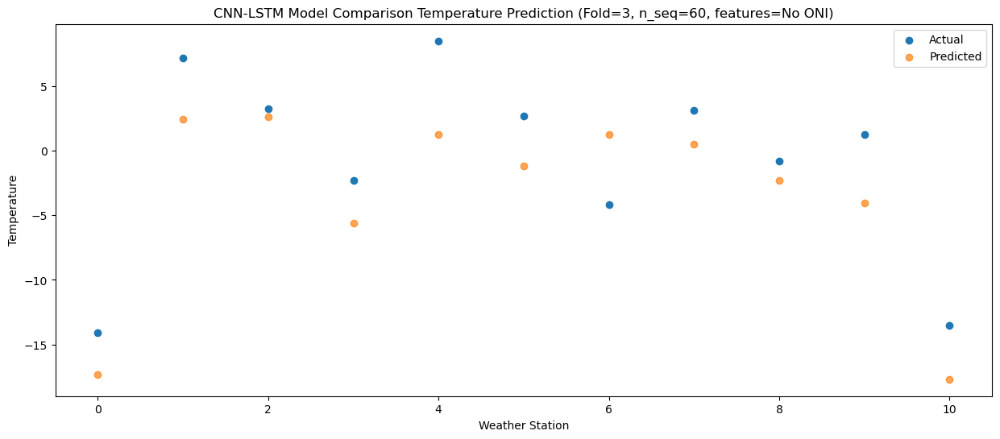

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0  -21.26 -25.677800
1                 1    0.61  -6.031261
2                 2    0.03  -3.289084
3                 3   -9.48 -14.234170
4                 4    1.33  -7.645507
5                 5   -4.94 -10.025774
6                 6   -9.87  -5.626926
7                 7   -2.57  -5.561547
8                 8   -2.84  -8.190284
9                 9   -5.11 -11.847124
10               10  -20.35 -25.786201


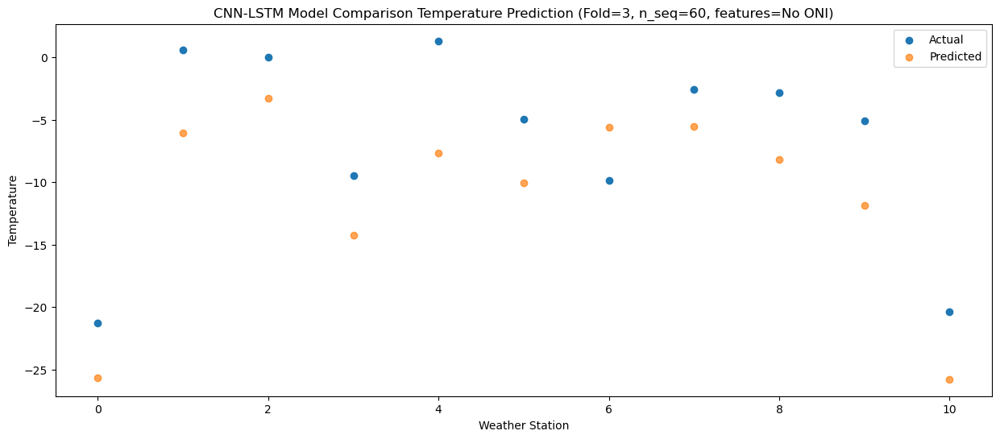

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -21.54 -26.104168
1                 1   -0.54  -6.410092
2                 2    1.29  -2.850267
3                 3  -10.94 -15.311184
4                 4   -0.14  -8.735048
5                 5   -6.39 -11.209059
6                 6   -9.60  -5.496781
7                 7   -2.02  -5.170029
8                 8   -1.62  -7.520435
9                 9   -8.13 -13.383620
10               10  -21.91 -27.361938


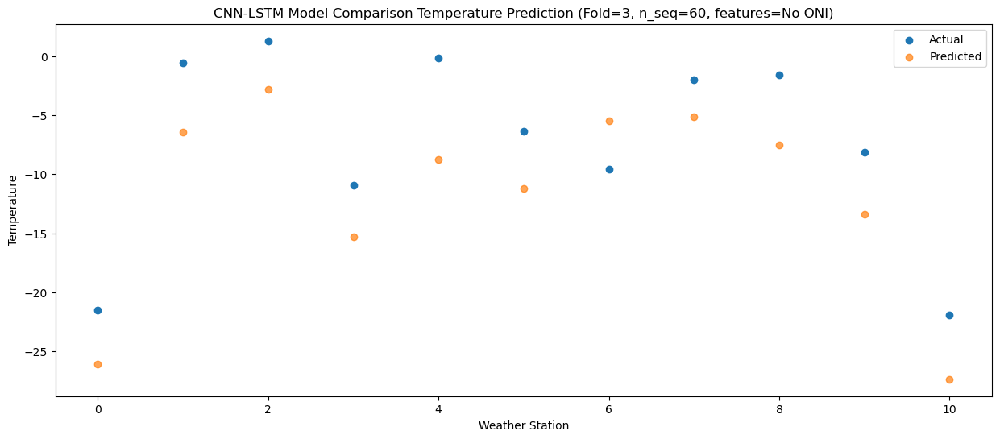

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -21.17 -25.678726
1                 1   -4.26  -9.522531
2                 2    3.59  -1.713685
3                 3  -12.26 -16.597427
4                 4   -4.01 -12.073471
5                 5   -9.11 -13.801097
6                 6   -9.50  -6.180170
7                 7    0.83  -5.004337
8                 8   -0.69  -5.534443
9                 9   -8.25 -13.456142
10               10  -22.71 -27.803004


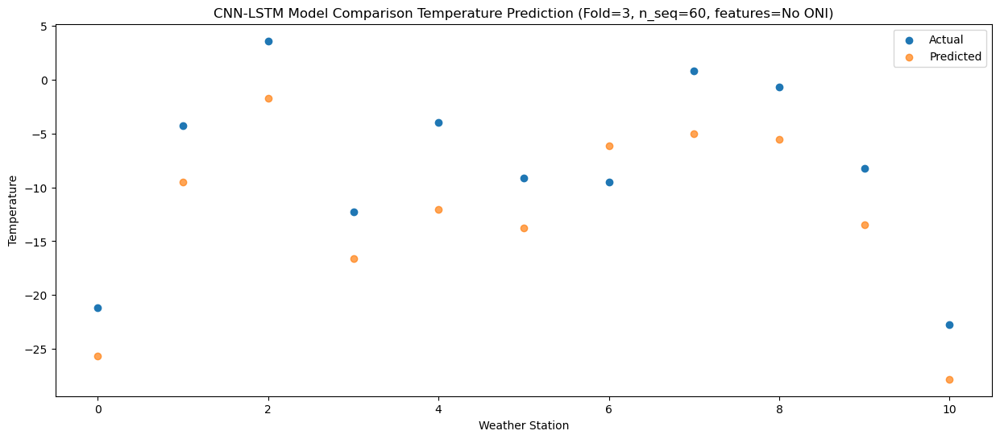

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0  -14.37 -21.149766
1                 1    7.71   0.460764
2                 2    4.74  -1.495781
3                 3   -2.05  -9.299304
4                 4    9.07  -1.623466
5                 5    2.22  -4.416898
6                 6   -6.53  -1.994743
7                 7    2.43  -3.142906
8                 8   -0.91  -6.522576
9                 9   -3.25  -9.091652
10               10  -15.52 -22.513888


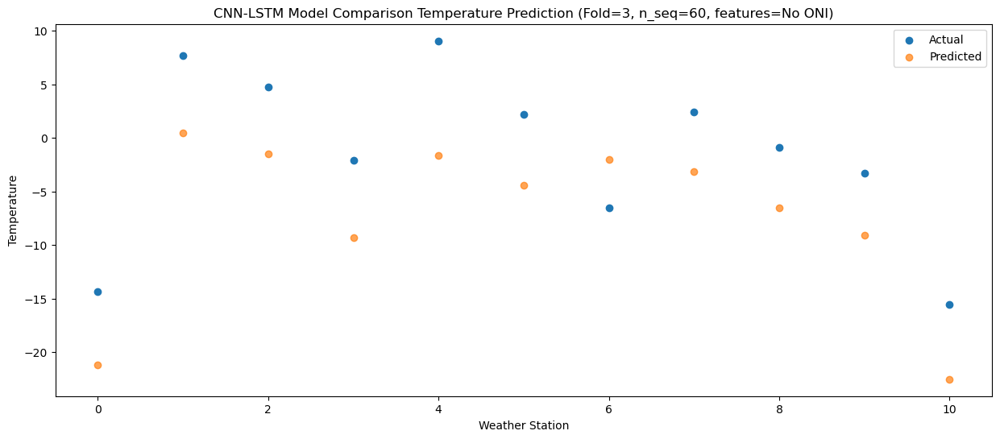

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0  -11.21 -18.851522
1                 1    9.57   2.427623
2                 2   10.47   2.170455
3                 3    0.30  -6.454497
4                 4   12.36   1.181584
5                 5    5.67  -1.534304
6                 6   -1.75   1.137136
7                 7   10.40   0.454617
8                 8    1.28  -3.154692
9                 9    1.37  -4.875004
10               10  -10.65 -18.539137


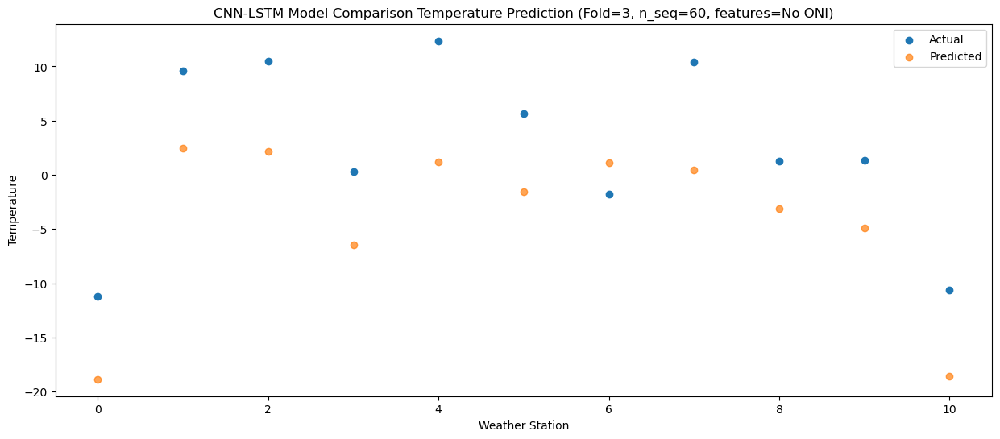

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   -7.55 -14.914747
1                 1   13.79   6.883681
2                 2   15.27   5.742366
3                 3    4.37  -2.159716
4                 4   16.93   5.869976
5                 5    9.95   3.008863
6                 6    3.30   5.164744
7                 7   14.83   4.222094
8                 8    5.57   0.187863
9                 9    6.20  -0.735565
10               10   -6.39 -14.325995


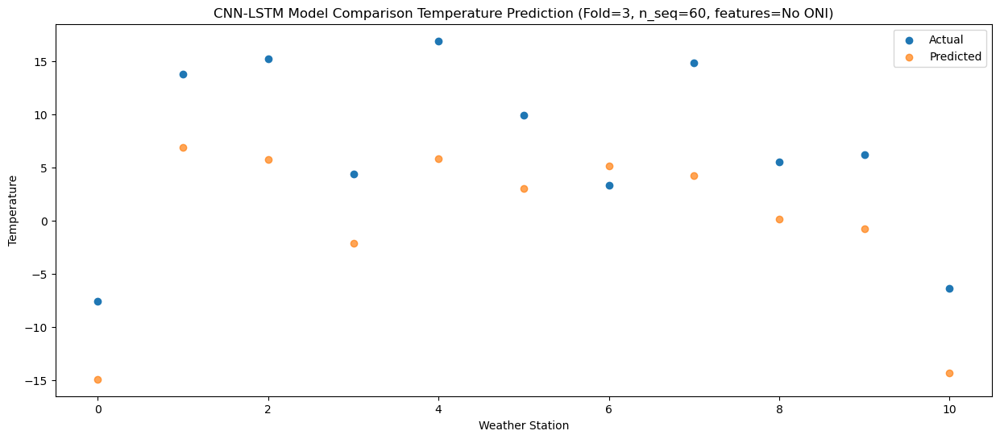

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   -3.49 -11.803680
1                 1   20.50  11.570251
2                 2   20.12  10.358140
3                 3   10.29   2.275295
4                 4   24.41  11.362931
5                 5   16.66   8.155605
6                 6   10.69  10.056457
7                 7   22.47   9.255627
8                 8    7.27   4.056356
9                 9   12.07   4.286902
10               10   -0.22  -9.370437


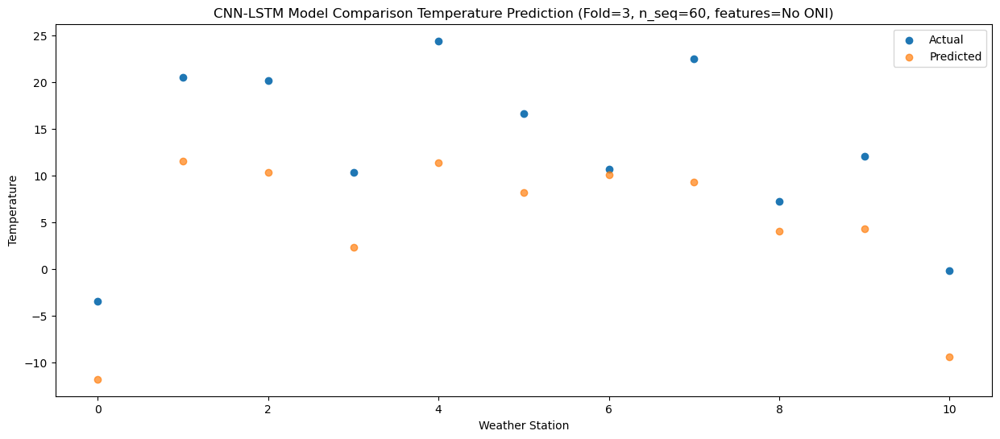

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   -1.78 -11.275116
1                 1   21.81  11.963523
2                 2   23.25  11.163381
3                 3   11.28   2.647538
4                 4   24.41  11.596043
5                 5   17.04   8.411867
6                 6   12.53  10.772827
7                 7   23.55  10.055638
8                 8    6.45   4.868023
9                 9   14.21   4.725414
10               10    1.42  -8.957039


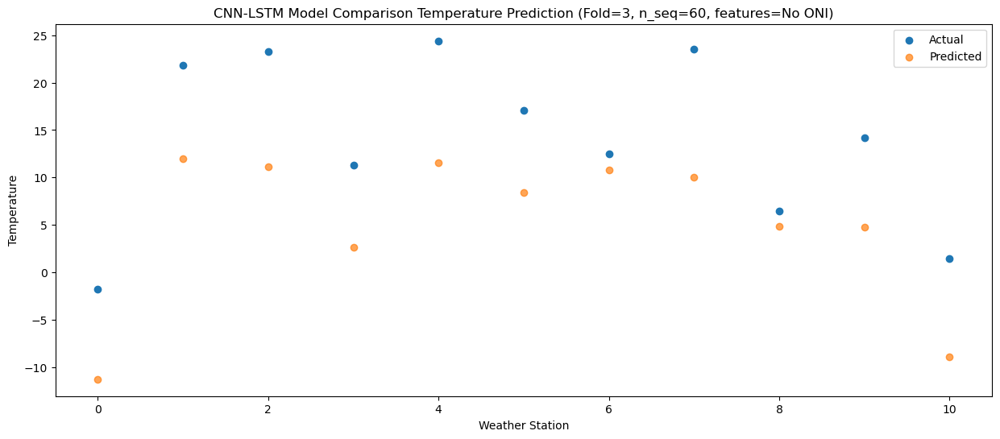

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   -1.56 -10.501609
1                 1   22.38  12.832609
2                 2   21.05  10.173022
3                 3   11.80   3.578448
4                 4   24.53  12.473864
5                 5   17.36   9.359112
6                 6   10.61  10.435065
7                 7   22.32   9.161303
8                 8    7.00   3.862996
9                 9   14.83   5.302800
10               10    1.15  -8.226391


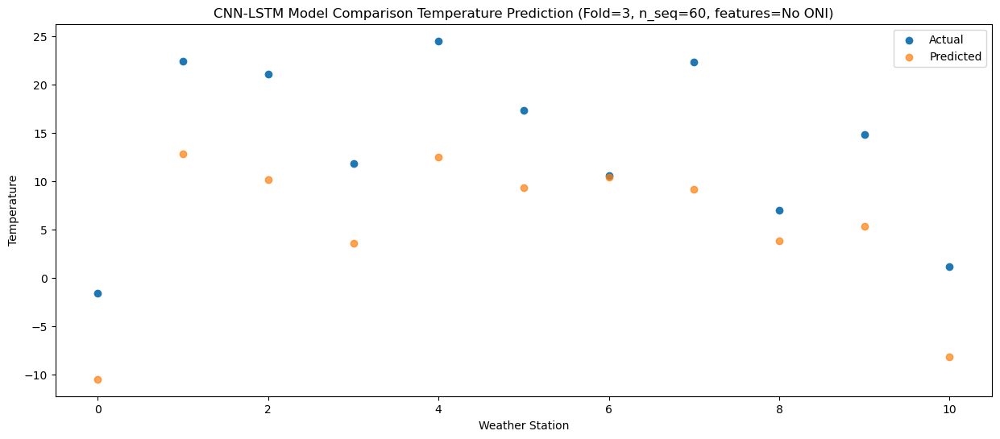

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   -5.55 -14.187590
1                 1   19.65   9.491522
2                 2   17.74   6.994674
3                 3    7.67  -0.554113
4                 4   21.17   8.429676
5                 5   14.10   5.215108
6                 6    8.74   7.126629
7                 7   18.35   5.961753
8                 8    6.45   0.905336
9                 9   11.51   0.665409
10               10   -3.11 -12.864582


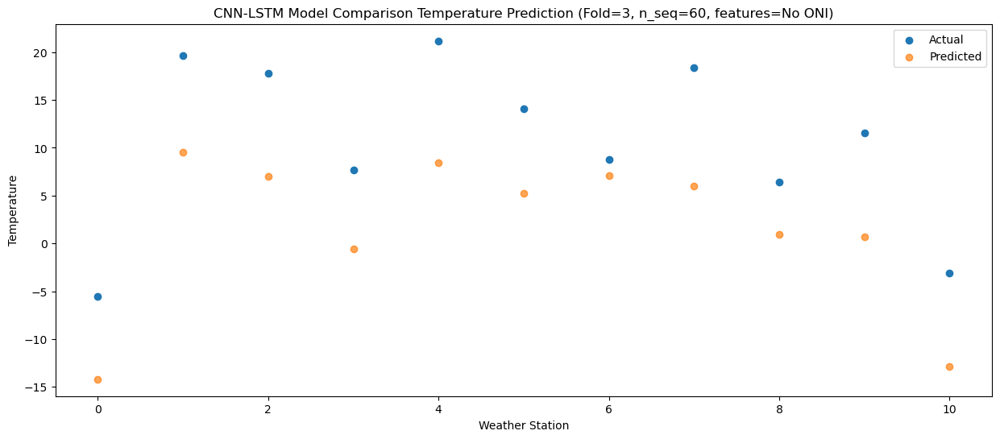

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   -8.78 -17.245134
1                 1   13.05   4.697254
2                 2    9.08   1.456826
3                 3    4.09  -4.210358
4                 4   15.75   3.734754
5                 5    9.52   1.008558
6                 6    0.77   1.628551
7                 7    8.00   0.007536
8                 8    3.69  -4.086391
9                 9    7.07  -3.238931
10               10   -7.23 -16.647483


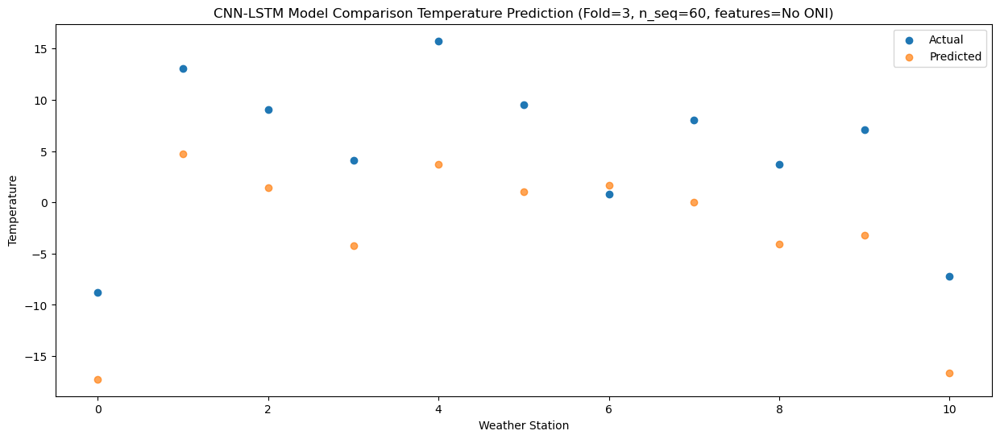

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0  -17.54 -26.687138
1                 1    5.34  -4.655665
2                 2    4.74  -3.046883
3                 3   -5.57 -14.554300
4                 4    6.01  -6.730009
5                 5   -1.33  -9.623530
6                 6   -1.97  -4.647058
7                 7    5.48  -4.755655
8                 8    0.87  -8.424455
9                 9   -1.85 -12.810805
10               10  -17.45 -26.690332


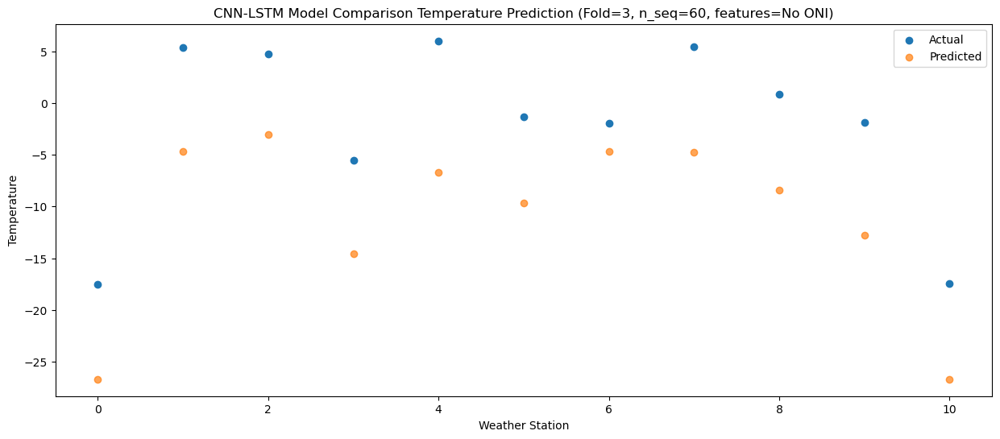

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0  -15.58 -25.069090
1                 1    6.65  -3.390407
2                 2    0.82  -7.047463
3                 3   -4.08 -13.724283
4                 4    5.65  -6.575217
5                 5   -0.28  -9.152651
6                 6   -6.73  -7.005600
7                 7   -1.79  -8.743454
8                 8   -2.83 -11.713753
9                 9   -3.45 -14.506480
10               10  -17.86 -27.763351


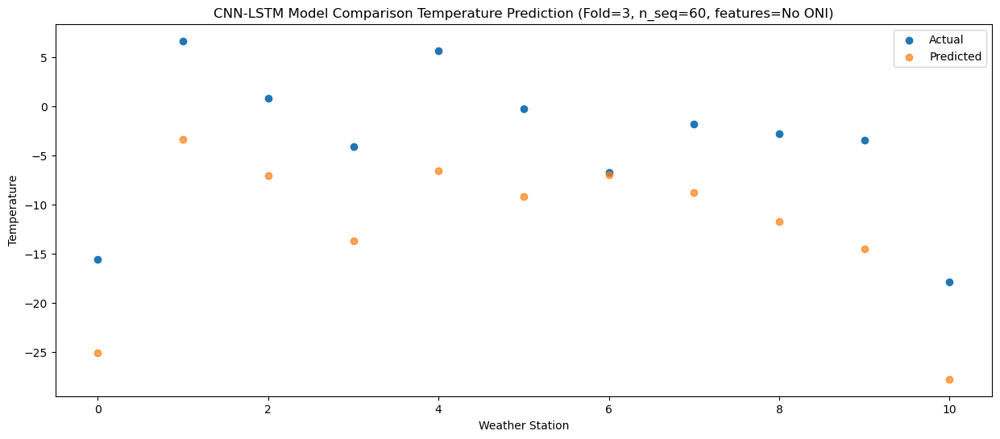

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -22.42 -31.940149
1                 1   -2.18 -11.715724
2                 2    0.49  -8.376917
3                 3  -13.03 -21.742706
4                 4   -3.82 -15.285768
5                 5   -9.10 -17.777729
6                 6   -9.02 -10.894280
7                 7   -1.86 -10.728199
8                 8   -2.21 -12.748571
9                 9  -10.00 -20.775591
10               10  -24.84 -34.698831


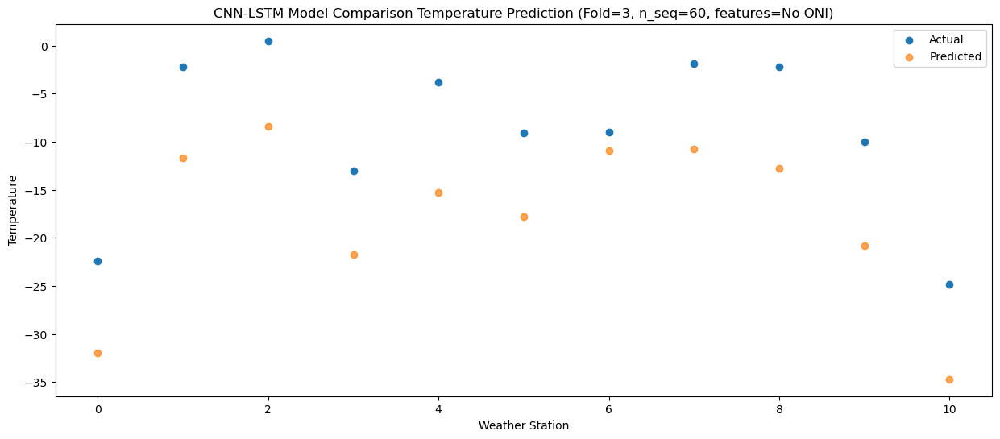

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0  -18.04 -28.626764
1                 1   -0.96 -10.176927
2                 2    2.19  -7.301277
3                 3   -8.51 -18.417346
4                 4   -1.30 -12.751550
5                 5   -5.91 -14.817585
6                 6  -10.74  -9.748317
7                 7    0.18  -9.956273
8                 8   -1.25 -11.545725
9                 9   -7.24 -16.857012
10               10  -21.03 -30.739989


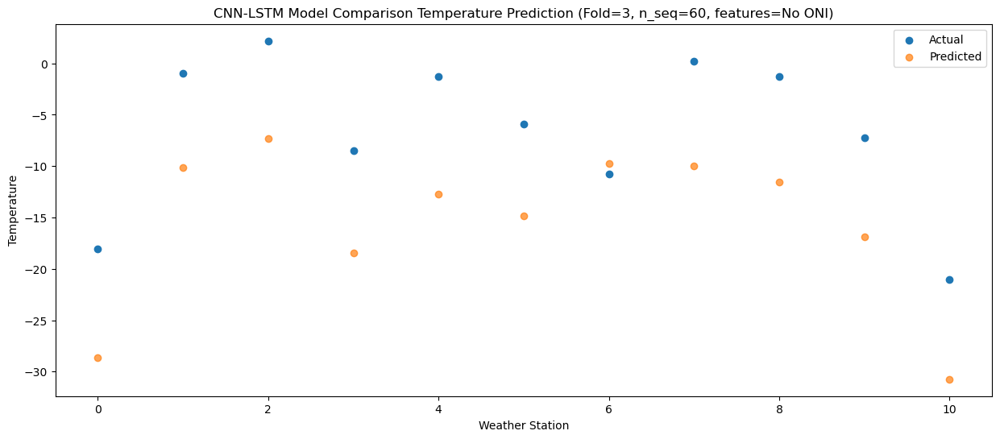

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0  -13.98 -24.809802
1                 1    5.82  -3.951079
2                 2    6.90  -4.086656
3                 3   -2.76 -13.458021
4                 4    7.16  -6.392453
5                 5    1.05  -8.965957
6                 6   -6.20  -5.221651
7                 7    4.89  -6.067719
8                 8    0.98  -8.899964
9                 9   -3.28 -12.843330
10               10  -15.85 -26.455111


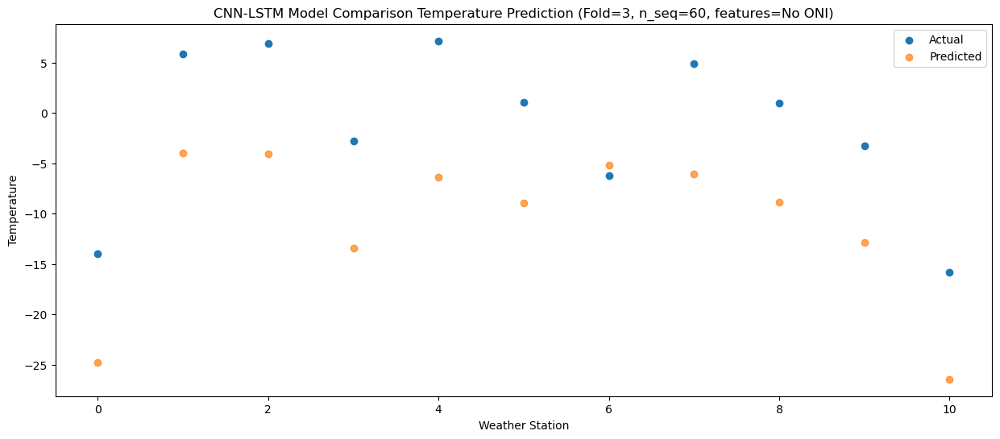

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0  -10.88 -21.762454
1                 1   10.67   1.017429
2                 2    9.97  -1.801660
3                 3    0.25  -9.734271
4                 4   11.29  -1.960209
5                 5    4.90  -4.814523
6                 6   -1.88  -1.778884
7                 7    9.52  -3.190805
8                 8    2.42  -7.000470
9                 9    1.01  -9.900863
10               10  -12.03 -23.266534


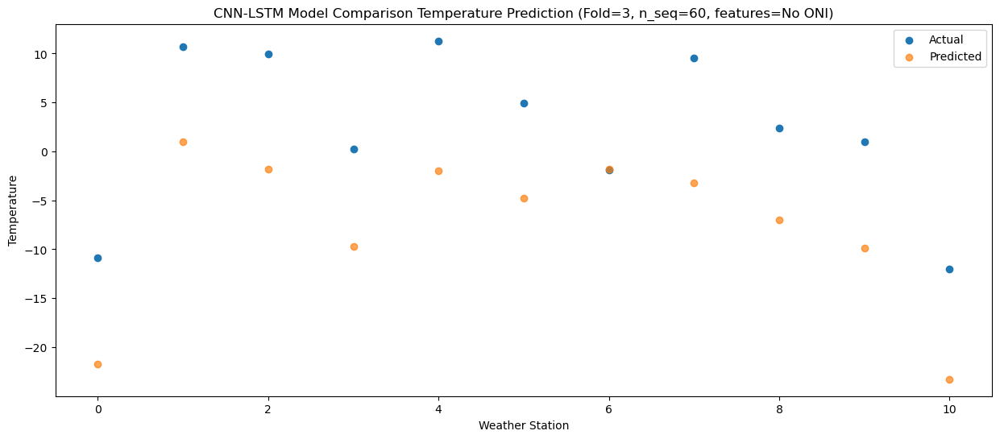

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   -6.04 -16.796122
1                 1   16.10   6.713766
2                 2   14.21   0.666662
3                 3    7.03  -3.377274
4                 4   18.86   5.067829
5                 5   12.70   2.141748
6                 6    4.03   1.995166
7                 7   14.19  -0.340948
8                 8    5.41  -5.086165
9                 9    6.80  -3.604045
10               10   -5.25 -16.707000


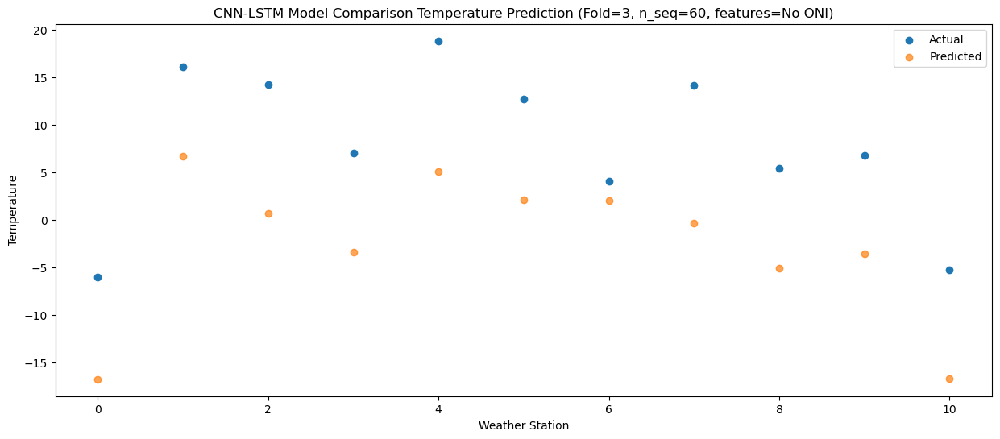

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   -2.08 -14.402775
1                 1   21.25  10.444362
2                 2   19.60   4.150919
3                 3   10.51  -0.319928
4                 4   24.31   8.900741
5                 5   16.64   5.662498
6                 6    9.80   5.774617
7                 7   20.67   3.512937
8                 8    8.56  -2.044380
9                 9   11.12  -0.530875
10               10   -1.26 -13.639459


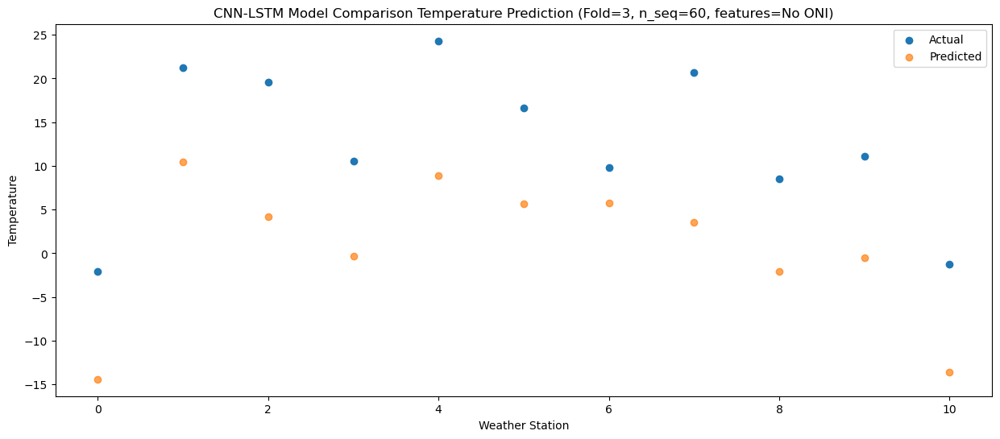

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   -1.31 -14.010568
1                 1   25.29  11.319922
2                 2   22.17   6.982437
3                 3   12.06   0.492630
4                 4   25.43   9.771255
5                 5   18.63   6.475949
6                 6   11.72   8.066848
7                 7   22.90   6.476940
8                 8    6.91   0.363729
9                 9   15.67   1.516424
10               10    2.52 -11.869338


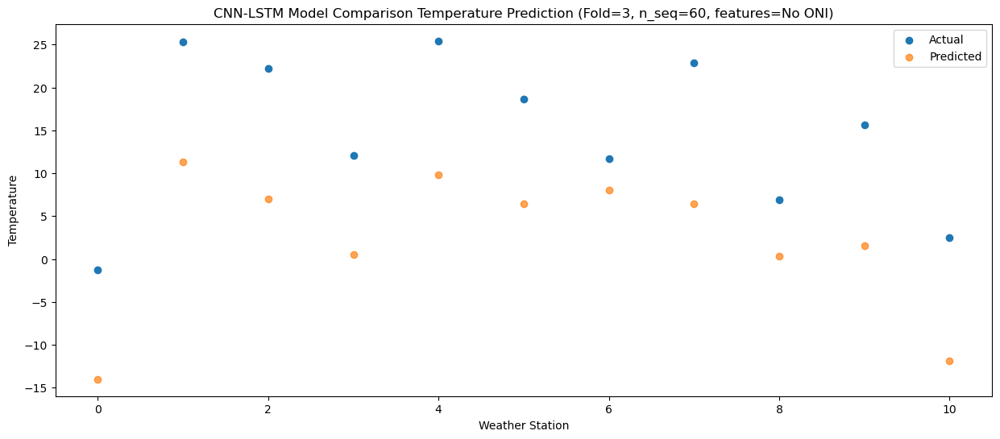

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   -2.22 -14.899903
1                 1   22.21   9.257149
2                 2   22.35   7.201820
3                 3   10.99  -0.647668
4                 4   23.61   8.125144
5                 5   16.98   5.038046
6                 6   10.96   7.419307
7                 7   21.31   6.350105
8                 8    8.33   0.679596
9                 9   15.59   1.330576
10               10    1.65 -12.278360


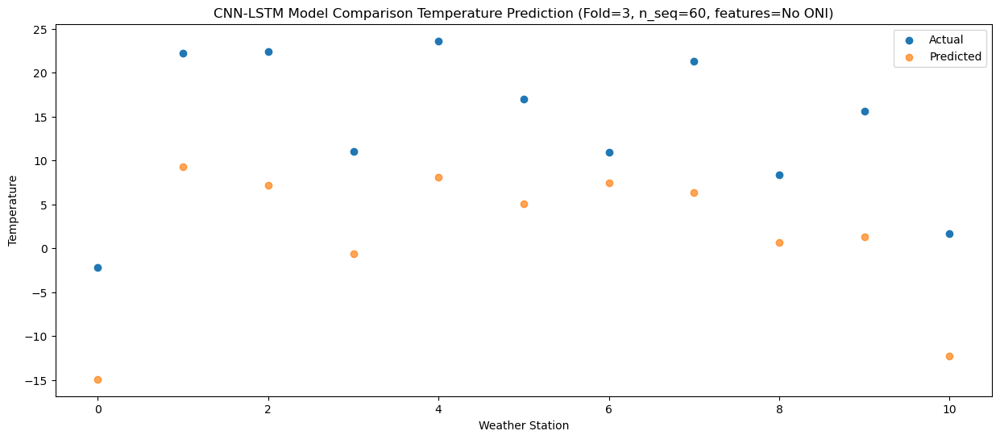

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   -5.43 -18.023415
1                 1   18.35   6.067774
2                 2   19.53   3.881710
3                 3    7.01  -4.370924
4                 4   19.29   4.385985
5                 5   13.03   1.238958
6                 6    8.80   4.094113
7                 7   18.95   2.952874
8                 8    8.56  -2.294571
9                 9   10.68  -3.193952
10               10   -3.58 -16.713316


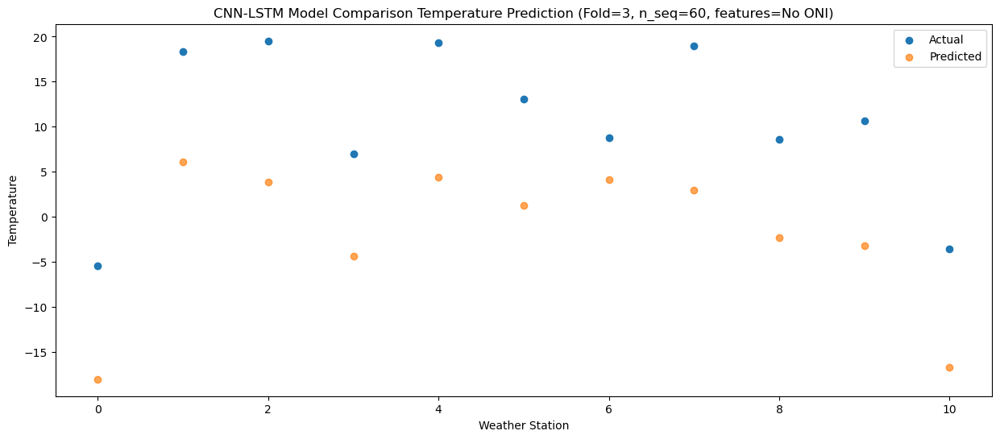

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0  -12.44 -24.373814
1                 1   11.80  -1.177849
2                 2   12.35  -2.570943
3                 3   -0.26 -11.321676
4                 4   12.02  -3.112312
5                 5    6.99  -6.060677
6                 6    0.54  -2.781107
7                 7   11.06  -3.804656
8                 8    3.83  -8.381679
9                 9    4.42 -10.048399
10               10  -11.19 -23.632517


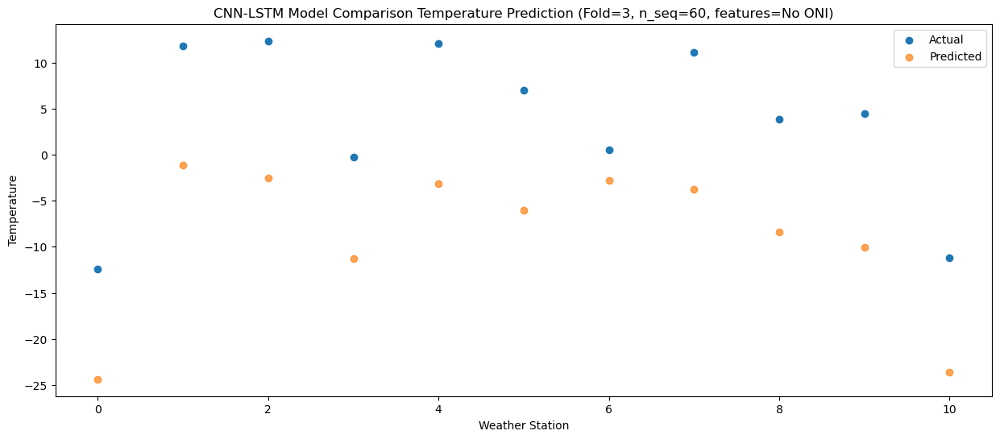

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0  -14.47 -25.791379
1                 1    4.57  -6.165340
2                 2    1.62  -8.531448
3                 3   -3.38 -13.865792
4                 4    6.13  -7.465365
5                 5    0.44  -9.579296
6                 6   -7.14  -8.773082
7                 7   -0.36 -10.536878
8                 8   -1.90 -13.490686
9                 9    0.46 -12.596745
10               10  -14.31 -26.029924


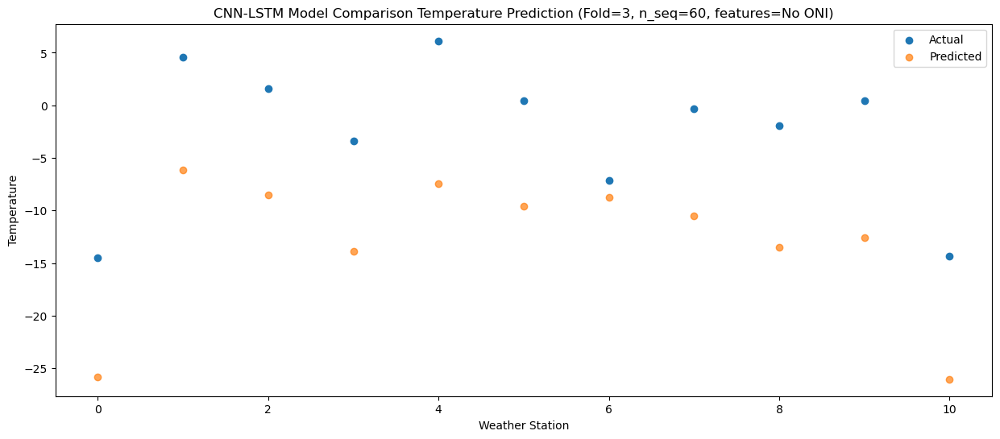

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0  -21.35 -31.805776
1                 1    0.52 -11.392839
2                 2    0.66 -12.805423
3                 3   -8.65 -20.638315
4                 4    0.16 -14.261283
5                 5   -5.10 -16.505558
6                 6   -9.31 -13.441364
7                 7   -2.69 -14.800006
8                 8   -3.10 -17.436386
9                 9   -5.90 -20.173004
10               10  -21.34 -33.639849


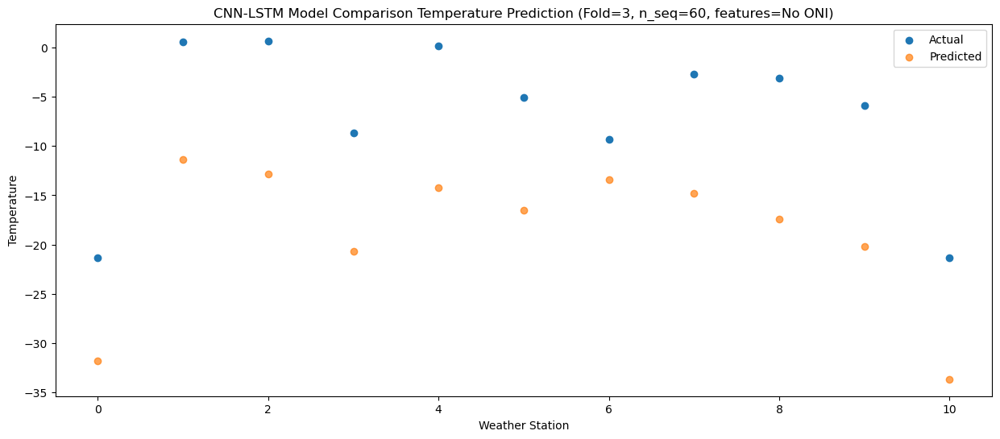

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0  -17.93 -30.331470
1                 1    1.22 -10.338259
2                 2    2.05 -12.267592
3                 3   -6.90 -19.042100
4                 4    1.88 -12.913280
5                 5   -2.96 -15.009758
6                 6  -10.04 -12.739942
7                 7   -3.20 -14.293183
8                 8   -1.43 -16.923529
9                 9   -3.92 -18.447613
10               10  -18.69 -31.872417


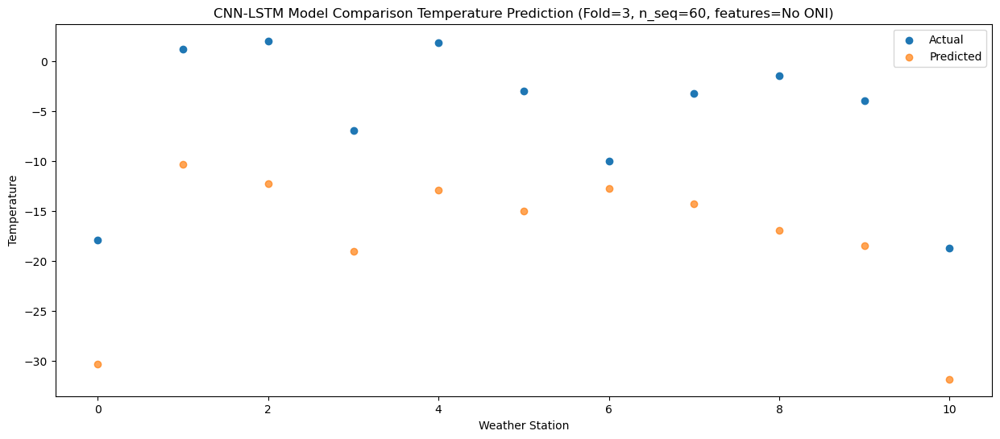

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0  -15.11 -28.314493
1                 1    3.18  -8.276106
2                 2    1.20 -11.909547
3                 3   -4.56 -17.399669
4                 4    8.40 -11.225266
5                 5   -1.24 -13.365281
6                 6  -10.01 -11.766004
7                 7   -2.29 -13.845350
8                 8   -3.23 -16.359005
9                 9   -5.65 -17.964149
10               10  -18.48 -31.153915


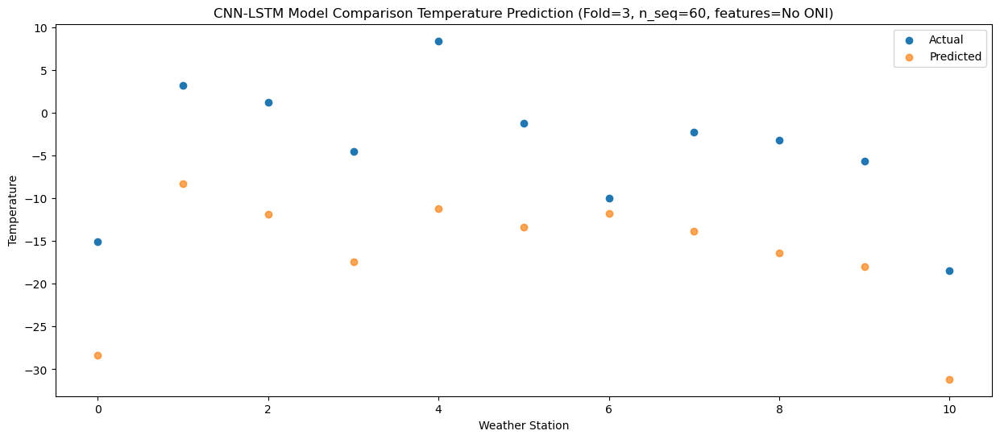

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0  -14.64 -27.790620
1                 1    5.78  -6.036528
2                 2    4.07  -9.731295
3                 3   -4.32 -16.551901
4                 4    5.44  -9.647005
5                 5   -0.34 -12.148827
6                 6   -8.22  -9.416779
7                 7    0.54 -11.286995
8                 8   -1.77 -14.477763
9                 9   -3.68 -17.393488
10               10  -16.92 -30.609213


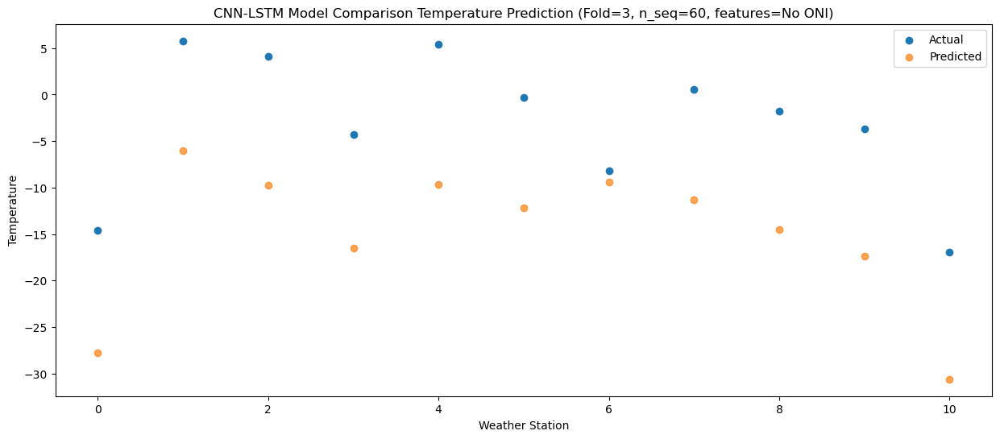

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0  -10.97 -23.738635
1                 1   10.83  -1.599387
2                 2    9.70  -5.404501
3                 3    1.92 -10.903727
4                 4   12.65  -3.432075
5                 5    5.89  -6.001891
6                 6   -2.88  -4.762690
7                 7    8.49  -6.639387
8                 8    2.31 -11.045645
9                 9    2.37 -10.283430
10               10   -9.35 -23.595341


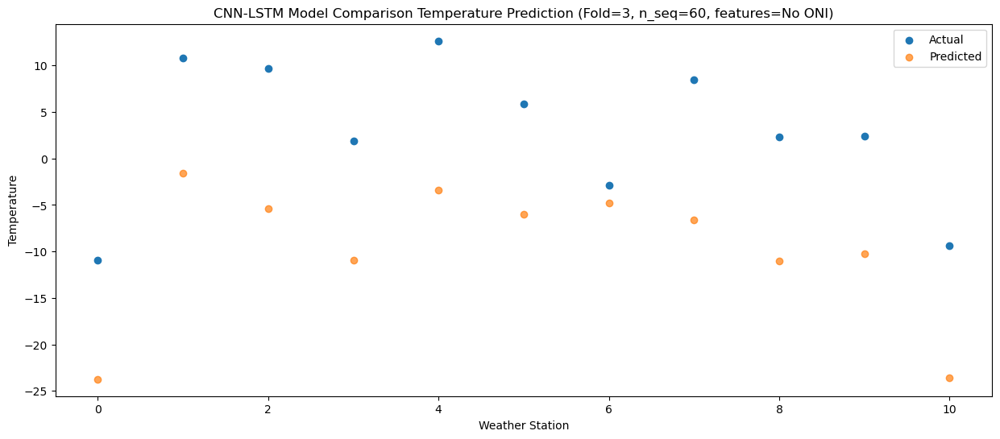

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   -8.61 -22.300767
1                 1   16.14   2.554697
2                 2   14.14  -2.360769
3                 3    4.61  -8.458854
4                 4   18.65   0.616279
5                 5   11.30  -2.599968
6                 6    4.33  -1.089963
7                 7   14.29  -2.974229
8                 8    3.34  -8.611513
9                 9    6.01  -8.511369
10               10   -6.88 -21.738260


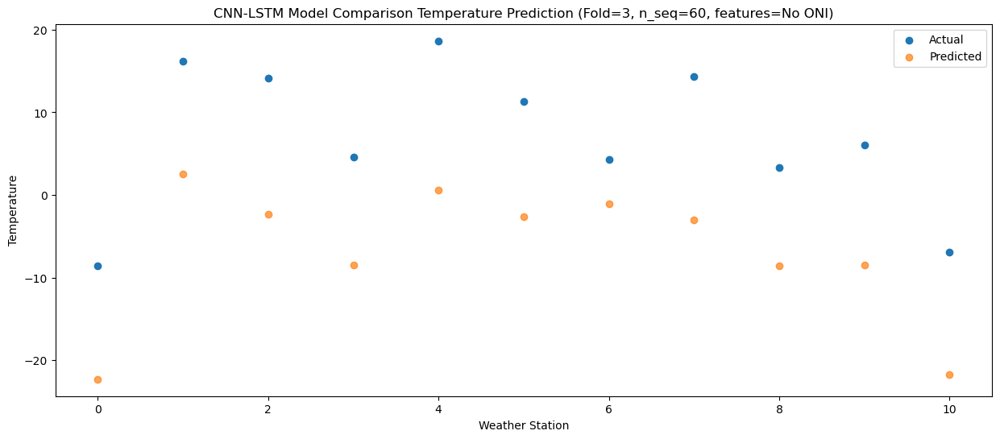

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   -4.84 -19.272392
1                 1   20.47   6.109198
2                 2   16.94  -0.586974
3                 3    8.35  -5.098228
4                 4   22.75   4.296909
5                 5   14.76   0.985519
6                 6    8.91   1.397993
7                 7   16.79  -0.979374
8                 8    5.24  -6.961510
9                 9   10.00  -5.599231
10               10   -2.95 -18.648145


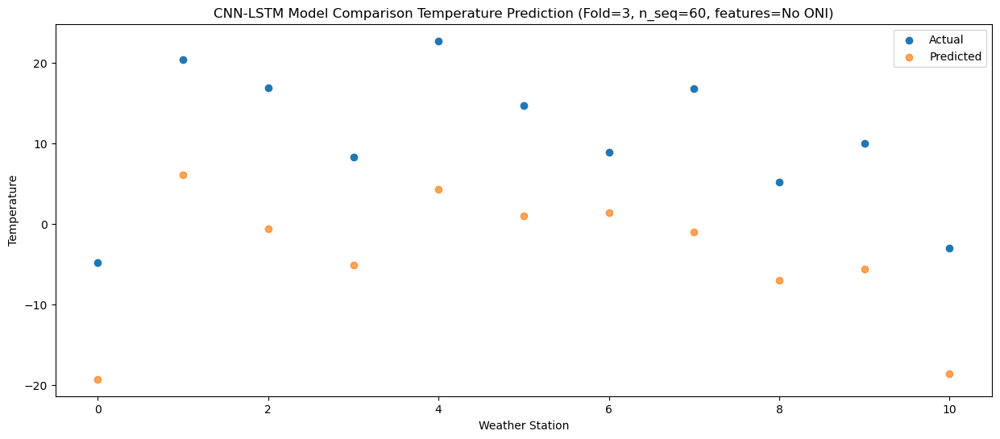

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   -1.06 -16.415908
1                 1   22.73   7.792577
2                 2   22.60   3.866718
3                 3   11.97  -2.419242
4                 4   24.45   6.167461
5                 5   18.02   3.162748
6                 6   15.05   4.814020
7                 7   25.15   3.176386
8                 8    8.25  -2.547716
9                 9   15.68  -1.274792
10               10    1.89 -14.687321


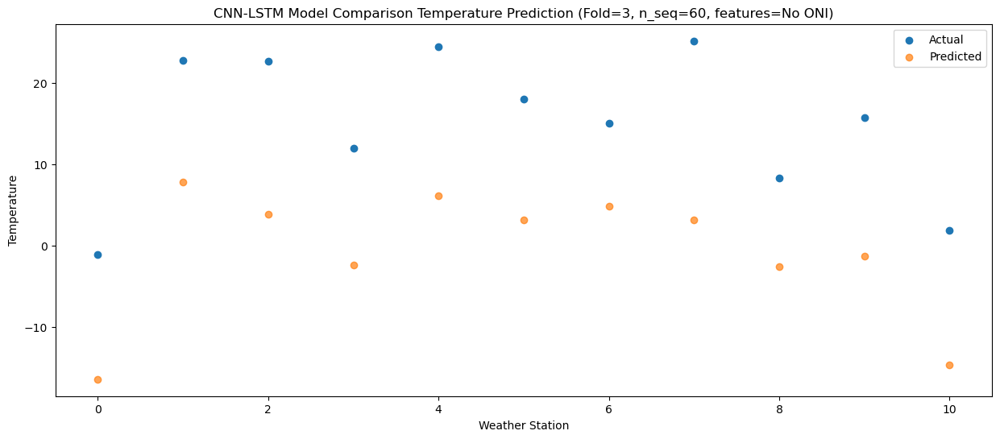

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   -1.57 -16.964793
1                 1   22.91   8.422105
2                 2   20.91   3.620208
3                 3   10.86  -3.340993
4                 4   23.16   5.767225
5                 5   16.47   2.455262
6                 6   12.46   4.835024
7                 7   20.52   3.113685
8                 8    9.28  -2.633211
9                 9   13.43  -3.450872
10               10   -0.08 -16.731168


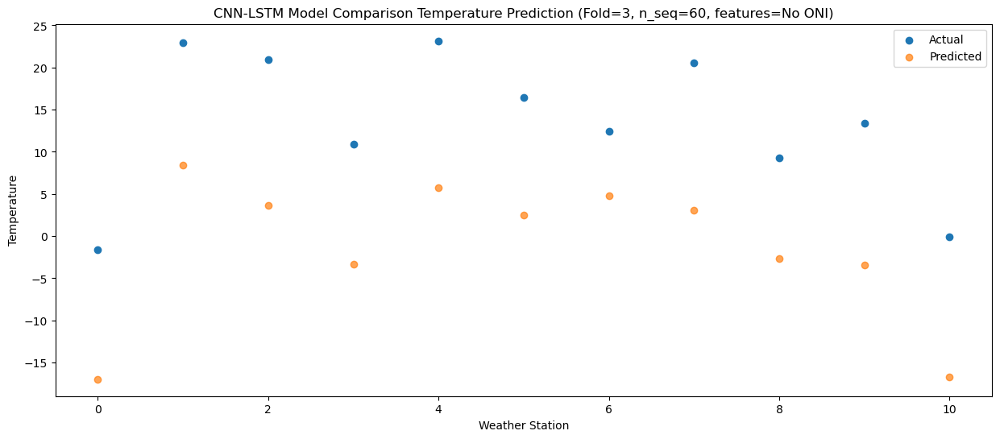

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   -5.71 -20.107806
1                 1   18.86   4.880429
2                 2   17.14  -0.462502
3                 3    8.13  -6.337275
4                 4   19.80   2.699701
5                 5   13.01  -0.530249
6                 6    8.31   0.928917
7                 7   15.82  -1.036059
8                 8    6.67  -6.679118
9                 9   10.86  -6.479939
10               10   -3.37 -19.682547


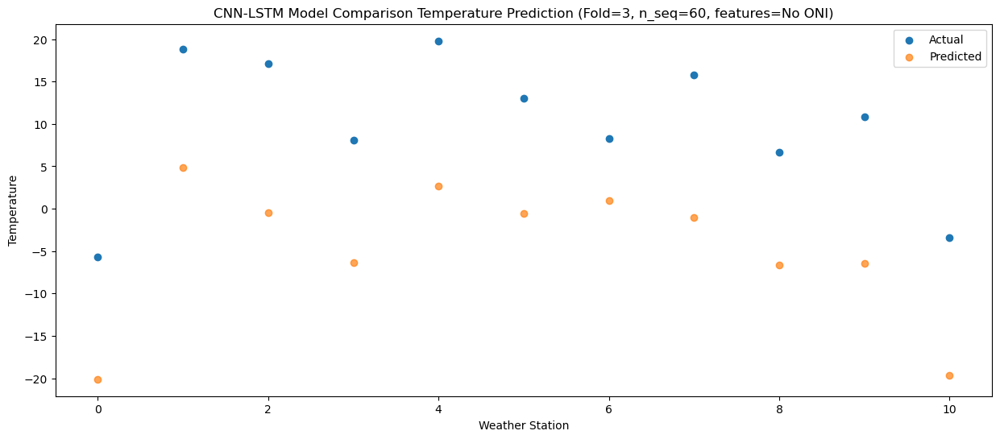

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0  -10.74 -24.866654
1                 1   11.92  -2.064955
2                 2   11.83  -5.701882
3                 3    2.69 -11.665797
4                 4   13.34  -3.675621
5                 5    7.36  -6.440781
6                 6    2.18  -5.091727
7                 7   10.53  -6.817918
8                 8    5.21 -11.518785
9                 9    5.43 -11.000202
10               10   -8.66 -24.362025


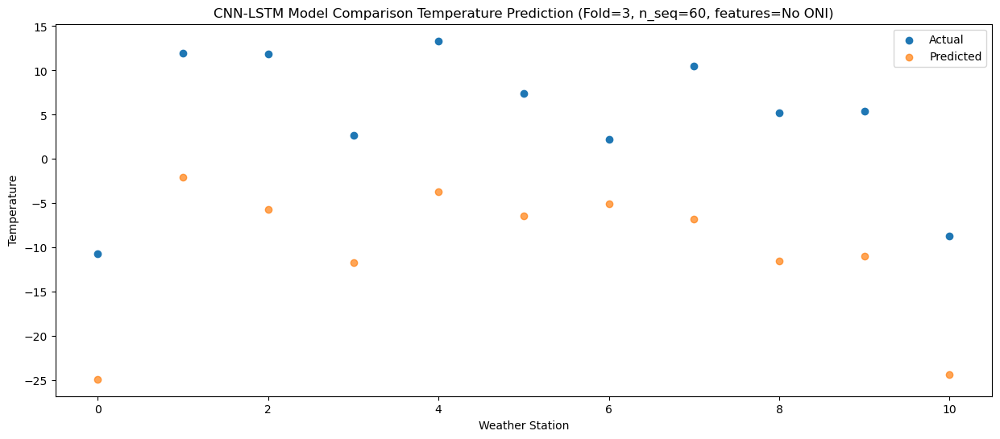

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0  -16.40 -31.432818
1                 1    6.14  -8.969526
2                 2    4.92 -11.703846
3                 3   -3.70 -19.022459
4                 4    6.39 -11.279201
5                 5    0.88 -14.046795
6                 6   -3.68 -11.464075
7                 7    2.39 -12.985969
8                 8    1.17 -17.182153
9                 9   -2.42 -18.702205
10               10  -16.93 -32.112665


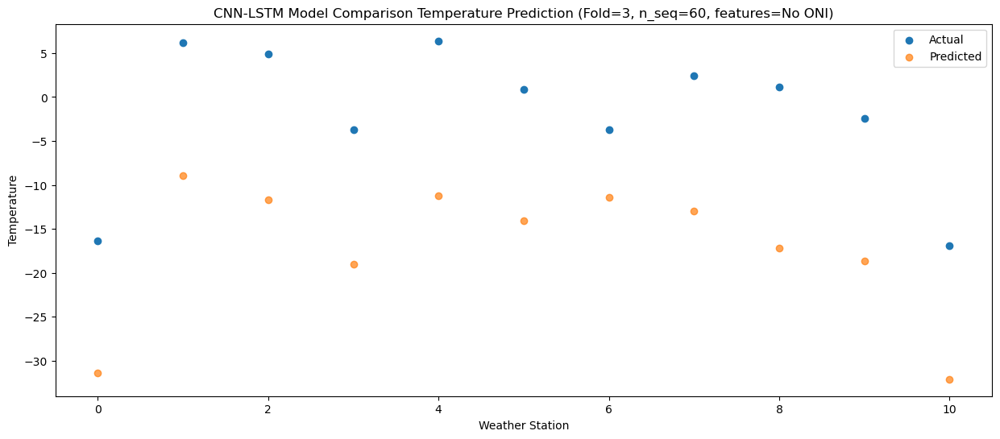

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0  -18.45 -33.329607
1                 1    2.79 -11.819123
2                 2    3.08 -14.101880
3                 3   -5.53 -20.759458
4                 4    3.58 -13.510391
5                 5   -1.58 -16.011574
6                 6   -7.31 -14.080899
7                 7   -0.74 -15.582362
8                 8   -0.67 -19.609775
9                 9   -3.15 -19.609568
10               10  -17.68 -33.101274


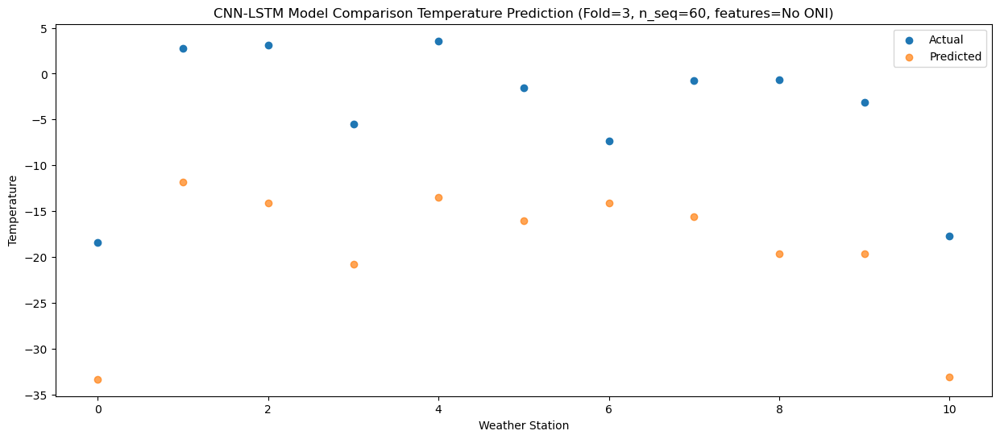

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -20.76 -36.155846
1                 1   -3.82 -17.373468
2                 2    2.87 -15.335875
3                 3  -10.69 -25.197582
4                 4   -2.92 -19.641277
5                 5   -7.74 -21.601596
6                 6   -9.45 -17.076918
7                 7   -2.46 -17.596872
8                 8   -0.36 -20.159523
9                 9   -7.14 -23.001791
10               10  -20.70 -36.874918


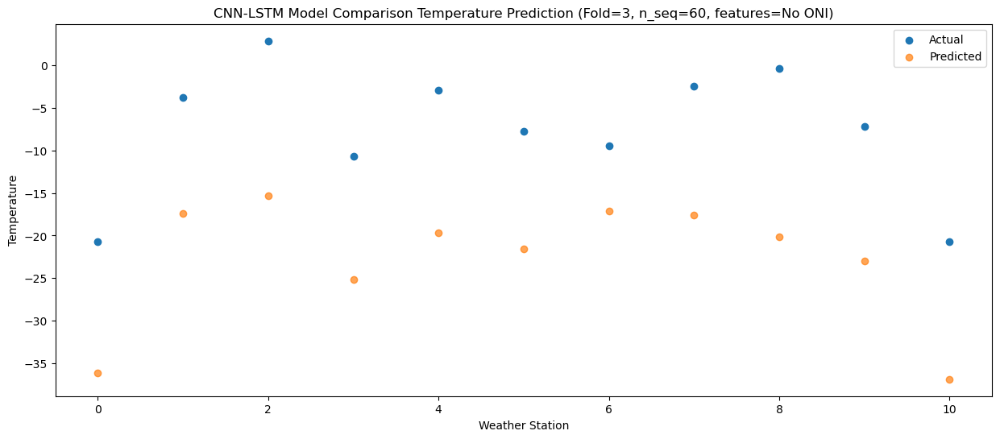

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0  -17.62 -34.709818
1                 1    5.83 -11.080341
2                 2    4.36 -15.245239
3                 3   -5.01 -22.392250
4                 4    4.89 -14.371836
5                 5   -1.11 -17.328433
6                 6   -7.29 -14.393011
7                 7   -0.10 -16.201396
8                 8   -0.65 -20.748751
9                 9   -6.57 -23.122859
10               10  -18.66 -36.371757


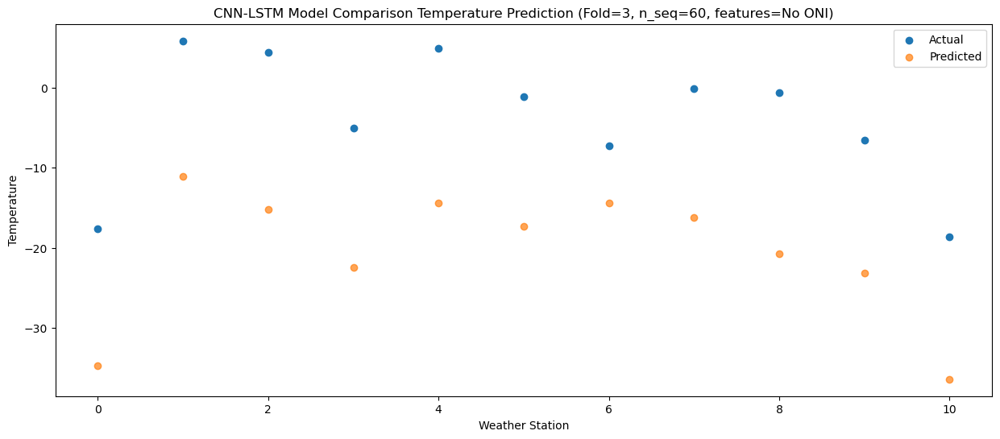

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0  -13.95 -30.885604
1                 1    8.31  -8.193732
2                 2    6.39 -13.025791
3                 3   -1.36 -18.730732
4                 4    9.00 -11.202968
5                 5    2.96 -13.923997
6                 6   -5.55 -11.971296
7                 7    3.26 -14.088064
8                 8    0.28 -18.418278
9                 9   -1.87 -19.377630
10               10  -14.00 -32.559812


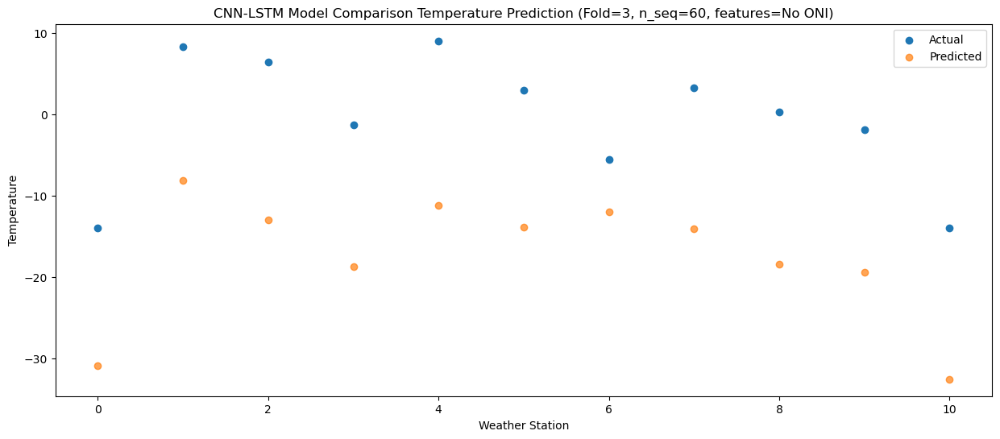

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -9.93 -27.769606
1                 1   12.48  -3.796157
2                 2    9.58 -10.301336
3                 3    3.70 -14.678396
4                 4   13.75  -6.387220
5                 5    7.93  -9.344819
6                 6   -0.57  -8.439281
7                 7    8.76 -10.920419
8                 8    2.51 -16.185553
9                 9    1.00 -15.456431
10               10   -9.42 -28.513217


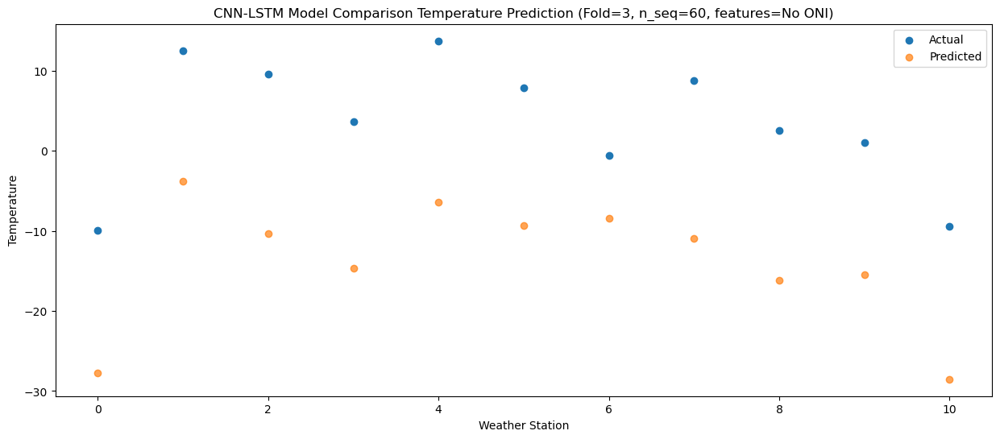

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   -5.66 -23.297564
1                 1   17.25   0.493491
2                 2   14.97  -7.582288
3                 3    7.89  -9.675362
4                 4   19.91  -1.322139
5                 5   13.45  -4.189731
6                 6    2.54  -5.128817
7                 7   14.39  -8.129146
8                 8    5.48 -13.646993
9                 9    6.55 -10.370185
10               10   -3.75 -23.301011


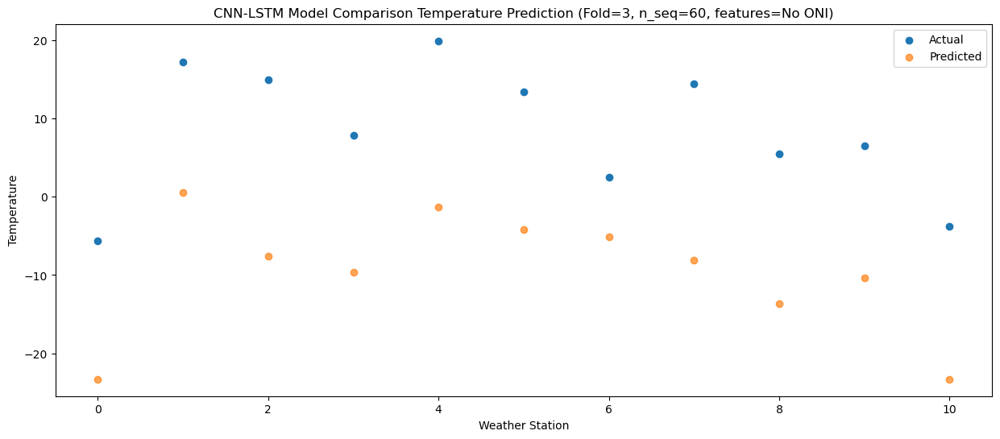

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   -2.00 -20.712755
1                 1   21.81   4.043324
2                 2   20.92  -3.028814
3                 3   11.79  -6.390521
4                 4   24.78   2.439542
5                 5   16.68  -0.635294
6                 6   11.69  -0.708009
7                 7   22.57  -3.273558
8                 8    8.39  -9.632323
9                 9   13.02  -6.215917
10               10    1.62 -19.308541


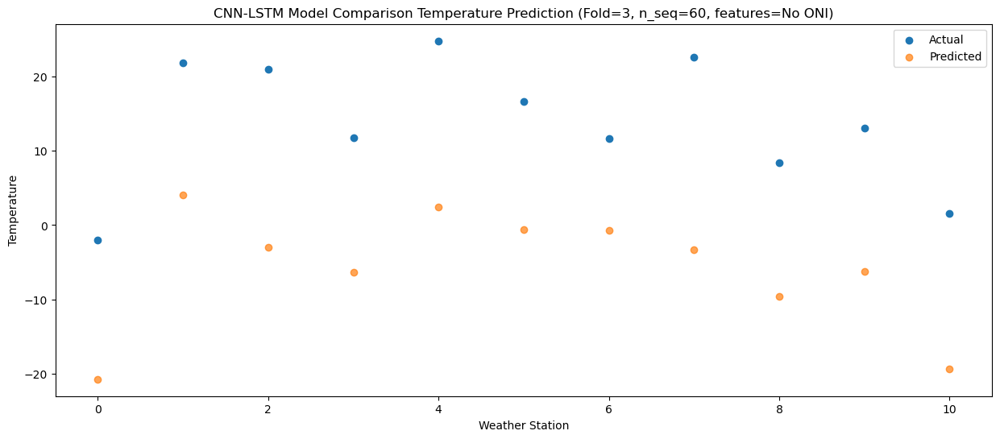

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   -1.11 -20.713941
1                 1   22.33   3.041001
2                 2   24.49  -0.588738
3                 3   13.50  -6.606649
4                 4   23.94   1.788490
5                 5   17.23  -1.161735
6                 6   12.44   0.484442
7                 7   25.65  -1.142787
8                 8    9.65  -7.261751
9                 9   15.58  -4.926871
10               10    4.28 -18.395812


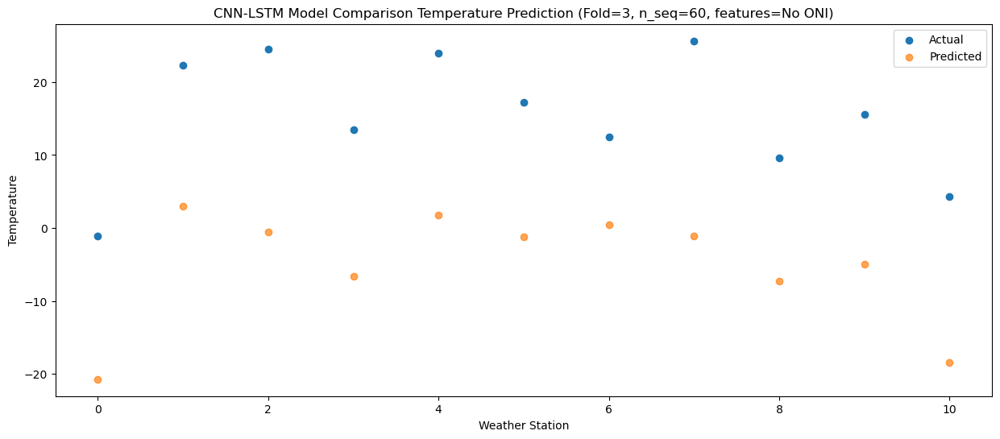

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   -2.51 -22.302880
1                 1   22.61   3.101122
2                 2   21.52  -2.914812
3                 3   12.48  -8.250321
4                 4   23.39   0.859738
5                 5   16.68  -2.423589
6                 6   12.15  -0.921438
7                 7   22.79  -3.080381
8                 8    8.37  -9.525476
9                 9   13.86  -8.228454
10               10    1.14 -21.412389


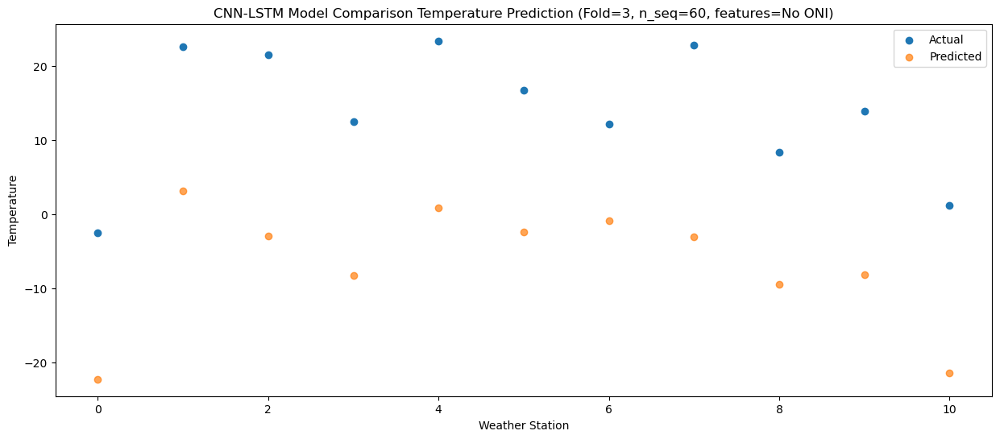

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   -5.20 -24.797780
1                 1   18.57  -0.285958
2                 2   18.49  -5.578300
3                 3    9.51 -10.938397
4                 4   20.13  -2.083122
5                 5   13.99  -5.230354
6                 6    8.53  -3.898675
7                 7   18.84  -5.972567
8                 8    6.93 -12.038753
9                 9    9.85 -10.667784
10               10   -2.45 -23.898607


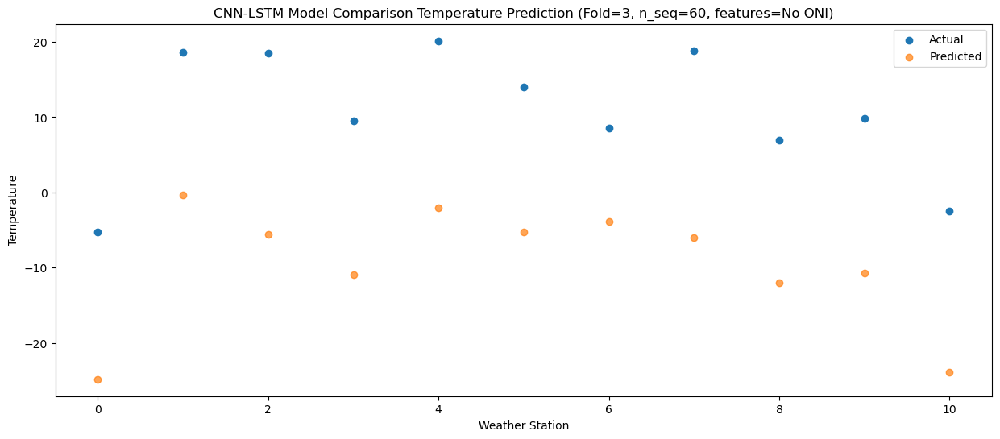

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0  -10.51 -30.010699
1                 1   15.18  -5.069787
2                 2   13.46 -10.909714
3                 3    3.01 -16.664010
4                 4   14.50  -7.862747
5                 5    8.11 -11.068514
6                 6    4.30  -9.094290
7                 7   12.95 -11.280834
8                 8    6.47 -17.087146
9                 9    5.32 -17.172247
10               10   -7.69 -30.317143


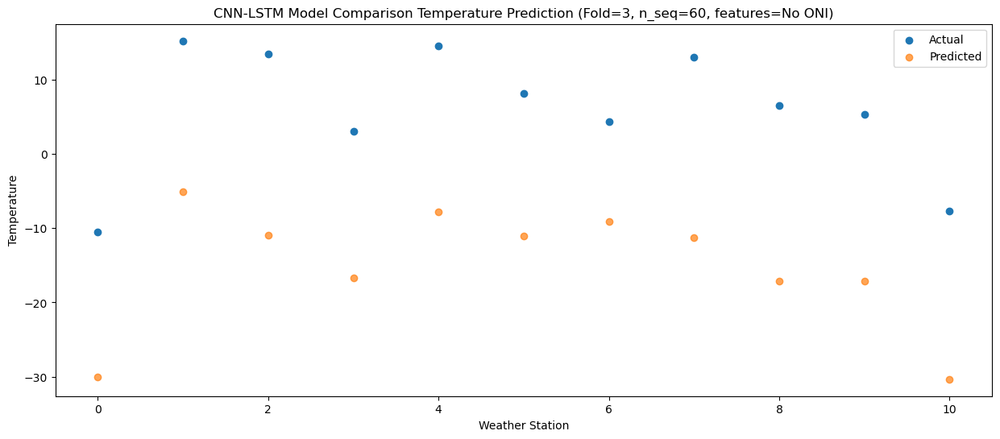

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_3 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_3 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_9 (Dropout)         (None, 1, 1024)           0         
                                                                 
 lstm_6 (LSTM)               (None, 1, 256)            1311744   
                                                                 
 dropout_10 (Dropout)        (None, 1, 256)            0         
                                                                 
 lstm_7 (LSTM)               (None, 256)               525312    
                                                      

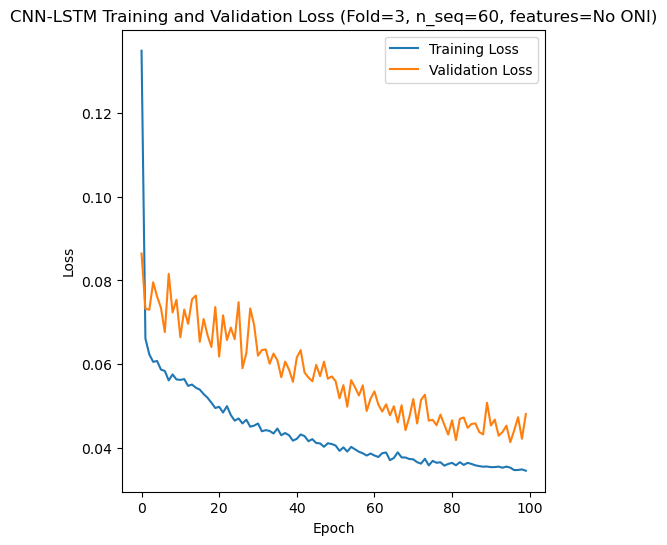

Epoch 1/100
84/84 [==============================] - 31s 128ms/step - loss: 0.1234 - accuracy: 0.3333 - mae: 0.1056 - rmse: 0.1234 - mape: inf - pearson: 0.6743 - val_loss: 0.0629 - val_accuracy: 0.6000 - val_mae: 0.0508 - val_rmse: 0.0629 - val_mape: 12.1641 - val_pearson: 0.8540
Epoch 2/100
84/84 [==============================] - 5s 54ms/step - loss: 0.0651 - accuracy: 0.4524 - mae: 0.0518 - rmse: 0.0651 - mape: inf - pearson: 0.8106 - val_loss: 0.0741 - val_accuracy: 0.1000 - val_mae: 0.0583 - val_rmse: 0.0741 - val_mape: 13.8468 - val_pearson: 0.8007
Epoch 3/100
84/84 [==============================] - 5s 56ms/step - loss: 0.0614 - accuracy: 0.4286 - mae: 0.0487 - rmse: 0.0614 - mape: inf - pearson: 0.8285 - val_loss: 0.0740 - val_accuracy: 0.6000 - val_mae: 0.0596 - val_rmse: 0.0740 - val_mape: 14.0382 - val_pearson: 0.8159
Epoch 4/100
84/84 [==============================] - 5s 61ms/step - loss: 0.0609 - accuracy: 0.4167 - mae: 0.0481 - rmse: 0.0609 - mape: inf - pearson: 0.8302

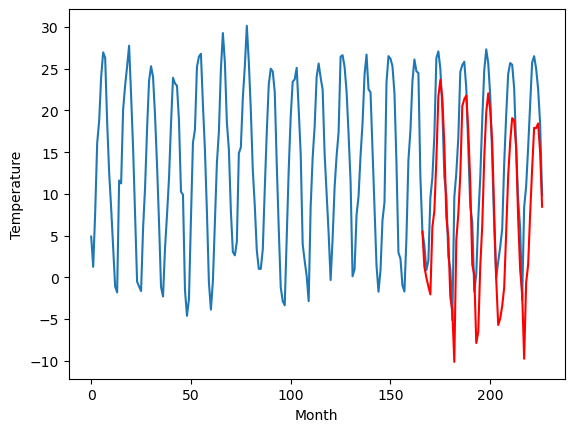

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.37		-1.13		-1.50
0.19		-1.20		-1.39
-1.27		-1.42		-0.15
0.28		-1.23		-1.51
4.35		3.47		-0.88
6.03		3.89		-2.14
7.43		6.10		-1.33
9.19		9.13		-0.06
9.51		11.48		1.97
9.36		11.15		1.79
8.78		8.68		-0.10
7.28		5.30		-1.98
3.89		0.32		-3.57
-3.86		-5.62		-1.76
-3.16		-5.91		-2.75
0.27		-5.64		-5.91
1.87		-0.60		-2.47
3.31		1.62		-1.69
7.35		4.46		-2.89
8.98		8.11		-0.87
9.35		9.66		0.31
9.63		10.15		0.52
8.34		7.09		-1.25
6.50		4.11		-2.39
-0.66		-3.23		-2.57
1.14		-0.55		-1.69
-3.62		-6.14		-2.52
-0.19		-3.79		-3.60
2.63		-0.42		-3.05
4.97		2.38		-2.59
7.79		6.30		-1.49
9.51		9.92		0.41
9.88		10.34		0.46
9.83		9.54		-0.29
8.39		7.54		-0.85
4.56		1.07		-3.49
3.10		-1.73		-4.83
-1.75		-5.10		-3.35
-1.90		-4.21		-2.31
1.40		-1.92		-3.32
3.12		-1.74		-4.86
5.84		0.20		-5.64
6.62		2.35		-4.27
8.83		5.25		-3.58
10.44		9.47		-0.97
10.95		9.16		-1.79
8.85		5.52		-3.33
5.20		0.81		-4.39
1.49		-3.69		-5

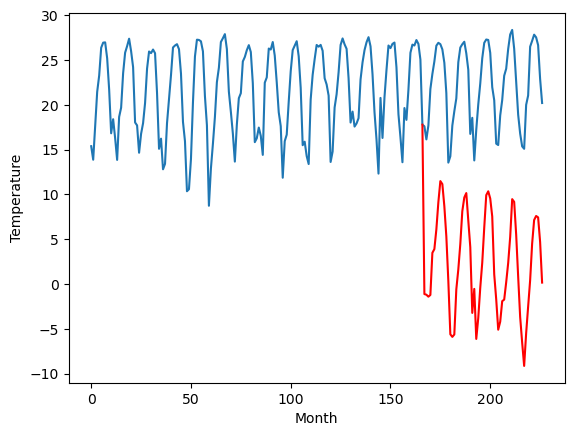

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.37		-4.83		-0.46
-4.31		-4.84		-0.53
-4.50		-5.36		-0.86
-4.24		-5.82		-1.58
3.56		1.18		-2.38
2.61		1.56		-1.05
6.49		5.14		-1.35
10.58		10.11		-0.47
12.15		12.21		0.06
11.32		10.83		-0.49
9.22		7.23		-1.99
3.88		1.95		-1.93
-0.12		-1.59		-1.47
-6.37		-8.46		-2.09
-6.34		-9.34		-3.00
-8.26		-11.89		-3.63
1.07		-1.87		-2.94
2.14		0.12		-2.02
6.61		3.61		-3.00
10.87		8.86		-2.01
11.53		9.90		-1.63
12.18		10.70		-1.48
9.06		7.21		-1.85
5.67		3.45		-2.22
-3.00		-5.74		-2.74
0.51		-2.89		-3.40
-7.77		-10.89		-3.12
-5.41		-8.90		-3.49
-0.67		-3.47		-2.80
3.54		0.54		-3.00
9.34		6.23		-3.11
12.63		10.34		-2.29
12.83		11.33		-1.50
11.29		9.48		-1.81
9.22		6.77		-2.45
3.09		-0.45		-3.54
-1.50		-4.72		-3.22
-3.93		-8.71		-4.78
-3.52		-7.79		-4.27
-1.58		-5.24		-3.66
0.57		-4.14		-4.71
2.32		-1.02		-3.34
7.18		3.01		-4.17
10.77		6.56		-4.21
12.55		9.65		-2.90
14.63		9.73		-4.90
10.88		6.09		-4.79
4.

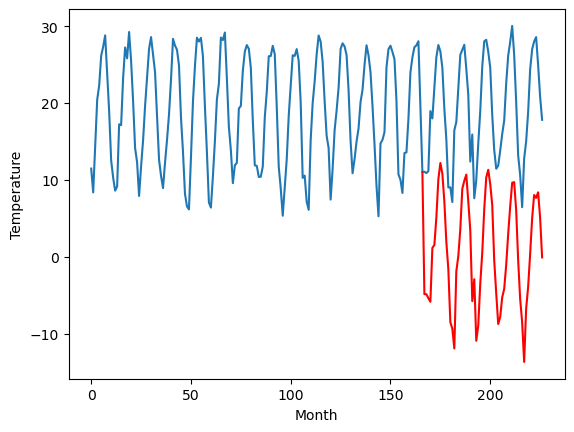

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-3.64		-4.02		-0.38
-5.29		-4.61		0.68
-5.05		-5.31		-0.26
-5.38		-6.00		-0.62
2.08		1.76		-0.32
2.74		2.84		0.10
7.87		7.45		-0.42
12.83		13.21		0.38
14.69		14.78		0.09
14.44		13.48		-0.96
8.66		8.87		0.21
2.93		1.99		-0.94
0.32		-1.04		-1.36
-5.96		-7.76		-1.80
-6.88		-8.61		-1.73
-10.34		-13.22		-2.88
0.62		-0.91		-1.53
2.31		1.25		-1.06
6.47		5.24		-1.23
12.15		11.70		-0.45
13.74		12.60		-1.14
14.11		13.20		-0.91
11.32		9.77		-1.55
6.67		4.35		-2.32
-1.33		-4.25		-2.92
0.67		-3.18		-3.85
-7.80		-10.86		-3.06
-7.54		-10.01		-2.47
-1.36		-3.39		-2.03
4.69		1.52		-3.17
9.40		7.56		-1.84
13.95		12.49		-1.46
17.25		14.09		-3.16
14.52		11.80		-2.72
11.09		8.91		-2.18
4.22		1.16		-3.06
-2.83		-5.87		-3.04
-5.52		-9.50		-3.98
-4.53		-8.98		-4.45
-4.47		-6.71		-2.24
0.06		-4.48		-4.54
2.66		-0.49		-3.15
8.34		5.27		-3.07
12.53		8.94		-3.59
15.08		11.74		-3.34
17.63		12.33		-5.30
12.93		8.48		-4.45

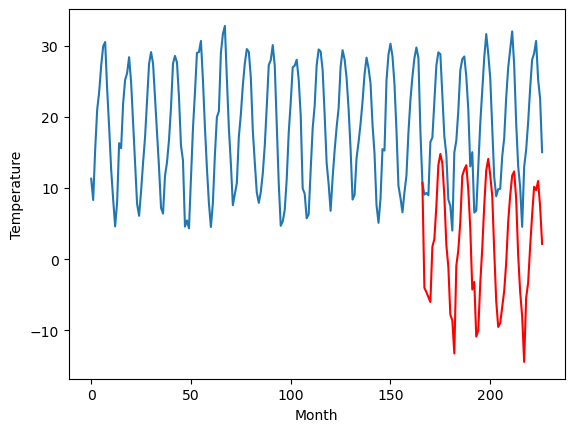

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.77		-2.54		0.23
-4.55		-3.25		1.30
-3.93		-3.97		-0.04
-4.31		-4.64		-0.33
3.57		3.06		-0.51
4.26		4.28		0.02
9.91		9.00		-0.91
14.62		14.80		0.18
17.06		16.34		-0.72
16.38		15.10		-1.28
10.08		10.39		0.31
4.33		3.38		-0.95
1.57		0.33		-1.24
-5.00		-6.31		-1.31
-5.60		-7.13		-1.53
-9.49		-11.86		-2.37
1.43		0.46		-0.97
3.61		2.71		-0.90
7.14		6.74		-0.40
13.99		13.33		-0.66
15.48		14.24		-1.24
15.85		14.78		-1.07
12.42		11.36		-1.06
7.55		5.73		-1.82
-0.29		-2.68		-2.39
1.45		-1.96		-3.41
-7.45		-9.42		-1.97
-6.83		-8.68		-1.85
0.09		-2.01		-2.10
6.78		2.92		-3.86
11.61		8.97		-2.64
16.28		13.99		-2.29
19.70		15.67		-4.03
16.86		13.42		-3.44
12.77		10.51		-2.26
5.62		2.72		-2.90
-1.47		-4.62		-3.15
-4.44		-8.21		-3.77
-3.67		-7.72		-4.05
-3.44		-5.55		-2.11
1.41		-3.24		-4.65
4.06		0.89		-3.17
10.22		6.79		-3.43
15.33		10.44		-4.89
18.41		13.30		-5.11
20.28		13.89		-6.39
15.19		10.03		-5.1

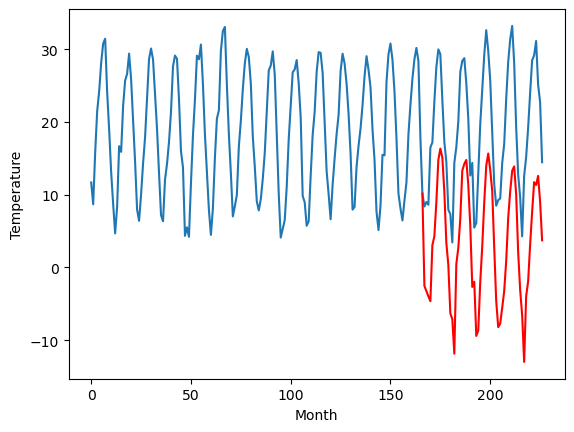

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.81		8.27		-0.54
7.17		7.27		0.10
6.44		6.66		0.22
5.68		6.28		0.60
13.24		12.90		-0.34
16.21		14.46		-1.75
22.78		18.99		-3.79
26.11		24.20		-1.91
28.94		25.95		-2.99
28.32		25.15		-3.17
20.59		20.73		0.14
16.63		14.19		-2.44
12.75		10.47		-2.28
5.77		4.35		-1.42
4.67		3.70		-0.97
3.10		-0.05		-3.15
12.35		10.22		-2.13
14.58		12.88		-1.70
20.07		16.76		-3.31
25.03		23.01		-2.02
24.77		24.14		-0.63
25.09		24.46		-0.63
24.40		21.06		-3.34
18.70		15.45		-3.25
11.76		7.96		-3.80
12.17		7.90		-4.27
4.80		1.79		-3.01
4.60		2.61		-1.99
11.92		8.53		-3.39
19.43		12.98		-6.45
25.12		18.48		-6.64
27.49		23.52		-3.97
29.39		25.19		-4.20
26.09		23.51		-2.58
23.19		20.78		-2.41
16.38		13.19		-3.19
8.53		5.99		-2.54
6.93		2.60		-4.33
7.30		3.11		-4.19
7.47		4.88		-2.59
12.54		6.96		-5.58
16.76		11.07		-5.69
21.68		16.49		-5.19
28.16		19.86		-8.30
29.62		23.39		-6.23
29.71		23.67		-6.04
26.23		19.84		-6.3

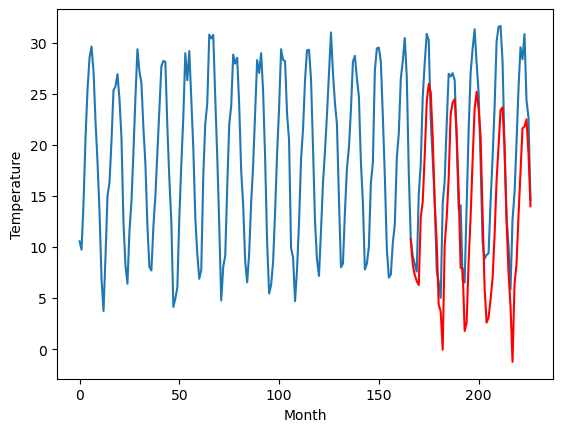

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.79		1.80		0.01
1.44		1.44		-0.00
1.27		1.00		-0.27
1.74		0.67		-1.07
7.35		6.62		-0.73
8.62		7.31		-1.31
11.41		11.18		-0.23
16.00		16.34		0.34
19.04		19.12		0.08
17.84		17.47		-0.37
14.04		13.88		-0.16
10.22		8.80		-1.42
5.91		4.72		-1.19
-1.34		-2.03		-0.69
-1.11		-3.29		-2.18
-0.44		-5.02		-4.58
5.96		3.69		-2.27
8.69		6.50		-2.19
12.14		10.09		-2.05
16.16		15.55		-0.61
17.90		16.79		-1.11
18.03		17.53		-0.50
14.06		13.70		-0.36
10.26		10.16		-0.10
2.10		0.76		-1.34
4.01		2.73		-1.28
-2.05		-4.74		-2.69
2.23		-1.96		-4.19
5.79		3.03		-2.76
8.45		6.45		-2.00
14.43		12.56		-1.87
17.64		16.53		-1.11
18.91		17.81		-1.10
17.39		16.62		-0.77
14.30		13.45		-0.85
7.43		6.26		-1.17
4.73		2.78		-1.95
-1.22		-2.16		-0.94
1.80		-0.93		-2.73
5.22		1.07		-4.15
5.70		1.56		-4.14
8.81		5.79		-3.02
11.43		9.10		-2.33
15.07		12.62		-2.45
18.94		16.50		-2.44
18.38		15.69		-2.69
14.54		12.31		-2.23
9.10		6.

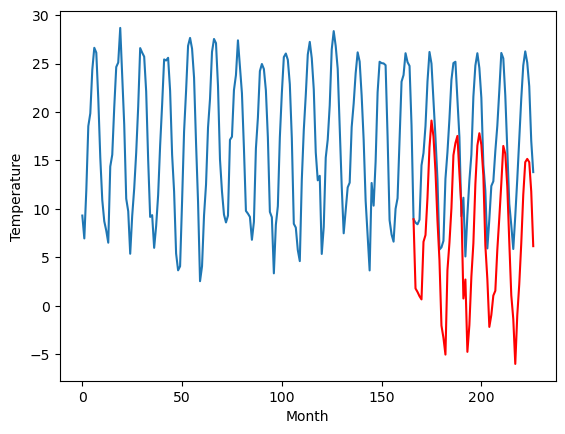

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.00		2.66		-1.34
3.19		1.99		-1.20
1.54		1.17		-0.37
2.11		0.36		-1.75
9.04		8.15		-0.89
10.62		9.34		-1.28
14.72		14.41		-0.31
21.07		21.01		-0.06
23.61		23.07		-0.54
21.62		21.05		-0.57
18.04		16.30		-1.74
11.11		9.09		-2.02
8.56		6.21		-2.35
2.03		-0.87		-2.90
0.36		-2.27		-2.63
-3.25		-7.01		-3.76
9.02		5.99		-3.03
10.92		8.57		-2.35
14.96		12.81		-2.15
21.26		19.79		-1.47
22.55		20.67		-1.88
23.07		21.33		-1.74
20.03		17.40		-2.63
14.26		12.26		-2.00
6.32		2.47		-3.85
7.78		3.27		-4.51
-1.29		-5.15		-3.86
0.77		-3.50		-4.27
7.43		3.44		-3.99
11.29		8.08		-3.21
16.96		15.24		-1.72
22.28		20.09		-2.19
25.98		21.85		-4.13
22.46		19.77		-2.69
18.87		16.30		-2.57
12.50		8.36		-4.14
5.95		2.07		-3.88
1.10		-2.80		-3.90
2.75		-1.94		-4.69
4.89		0.11		-4.78
6.61		1.88		-4.73
12.23		7.05		-5.18
17.01		12.64		-4.37
21.09		16.54		-4.55
23.05		19.43		-3.62
22.86		19.31		-3.55
18.92		15.83		-3.09
13

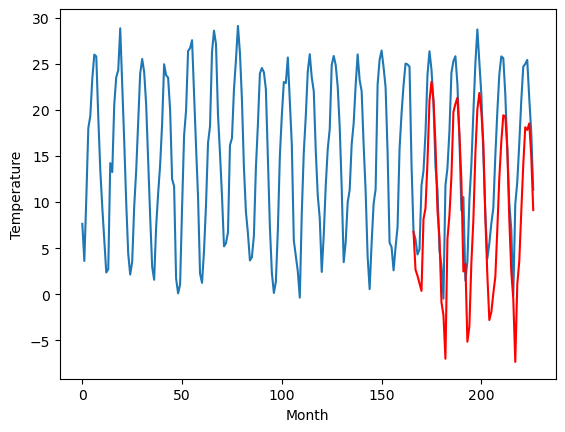

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.41		1.79		0.38
0.59		0.73		0.14
-0.34		-0.10		0.24
-1.17		-0.94		0.23
5.65		6.08		0.43
8.64		7.62		-1.02
14.22		13.34		-0.88
21.51		20.77		-0.74
23.55		23.71		0.16
21.35		20.95		-0.40
17.59		16.09		-1.50
10.75		8.70		-2.05
6.91		5.62		-1.29
-0.60		-1.62		-1.02
-2.18		-3.82		-1.64
-5.54		-8.11		-2.57
6.43		4.42		-2.01
10.08		8.01		-2.07
14.49		12.49		-2.00
21.73		20.15		-1.58
22.30		21.06		-1.24
23.16		21.76		-1.40
19.67		17.08		-2.59
14.32		12.40		-1.92
3.46		1.47		-1.99
3.78		1.29		-2.49
-5.06		-7.43		-2.37
-2.04		-4.54		-2.50
5.43		2.28		-3.15
9.21		6.33		-2.88
17.71		14.75		-2.96
22.19		19.44		-2.75
24.13		21.59		-2.54
21.90		20.21		-1.69
17.99		15.91		-2.08
10.50		7.86		-2.64
4.71		2.82		-1.89
-1.07		-3.81		-2.74
0.89		-2.42		-3.31
2.48		-1.13		-3.61
3.75		-0.09		-3.84
10.25		6.87		-3.38
15.96		11.87		-4.09
19.84		15.93		-3.91
22.57		19.46		-3.11
21.41		18.08		-3.33
18.32		15.11		-3.21


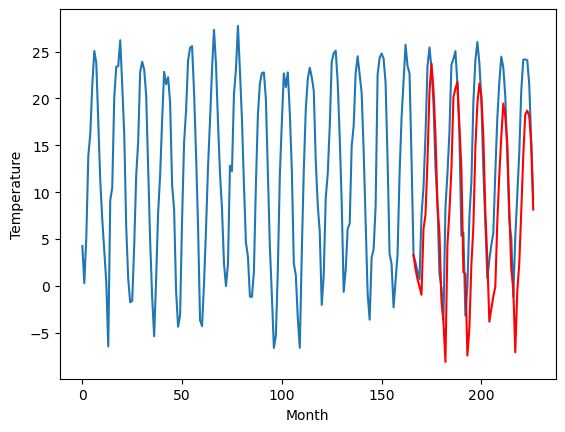

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.42		1.32		-0.10
1.10		0.14		-0.96
-1.34		-0.85		0.49
-1.59		-1.82		-0.23
6.01		5.87		-0.14
9.12		7.64		-1.48
15.00		13.67		-1.33
22.73		21.47		-1.26
23.94		24.01		0.07
21.34		21.29		-0.05
17.44		16.06		-1.38
10.10		7.88		-2.22
7.46		5.21		-2.25
-0.42		-2.09		-1.67
-2.45		-4.19		-1.74
-6.89		-9.56		-2.67
6.97		4.42		-2.55
10.68		7.83		-2.85
15.46		12.51		-2.95
22.85		20.63		-2.22
22.56		21.45		-1.11
22.84		22.06		-0.78
19.73		17.46		-2.27
14.27		12.07		-2.20
3.96		1.31		-2.65
3.71		0.57		-3.14
-5.77		-8.20		-2.43
-2.94		-5.91		-2.97
5.27		1.57		-3.70
9.39		6.06		-3.33
17.92		14.67		-3.25
22.53		19.75		-2.78
23.35		21.97		-1.38
22.05		20.29		-1.76
17.91		16.01		-1.90
10.44		7.70		-2.74
4.90		1.39		-3.51
-1.83		-5.01		-3.18
0.41		-3.85		-4.26
1.60		-2.50		-4.10
4.14		-0.94		-5.08
11.47		6.16		-5.31
17.23		12.07		-5.16
21.54		16.22		-5.32
23.07		19.33		-3.74
21.81		18.36		-3.45
18.77		15.30		-

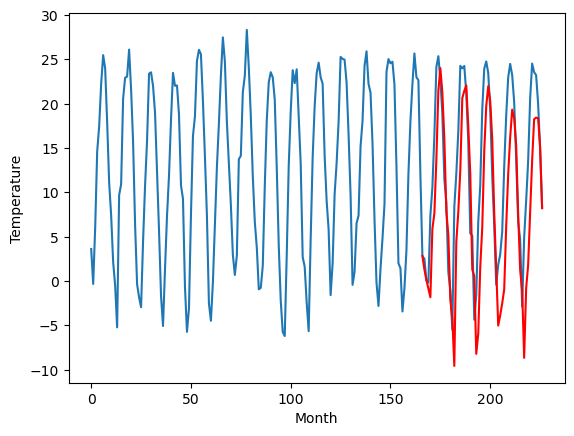

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.09		-0.90		0.19
-1.87		-2.27		-0.40
-3.07		-2.94		0.13
-3.88		-3.72		0.16
2.28		2.53		0.25
3.66		4.24		0.58
10.40		10.20		-0.20
16.89		17.69		0.80
20.33		21.09		0.76
17.92		18.23		0.31
13.93		13.31		-0.62
7.77		6.12		-1.65
4.54		2.71		-1.83
-3.02		-4.41		-1.39
-4.94		-6.90		-1.96
-7.18		-10.63		-3.45
2.71		0.83		-1.88
6.51		5.03		-1.48
11.04		9.53		-1.51
17.93		17.33		-0.60
18.09		18.32		0.23
19.29		19.09		-0.20
15.00		14.20		-0.80
11.47		9.69		-1.78
1.07		-1.30		-2.37
0.21		-2.06		-2.27
-8.62		-10.43		-1.81
-5.06		-7.08		-2.02
0.91		-0.66		-1.57
4.91		3.12		-1.79
13.49		11.71		-1.78
16.76		16.27		-0.49
19.36		18.74		-0.62
18.29		17.76		-0.53
14.24		13.15		-1.09
7.38		5.15		-2.23
3.30		0.65		-2.65
-3.41		-6.48		-3.07
-1.78		-4.89		-3.11
-1.64		-4.07		-2.43
-0.76		-3.31		-2.55
7.71		4.31		-3.40
11.40		8.82		-2.58
15.71		12.83		-2.88
18.80		16.97		-1.83
17.47		15.01		-2.46
15.13		12.14		-2.

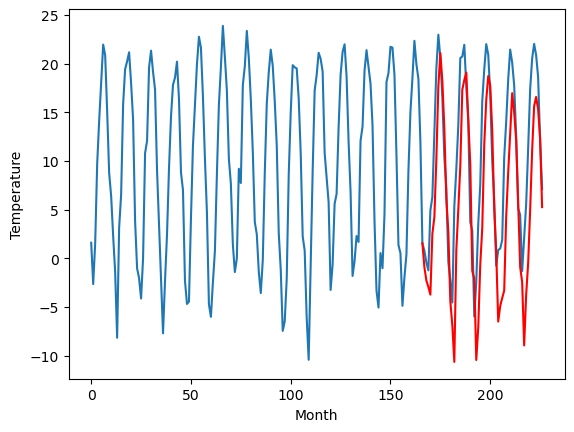

RangeIndex(start=1, stop=12, step=1)
[2.839999999999999, 0.3700000000000001, -4.370000000000001, -3.639999999999999, -2.7700000000000005, 8.81, 1.7899999999999991, 4.0, 1.4099999999999984, 1.42, -1.0899999999999999]
[1.2613242340087893, -1.1268094635009769, -4.834686508178711, -4.015134220123291, -2.5368727302551273, 8.27274263381958, 1.7999927902221682, 2.656823692321778, 1.7913393402099604, 1.3226276016235357, -0.9035012054443357]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.84   1.261324
1                 1    0.37  -1.126809
2                 2   -4.37  -4.834687
3                 3   -3.64  -4.015134
4                 4   -2.77  -2.536873
5                 5    8.81   8.272743
6                 6    1.79   1.799993
7                 7    4.00   2.656824
8                 8    1.41   1.791339
9                 9    1.42   1.322628
10               10   -1.09  -0.903501


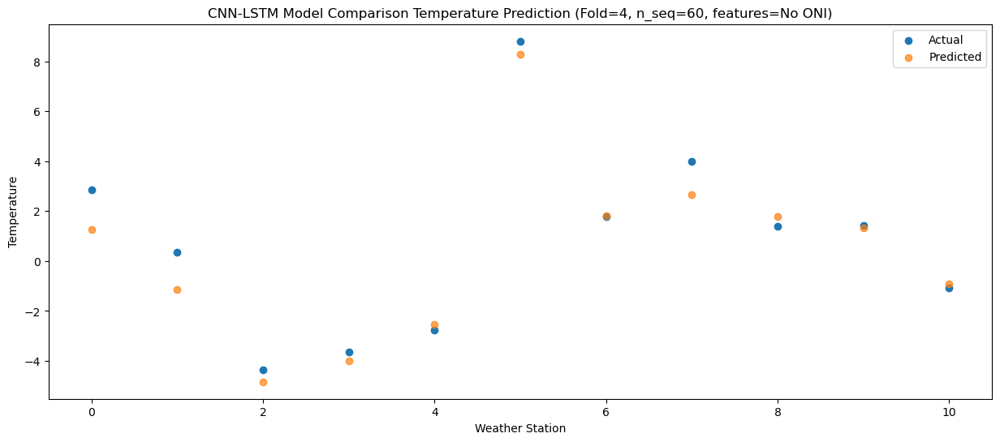

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18  -0.035383
1                 1    0.19  -1.200048
2                 2   -4.31  -4.837486
3                 3   -5.29  -4.613926
4                 4   -4.55  -3.253756
5                 5    7.17   7.272546
6                 6    1.44   1.439299
7                 7    3.19   1.993636
8                 8    0.59   0.728637
9                 9    1.10   0.142479
10               10   -1.87  -2.274780


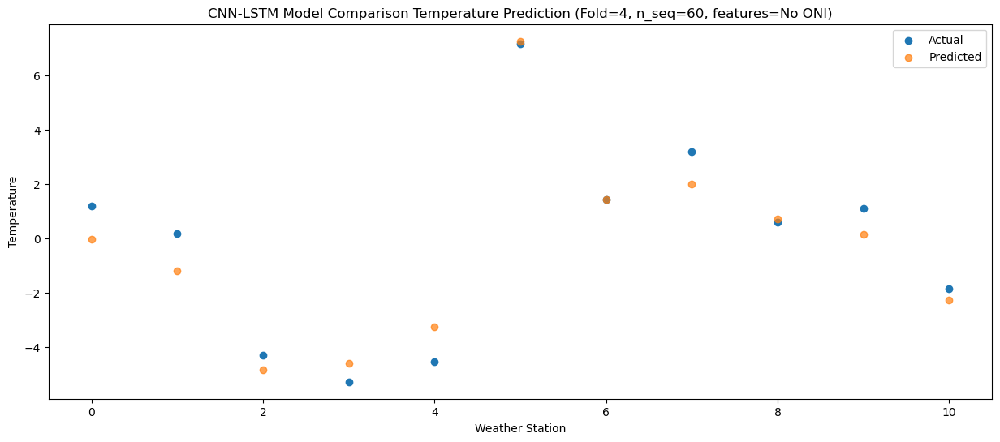

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -1.082669
1                 1   -1.27  -1.418961
2                 2   -4.50  -5.359189
3                 3   -5.05  -5.313470
4                 4   -3.93  -3.966914
5                 5    6.44   6.656899
6                 6    1.27   1.001826
7                 7    1.54   1.174433
8                 8   -0.34  -0.096864
9                 9   -1.34  -0.849197
10               10   -3.07  -2.941348


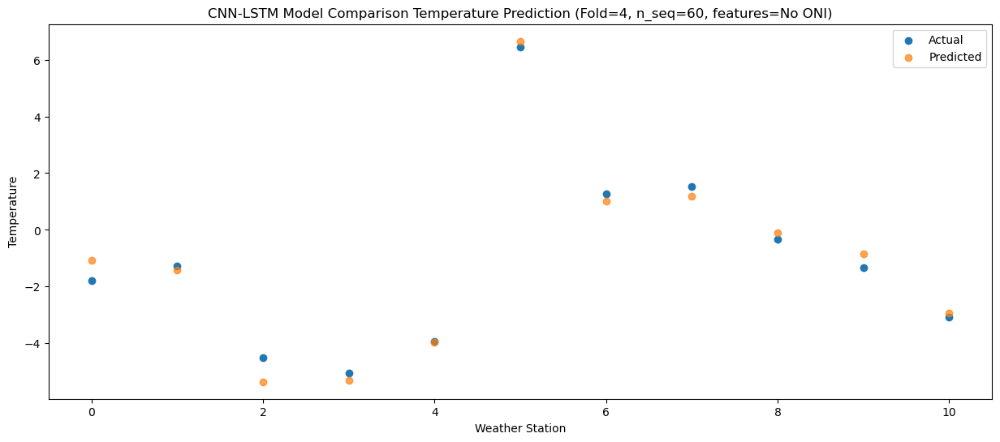

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.67  -2.037468
1                 1    0.28  -1.226096
2                 2   -4.24  -5.820536
3                 3   -5.38  -6.002269
4                 4   -4.31  -4.638414
5                 5    5.68   6.276434
6                 6    1.74   0.672240
7                 7    2.11   0.360213
8                 8   -1.17  -0.941373
9                 9   -1.59  -1.815157
10               10   -3.88  -3.719978


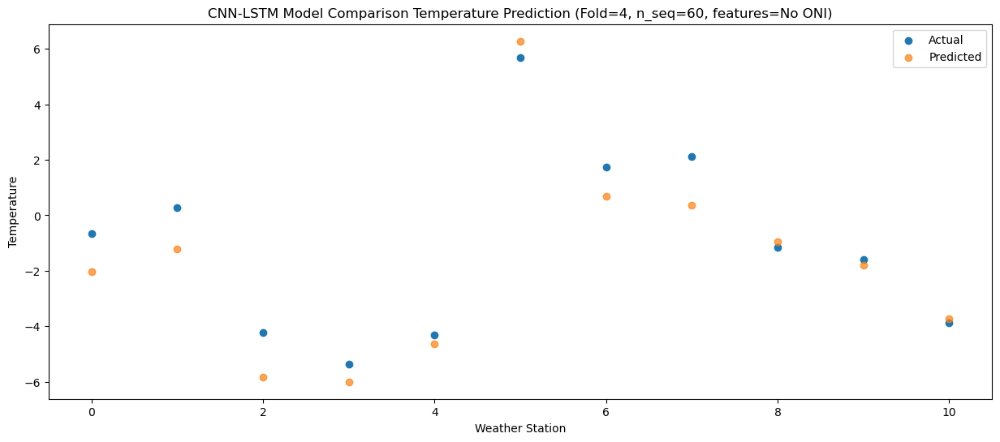

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    6.86   6.032268
1                 1    4.35   3.474483
2                 2    3.56   1.175805
3                 3    2.08   1.759581
4                 4    3.57   3.063205
5                 5   13.24  12.897042
6                 6    7.35   6.617317
7                 7    9.04   8.146806
8                 8    5.65   6.084574
9                 9    6.01   5.865757
10               10    2.28   2.526188


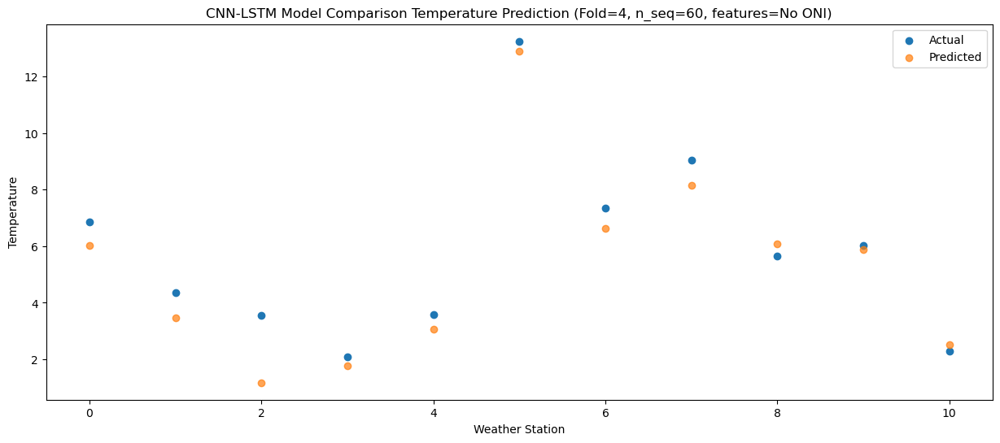

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    9.29   7.985392
1                 1    6.03   3.891910
2                 2    2.61   1.559777
3                 3    2.74   2.841520
4                 4    4.26   4.281192
5                 5   16.21  14.460866
6                 6    8.62   7.309127
7                 7   10.62   9.337800
8                 8    8.64   7.622727
9                 9    9.12   7.636421
10               10    3.66   4.243493


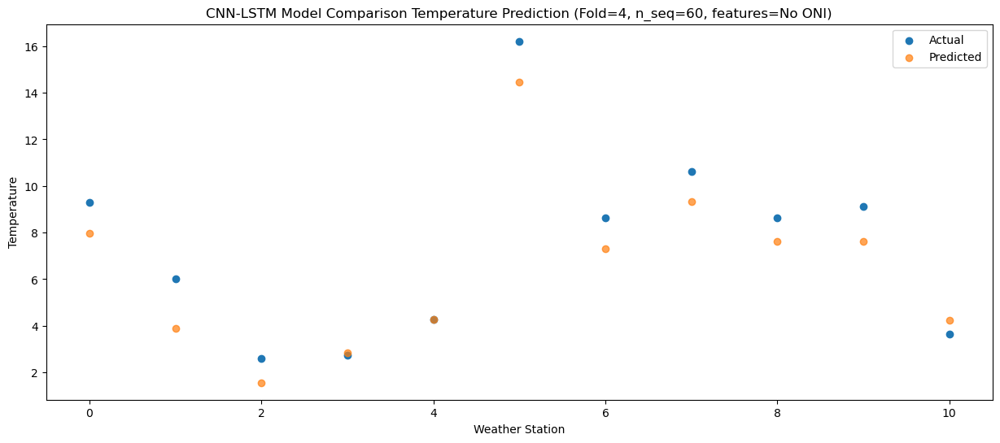

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   14.36  14.078631
1                 1    7.43   6.097181
2                 2    6.49   5.144597
3                 3    7.87   7.446745
4                 4    9.91   9.001972
5                 5   22.78  18.986039
6                 6   11.41  11.180965
7                 7   14.72  14.412018
8                 8   14.22  13.335495
9                 9   15.00  13.666733
10               10   10.40  10.200121


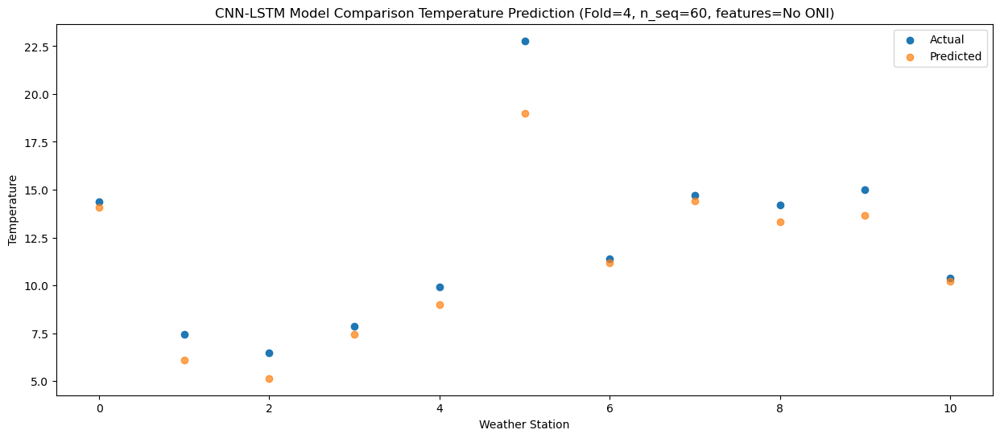

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   23.61  21.679064
1                 1    9.19   9.125770
2                 2   10.58  10.108438
3                 3   12.83  13.209203
4                 4   14.62  14.797656
5                 5   26.11  24.204843
6                 6   16.00  16.344621
7                 7   21.07  21.011430
8                 8   21.51  20.770288
9                 9   22.73  21.465119
10               10   16.89  17.688015


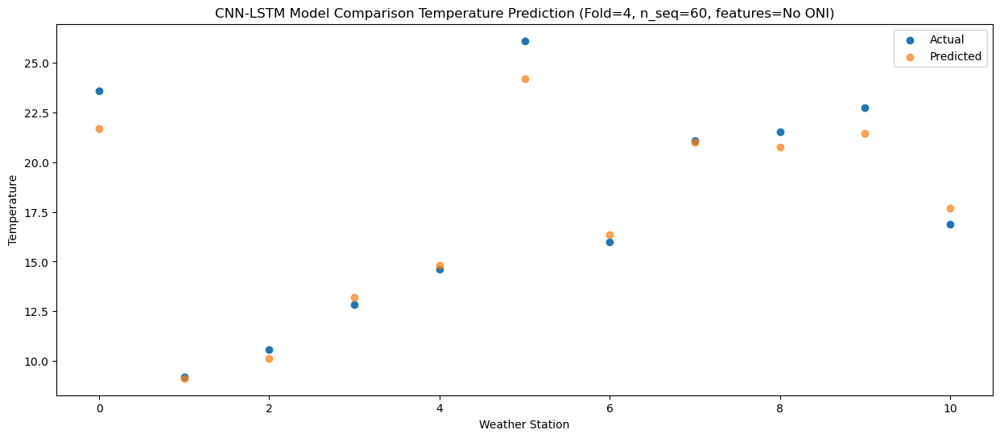

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   24.42  23.669393
1                 1    9.51  11.483233
2                 2   12.15  12.214368
3                 3   14.69  14.782727
4                 4   17.06  16.342759
5                 5   28.94  25.949755
6                 6   19.04  19.116240
7                 7   23.61  23.070427
8                 8   23.55  23.714540
9                 9   23.94  24.012659
10               10   20.33  21.087296


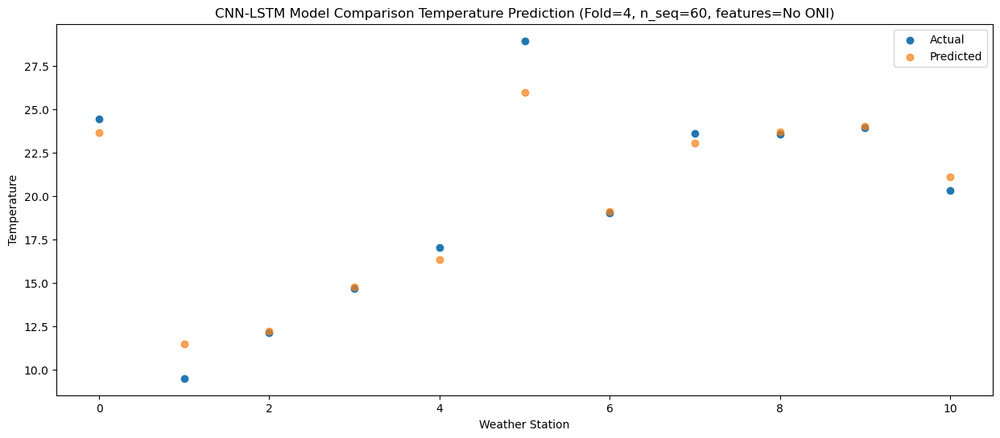

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   22.32  21.401549
1                 1    9.36  11.148575
2                 2   11.32  10.825261
3                 3   14.44  13.482839
4                 4   16.38  15.101664
5                 5   28.32  25.147918
6                 6   17.84  17.474267
7                 7   21.62  21.047479
8                 8   21.35  20.954378
9                 9   21.34  21.286665
10               10   17.92  18.226945


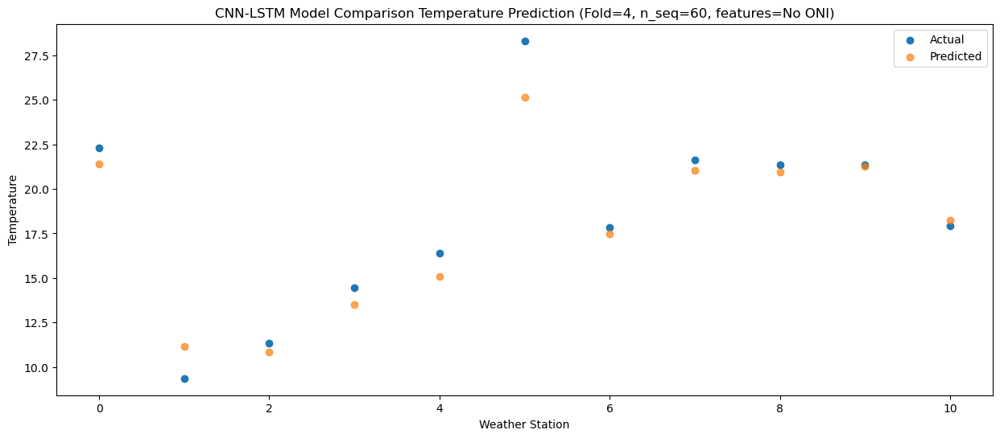

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   17.48  15.882241
1                 1    8.78   8.678207
2                 2    9.22   7.234540
3                 3    8.66   8.865002
4                 4   10.08  10.394689
5                 5   20.59  20.734250
6                 6   14.04  13.881588
7                 7   18.04  16.304454
8                 8   17.59  16.092517
9                 9   17.44  16.055406
10               10   13.93  13.307302


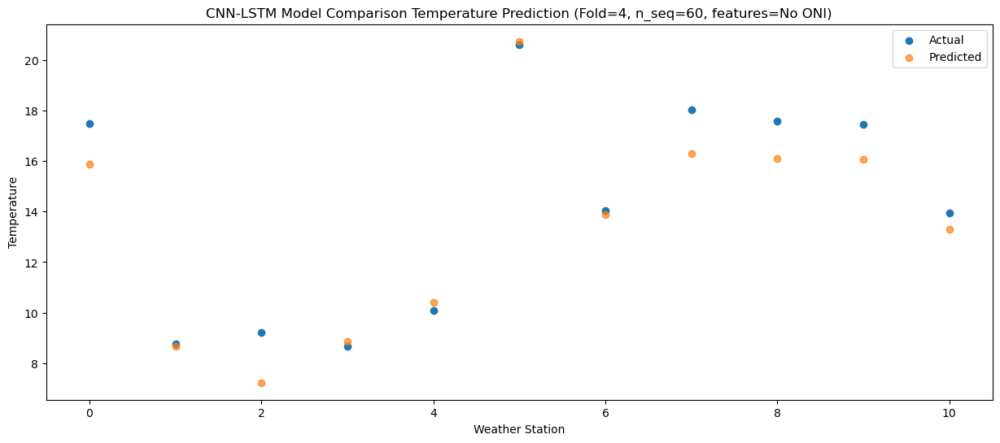

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    9.43   7.265508
1                 1    7.28   5.297984
2                 2    3.88   1.954930
3                 3    2.93   1.987512
4                 4    4.33   3.376873
5                 5   16.63  14.193180
6                 6   10.22   8.804448
7                 7   11.11   9.085876
8                 8   10.75   8.697352
9                 9   10.10   7.881120
10               10    7.77   6.115335


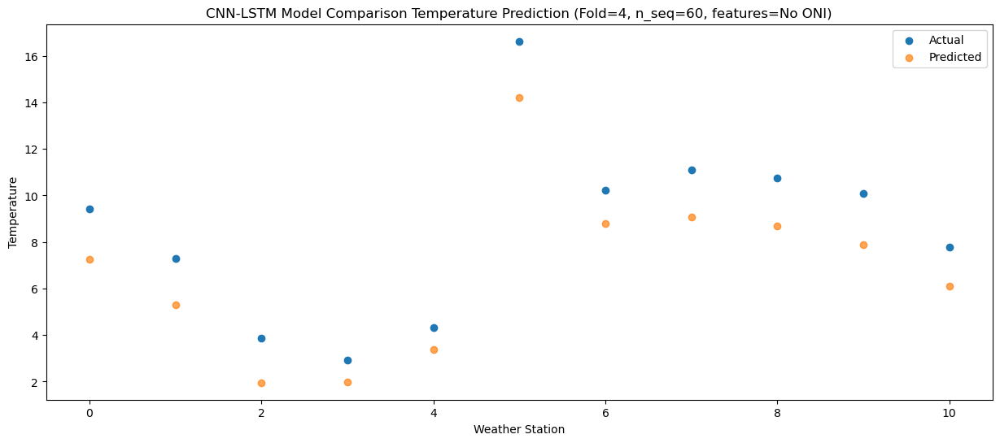

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    7.24   4.727726
1                 1    3.89   0.321776
2                 2   -0.12  -1.590501
3                 3    0.32  -1.035558
4                 4    1.57   0.330923
5                 5   12.75  10.472369
6                 6    5.91   4.719506
7                 7    8.56   6.205901
8                 8    6.91   5.623305
9                 9    7.46   5.207702
10               10    4.54   2.708345


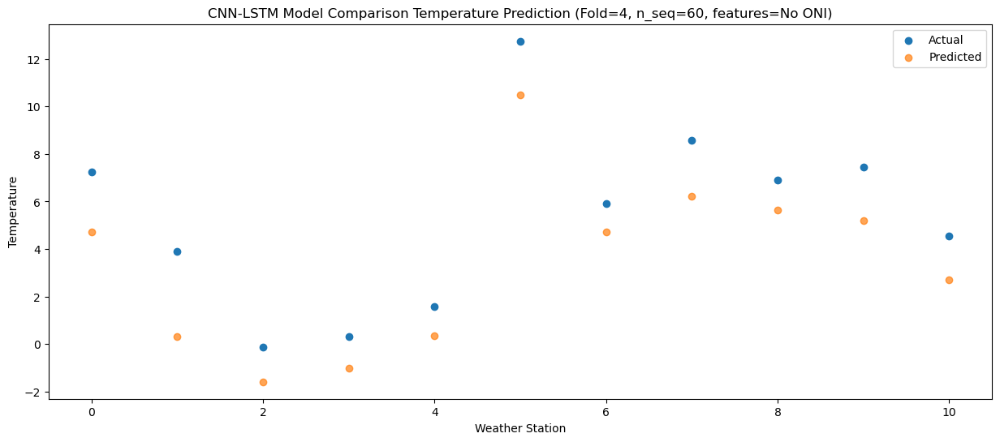

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -2.348774
1                 1   -3.86  -5.616101
2                 2   -6.37  -8.458087
3                 3   -5.96  -7.761643
4                 4   -5.00  -6.309786
5                 5    5.77   4.348543
6                 6   -1.34  -2.028484
7                 7    2.03  -0.874591
8                 8   -0.60  -1.624741
9                 9   -0.42  -2.086963
10               10   -3.02  -4.406224


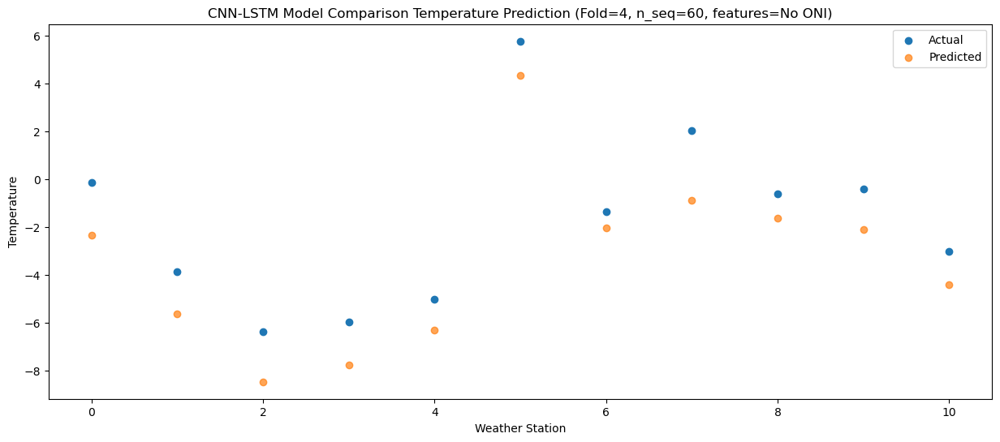

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.65  -4.015986
1                 1   -3.16  -5.909375
2                 2   -6.34  -9.338376
3                 3   -6.88  -8.605692
4                 4   -5.60  -7.132803
5                 5    4.67   3.701314
6                 6   -1.11  -3.293196
7                 7    0.36  -2.265913
8                 8   -2.18  -3.824939
9                 9   -2.45  -4.189058
10               10   -4.94  -6.895402


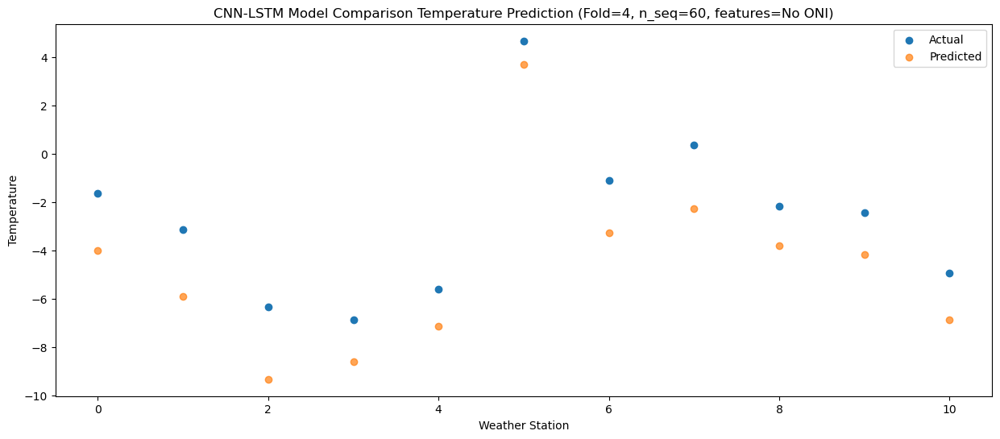

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -7.78 -10.131189
1                 1    0.27  -5.639363
2                 2   -8.26 -11.892920
3                 3  -10.34 -13.222945
4                 4   -9.49 -11.859211
5                 5    3.10  -0.047247
6                 6   -0.44  -5.020103
7                 7   -3.25  -7.006709
8                 8   -5.54  -8.106384
9                 9   -6.89  -9.557439
10               10   -7.18 -10.631786


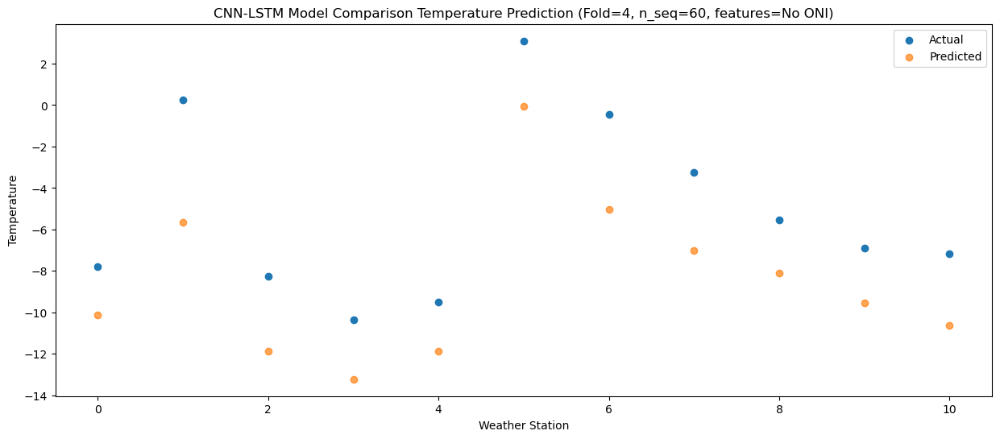

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    6.95   4.467314
1                 1    1.87  -0.597374
2                 2    1.07  -1.868558
3                 3    0.62  -0.906196
4                 4    1.43   0.463719
5                 5   12.35  10.224384
6                 6    5.96   3.691062
7                 7    9.02   5.989170
8                 8    6.43   4.418854
9                 9    6.97   4.417621
10               10    2.71   0.831430


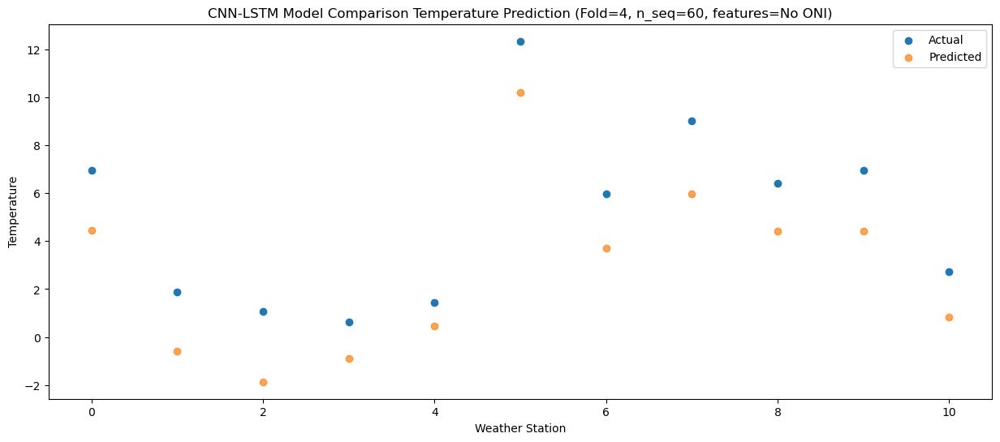

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    9.86   7.581447
1                 1    3.31   1.622011
2                 2    2.14   0.121900
3                 3    2.31   1.246915
4                 4    3.61   2.705387
5                 5   14.58  12.876328
6                 6    8.69   6.497981
7                 7   10.92   8.570655
8                 8   10.08   8.008012
9                 9   10.68   7.830090
10               10    6.51   5.031791


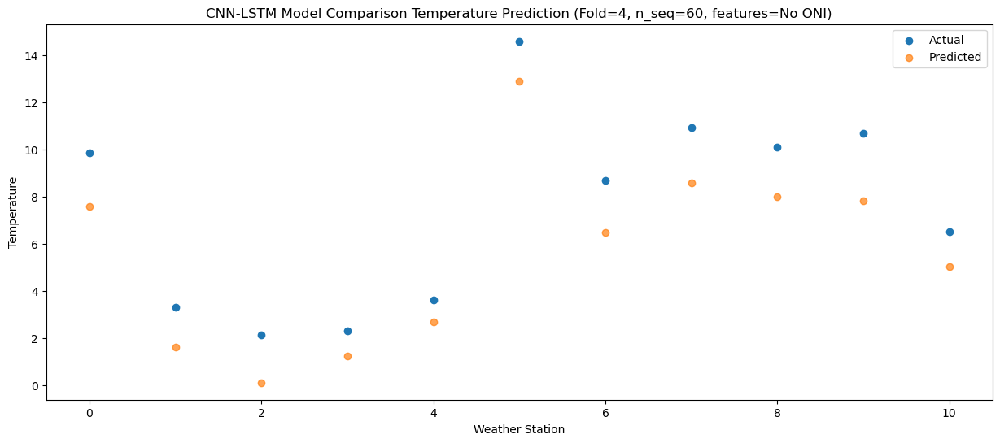

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   14.07  12.323597
1                 1    7.35   4.459069
2                 2    6.61   3.610143
3                 3    6.47   5.242779
4                 4    7.14   6.743937
5                 5   20.07  16.761889
6                 6   12.14  10.087293
7                 7   14.96  12.805400
8                 8   14.49  12.487129
9                 9   15.46  12.514348
10               10   11.04   9.529446


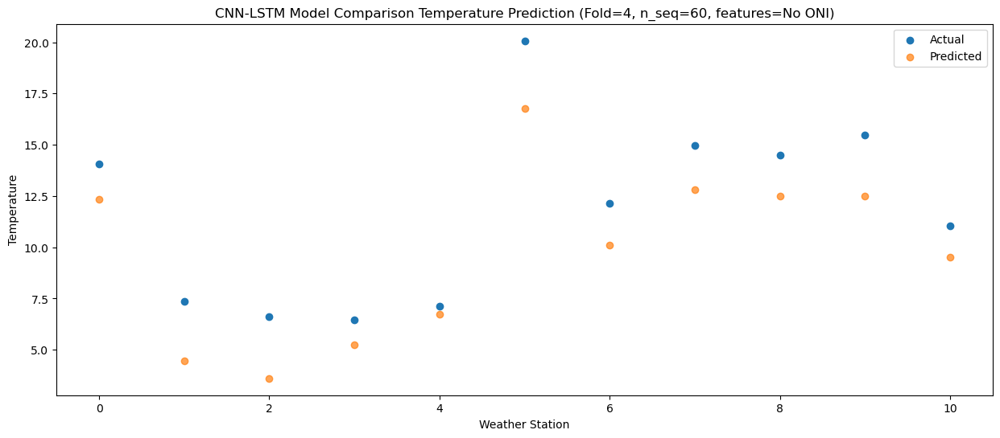

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   21.98  20.525871
1                 1    8.98   8.114664
2                 2   10.87   8.864415
3                 3   12.15  11.703100
4                 4   13.99  13.325093
5                 5   25.03  23.011605
6                 6   16.16  15.545365
7                 7   21.26  19.786681
8                 8   21.73  20.149137
9                 9   22.85  20.631871
10               10   17.93  17.331223


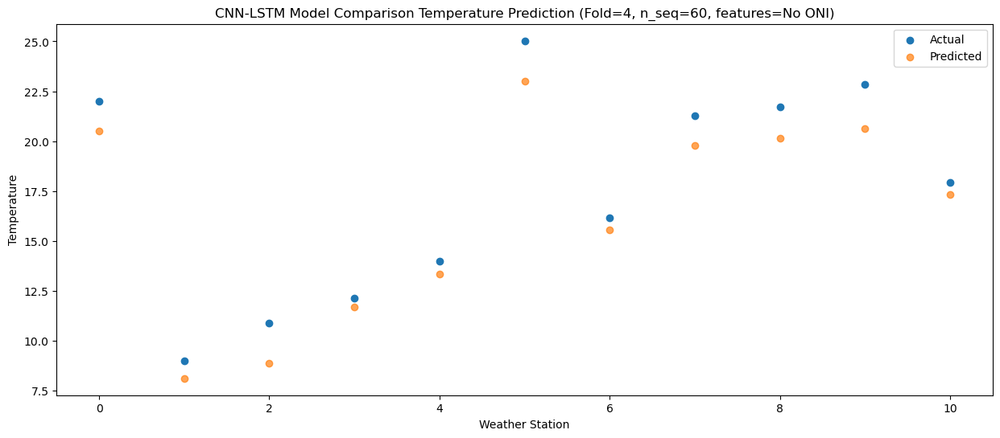

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   22.78  21.361681
1                 1    9.35   9.655368
2                 2   11.53   9.904799
3                 3   13.74  12.604857
4                 4   15.48  14.243572
5                 5   24.77  24.141526
6                 6   17.90  16.787387
7                 7   22.55  20.668785
8                 8   22.30  21.059426
9                 9   22.56  21.454132
10               10   18.09  18.321306


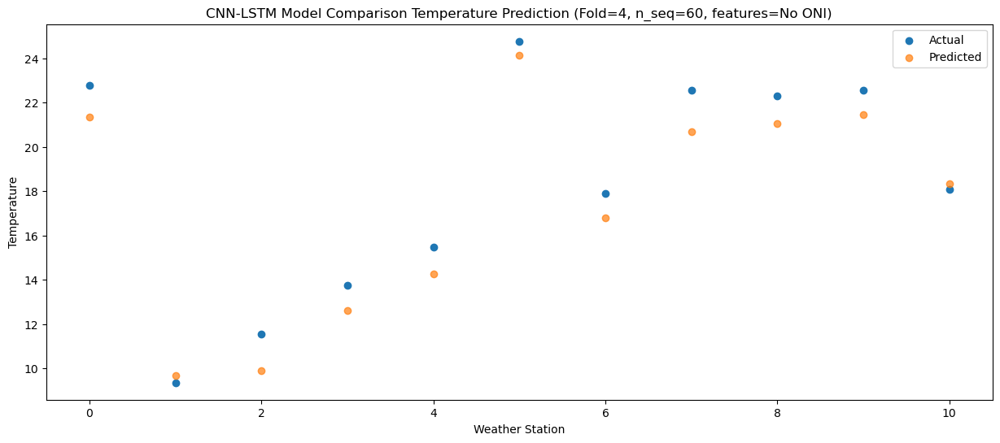

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   23.18  21.796584
1                 1    9.63  10.146442
2                 2   12.18  10.704866
3                 3   14.11  13.200893
4                 4   15.85  14.783295
5                 5   25.09  24.455768
6                 6   18.03  17.529118
7                 7   23.07  21.330512
8                 8   23.16  21.756836
9                 9   22.84  22.058077
10               10   19.29  19.087551


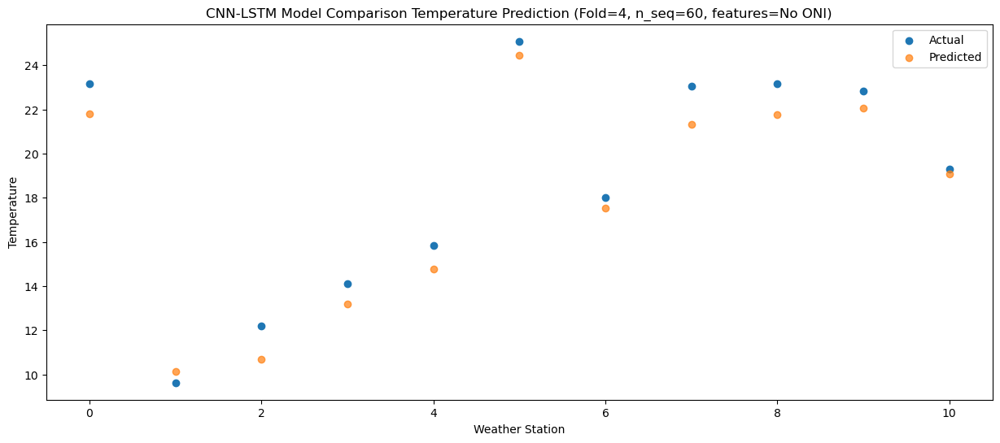

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   19.99  17.573301
1                 1    8.34   7.093475
2                 2    9.06   7.213962
3                 3   11.32   9.768425
4                 4   12.42  11.355267
5                 5   24.40  21.063035
6                 6   14.06  13.695939
7                 7   20.03  17.398281
8                 8   19.67  17.082062
9                 9   19.73  17.463332
10               10   15.00  14.195524


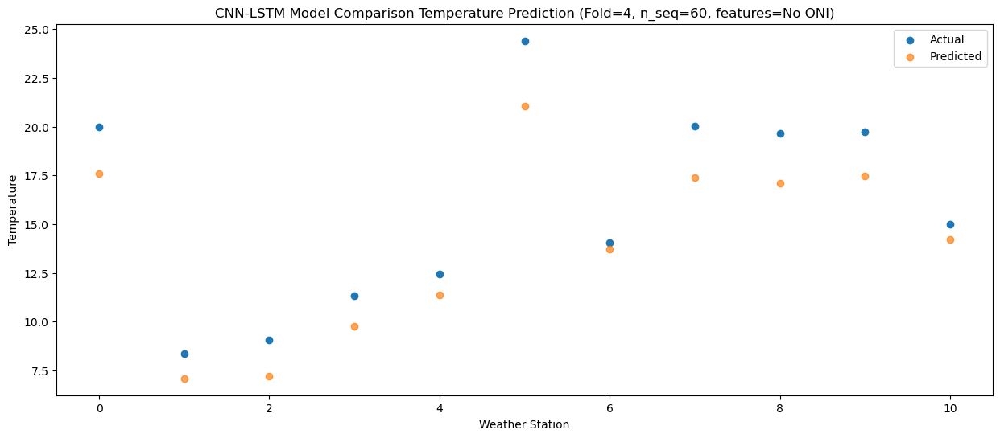

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   12.86  11.321761
1                 1    6.50   4.113149
2                 2    5.67   3.450347
3                 3    6.67   4.349380
4                 4    7.55   5.734590
5                 5   18.70  15.447700
6                 6   10.26  10.157233
7                 7   14.26  12.264377
8                 8   14.32  12.402821
9                 9   14.27  12.068027
10               10   11.47   9.688653


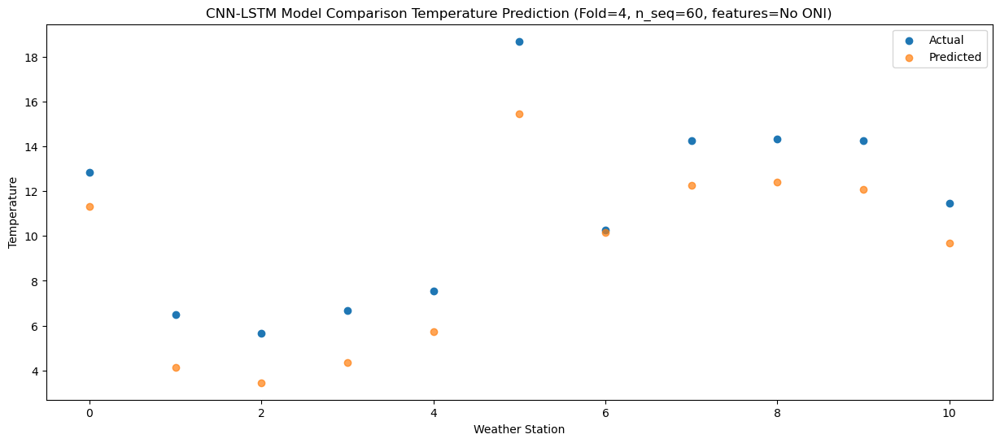

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    5.80   1.525745
1                 1   -0.66  -3.231027
2                 2   -3.00  -5.739460
3                 3   -1.33  -4.248948
4                 4   -0.29  -2.677900
5                 5   11.76   7.961004
6                 6    2.10   0.764510
7                 7    6.32   2.472465
8                 8    3.46   1.471256
9                 9    3.96   1.313963
10               10    1.07  -1.302780


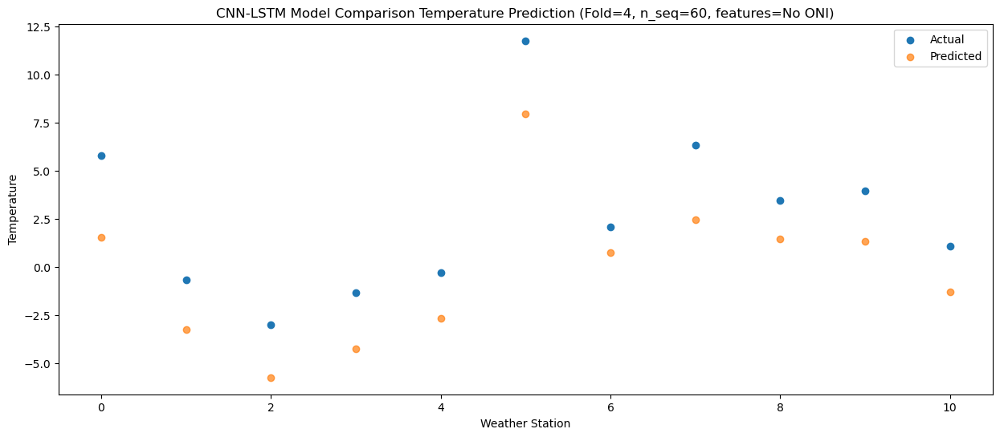

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.01   0.297117
1                 1    1.14  -0.549413
2                 2    0.51  -2.887063
3                 3    0.67  -3.182430
4                 4    1.45  -1.962350
5                 5   12.17   7.896054
6                 6    4.01   2.725306
7                 7    7.78   3.272189
8                 8    3.78   1.287656
9                 9    3.71   0.569541
10               10    0.21  -2.055274


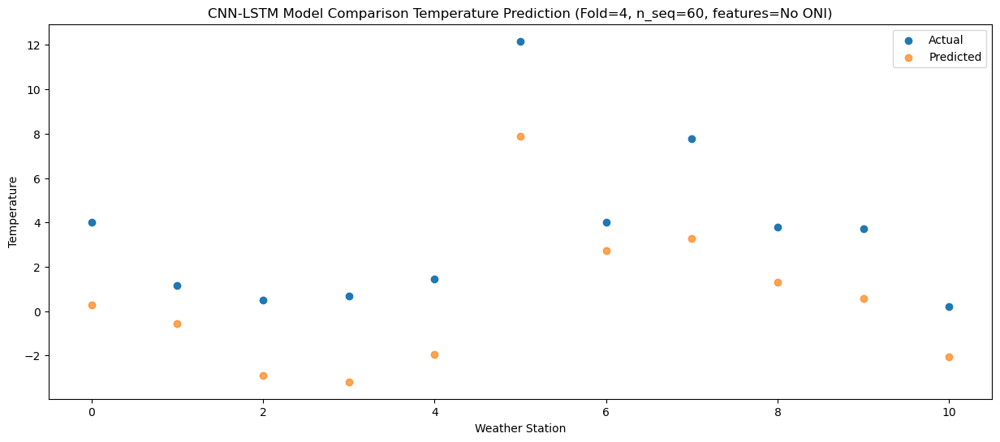

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.37  -7.859727
1                 1   -3.62  -6.135337
2                 2   -7.77 -10.894447
3                 3   -7.80 -10.860460
4                 4   -7.45  -9.416651
5                 5    4.80   1.786926
6                 6   -2.05  -4.736967
7                 7   -1.29  -5.154536
8                 8   -5.06  -7.426789
9                 9   -5.77  -8.199866
10               10   -8.62 -10.432859


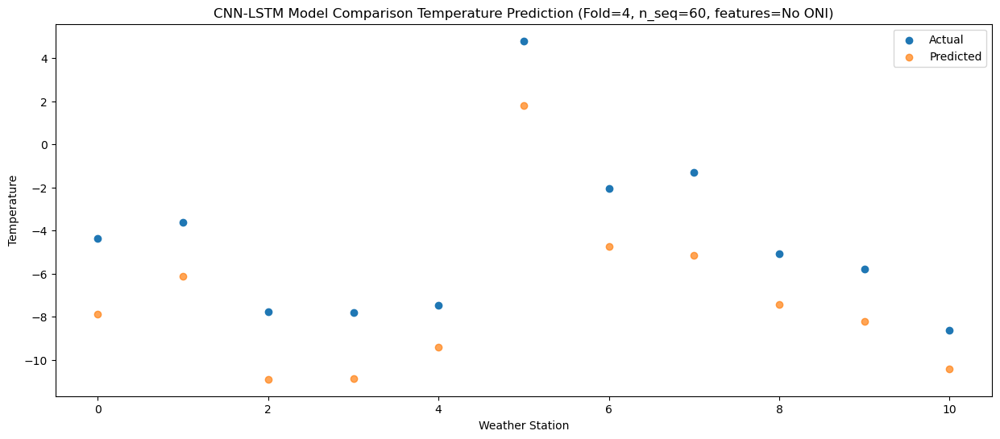

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.30  -6.531021
1                 1   -0.19  -3.788915
2                 2   -5.41  -8.898126
3                 3   -7.54 -10.008595
4                 4   -6.83  -8.681189
5                 5    4.60   2.608014
6                 6    2.23  -1.963127
7                 7    0.77  -3.501613
8                 8   -2.04  -4.540978
9                 9   -2.94  -5.905316
10               10   -5.06  -7.082298


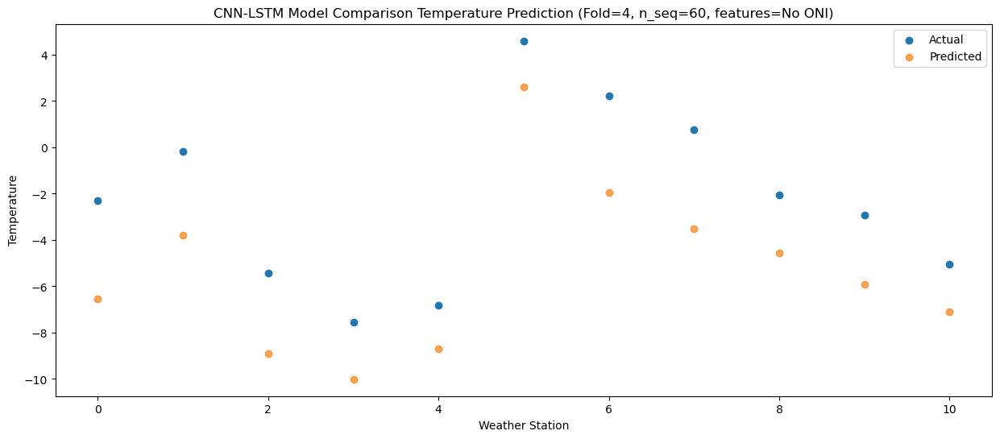

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    4.41   1.288497
1                 1    2.63  -0.420460
2                 2   -0.67  -3.468081
3                 3   -1.36  -3.388018
4                 4    0.09  -2.013037
5                 5   11.92   8.533991
6                 6    5.79   3.030638
7                 7    7.43   3.436127
8                 8    5.43   2.275378
9                 9    5.27   1.572865
10               10    0.91  -0.657681


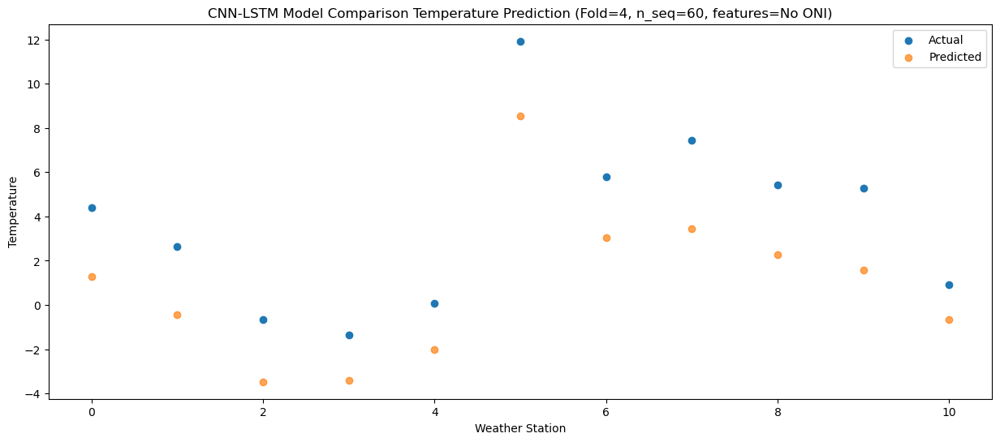

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    9.29   6.232805
1                 1    4.97   2.384252
2                 2    3.54   0.537794
3                 3    4.69   1.520028
4                 4    6.78   2.924154
5                 5   19.43  12.977875
6                 6    8.45   6.448648
7                 7   11.29   8.075768
8                 8    9.21   6.327450
9                 9    9.39   6.063937
10               10    4.91   3.116652


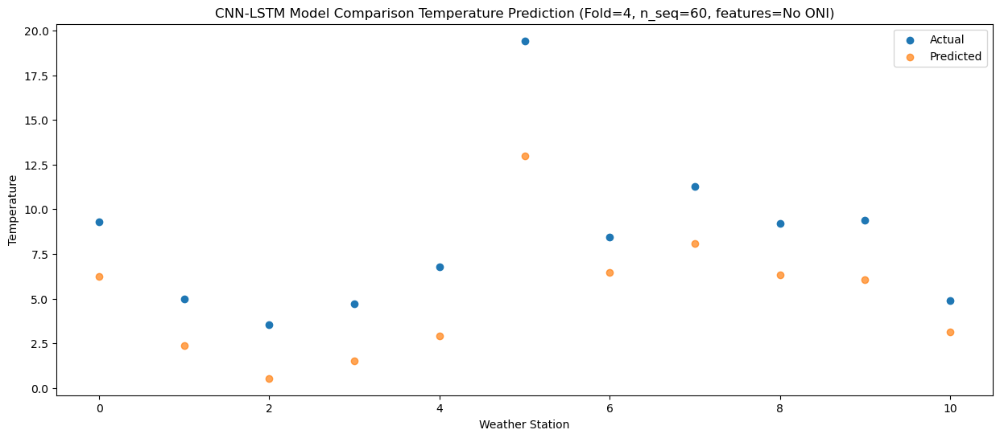

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   16.23  14.307549
1                 1    7.79   6.303155
2                 2    9.34   6.228354
3                 3    9.40   7.563679
4                 4   11.61   8.967189
5                 5   25.12  18.483495
6                 6   14.43  12.557760
7                 7   16.96  15.239254
8                 8   17.71  14.745478
9                 9   17.92  14.666841
10               10   13.49  11.705823


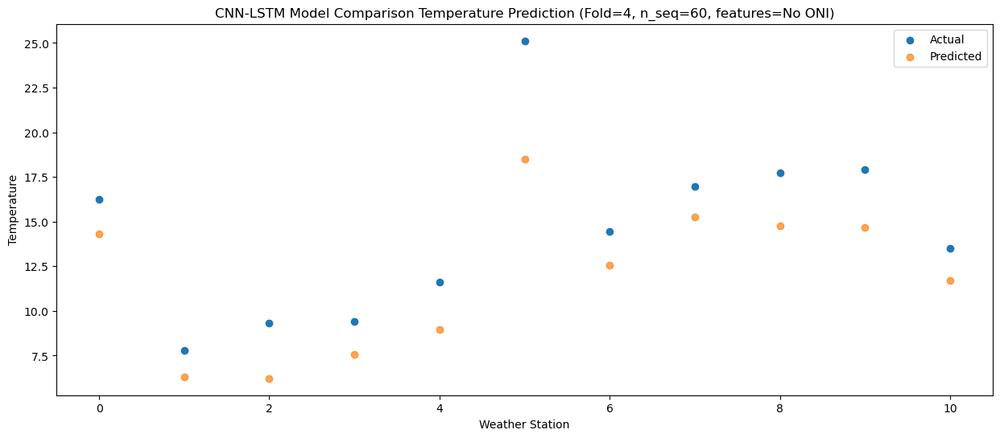

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   22.14  19.767074
1                 1    9.51   9.915428
2                 2   12.63  10.336718
3                 3   13.95  12.490965
4                 4   16.28  13.991850
5                 5   27.49  23.523752
6                 6   17.64  16.530452
7                 7   22.28  20.085935
8                 8   22.19  19.440536
9                 9   22.53  19.746976
10               10   16.76  16.273453


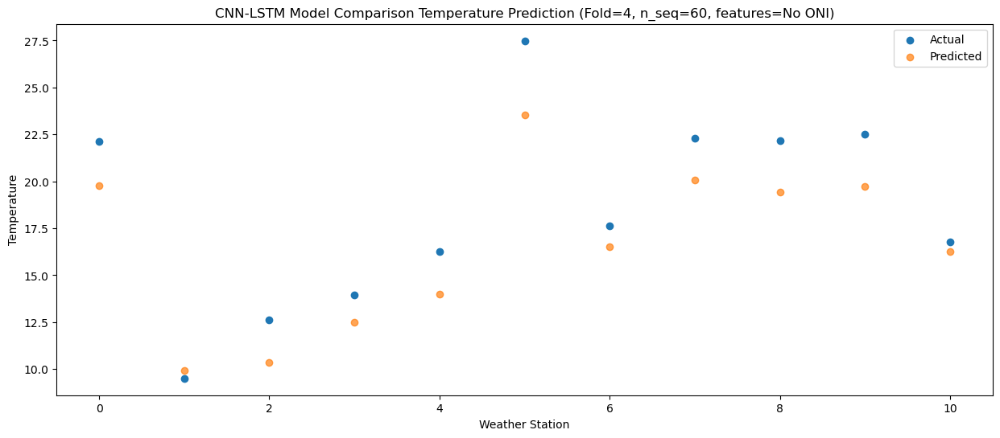

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   24.66  22.053675
1                 1    9.88  10.344942
2                 2   12.83  11.330643
3                 3   17.25  14.090769
4                 4   19.70  15.669304
5                 5   29.39  25.186327
6                 6   18.91  17.807799
7                 7   25.98  21.847332
8                 8   24.13  21.590274
9                 9   23.35  21.974696
10               10   19.36  18.736313


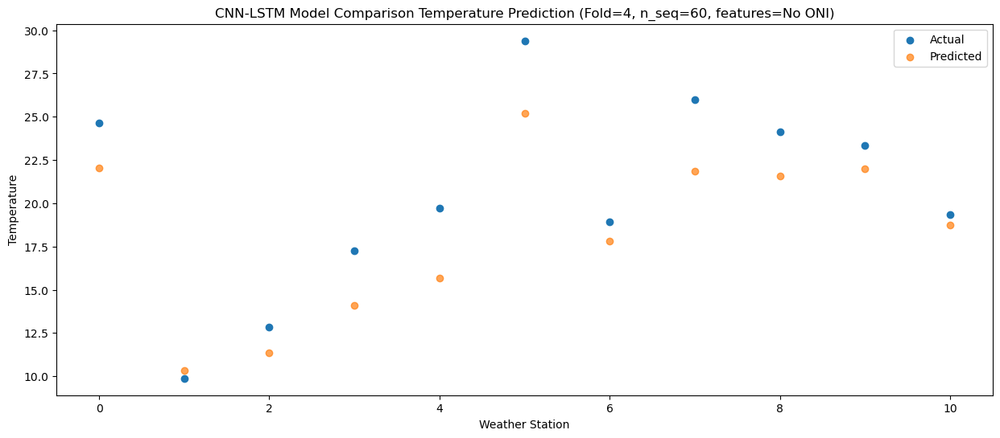

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   23.00  20.038526
1                 1    9.83   9.540659
2                 2   11.29   9.477695
3                 3   14.52  11.802273
4                 4   16.86  13.421492
5                 5   26.09  23.506410
6                 6   17.39  16.620608
7                 7   22.46  19.767318
8                 8   21.90  20.209991
9                 9   22.05  20.293088
10               10   18.29  17.762998


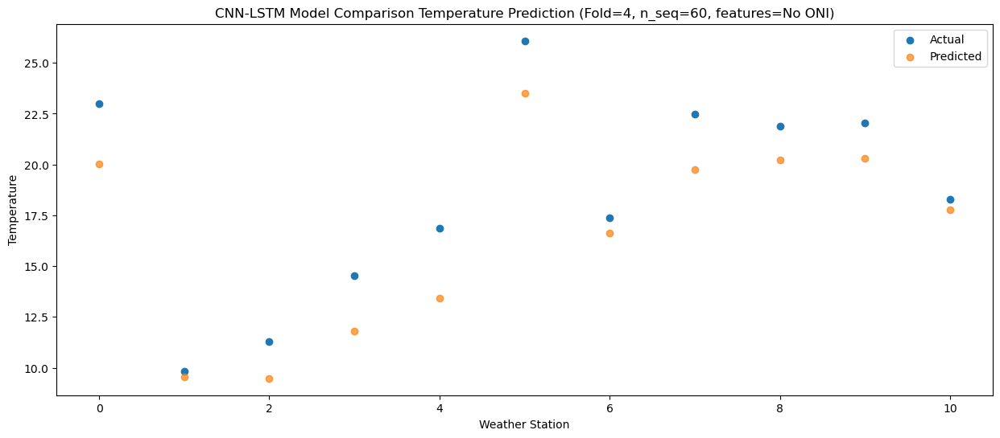

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   19.09  16.087226
1                 1    8.39   7.536993
2                 2    9.22   6.773845
3                 3   11.09   8.909261
4                 4   12.77  10.511308
5                 5   23.19  20.780399
6                 6   14.30  13.447857
7                 7   18.87  16.296624
8                 8   17.99  15.912321
9                 9   17.91  16.009281
10               10   14.24  13.146944


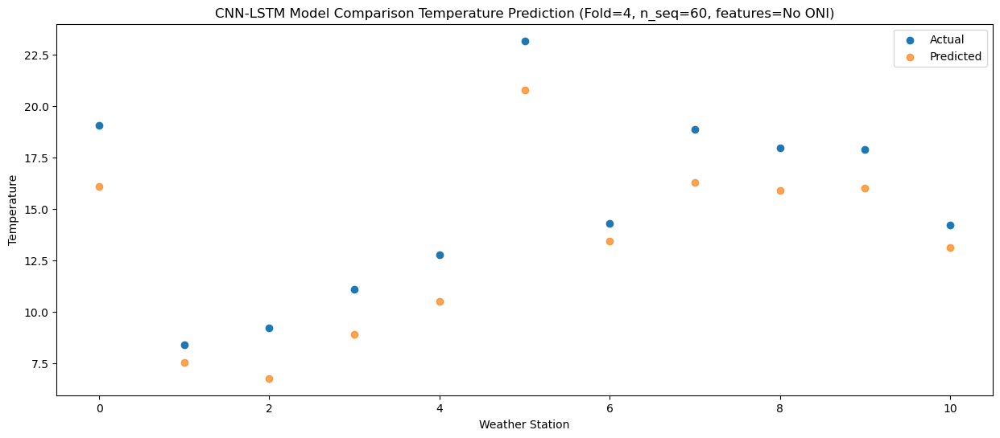

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   11.74   7.648768
1                 1    4.56   1.072890
2                 2    3.09  -0.449243
3                 3    4.22   1.160406
4                 4    5.62   2.720867
5                 5   16.38  13.187778
6                 6    7.43   6.255614
7                 7   12.50   8.357975
8                 8   10.50   7.863246
9                 9   10.44   7.700507
10               10    7.38   5.154513


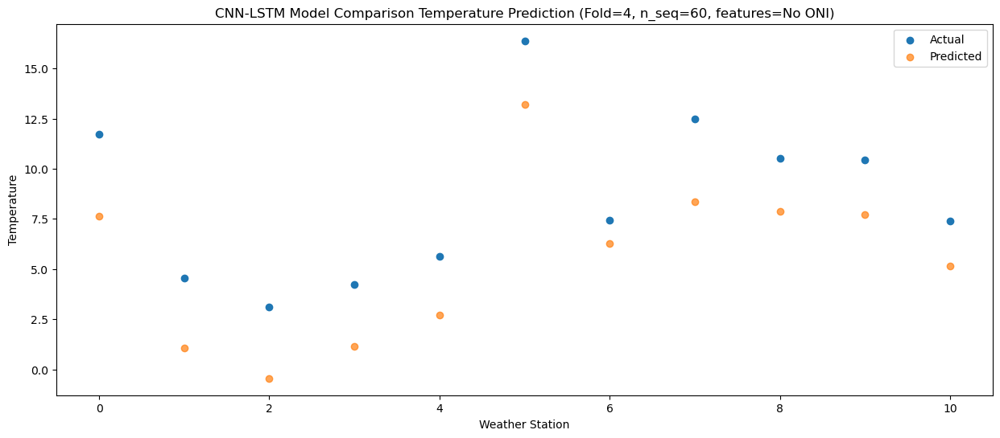

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.41  -0.248887
1                 1    3.10  -1.725877
2                 2   -1.50  -4.724825
3                 3   -2.83  -5.870737
4                 4   -1.47  -4.618878
5                 5    8.53   5.994104
6                 6    4.73   2.775486
7                 7    5.95   2.068252
8                 8    4.71   2.820600
9                 9    4.90   1.392500
10               10    3.30   0.645584


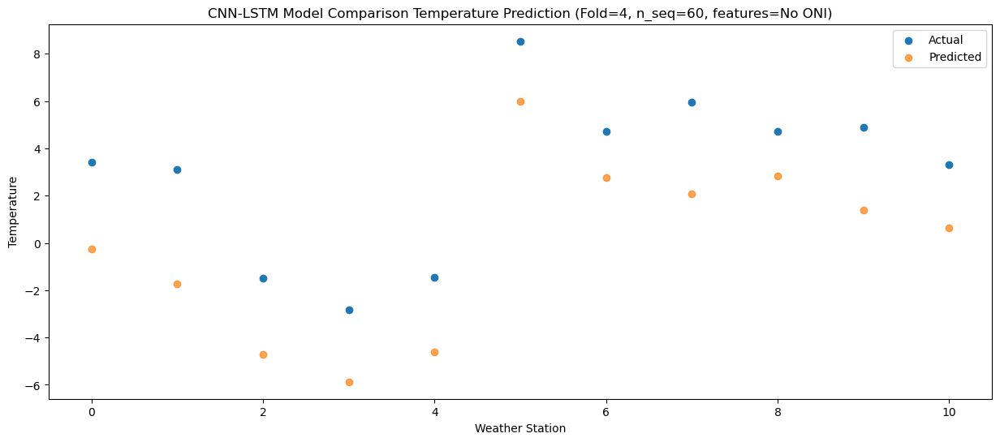

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -2.73  -5.704944
1                 1   -1.75  -5.102709
2                 2   -3.93  -8.713615
3                 3   -5.52  -9.500364
4                 4   -4.44  -8.210664
5                 5    6.93   2.604512
6                 6   -1.22  -2.163482
7                 7    1.10  -2.798959
8                 8   -1.07  -3.805061
9                 9   -1.83  -5.005975
10               10   -3.41  -6.484939


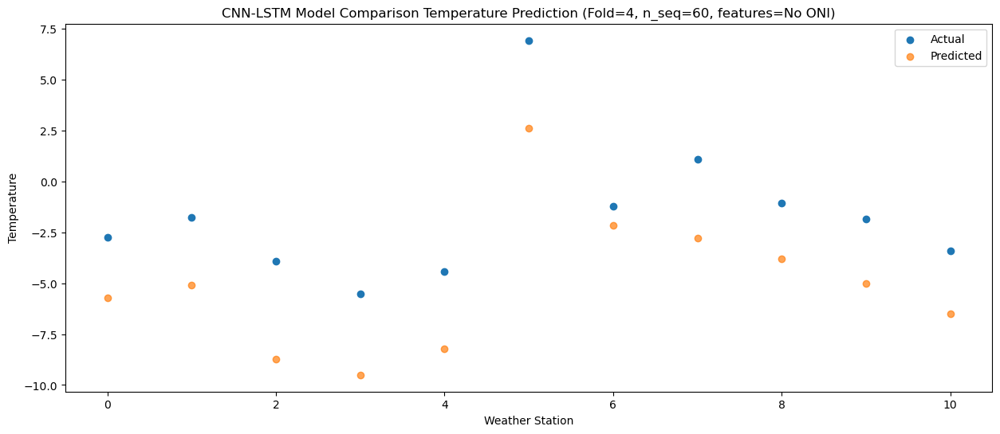

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.77  -4.933505
1                 1   -1.90  -4.209059
2                 2   -3.52  -7.794213
3                 3   -4.53  -8.975779
4                 4   -3.67  -7.721440
5                 5    7.30   3.106830
6                 6    1.80  -0.927953
7                 7    2.75  -1.942059
8                 8    0.89  -2.419754
9                 9    0.41  -3.853650
10               10   -1.78  -4.889871


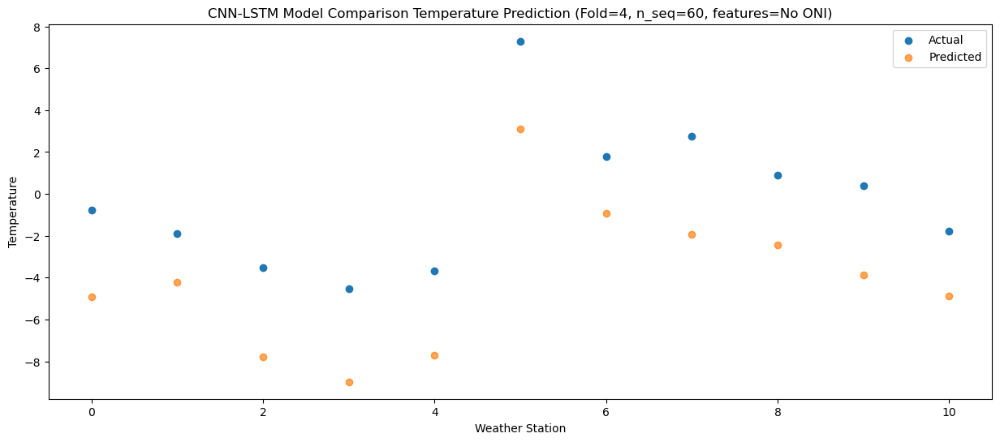

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.98  -3.432088
1                 1    1.40  -1.919951
2                 2   -1.58  -5.243235
3                 3   -4.47  -6.705802
4                 4   -3.44  -5.550620
5                 5    7.47   4.884424
6                 6    5.22   1.068735
7                 7    4.89   0.105030
8                 8    2.48  -1.131427
9                 9    1.60  -2.498334
10               10   -1.64  -4.067523


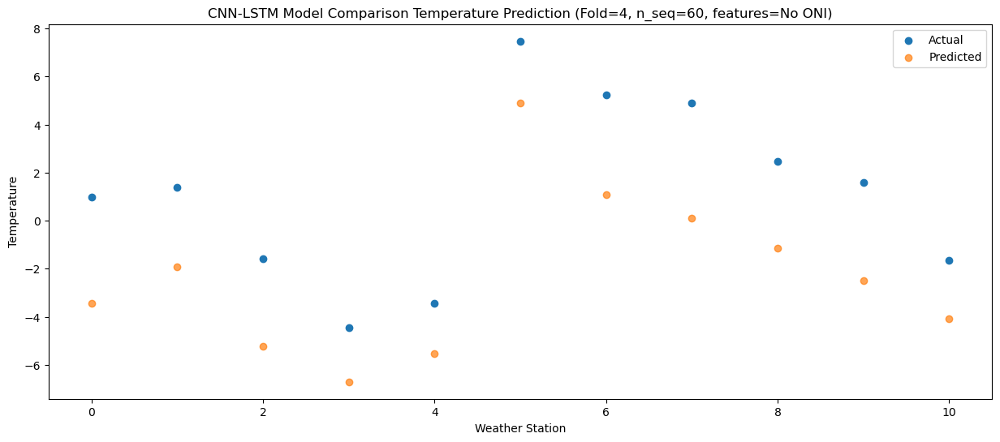

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.16  -1.211205
1                 1    3.12  -1.744119
2                 2    0.57  -4.141669
3                 3    0.06  -4.481122
4                 4    1.41  -3.235199
5                 5   12.54   6.958177
6                 6    5.70   1.561027
7                 7    6.61   1.878372
8                 8    3.75  -0.085769
9                 9    4.14  -0.940563
10               10   -0.76  -3.312254


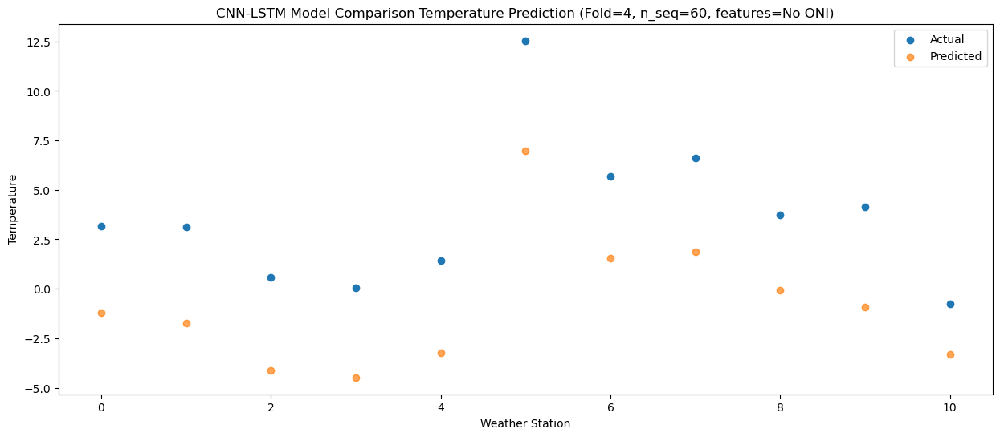

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   10.99   5.455134
1                 1    5.84   0.197090
2                 2    2.32  -1.015268
3                 3    2.66  -0.493602
4                 4    4.06   0.885446
5                 5   16.76  11.067330
6                 6    8.81   5.792079
7                 7   12.23   7.046936
8                 8   10.25   6.865558
9                 9   11.47   6.162015
10               10    7.71   4.306961


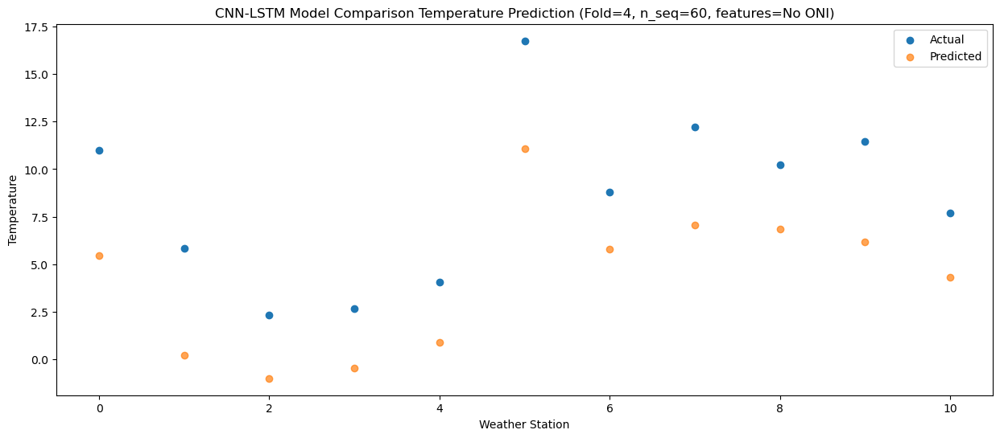

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   16.80  12.181963
1                 1    6.62   2.354587
2                 2    7.18   3.009369
3                 3    8.34   5.270662
4                 4   10.22   6.792145
5                 5   21.68  16.494027
6                 6   11.43   9.101845
7                 7   17.01  12.640454
8                 8   15.96  11.869604
9                 9   17.23  12.072763
10               10   11.40   8.821357


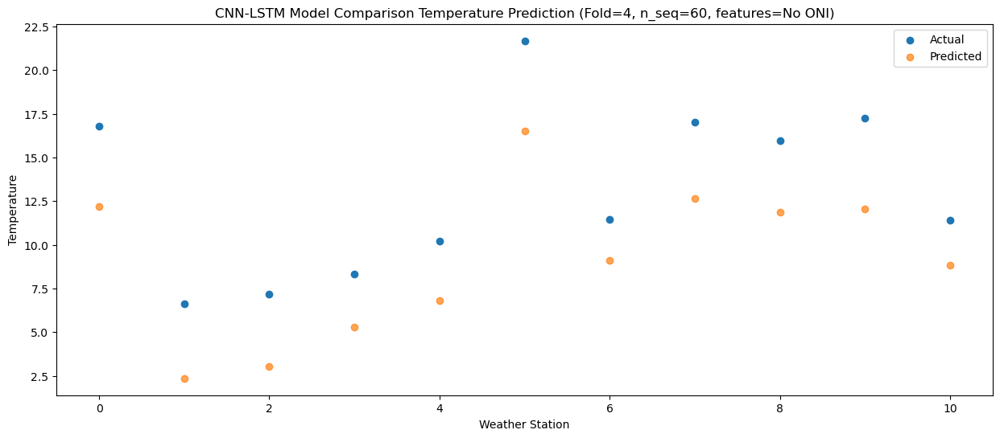

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   21.71  16.243784
1                 1    8.83   5.250364
2                 2   10.77   6.562458
3                 3   12.53   8.937424
4                 4   15.33  10.438929
5                 5   28.16  19.857122
6                 6   15.07  12.620628
7                 7   21.09  16.540724
8                 8   19.84  15.925189
9                 9   21.54  16.221487
10               10   15.71  12.829595


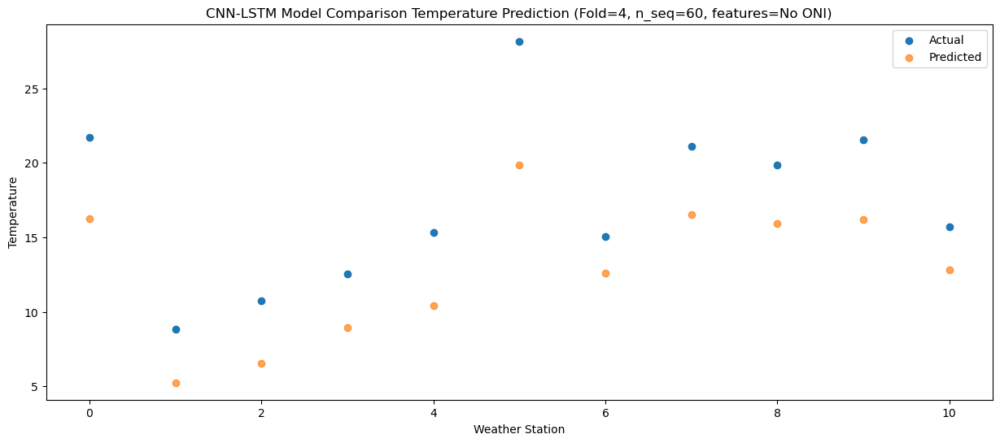

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   23.02  19.083211
1                 1   10.44   9.468669
2                 2   12.55   9.652397
3                 3   15.08  11.744760
4                 4   18.41  13.303049
5                 5   29.62  23.392637
6                 6   18.94  16.496614
7                 7   23.05  19.427834
8                 8   22.57  19.456600
9                 9   23.07  19.331927
10               10   18.80  16.973064


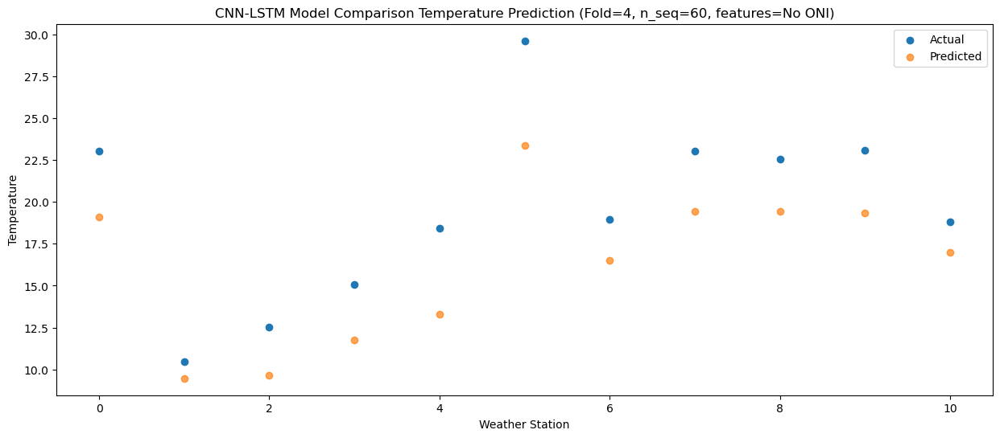

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   22.82  18.813658
1                 1   10.95   9.164711
2                 2   14.63   9.730533
3                 3   17.63  12.326426
4                 4   20.28  13.892186
5                 5   29.71  23.665471
6                 6   18.38  15.688155
7                 7   22.86  19.308467
8                 8   21.41  18.080948
9                 9   21.81  18.361601
10               10   17.47  15.005452


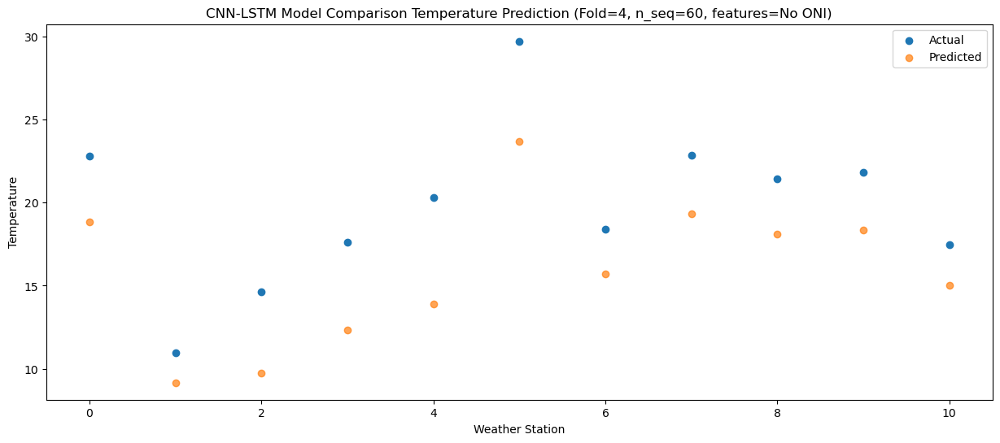

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   19.99  15.455923
1                 1    8.85   5.516428
2                 2   10.88   6.093090
3                 3   12.93   8.478868
4                 4   15.19  10.029185
5                 5   26.23  19.836175
6                 6   14.54  12.309212
7                 7   18.92  15.827104
8                 8   18.32  15.106779
9                 9   18.77  15.302048
10               10   15.13  12.140288


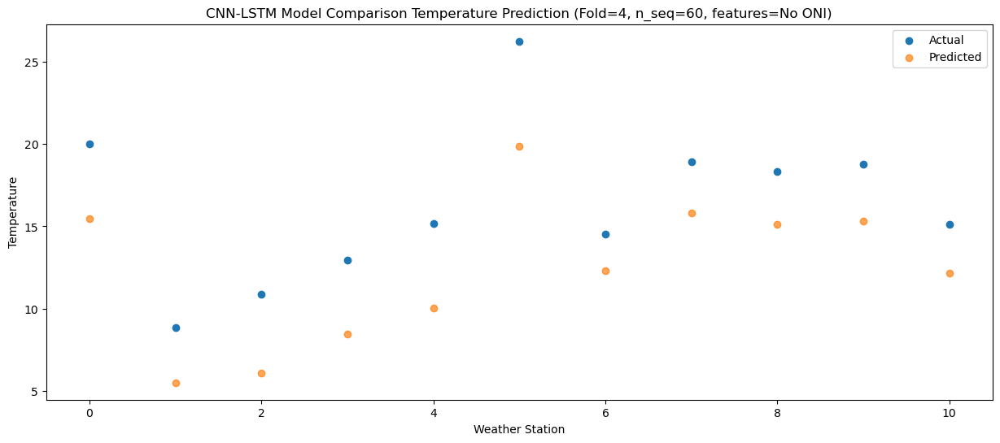

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   12.87   7.050227
1                 1    5.20   0.814103
2                 2    4.77  -0.439579
3                 3    4.80   0.609282
4                 4    6.36   2.106049
5                 5   17.70  12.635442
6                 6    9.10   6.556383
7                 7   13.02   8.126410
8                 8   12.18   8.183782
9                 9   12.36   7.611303
10               10    9.87   5.783696


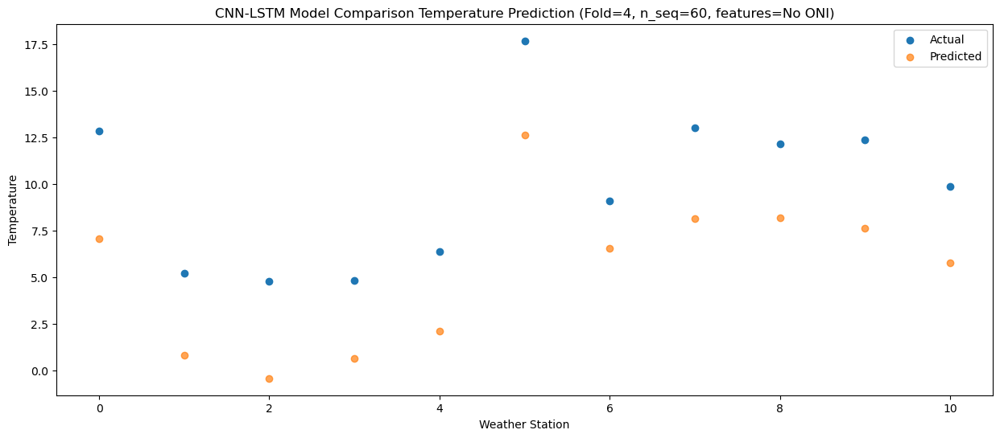

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    6.62   0.929606
1                 1    1.49  -3.692904
2                 2   -2.19  -5.463085
3                 3   -1.27  -4.576977
4                 4   -0.17  -3.108072
5                 5   10.99   7.466423
6                 6    3.37   1.097632
7                 7    7.12   2.439362
8                 8    5.11   1.785641
9                 9    5.27   1.235198
10               10    2.48  -0.871958


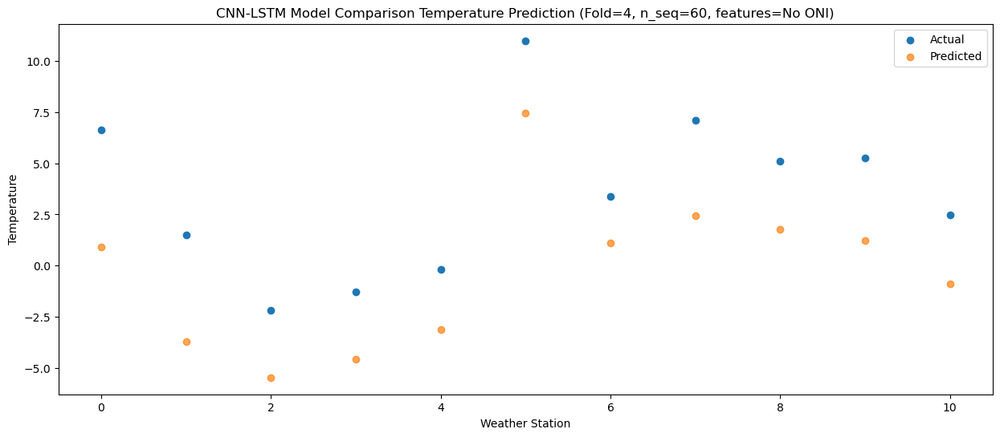

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.22  -1.910690
1                 1   -0.63  -6.534000
2                 2   -4.74  -8.492612
3                 3   -4.29  -8.015834
4                 4   -3.30  -6.564024
5                 5    8.19   4.198035
6                 6    1.16  -1.352211
7                 7    4.24  -0.499114
8                 8    3.22  -0.197659
9                 9    3.28  -1.050649
10               10    1.82  -2.434026


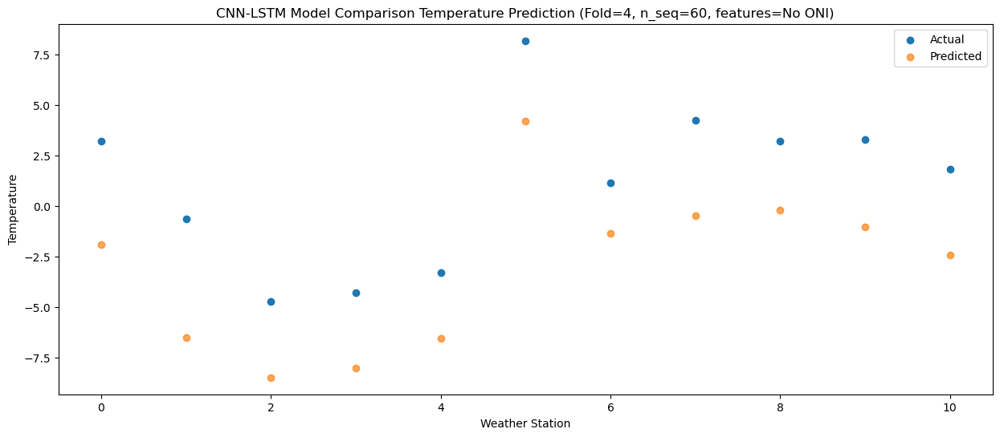

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -5.37  -9.746998
1                 1   -2.05  -9.148878
2                 2   -8.93 -13.638516
3                 3   -9.81 -14.415753
4                 4   -8.65 -12.987923
5                 5    3.94  -1.242402
6                 6   -1.28  -5.981807
7                 7   -2.92  -7.351685
8                 8   -3.06  -7.086068
9                 9   -4.30  -8.646767
10               10   -3.95  -8.938764


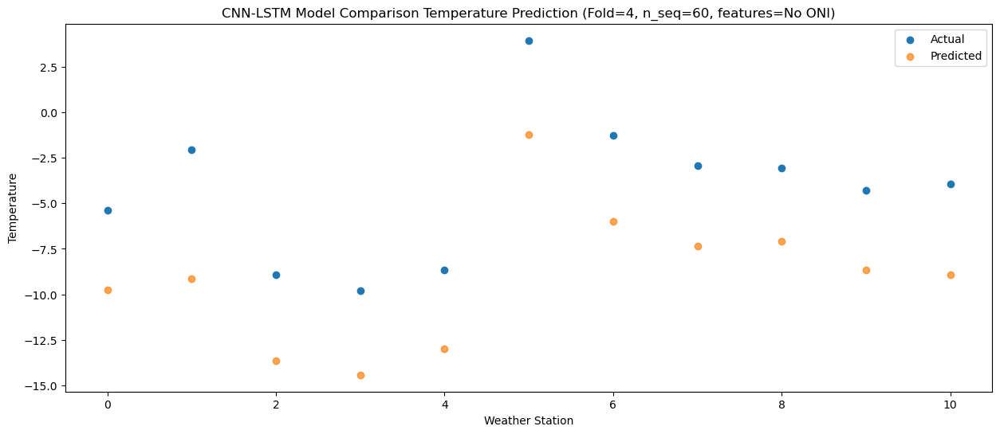

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    5.74  -0.635407
1                 1   -2.32  -5.504088
2                 2   -2.61  -6.721805
3                 3   -1.40  -5.437002
4                 4   -0.33  -3.972411
5                 5   10.76   6.330156
6                 6    2.13  -0.956817
7                 7    6.99   1.064051
8                 8    3.28  -0.597765
9                 9    3.47  -0.819254
10               10   -0.47  -3.761570


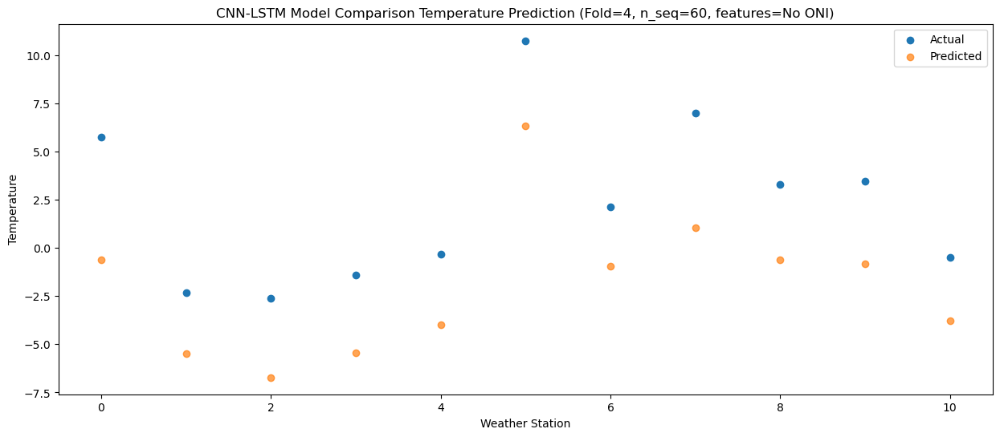

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    8.27   1.520149
1                 1    2.58  -2.518893
2                 2   -0.38  -3.888241
3                 3    1.01  -3.288751
4                 4    2.24  -1.906372
5                 5   13.36   8.354280
6                 6    5.92   2.254978
7                 7    9.42   3.563361
8                 8    7.72   2.403250
9                 9    7.62   1.821446
10               10    2.88  -0.512431


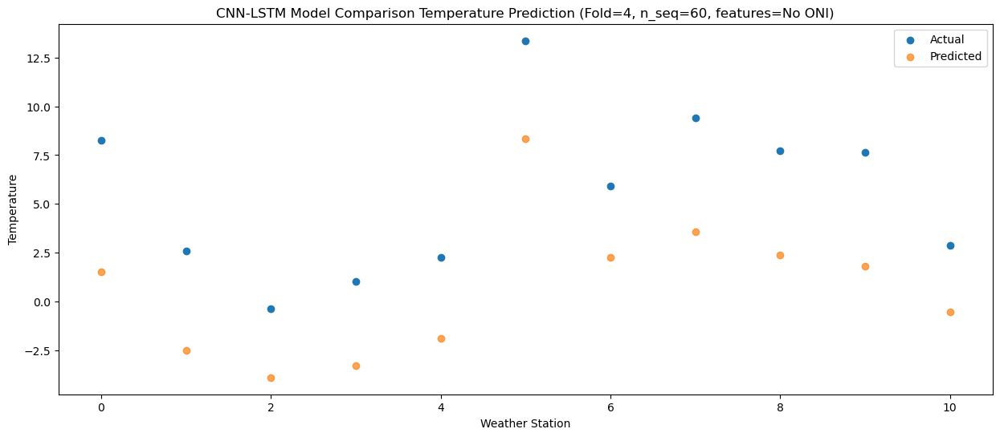

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   12.89   7.558779
1                 1    3.63   0.413793
2                 2    3.44   0.379580
3                 3    4.86   1.723357
4                 4    6.29   3.153714
5                 5   18.32  13.045762
6                 6   10.15   6.450337
7                 7   13.56   8.921656
8                 8   12.30   7.945606
9                 9   12.11   7.728094
10               10    8.60   4.913714


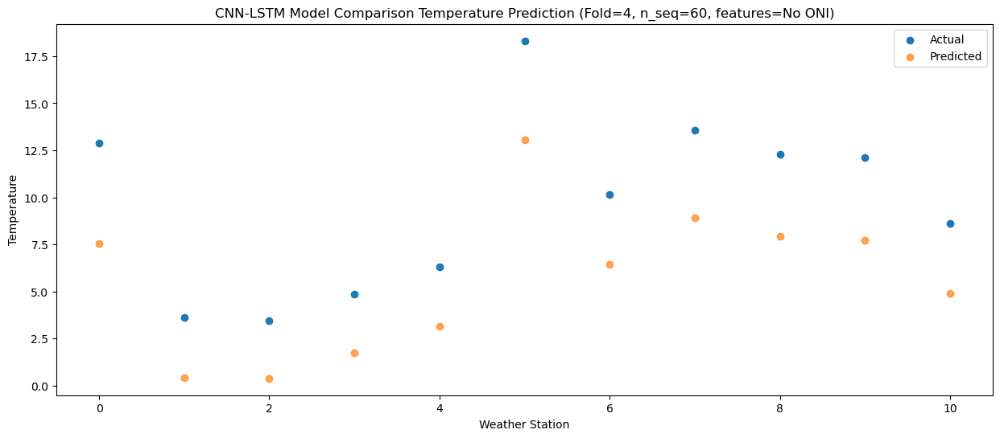

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   17.90  12.966050
1                 1    9.08   4.495505
2                 2    8.96   5.014135
3                 3    9.62   6.230006
4                 4   11.09   7.637240
5                 5   23.61  17.334205
6                 6   14.22  11.449294
7                 7   18.21  14.034038
8                 8   18.90  13.888562
9                 9   19.14  13.584454
10               10   14.70  11.076378


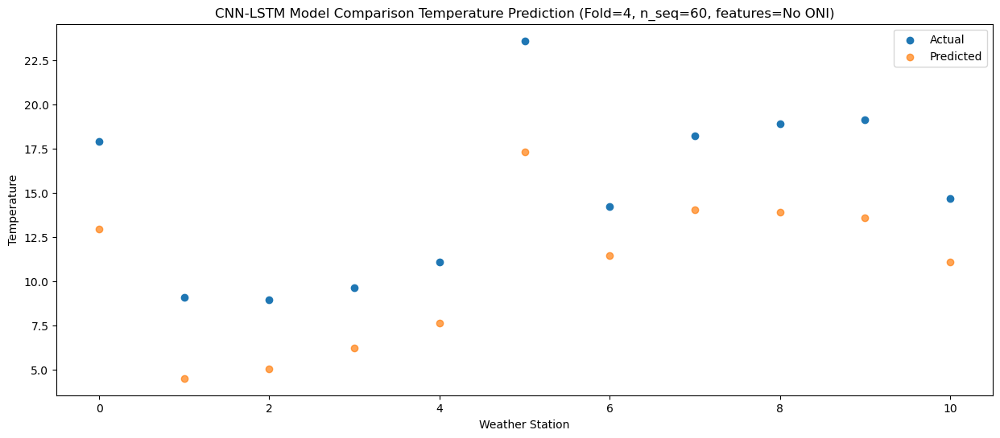

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   23.09  17.919835
1                 1    9.73   7.136849
2                 2   11.59   8.051594
3                 3   13.65  10.179633
4                 4   15.54  11.731594
5                 5   27.62  21.603774
6                 6   17.64  14.827344
7                 7   21.93  18.134866
8                 8   22.26  18.268073
9                 9   23.11  18.254268
10               10   17.86  15.643345


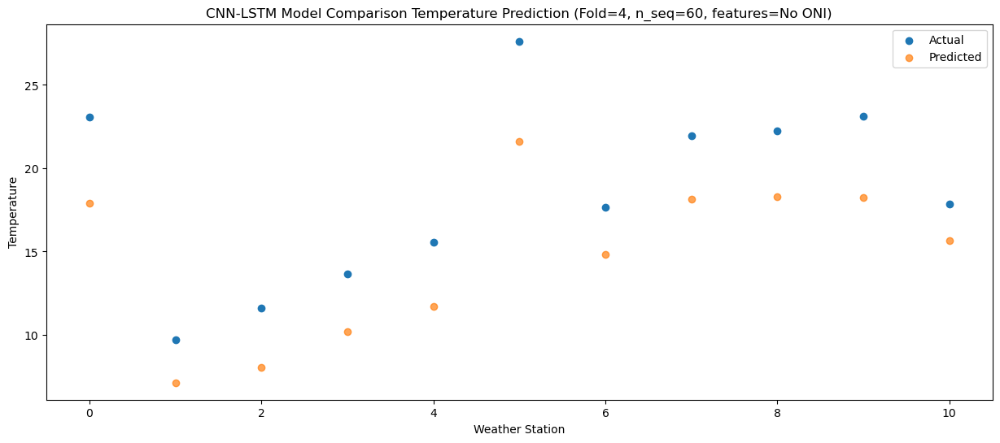

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   23.85  17.892398
1                 1   10.42   7.589570
2                 2   12.61   7.682801
3                 3   14.55   9.702325
4                 4   16.25  11.334862
5                 5   26.45  21.794236
6                 6   19.10  15.161734
7                 7   22.23  17.836207
8                 8   22.27  18.700880
9                 9   22.14  18.438064
10               10   19.38  16.587817


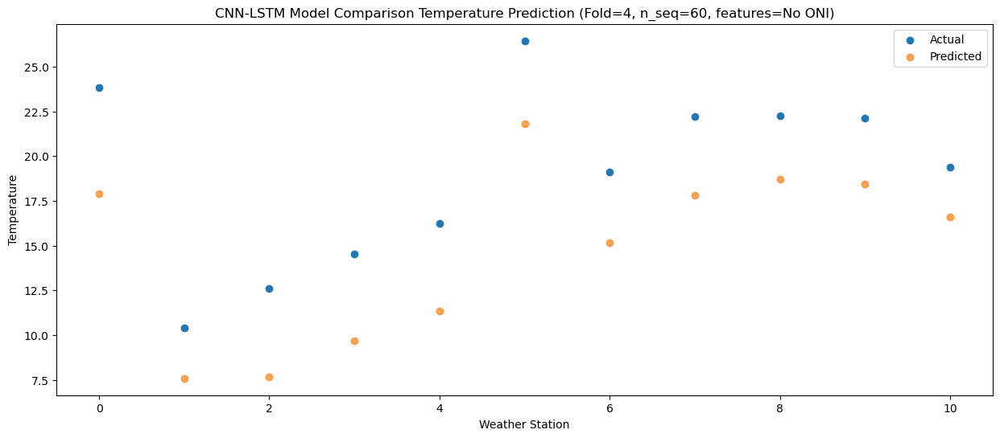

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   22.36  18.443729
1                 1   10.12   7.433409
2                 2   13.18   8.406023
3                 3   16.30  10.983485
4                 4   18.21  12.589957
5                 5   28.91  22.479295
6                 6   17.94  14.827109
7                 7   22.67  18.544109
8                 8   22.19  18.138803
9                 9   21.80  18.363120
10               10   18.24  15.316402


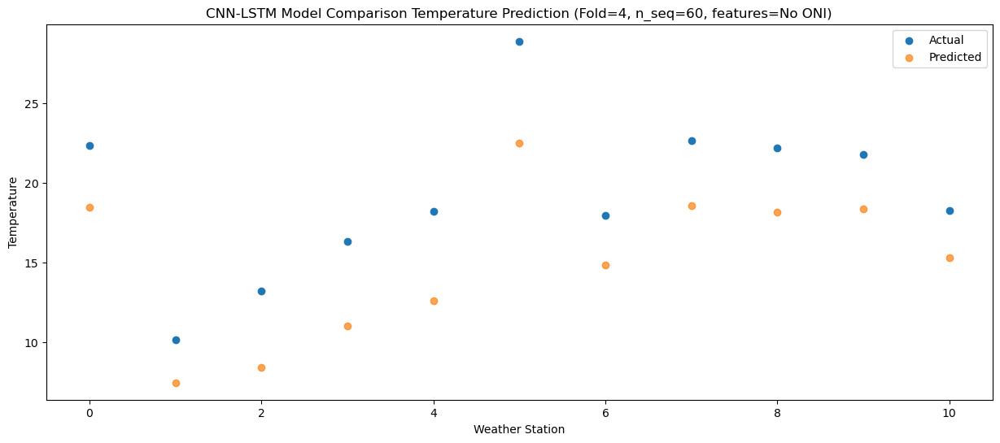

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   19.93  15.026190
1                 1    9.25   4.691097
2                 2    9.57   5.092902
3                 3   10.91   7.408373
4                 4   12.20   9.023251
5                 5   22.46  19.193503
6                 6   15.50  11.798734
7                 7   18.53  15.090806
8                 8   19.58  14.999011
9                 9   18.57  15.115065
10               10   15.97  12.312613


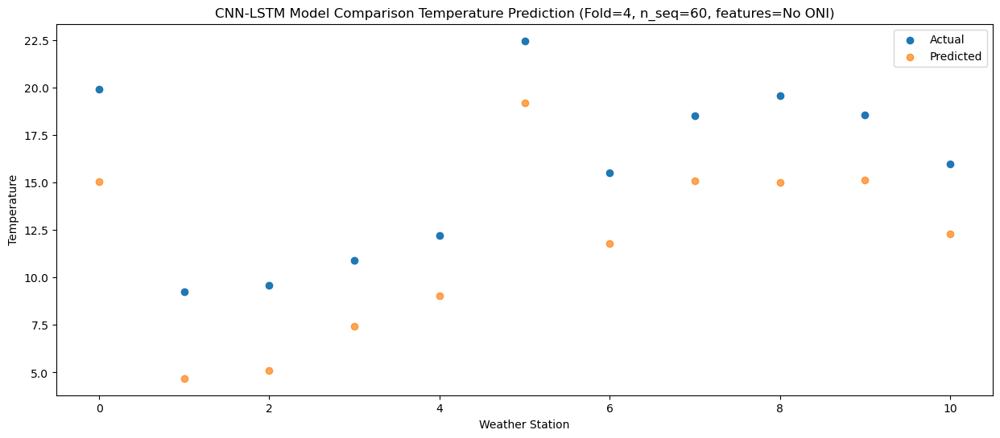

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   15.80   8.459524
1                 1    5.48   0.152997
2                 2    5.43  -0.052193
3                 3    8.16   2.139247
4                 4    9.78   3.725791
5                 5   20.75  13.985403
6                 6    9.88   6.161958
7                 7   14.85   9.133304
8                 8   13.65   8.143922
9                 9   13.50   8.221093
10               10    9.50   5.270463


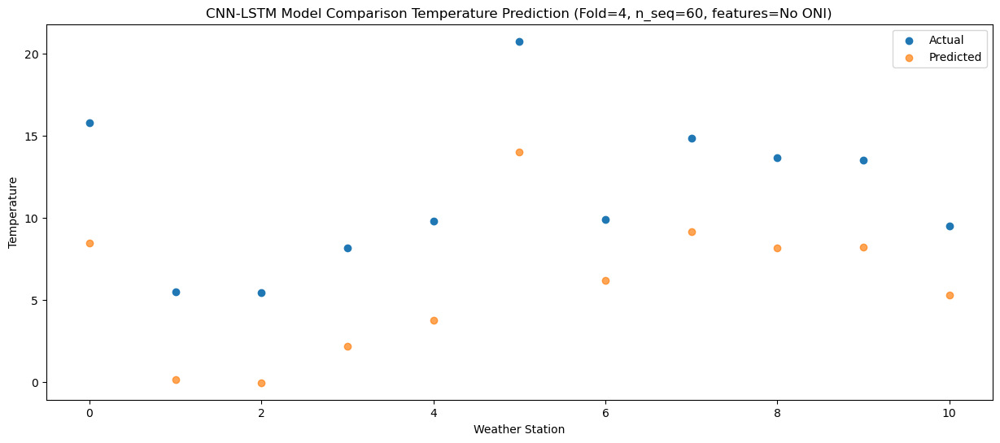

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_4 (Conv1D)           (None, 1, 1024)           1859584   
                                                                 
 max_pooling1d_4 (MaxPooling  (None, 1, 1024)          0         
 1D)                                                             
                                                                 
 dropout_12 (Dropout)        (None, 1, 1024)           0         
                                                                 
 lstm_8 (LSTM)               (None, 1, 256)            1311744   
                                                                 
 dropout_13 (Dropout)        (None, 1, 256)            0         
                                                                 
 lstm_9 (LSTM)               (None, 256)               525312    
                                                      

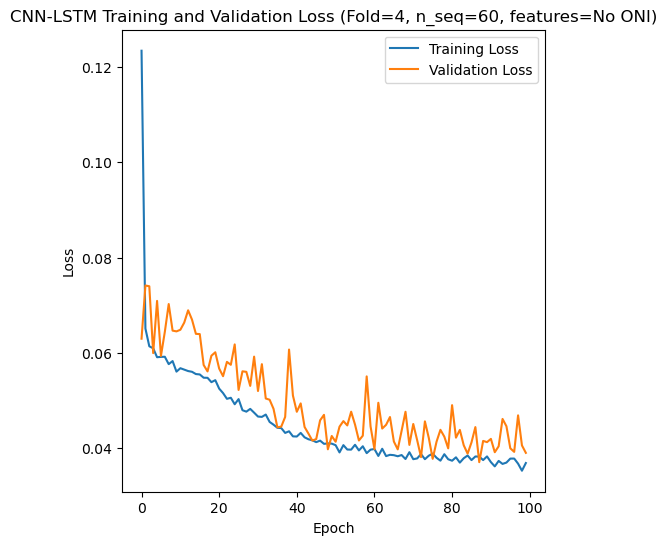

[[1.0365496665470488, 0.6277782684498343, 0.6209383768500671, 1.1339214950756742, 2.267644860570431, 2.245471594896764, 3.2620023559215525, 3.9368748704334324, 3.9332538951820046, 3.652890746938882, 3.3330161505691756, 2.3856116044896845, 2.0589893255368317, 2.421734499808987, 2.4986629077187907, 1.8564161009633395, 3.475681382664686, 3.7014903492437865, 4.166657557240922, 5.318840335749624, 5.0153685041794605, 5.185872854228867, 5.278672447927484, 4.648188489919816, 5.161173665520856, 4.357477767893563, 4.2070648737140255, 4.4178931042706795, 4.982858704903284, 5.606104858415493, 6.566384295667884, 7.212834739601795, 7.23925867757252, 7.280485909802079, 6.889437439828707, 6.5531678707293155, 5.474900698260461, 5.657634930039772, 5.016619896291744, 5.146476905886988, 6.125420428785961, 6.995616521584903, 8.407260335545569, 8.495450598780039, 8.678498221491225, 9.077585107810311, 8.659495554975507, 8.092970229561393, 7.403747674808495, 7.169425658383249, 6.391938374976905, 7.82282836483

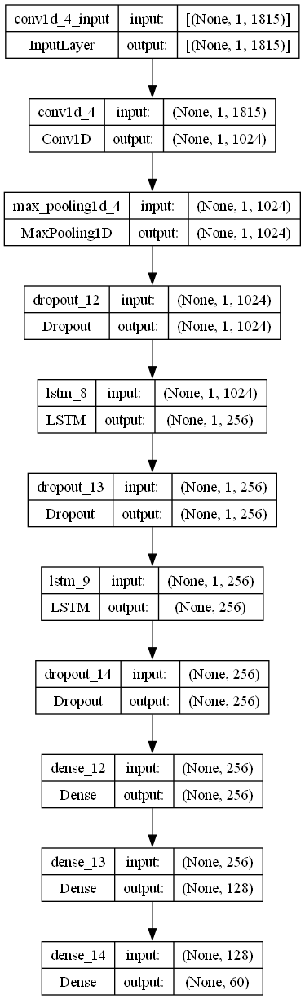

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 1024
    lr = 0.22687330685163667
    optimizer = SGD(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 256
    dropout_rate =  0.28713470692398485

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# make one forecast with a CNN-LSTM model,
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No ONI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No ONI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_CV_S60_No_ONI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)